In [1]:
#===================================================================#
#                            IMPORT LIBRARIES                       #
#===================================================================#
import pydicom
import os
import numpy as np
import matplotlib.pyplot as plt
from dicompylercore import dicomparser
import math
import random
#===================================================================#
#                        IMPORT PYTHON NOTEBOOK                     #
#===================================================================#
import Data_Dictionary
import Transformation
import Image_Preprocessing
import Models
import Dicom_Plots
import Image_Data_Generatorv2
#===================================================================#
#                    LOAD FILES FOR PREPROCESSING                   #
#===================================================================#
structureFiles = np.load('RT Simulation Structure File Paths.npy')

C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages

In [ ]:
from dicompylercore import util
from PIL import Image
from numbers import Number

def GetDefaultImageWindowLevel(rescaled_image,intercept,slope, window=0,level=0):     
    
    
    if ('WindowWidth' in dcm.ds) and ('WindowCenter' in dcm.ds):
        if isinstance(dcm.ds.WindowWidth, float):
            window = dcm.ds.WindowWidth
        elif isinstance(dcm.ds.WindowWidth, str):
            try:
                window = dcm.ds.WindowWidth
            except:
                print("image conversion error")
        elif isinstance(dcm.ds.WindowWidth, list):
            if (len(dcm.ds.WindowWidth) > 1):
                window = dcm.ds.WindowWidth[1]
        
        if isinstance(dcm.ds.WindowCenter, float):
            level = dcm.ds.WindowCenter
        elif isinstance(dcm.ds.WindowCenter, str):
            try:
                level = dcm.ds.WindowCenter
            except:
                print("image conversion error")
        elif isinstance(dcm.ds.WindowCenter, list):
            if (len(dcm.ds.WindowCenter) > 1):
                level = dcm.ds.WindowCenter[1]           
    print("Default window (aka window width): %2i"%window)
    print("Default level (aka window center): %2i"%level)
    
    if ((window, level) == (0, 0)):
        wmax = 0
        wmin = 0
        if (rescaled_image.max() > wmax):
            wmax = rescaled_image.max()
        if (rescaled_image.min() < wmin):
            wmin = rescaled_image.min()
        # Default window is the range of the data array
        window = int(wmax - wmin)
        # Default level is the range midpoint minus the window minimum
        level = int(window / 2 - abs(wmin))
    return window, level

def GetLUTValue(data, window, level):
        """Apply the RGB Look-Up Table for the data and window/level value."""

        lutvalue = util.piecewise(data,
                                [data <= (level - 0.5 - (window - 1) / 2),
                                 data > (level - 0.5 + (window - 1) / 2)],
                                [0, 255, lambda data:
                                 ((data - (level - 0.5)) / (window-1) + 0.5) *
                                 (255 - 0)])
        # Convert the resultant array to an unsigned 8-bit array to create
        # an 8-bit grayscale LUT since the range is only from 0 to 255
        return np.array(lutvalue, dtype=np.uint16)

pathIndex=0
z=1
Organ ="Right_Parotid"
for pathIndex in range(0,200):
    imagesFolders,imageFolderIndex,DicomImageSet,Organ_Data = Image_Preprocessing.load_Saved_Data(pathIndex,Organ,structureFiles)
    dcm = dicomparser.DicomParser(imagesFolders[imageFolderIndex]+DicomImageSet[z])  
    
    patient_name = structureFiles[pathIndex][9:22]
    print(patient_name)
    
    
    #load
    imagesFolders,imageFolderIndex,DicomImageSet,Organ_Data = Image_Preprocessing.load_Saved_Data(pathIndex,Organ,structureFiles)
    images_in_Folder = [imagesFolders[imageFolderIndex] + image for image in DicomImageSet]
    slices = [pydicom.read_file(image) for image in images_in_Folder]
    slices.sort(key = lambda x: float(x.ImagePositionPatient[2]))
    ds = slices[-20]#pydicom.read_file(imagesFolders[imageFolderIndex]+DicomImageSet[z])
    

    #rescale
    intercept, slope = 0, 1
    if ('RescaleIntercept' in ds and 'RescaleSlope' in ds):
        intercept = ds.RescaleIntercept if \
            isinstance(ds.RescaleIntercept, Number) else 0
        slope = ds.RescaleSlope if \
            isinstance(ds.RescaleSlope, Number) else 1       
    pixel_array = ds.pixel_array
    rescaled_image = pixel_array * slope + intercept
    
    #finish
    window, level = GetDefaultImageWindowLevel(rescaled_image,intercept,slope)
    image = GetLUTValue(rescaled_image, window, level) ##converted to uint8
    im = Image.fromarray(image).convert('L')
    
    #plot
    plt.imshow(np.array(im,'uint8'),cmap="gray")
    plt.show()

    #plt.imshow(dcm.GetImage(),cmap="gray")
    #plt.show()

In [ ]:
Organ ="Right_Parotid"
z=0
for pathIndex in range(0,20):
    imagesFolders,imageFolderIndex,DicomImageSet,Organ_Data = Image_Preprocessing.load_Saved_Data(pathIndex,Organ,structureFiles)
    dcm = dicomparser.DicomParser(imagesFolders[imageFolderIndex]+DicomImageSet[z])  
    images_in_Folder = [imagesFolders[imageFolderIndex] + image for image in DicomImageSet]

    slices = [dicomparser.DicomParser(image) for image in images_in_Folder]
    slices.sort(key = lambda x: float(x.ds.ImagePositionPatient[2]))
    plt.imshow(slices[0].GetImage(300,40),cmap="gray")
    plt.show()


D:/HNSCC/HNSCC-01-0002\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


<IPython.core.display.Javascript object>


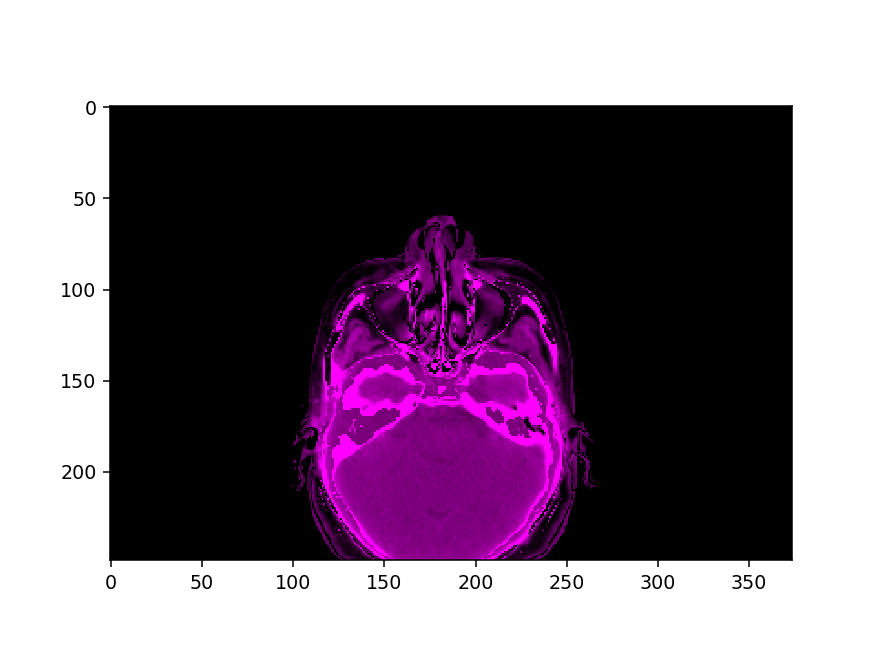

In [5]:
#===================================================================#
#                       INTERACTIVE 3D PLOT                         #
#===================================================================#
%matplotlib notebook
import tensorflow as tf
def remove_keymap_conflicts(new_keys_set):
    for prop in plt.rcParams:
        if prop.startswith('keymap.'):
            keys = plt.rcParams[prop]
            remove_list = set(keys) & new_keys_set
            for key in remove_list:
                keys.remove(key)
                
def multi_slice_viewer(volume):
    remove_keymap_conflicts({'j', 'k'})
    fig, ax = plt.subplots()
    ax.volume = volume
    ax.index = volume.shape[0] // 2
    ax.imshow(volume[ax.index])
    fig.canvas.mpl_connect('key_press_event', process_key)

def process_key(event):
    fig = event.canvas.figure
    ax = fig.axes[0]
    if event.key == 'j':
        previous_slice(ax)
    elif event.key == 'k':
        next_slice(ax)
    fig.canvas.draw()

def previous_slice(ax):
    volume = ax.volume
    ax.index = (ax.index - 1) % volume.shape[0]  # wrap around using %
    ax.images[0].set_array(volume[ax.index])

def next_slice(ax):
    volume = ax.volume
    ax.index = (ax.index + 1) % volume.shape[0]
    ax.images[0].set_array(volume[ax.index])

Organs = ["Right_Parotid","Left_Parotid","Brainstem","Right_Cochlea","Left_Cochlea"] 
no_Classes =3
j=0
key_Dict = "3Class2Channel3D"
Load = False
pathIndex =1
if(Load ==False):
    
    patient_name = structureFiles[pathIndex][9:22]
    DicomPatient,thickness = Image_Preprocessing.get_Patient(pathIndex,Organs[j],structureFiles,True)
    if(thickness== 3):
        tempArray, tempLabel =Image_Preprocessing.get_contoured_organ(pathIndex,Organs[j],key_Dict,no_Classes,structureFiles)
        print(len(tempArray))
    else:
        print("Interpolated")
        tempArray, tempLabel =Image_Preprocessing.interpolateArray(pathIndex,Organs[j],key_Dict,no_Classes,structureFiles)
        print(len(tempArray))
else:
    TrainingFeaturesDict,TrainingLabelsDict = Data_Dictionary.get_Training_Dictionary()
    TestingFeaturesDict,TestingLabelsDict = Data_Dictionary.get_Testing_Dictionary()

    if(key_Dict.find("3D")):
        X= np.load(TrainingFeaturesDict[key_Dict]+"Patient Directories.npy")
        y= np.load(TrainingLabelsDict[key_Dict]+"Patient Directories.npy")

    imageDimensions = np.load("D:\HNSCC/ImageDimensions.npy", allow_pickle=True)

    padding =0
    height = imageDimensions[0] -imageDimensions[1] +padding*2
    width = imageDimensions[2]- imageDimensions[3]+padding*2
    depth= 45


    tempArray = np.load(X[pathIndex]+".npy")   
    tempArray = np.array(tempArray).reshape(depth,width,height,2)
    
shape =list(tempArray.shape[0:3])
shape.append(3)


fullyImage = tempArray

fullyImage =np.zeros(shape,'uint8')
fullyImage[...,0] = tempArray[...,0]
fullyImage[...,2] = tempArray[...,0]
fullyImage[...,1] = tempArray[...,1]

multi_slice_viewer(fullyImage)

In [ ]:
#Automate Labelling process
import glob
TrainingFeaturesDict,TrainingLabelsDict = Data_Dictionary.get_Training_Dictionary()
TestingFeaturesDict,TestingLabelsDict = Data_Dictionary.get_Testing_Dictionary()
key_Dict = "3Class2Channel3D_Uncropped"
#key_Dict_Model = "3Class2Channel3D"

Organs = ["Right_Parotid","Left_Parotid","Brainstem"]

y= glob.glob(TestingLabelsDict[key_Dict]+"/*")
print(y)
no_Classes = 3

for Organ in Organs:
    for path in y:
        label = []
        if (path.find(Organ)!=-1):
            for i in range(no_Classes):
                label.append(0)
                if(Organ == Organs[i]):
                    label[i] =1

            label = np.array(label)
            np.savetxt(path, np.array(label), delimiter=",")

In [3]:
import Contour_Extraction
Contour_Extraction.save_Parotid_Contours(structureFiles)
Contour_Extraction.save_Brainstem_Contours(structureFiles)

Error at Index  5
Error at Index  5
Error at Index 123
Error at Index 128
Error at Index 136
Number of right parotid: 201
Number of left parotid: 198
Error at Index  5
Error at Index 123
Error at Index 128
Error at Index 136
Number of Brainstem: 196


In [2]:
#===================================================================#
#                          DATA EXTRACTION                          #
#===================================================================#                           
import Data_Extraction
import Contour_Extraction

structureFiles = np.load('RT Simulation Structure File Paths.npy')
Data_Extraction.save_globFilePaths('D:/HNSCC/HNSCC-01-0???/??-??-????-RT SIMULATION-?????/**/000000.dcm')
Data_Extraction.save_RTSimulationPaths('RT Simulation Paths.npy')
Data_Extraction.save_CTImagePaths('RT Simulation Paths.npy')

Contour_Extraction.save_Parotid_Contours(structureFiles)
Contour_Extraction.save_Ring_Contours(structureFiles)
Contour_Extraction.save_External_Contours(structureFiles)
Contour_Extraction.save_Brainstem_Contours(structureFiles)
Contour_Extraction.save_Cochlea_Contours(structureFiles)
Contour_Extraction.save_Isocentre_Contours(structureFiles)
#===================================================================#
#                            HISTOGRAMS                             #
#===================================================================#
stringImageDirectory ="C:/Users/Oliver/Documents/University/Year 4/MPhys Project/Images/"
Dicom_Plots.plot_CT_Image_Histograms(stringImageDirectory,structureFiles)
#===================================================================#
#                            SAVE DIM                               #
#===================================================================#
Organs = ["Brainstem"]
Image_Preprocessing.save_Image_Dimensions(structureFiles,Organs)

Brainstem
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\1-78710\000000.dcm
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\28768\
Top: 337.000, Bottom: 168.000, Left: 110.000, Right: 328.000
Top: 337.000, Bottom: 168.000, Left: 110.000, Right: 328.000
D:/HNSCC/HNSCC-01-0002\11-20-2001-RT SIMULATION-57976\1-56680\000000.dcm
D:/HNSCC/HNSCC-01-0002\11-20-2001-RT SIMULATION-57976\2-57922\
Loading Ring Contour
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
D:/HNSCC/HNSCC-01-0003\11-20-2001-RT SIMULATION-30560\1-01124\000000.dcm
D:/HNSCC/HNSCC-01-0003\11-20-2001-RT SIMULATION-30560\3-65075\
Loading Ring Contour
Top: 357.000, Bottom: 156.000, Left: 101.000, Right: 349.000
Top: 357.000, Bottom: 156.000, Left: 101.000, Right: 349.000
D:/HNSCC/HNSCC-01-0004\08-24-1996-RT SIMULATION-72882\1-96097\000000.dcm
D:/HNSCC/HNSCC-01-0004\08-24-1996-RT SIMULATION-72882\10-74

C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\pydicom\filereader.py:313: UserWarning: Expected explicit VR, but found implicit VR - using implicit VR for reading
  warnings.warn(message, UserWarning)


Loading Ring Contour
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
D:/HNSCC/HNSCC-01-0026\10-03-1998-RT SIMULATION-17290\1-07522\000000.dcm
D:/HNSCC/HNSCC-01-0026\10-03-1998-RT SIMULATION-17290\71724\
Top: 350.000, Bottom: 164.000, Left: 103.000, Right: 332.000
Top: 350.000, Bottom: 164.000, Left: 103.000, Right: 332.000
D:/HNSCC/HNSCC-01-0027\12-08-1998-RT SIMULATION-58016\1-05076\000000.dcm
D:/HNSCC/HNSCC-01-0027\12-08-1998-RT SIMULATION-58016\32914\
Top: 337.000, Bottom: 172.000, Left: 107.000, Right: 313.000
Top: 337.000, Bottom: 172.000, Left: 107.000, Right: 313.000
D:/HNSCC/HNSCC-01-0028\01-05-1999-RT SIMULATION-78018\1-99613\000000.dcm
D:/HNSCC/HNSCC-01-0028\01-05-1999-RT SIMULATION-78018\71467\
Loading Ring Contour
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, R

Loading Ring Contour
Top: 360.000, Bottom: 149.000, Left: 68.000, Right: 347.000
Top: 360.000, Bottom: 149.000, Left: 68.000, Right: 347.000
D:/HNSCC/HNSCC-01-0060\03-12-1999-RT SIMULATION-97171\1-06022\000000.dcm
D:/HNSCC/HNSCC-01-0060\03-12-1999-RT SIMULATION-97171\5-13769\
Top: 344.000, Bottom: 170.000, Left: 84.000, Right: 324.000
Top: 344.000, Bottom: 170.000, Left: 84.000, Right: 324.000
D:/HNSCC/HNSCC-01-0061\03-29-1999-RT SIMULATION-54817\1-67900\000000.dcm
D:/HNSCC/HNSCC-01-0061\03-29-1999-RT SIMULATION-54817\6-86090\
Loading Ring Contour
Top: 365.000, Bottom: 163.000, Left: 92.000, Right: 354.000
Top: 365.000, Bottom: 163.000, Left: 92.000, Right: 354.000
D:/HNSCC/HNSCC-01-0062\04-21-1999-RT SIMULATION-53331\1-08404\000000.dcm
D:/HNSCC/HNSCC-01-0062\04-21-1999-RT SIMULATION-53331\31790\
Loading Ring Contour
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
D:/HN

Top: 352.000, Bottom: 169.000, Left: 78.000, Right: 316.000
Top: 352.000, Bottom: 169.000, Left: 78.000, Right: 316.000
D:/HNSCC/HNSCC-01-0092\08-10-1999-RT SIMULATION-37114\1-88224\000000.dcm
D:/HNSCC/HNSCC-01-0092\08-10-1999-RT SIMULATION-37114\10-13876\
Top: 345.000, Bottom: 170.000, Left: 106.000, Right: 332.000
Top: 345.000, Bottom: 170.000, Left: 106.000, Right: 332.000
D:/HNSCC/HNSCC-01-0093\07-27-1999-RT SIMULATION-54065\1-69096\000000.dcm
D:/HNSCC/HNSCC-01-0093\07-27-1999-RT SIMULATION-54065\5-32074\
Top: 351.000, Bottom: 179.000, Left: 107.000, Right: 324.000
Top: 351.000, Bottom: 179.000, Left: 107.000, Right: 324.000
D:/HNSCC/HNSCC-01-0094\09-08-1999-RT SIMULATION-68058\1-55928\000000.dcm
D:/HNSCC/HNSCC-01-0094\09-08-1999-RT SIMULATION-68058\3-64186\
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
D:/HNSCC/HNSCC-01-0095\09-22-1999-RT SIMULATION-57140\1-66437

Top: 348.000, Bottom: 165.000, Left: 132.000, Right: 360.000
Top: 348.000, Bottom: 165.000, Left: 132.000, Right: 360.000
D:/HNSCC/HNSCC-01-0126\05-16-2000-RT SIMULATION-80373\1-93266\000000.dcm
D:/HNSCC/HNSCC-01-0126\05-16-2000-RT SIMULATION-80373\3-85849\
Top: 352.000, Bottom: 170.000, Left: 108.000, Right: 340.000
Top: 352.000, Bottom: 170.000, Left: 108.000, Right: 340.000
D:/HNSCC/HNSCC-01-0127\03-13-2000-RT SIMULATION-19879\1-90906\000000.dcm
D:/HNSCC/HNSCC-01-0127\03-13-2000-RT SIMULATION-19879\4-64567\
Top: 346.000, Bottom: 176.000, Left: 100.000, Right: 316.000
Top: 346.000, Bottom: 176.000, Left: 100.000, Right: 316.000
D:/HNSCC/HNSCC-01-0128\04-22-2000-RT SIMULATION-72502\1-01160\000000.dcm
D:/HNSCC/HNSCC-01-0128\04-22-2000-RT SIMULATION-72502\08858\
Top: 354.000, Bottom: 158.000, Left: 72.000, Right: 329.000
Top: 354.000, Bottom: 158.000, Left: 72.000, Right: 329.000
D:/HNSCC/HNSCC-01-0129\04-22-2000-RT SIMULATION-65871\1-76253\000000.dcm
D:/HNSCC/HNSCC-01-0129\04-22-2000-R

Loading Ring Contour
Top: 356.000, Bottom: 147.000, Left: 113.000, Right: 364.000
Top: 356.000, Bottom: 147.000, Left: 113.000, Right: 364.000
D:/HNSCC/HNSCC-01-0158\04-09-2001-RT SIMULATION-73201\1-00125\000000.dcm
D:/HNSCC/HNSCC-01-0158\04-09-2001-RT SIMULATION-73201\3-26822\
Top: 360.000, Bottom: 169.000, Left: 95.000, Right: 334.000
Top: 360.000, Bottom: 169.000, Left: 95.000, Right: 334.000
D:/HNSCC/HNSCC-01-0159\04-17-2001-RT SIMULATION-40318\1-88153\000000.dcm
D:/HNSCC/HNSCC-01-0159\04-17-2001-RT SIMULATION-40318\3-99278\
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
Top: -10000000.000, Bottom: 10000000.000, Left: 10000000.000, Right: -10000000.000
D:/HNSCC/HNSCC-01-0160\09-01-2001-RT SIMULATION-67336\1-54423\000000.dcm
D:/HNSCC/HNSCC-01-0160\09-01-2001-RT SIMULATION-67336\2-58340\
Top: 349.000, Bottom: 161.000, Left: 96.000, Right: 324.000
Top: 349.000, Bottom: 161.000, Left: 96.000, Right: 324.000
D:/HNSCC/HNSCC-01-0161\10-27-2001-RT SIMULA

Top: 342.000, Bottom: 168.000, Left: 128.000, Right: 357.000
Top: 342.000, Bottom: 168.000, Left: 128.000, Right: 357.000
D:/HNSCC/HNSCC-01-0189\08-26-2002-RT SIMULATION-04870\1-21944\000000.dcm
D:/HNSCC/HNSCC-01-0189\08-26-2002-RT SIMULATION-04870\5-12283\
Top: 338.000, Bottom: 179.000, Left: 116.000, Right: 327.000
Top: 338.000, Bottom: 179.000, Left: 116.000, Right: 327.000
D:/HNSCC/HNSCC-01-0190\09-10-2002-RT SIMULATION-70488\1-87607\000000.dcm
D:/HNSCC/HNSCC-01-0190\09-10-2002-RT SIMULATION-70488\3-84464\
Top: 344.000, Bottom: 170.000, Left: 114.000, Right: 341.000
Top: 344.000, Bottom: 170.000, Left: 114.000, Right: 341.000
D:/HNSCC/HNSCC-01-0191\08-24-2002-RT SIMULATION-53842\1-36606\000000.dcm
D:/HNSCC/HNSCC-01-0191\08-24-2002-RT SIMULATION-53842\3-33884\
Top: 357.000, Bottom: 175.000, Left: 91.000, Right: 345.000
Top: 357.000, Bottom: 175.000, Left: 91.000, Right: 345.000
D:/HNSCC/HNSCC-01-0192\07-09-2002-RT SIMULATION-18449\1-40479\000000.dcm
D:/HNSCC/HNSCC-01-0192\07-09-2002

[350 166  99 329]
D:/HNSCC/HNSCC-01-0032\
[355 145  56 328]
D:/HNSCC/HNSCC-01-0033\
[355 149  90 348]
D:/HNSCC/HNSCC-01-0034\
[370 147  66 340]
D:/HNSCC/HNSCC-01-0035\
[342 166  88 336]
D:/HNSCC/HNSCC-01-0036\
[-10000000  10000000  10000000 -10000000]
D:/HNSCC/HNSCC-01-0038\
[343 168 115 340]
D:/HNSCC/HNSCC-01-0039\
[-10000000  10000000  10000000 -10000000]
D:/HNSCC/HNSCC-01-0040\
[354 156  75 329]
D:/HNSCC/HNSCC-01-0041\
[347 163  63 303]
D:/HNSCC/HNSCC-01-0042\
[-10000000  10000000  10000000 -10000000]
D:/HNSCC/HNSCC-01-0043\
[354 168  82 315]
D:/HNSCC/HNSCC-01-0045\
[337 172 104 334]
D:/HNSCC/HNSCC-01-0046\
[354 166 111 344]
D:/HNSCC/HNSCC-01-0047\
[336 161 102 343]
D:/HNSCC/HNSCC-01-0048\
[375 142  75 347]
D:/HNSCC/HNSCC-01-0049\
[363 155  55 298]
D:/HNSCC/HNSCC-01-0050\
[349 157 100 339]
D:/HNSCC/HNSCC-01-0051\
[344 153  54 309]
D:/HNSCC/HNSCC-01-0053\
[347 160  76 308]
D:/HNSCC/HNSCC-01-0054\
[353 172  60 287]
D:/HNSCC/HNSCC-01-0055\
[344 174  97 316]
D:/HNSCC/HNSCC-01-0056\
[-10

In [22]:
pathIndex=0
z=0

output_path = structureFiles[pathIndex][0:23]
imagesFolders,imageFolderIndex,DicomImageSet,Organ_Data = Image_Preprocessing.load_Saved_Data(pathIndex,"Brainstem",structureFiles)
Organ_Data = np.load(output_path+'Isocenter_Contour.npy', allow_pickle=True)
ds = pydicom.read_file(imagesFolders[imageFolderIndex]+DicomImageSet[z])

CenterIndex1 = (Organ_Data[0][0][0]-ds.ImagePositionPatient[0])/ds.PixelSpacing[0]
CenterIndex2 = (Organ_Data[0][0][1]-ds.ImagePositionPatient[1])/ds.PixelSpacing[1]


In [2]:
#===================================================================#
#                        IMAGE PREPROCESSING 3D                     #
#===================================================================#
neuralNetTrainingArray = []

noOfPatients = len(structureFiles)-45
key_Dict = "3Class2Channel3D"
no_Classes =3
Image_Preprocessing.image_preprocessing_3d("Testing",noOfPatients, len(structureFiles),key_Dict,no_Classes,structureFiles)
Image_Preprocessing.image_preprocessing_3d("Training",0, noOfPatients,key_Dict,no_Classes,structureFiles)

key_Dict = "3Class2Channel3D_Uncropped"
no_Classes =3
Image_Preprocessing.image_preprocessing_3d("Testing",noOfPatients, len(structureFiles),key_Dict,no_Classes,structureFiles)
Image_Preprocessing.image_preprocessing_3d("Training",0, noOfPatients,key_Dict,no_Classes,structureFiles)


D:/HNSCC/HNSCC-01-0171\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:429: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:514: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if(tempLabel!="False"and len(tempArray) ==requiredNo):


(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0171\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0171\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0172\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
3.25
Thickness 2: 3.750
Number of slices: 0
Required:45
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0172\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
3.25
Thickness 2: 3.750
Number of slices: 0
Required:45
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0172\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
3.25
Thickness 2: 3.750
Number of slices: 0
Required:45
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0173\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices

Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0190\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0190\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0191\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0191\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0191\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0192\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0192\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Require

Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0211\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0211\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0211\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0213\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices: 0
Required:45
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0213\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices: 0
Required:45
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0213\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices: 0
Required:45
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0214\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Num

D:/HNSCC/HNSCC-01-0019\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0019\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:46
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:46
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:46
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0022\
Thicknes

C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\pydicom\filereader.py:313: UserWarning: Expected explicit VR, but found implicit VR - using implicit VR for reading
  warnings.warn(message, UserWarning)


Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
3.25
Thickness 2: 3.750
Number of slices: 0
Required:45
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0023\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
3.25
Thickness 2: 3.750
Number of slices: 0
Required:45
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0023\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
3.25
Thickness 2: 3.750
Number of slices: 0
Required:45
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0026\
Thickness 1: 2.940
Thickness 2: 3.000
3.0000
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0026\
Thickness 1: 2.940
Thickness 2: 3.000
3.0000
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0026\
Thickness 1: 2.940
Thickness 2: 3.000
3.0000
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0027\
Thickness 1: 2.560
Thickness 2:

Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0045\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0045\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0046\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0046\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0046\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0047\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0047\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:45
Required:45
45
(45, 249,

Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0065\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0065\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0065\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0066\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0066\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0066\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0067\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number o


D:/HNSCC/HNSCC-01-0084\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0084\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0085\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0085\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0085\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0086\
Thickness 1: 3.000
Thickness 2: 3.000
3
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0086\
Thickness 1: 3.000
Thickness 2: 3.000
3
Number of slices:45
Required:45
45
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0086\
Thickness 1: 3.000
Thickness 2: 3.000
3
Numb

Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0104\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0104\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0104\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0105\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0105\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0105\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0106\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number o

Thickness 1: 3.000
Thickness 2: 3.000
3.000000e+00
Number of slices: 0
Required:45
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0125\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0125\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0125\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0126\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0126\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0126\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0127\
Thickness 1: 2.500
Thickness 2

Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0145\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0145\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0146\
Thickness 1: 2.500
Thickness 2: 2.500
2.500000
Thickness 2: 2.500
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0146\
Thickness 1: 2.500
Thickness 2: 2.500
2.500000
Thickness 2: 2.500
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0146\
Thickness 1: 2.500
Thickness 2: 2.500
2.500000
Thickness 2: 2.500
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0146\
Thickness 1: 2.500
Thickness 2: 2.500
2.500000
Thickness 2: 2.500
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0146\
Thic

Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0164\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:54
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0165\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0165\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0165\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0166\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0166\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:55
Required:45
54
(45, 249, 374, 2)

D:/HNSCC/HNSCC-01-0166\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Numbe

C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\scipy\ndimage\interpolation.py:611: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)


(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0171\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0171\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0172\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
3.25
Thickness 2: 3.750
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0172\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
3.25
Thickness 2: 3.750
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0172\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
3.25
Thickness 2: 3.750
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0173\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices

Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0190\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0190\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0191\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0191\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0191\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0192\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0192\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Require

Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0211\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0211\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0211\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0213\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0213\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0213\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0214\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Num

Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:58
Required:58
58
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0019\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:58
Required:58
58
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:58
Required:58
58
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:58
Required:58
58
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:58
Required:58
58
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:59
Required:58
58
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:59
Required:58
58
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:59
Required:58
58
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0022\
Thickness 1: 3.000
Thickness 2: 

(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0041\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:71
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0041\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:71
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0042\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
2.5
Thickness 2: 3.000
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0042\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
2.5
Thickness 2: 3.000
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0042\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
2.5
Thickness 2: 3.000
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0043\
Thickness 1: 3.000
Thickness 2: 3.000
3.00
Number of slices:58
Required:58
58
(58,

Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0062\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0062\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0062\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0063\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0063\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0063\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0064\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2

Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0081\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0081\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0081\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0082\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0082\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0082\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0083\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of sli

Thickness 2: 3.750
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0100\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
3.25
Thickness 2: 3.750
Number of slices: 0
Required:58
Skipped: Only has  1 slices

D:/HNSCC/HNSCC-01-0101\
Thickness 1: 2.500
2.5
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0101\
Thickness 1: 2.500
2.5
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0101\
Thickness 1: 2.500
2.5
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0102\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0102\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0102\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)



Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0121\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0122\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0122\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0122\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0123\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0123\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickne

Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0140\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0141\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0141\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0141\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0142\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0142\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0142\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number o

Number of slices:70
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0161\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0161\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0161\
Thickness 1: 2.500
Thickness 2: 2.500
2.50
Thickness 2: 2.500
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0162\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0162\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0162\
Thickness 1: 2.500
Thickness 2: 3.000
2.5
Thickness 2: 3.000
Number of slices:69
Required:58
69
(58, 512, 512, 2)

D:/HNSCC/HNSCC-01-0163\
Thickness 1: 2.500
Thickness 2: 2.500
2.500000
Thickness 2: 2.500
Number of slices:70

In [ ]:
key_Dict = "Parotids11Slice"
pathIndex = 
Organ = "Right_Parotid"
no_Classes =3
tempnewArray, tempLabel =Image_Preprocessing.get_contoured_organ(pathIndex,Organ,key_Dict,no_Classes,structureFiles)
tempArray= tempnewArray[-1]
shape =list(tempArray.shape[0:2])
shape.append(3)
fullyImage =np.zeros(shape,'uint8')
fullyImage[...,0] = tempArray[...,0]
fullyImage[...,2] = tempArray[...,0]
fullyImage[...,1] = tempArray[...,1]

plt.imshow(fullyImage)
plt.show()

In [ ]:
#===================================================================#
#                        IMAGE PREPROCESSING 2D                     #
#===================================================================#
neuralNetTrainingArray = []

noOfPatients = len(structureFiles)-45
key_Dict = "3Class2Channel3Slice_Uncropped"
no_Classes =3
neuralNetTestingArray,organ_count = Image_Preprocessing.image_preprocessing_2d(noOfPatients, len(structureFiles),key_Dict,no_Classes,structureFiles)
Image_Preprocessing.saveArray_2d("Testing",neuralNetTestingArray,organ_count,key_Dict)
del neuralNetTestingArray
neuralNetTrainingArray,organ_count = Image_Preprocessing.image_preprocessing_2d(0, noOfPatients,key_Dict,no_Classes,structureFiles)
Image_Preprocessing.saveArray_2d("Training",neuralNetTrainingArray,organ_count,key_Dict)
del neuralNetTrainingArray


D:/HNSCC/HNSCC-01-0001\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


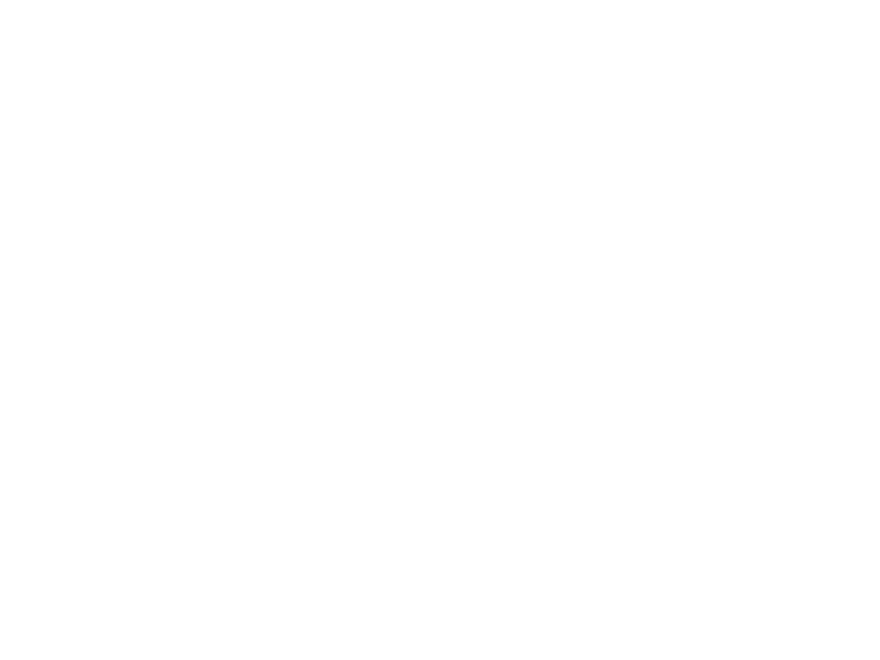

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0001.mp4

D:/HNSCC/HNSCC-01-0001\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


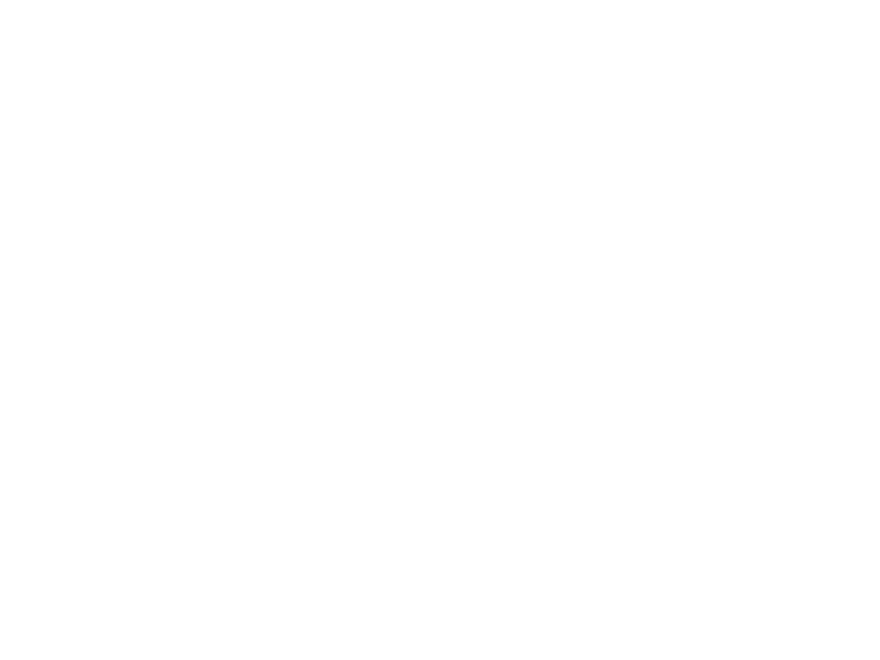

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0001.mp4

D:/HNSCC/HNSCC-01-0001\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


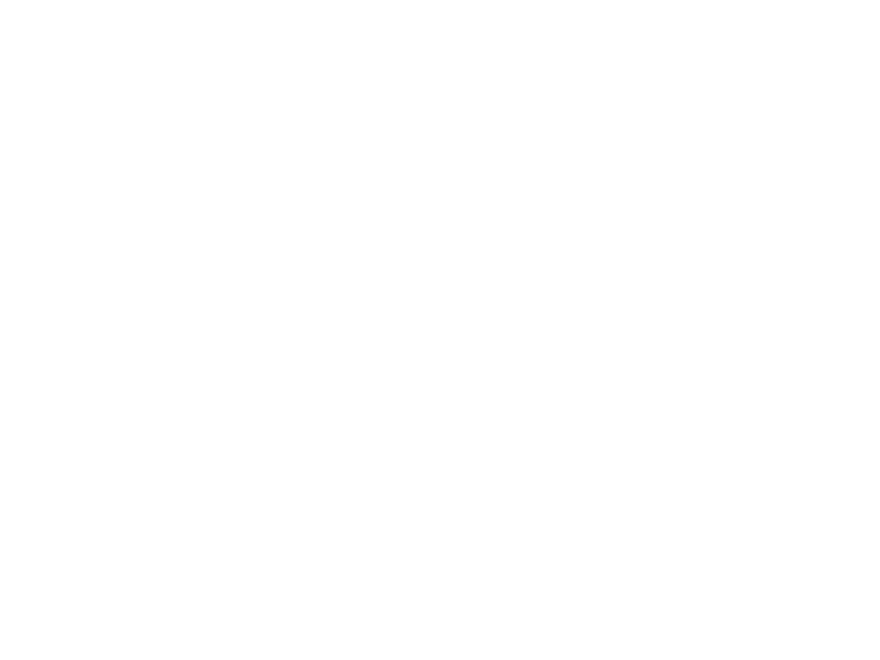

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0001.mp4

D:/HNSCC/HNSCC-01-0001\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0001\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0002\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


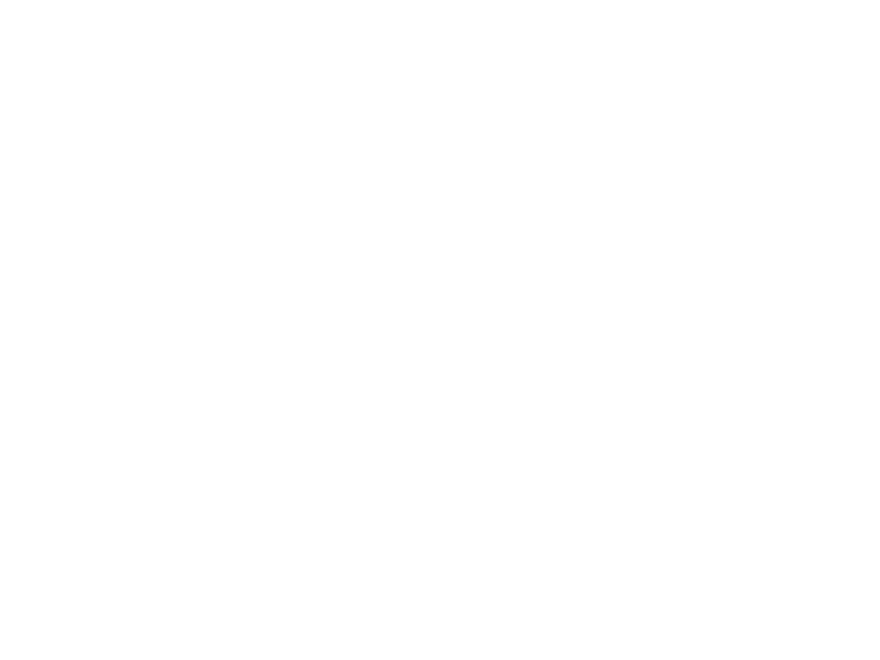

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0002.mp4

D:/HNSCC/HNSCC-01-0002\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


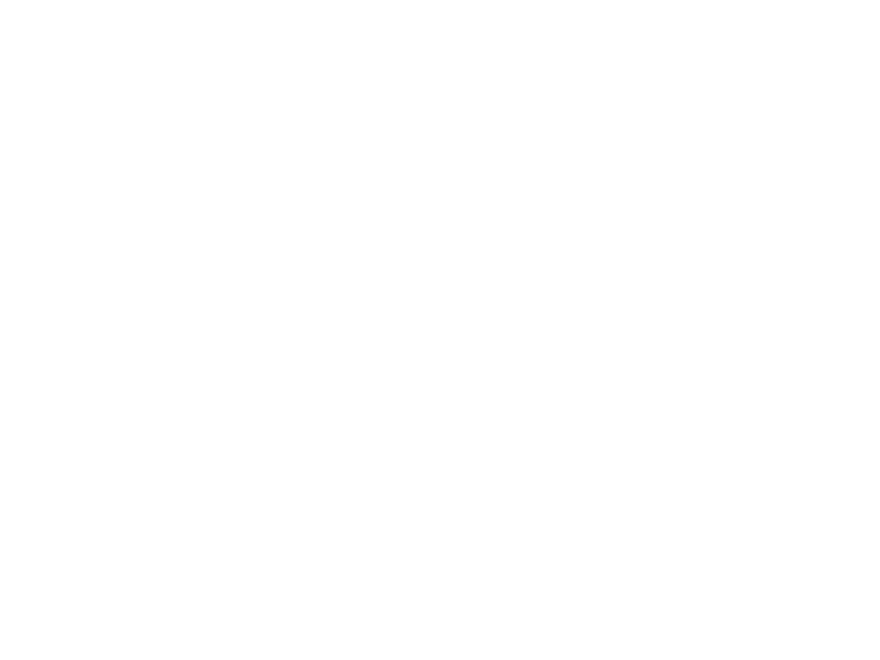

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0002.mp4

D:/HNSCC/HNSCC-01-0002\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


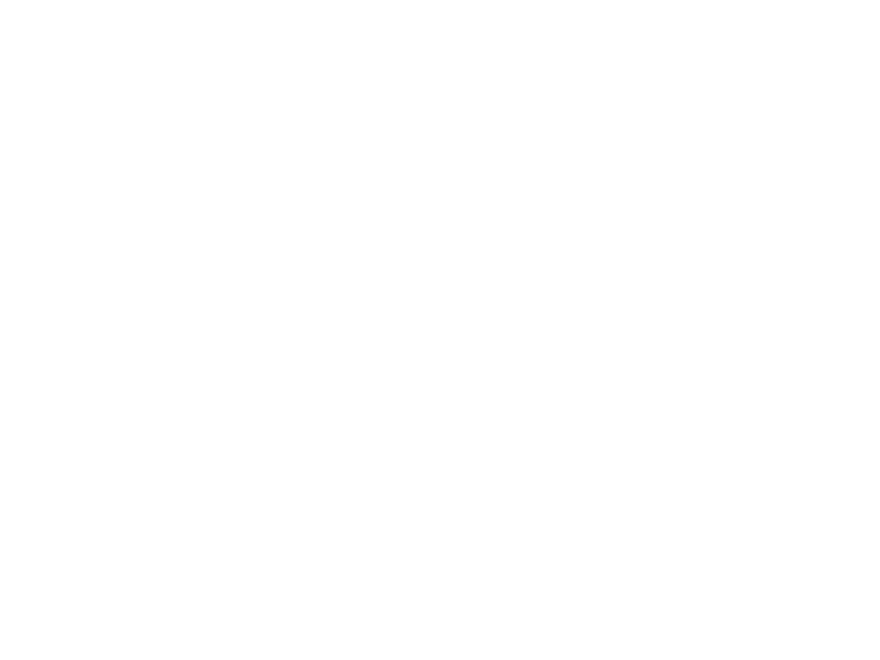

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0002.mp4

D:/HNSCC/HNSCC-01-0002\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0002\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0003\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


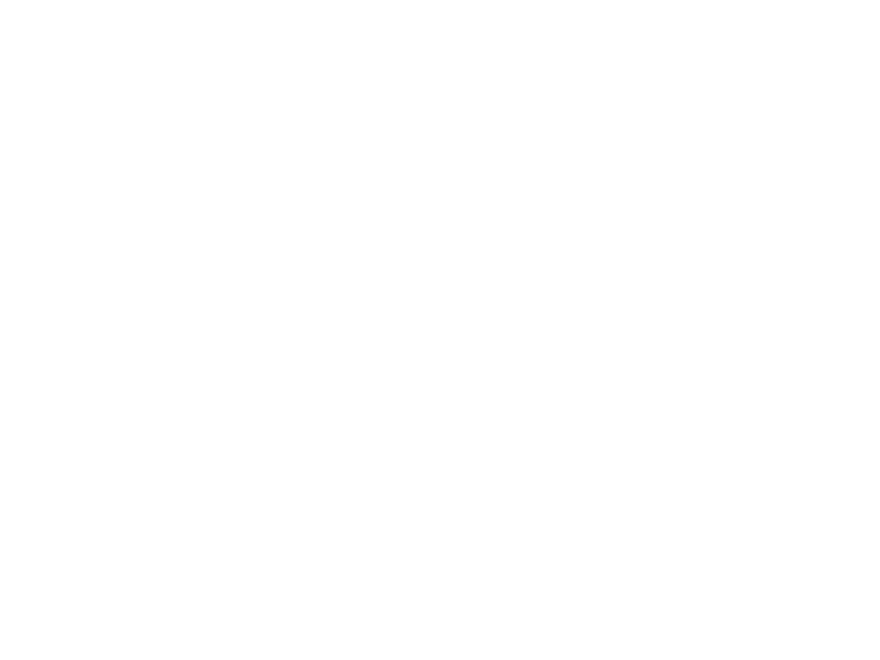

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0003.mp4

D:/HNSCC/HNSCC-01-0003\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


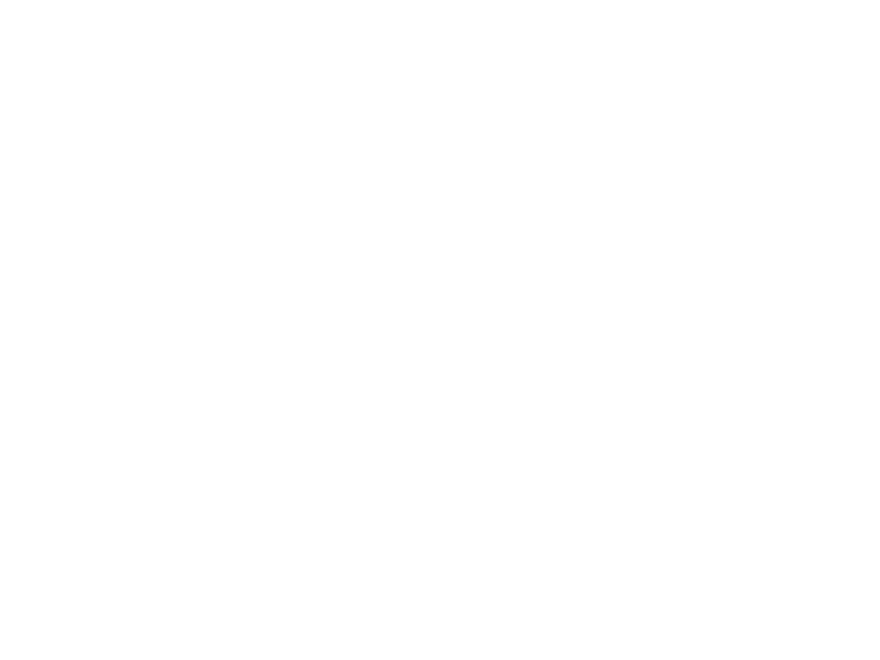

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0003.mp4

D:/HNSCC/HNSCC-01-0003\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


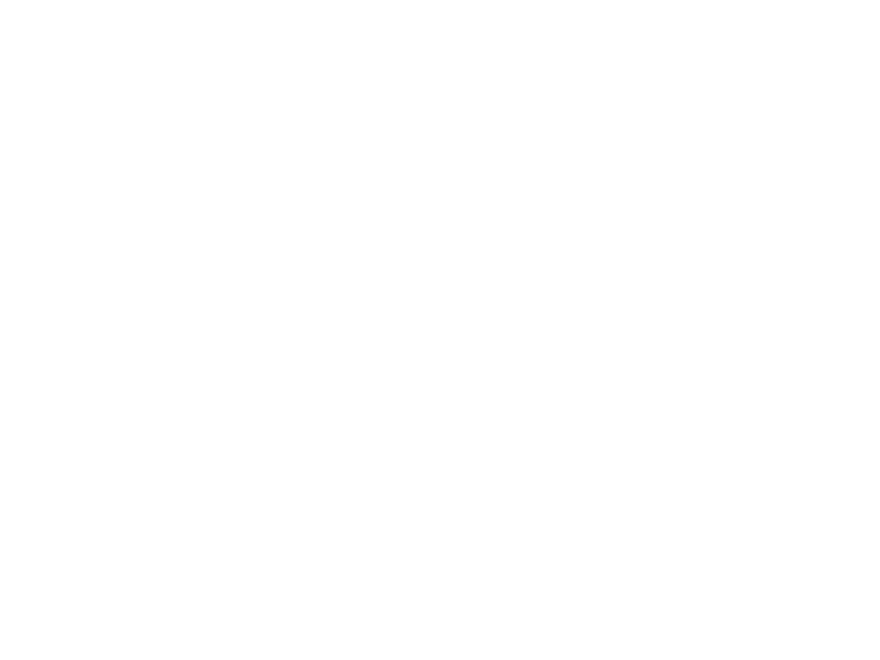

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0003.mp4

D:/HNSCC/HNSCC-01-0003\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


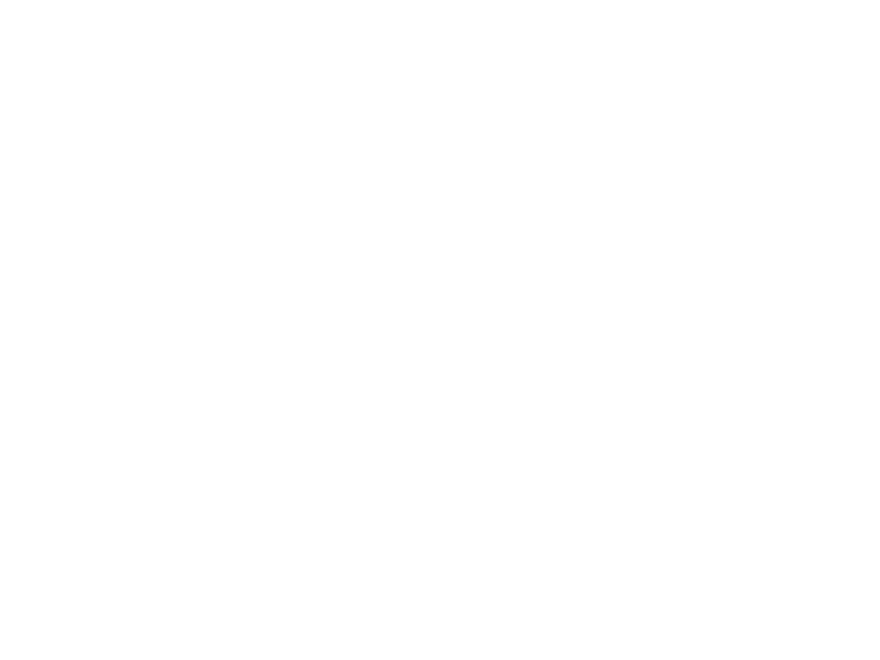

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0003.mp4

D:/HNSCC/HNSCC-01-0003\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


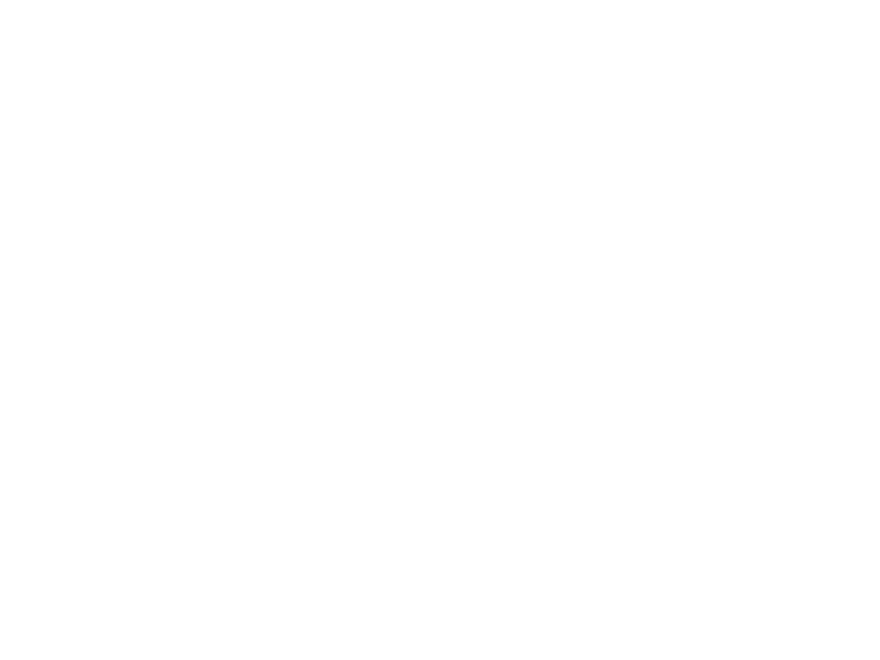

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0003.mp4

D:/HNSCC/HNSCC-01-0004\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0004\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0004\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0004\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0004\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0005\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


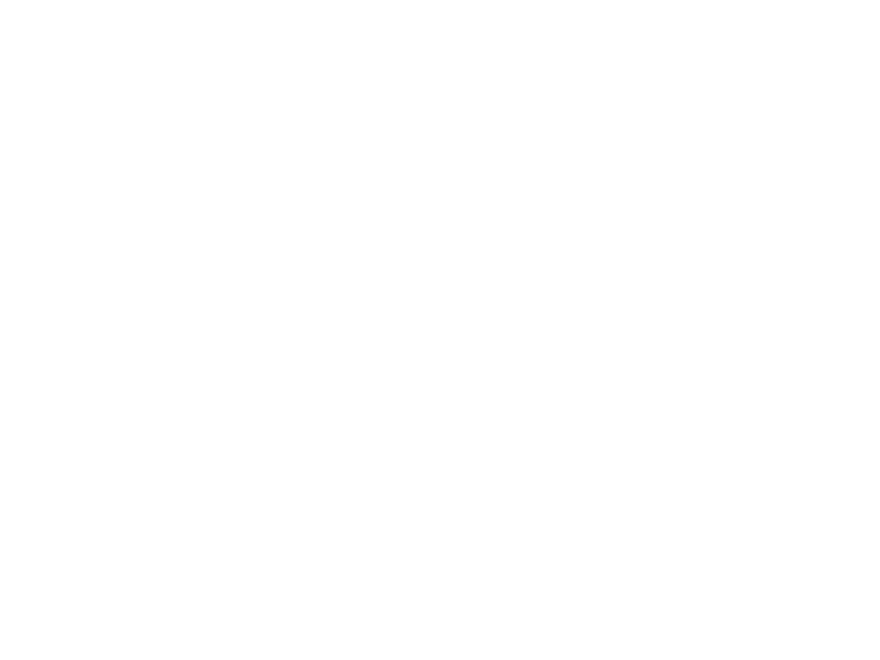

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0005.mp4

D:/HNSCC/HNSCC-01-0005\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


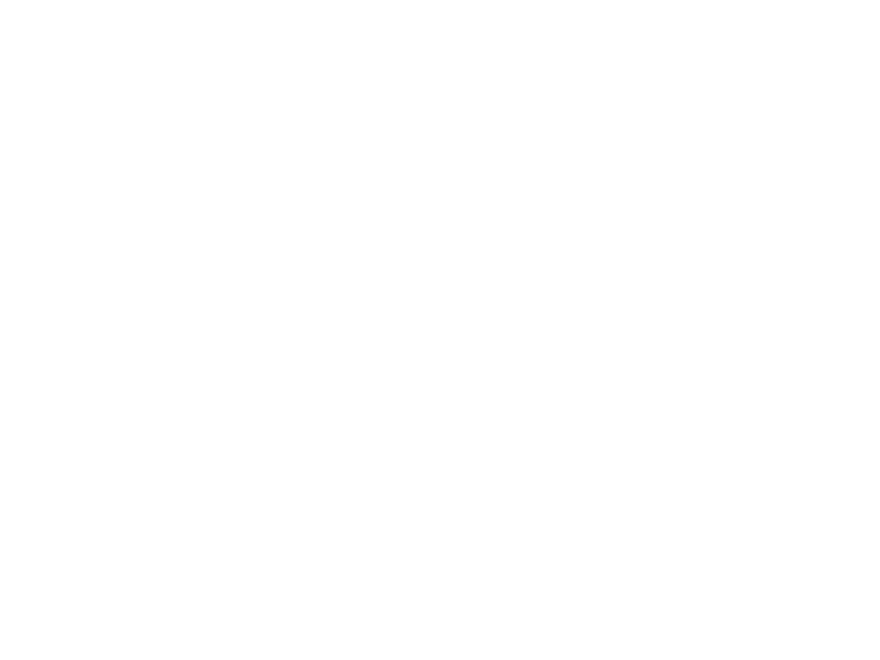

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0005.mp4

D:/HNSCC/HNSCC-01-0005\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


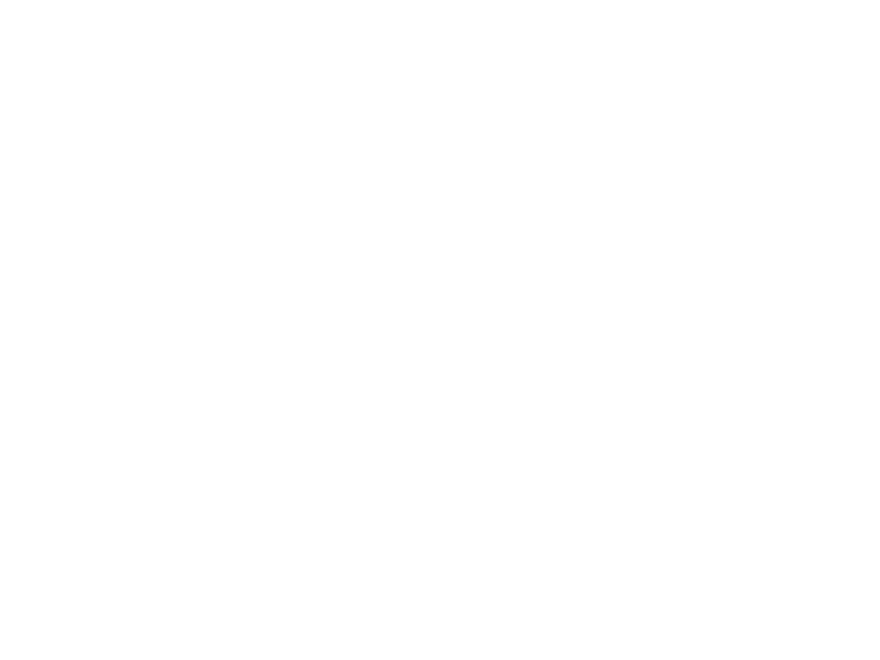

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0005.mp4

D:/HNSCC/HNSCC-01-0005\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0005\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0006\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0006\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0006\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0006\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0006\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0007\
Thickness 1: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


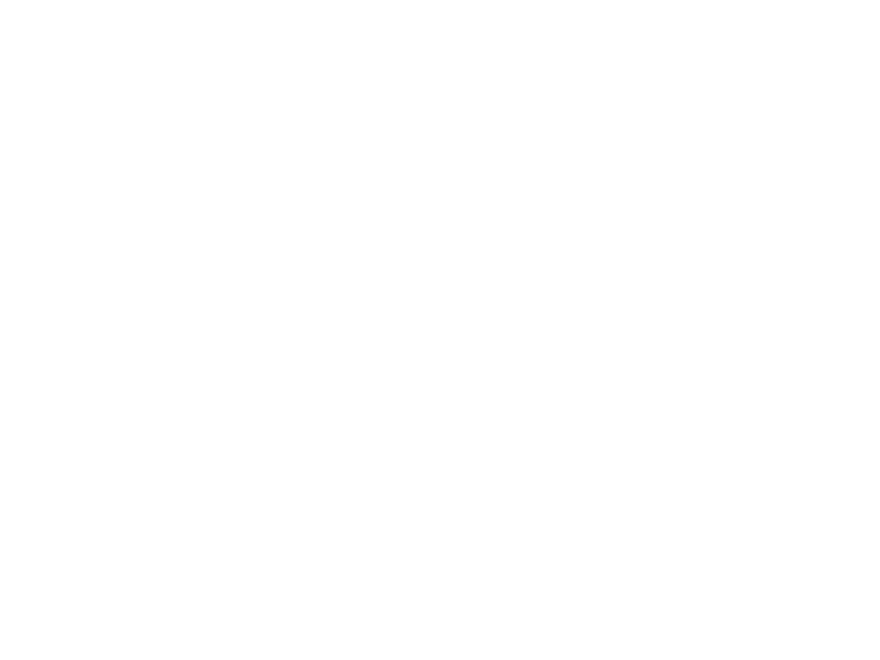

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0007.mp4

D:/HNSCC/HNSCC-01-0007\
Thickness 1: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


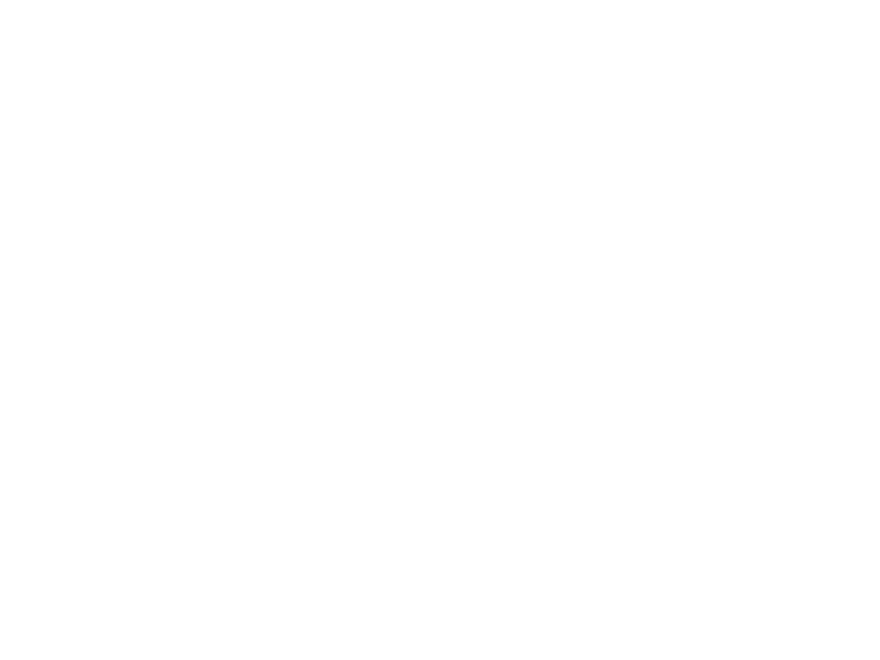

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0007.mp4

D:/HNSCC/HNSCC-01-0007\
Thickness 1: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


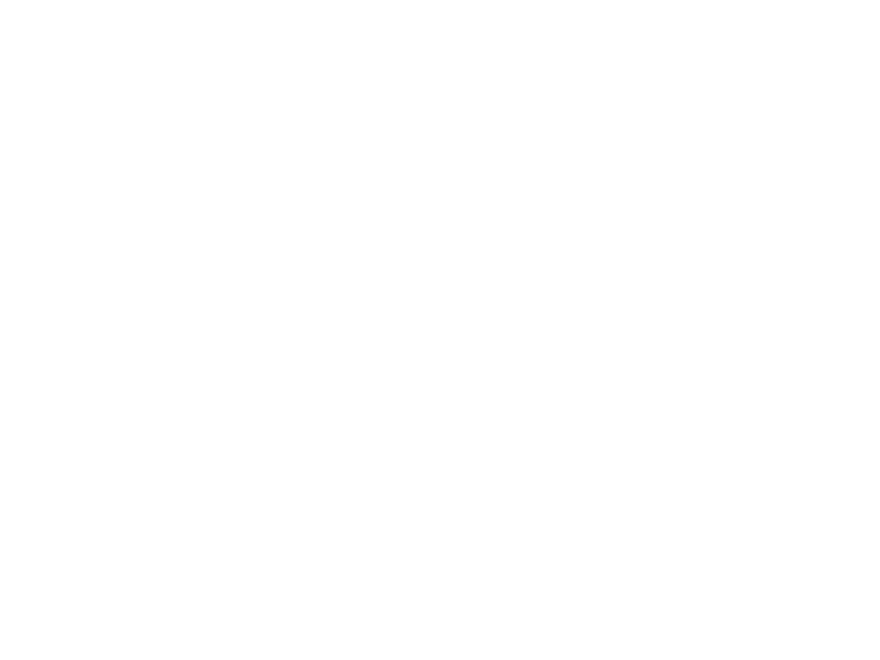

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0007.mp4

D:/HNSCC/HNSCC-01-0007\
Thickness 1: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0007\
Thickness 1: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0008\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


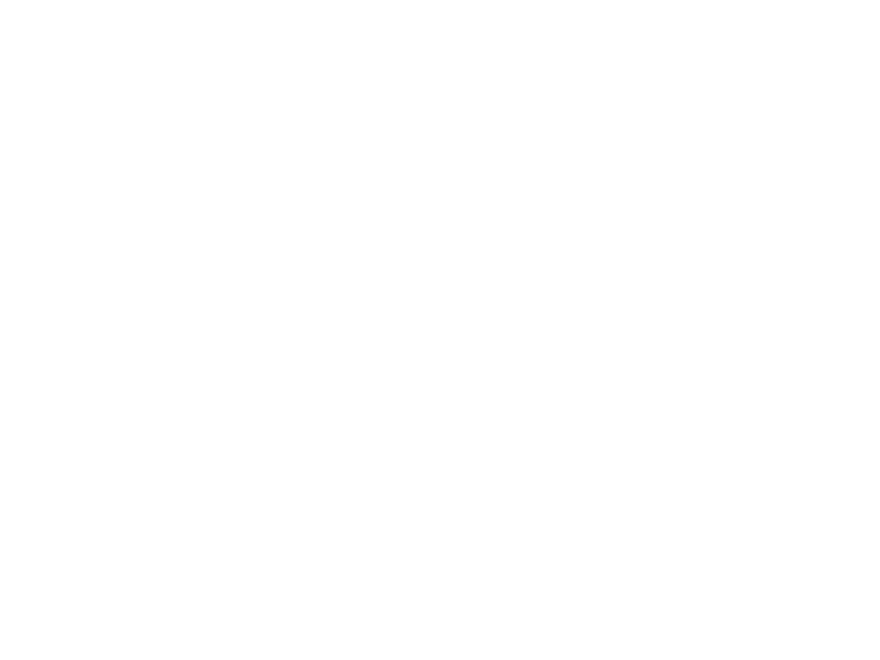

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0008.mp4

D:/HNSCC/HNSCC-01-0008\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


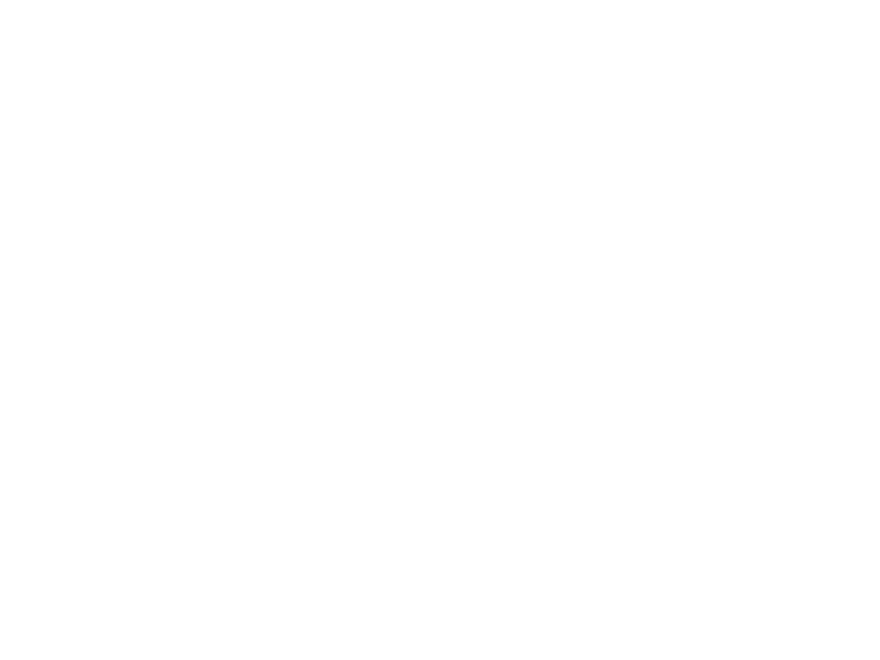

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0008.mp4

D:/HNSCC/HNSCC-01-0008\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


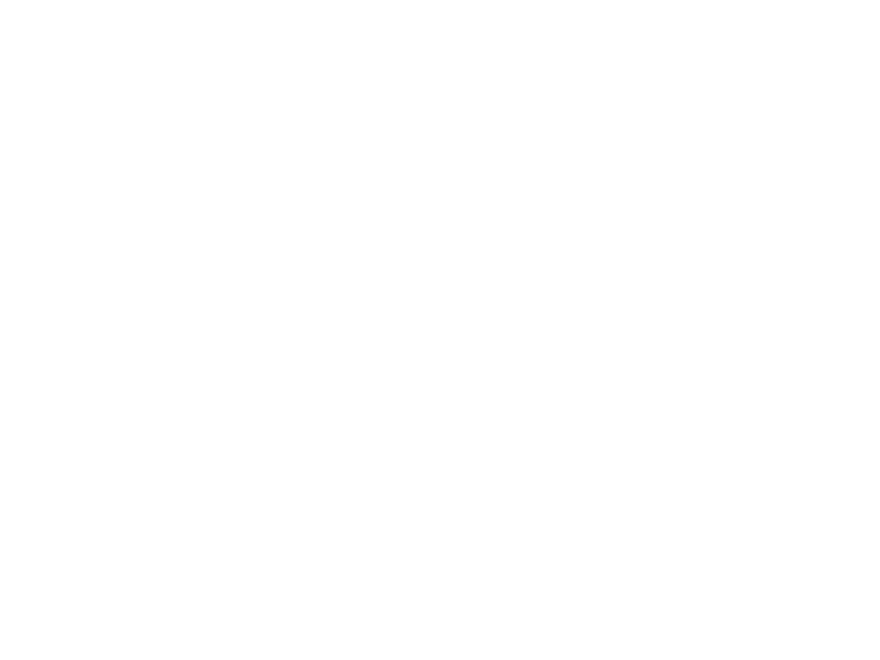

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0008.mp4

D:/HNSCC/HNSCC-01-0008\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0008\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0009\
Thickness 1: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


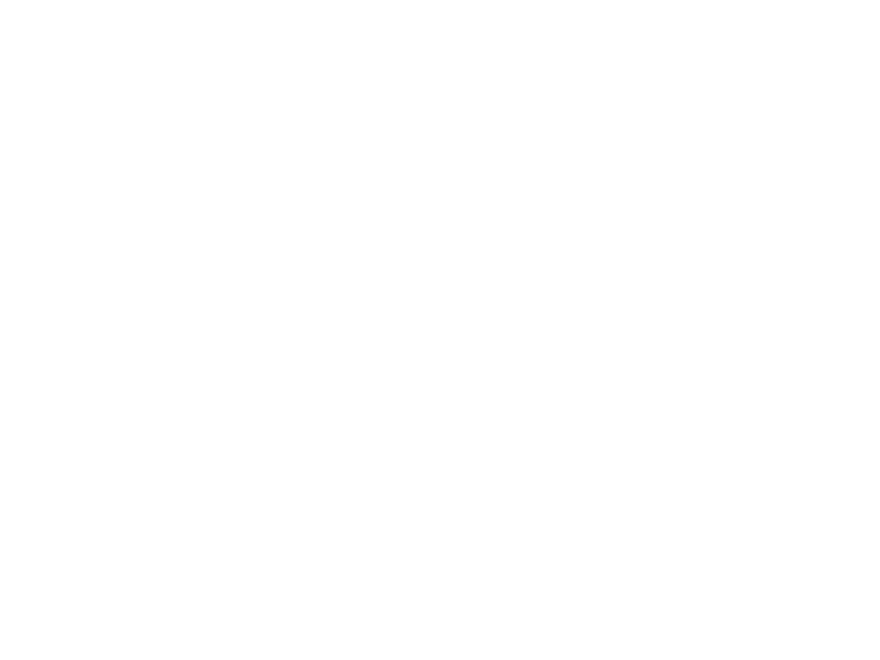

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0009.mp4

D:/HNSCC/HNSCC-01-0009\
Thickness 1: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


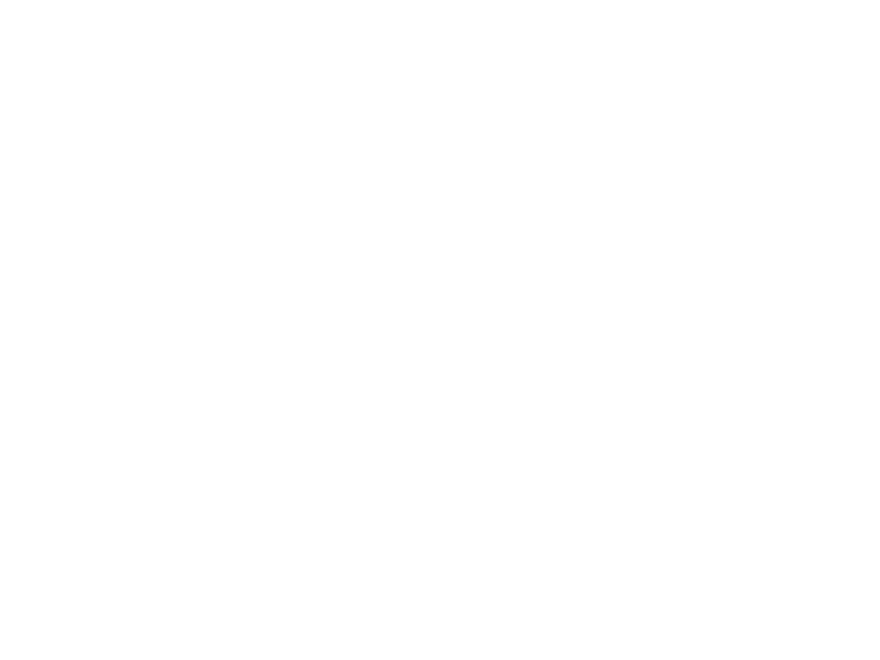

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0009.mp4

D:/HNSCC/HNSCC-01-0009\
Thickness 1: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


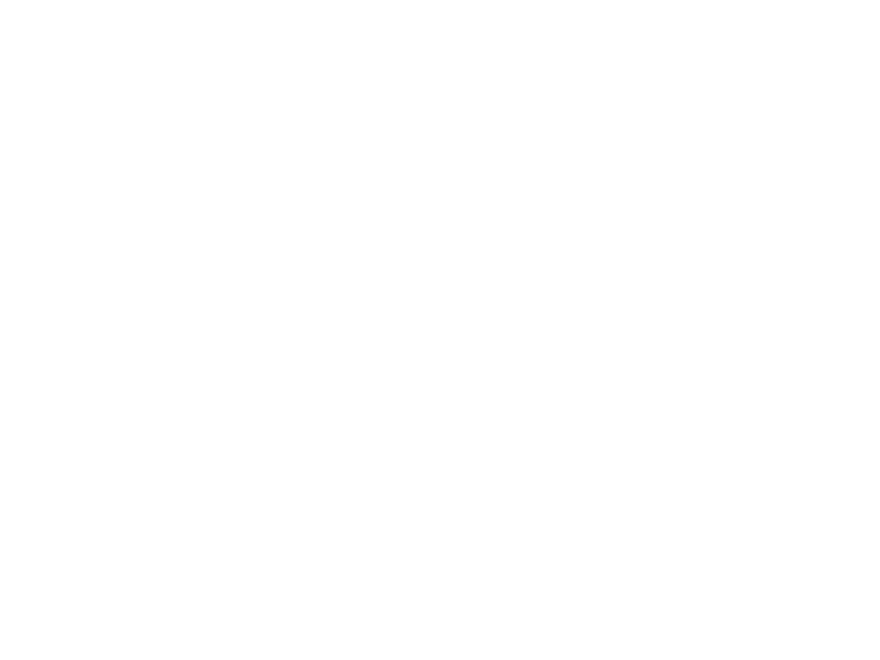

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0009.mp4

D:/HNSCC/HNSCC-01-0009\
Thickness 1: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0009\
Thickness 1: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0010\
Thickness 1: 2.500
Interpolated
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0010\
Thickness 1: 2.500
Interpolated
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0010\
Thickness 1: 2.500
Interpolated
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0010\
Thickness 1: 2.500
Interpolated
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0010\
Thickness 1: 2.500
Interpolated
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0011\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0011\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0011\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0011\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0011\
Thickness

C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


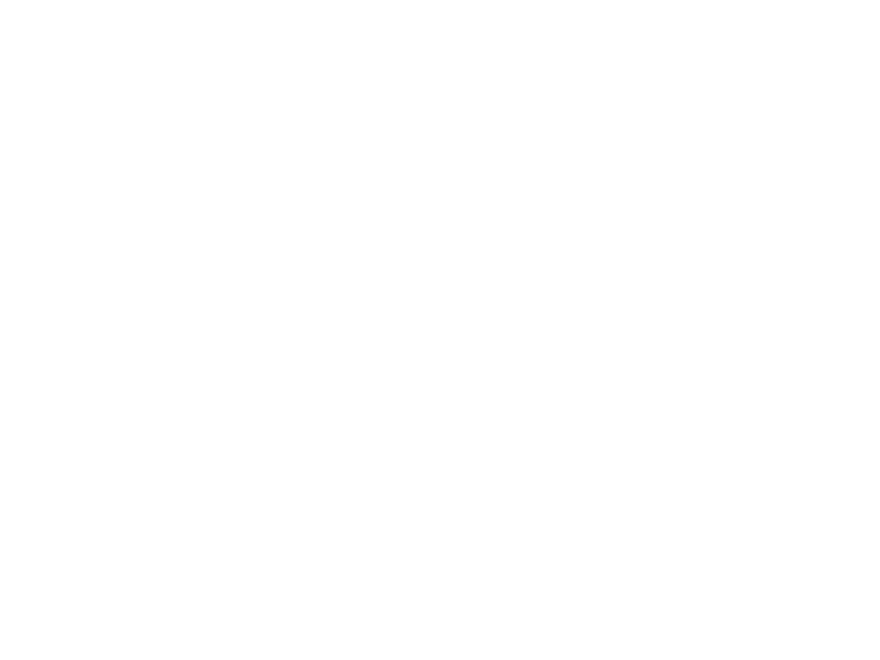

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0012.mp4

D:/HNSCC/HNSCC-01-0012\
Thickness 1: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0012\
Thickness 1: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0013\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0013\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0013\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0013\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0013\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0014\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


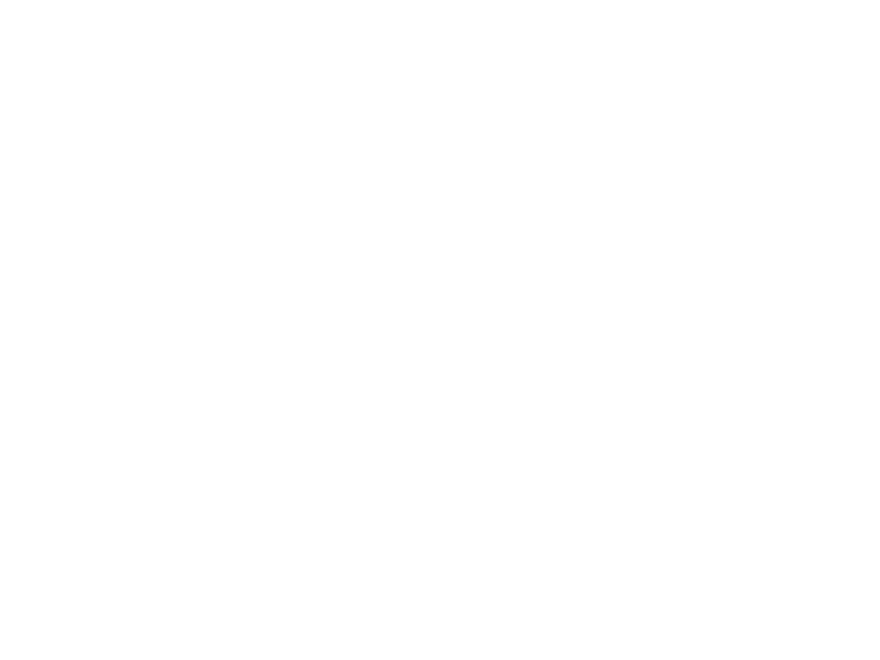

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0014.mp4

D:/HNSCC/HNSCC-01-0014\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


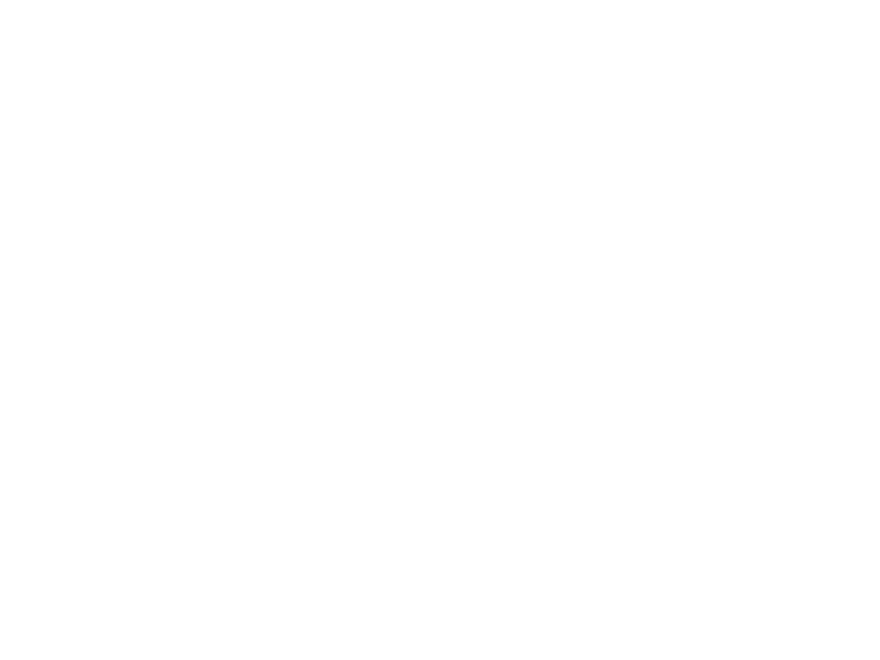

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0014.mp4

D:/HNSCC/HNSCC-01-0014\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


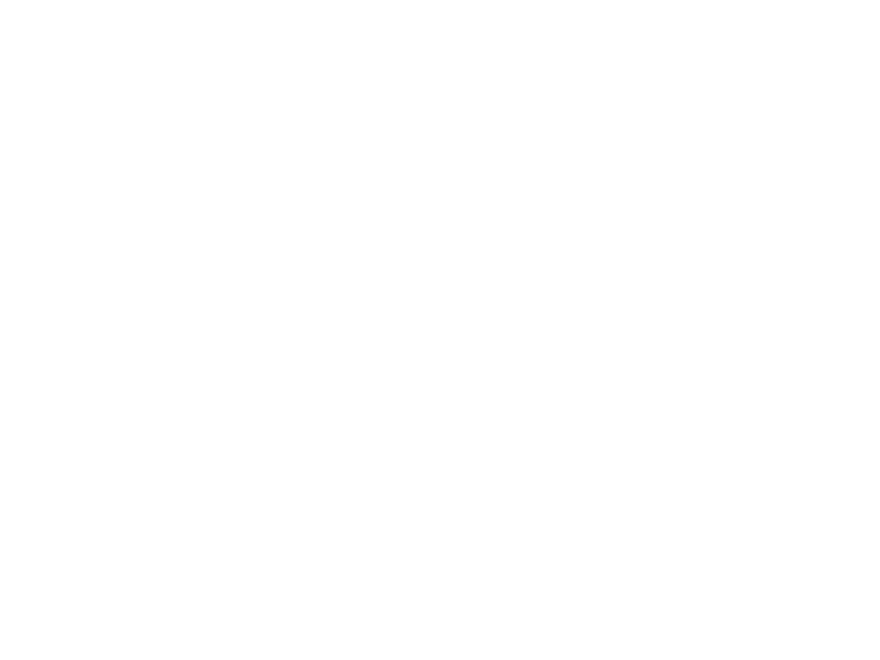

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0014.mp4

D:/HNSCC/HNSCC-01-0014\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0014\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0015\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


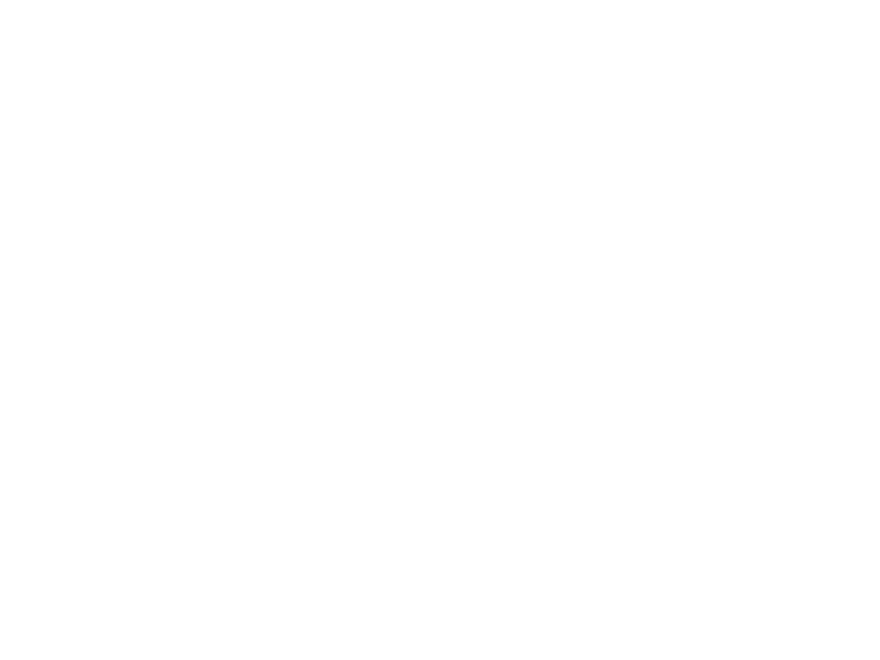

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0015.mp4

D:/HNSCC/HNSCC-01-0015\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


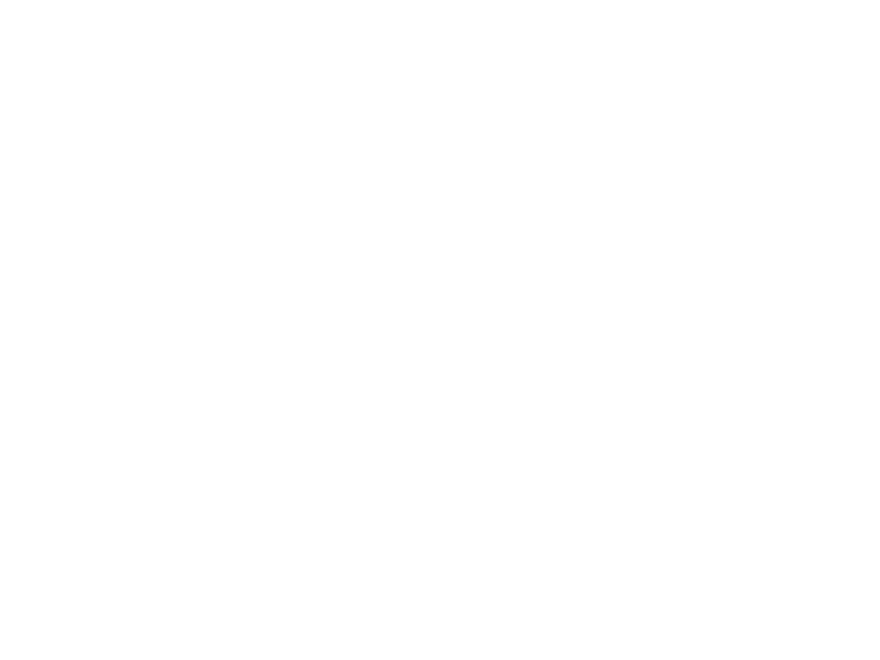

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0015.mp4

D:/HNSCC/HNSCC-01-0015\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


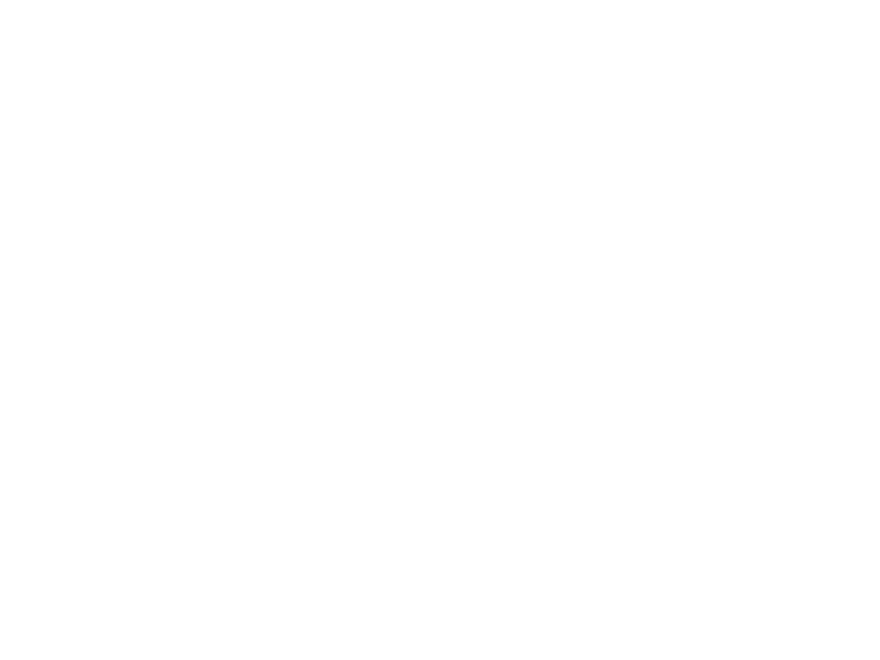

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0015.mp4

D:/HNSCC/HNSCC-01-0015\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0015\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0016\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0016\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0016\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0016\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0016\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0017\
Thickness 1: 3.060
Thickness 3: 3.060
check 3: 3.250
Thickness 3: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


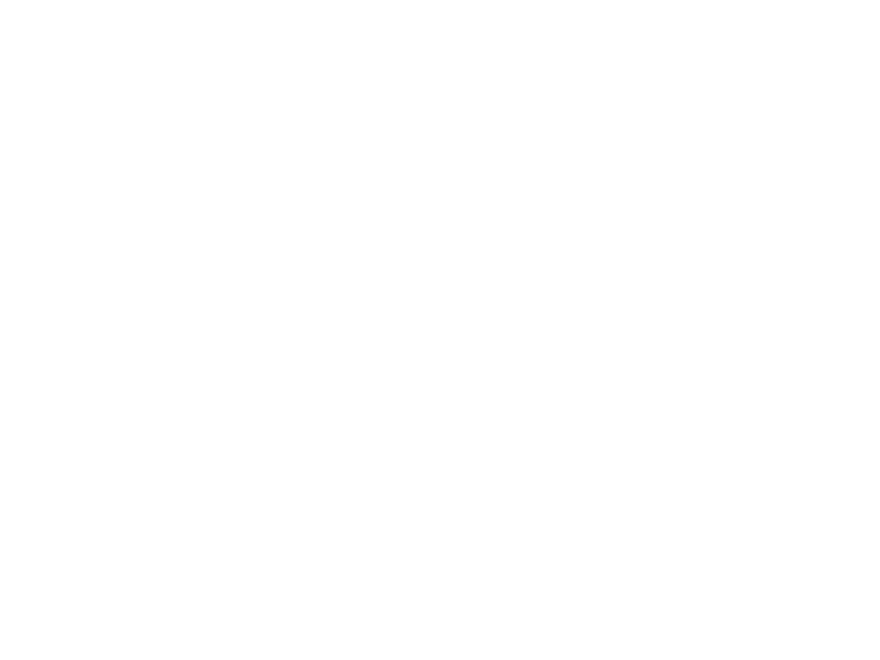

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0017.mp4

D:/HNSCC/HNSCC-01-0017\
Thickness 1: 3.060
Thickness 3: 3.060
check 3: 3.250
Thickness 3: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


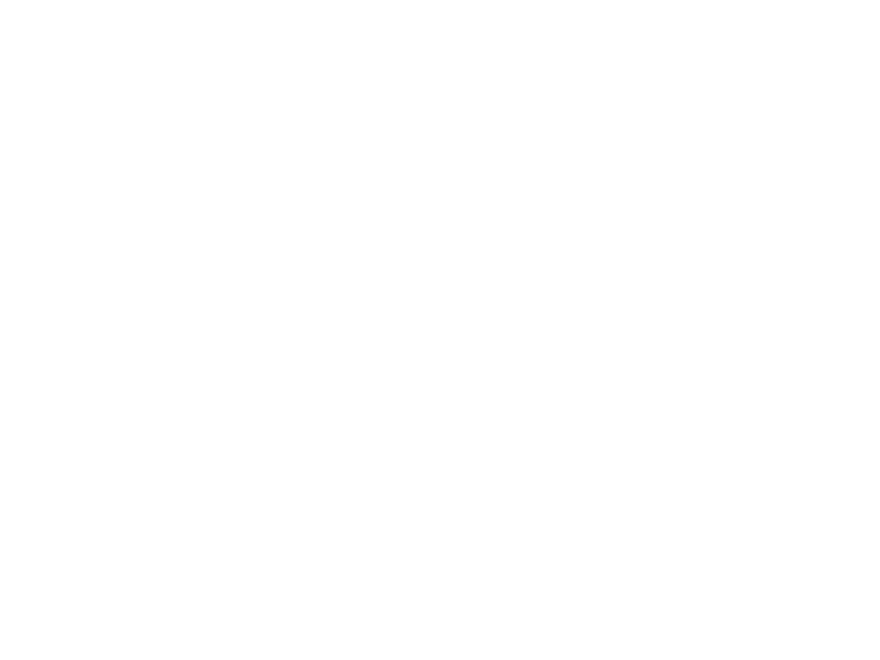

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0017.mp4

D:/HNSCC/HNSCC-01-0017\
Thickness 1: 3.060
Thickness 3: 3.060
check 3: 3.250
Thickness 3: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


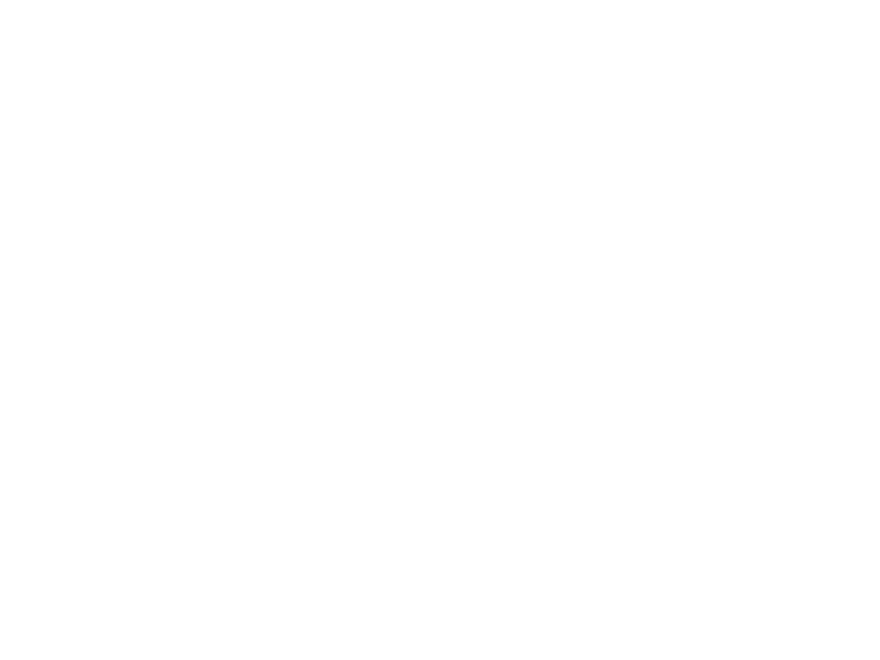

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0017.mp4

D:/HNSCC/HNSCC-01-0017\
Thickness 1: 3.060
Thickness 3: 3.060
check 3: 3.250
Thickness 3: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0017\
Thickness 1: 3.060
Thickness 3: 3.060
check 3: 3.250
Thickness 3: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0018\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0018\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0018\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0018\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0018\
Thickness 1: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0019\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


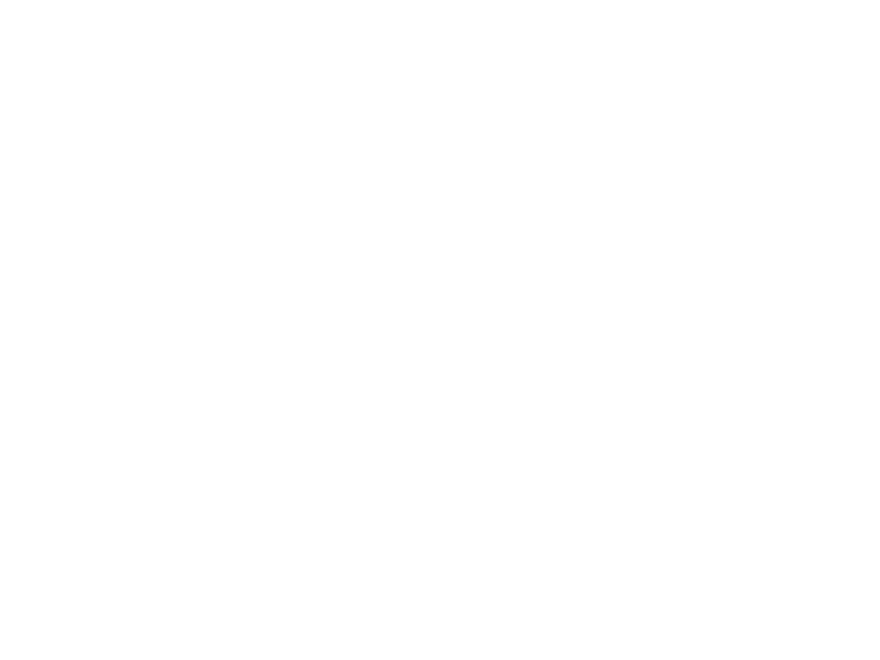

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0019.mp4

D:/HNSCC/HNSCC-01-0019\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


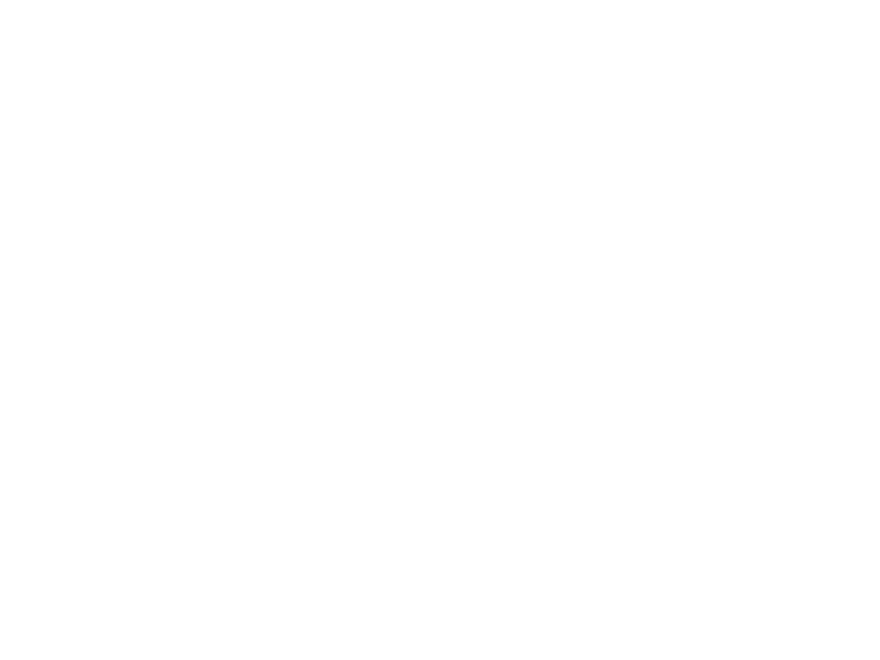

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0019.mp4

D:/HNSCC/HNSCC-01-0019\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


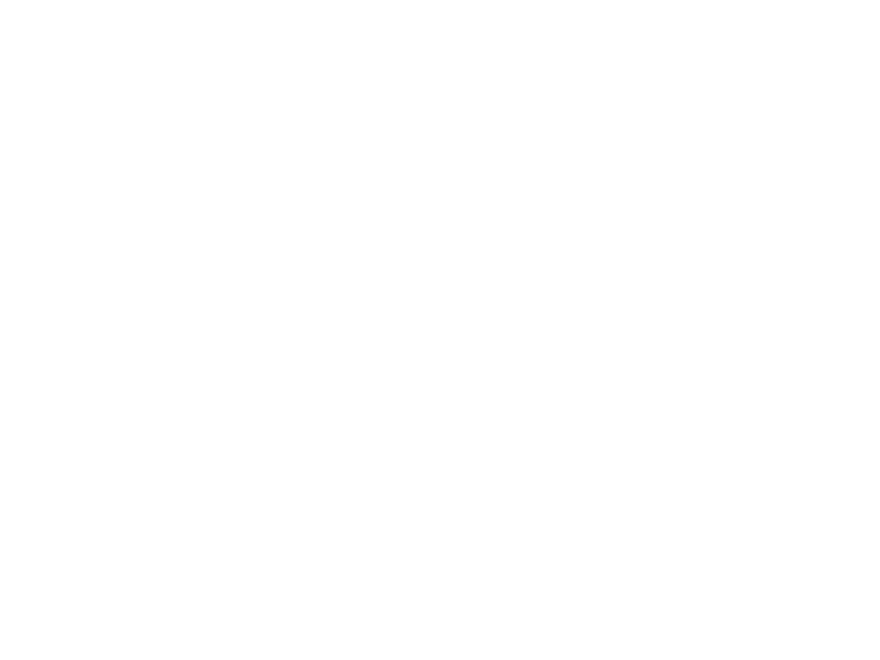

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0019.mp4

D:/HNSCC/HNSCC-01-0019\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0019\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


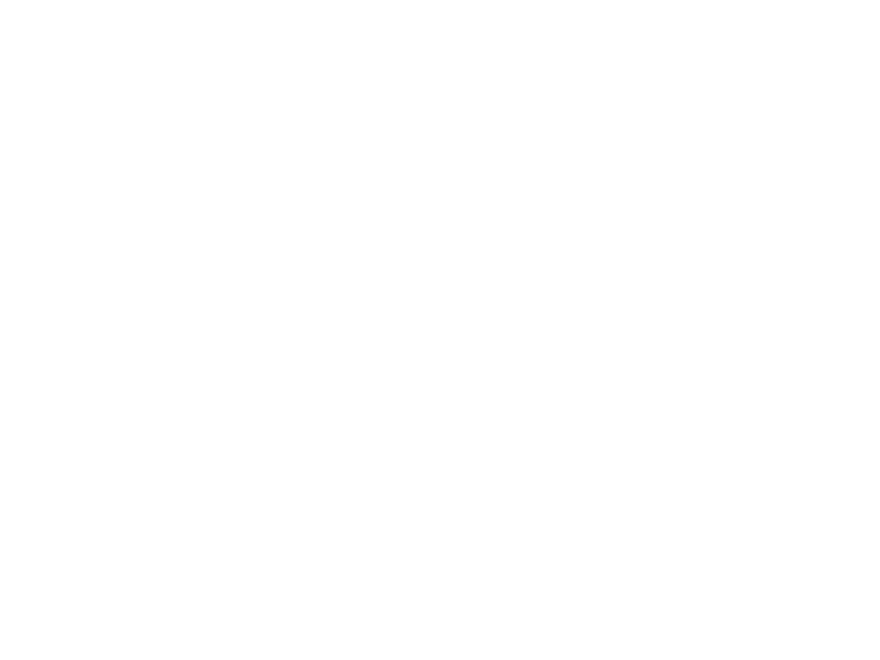

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0020.mp4

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


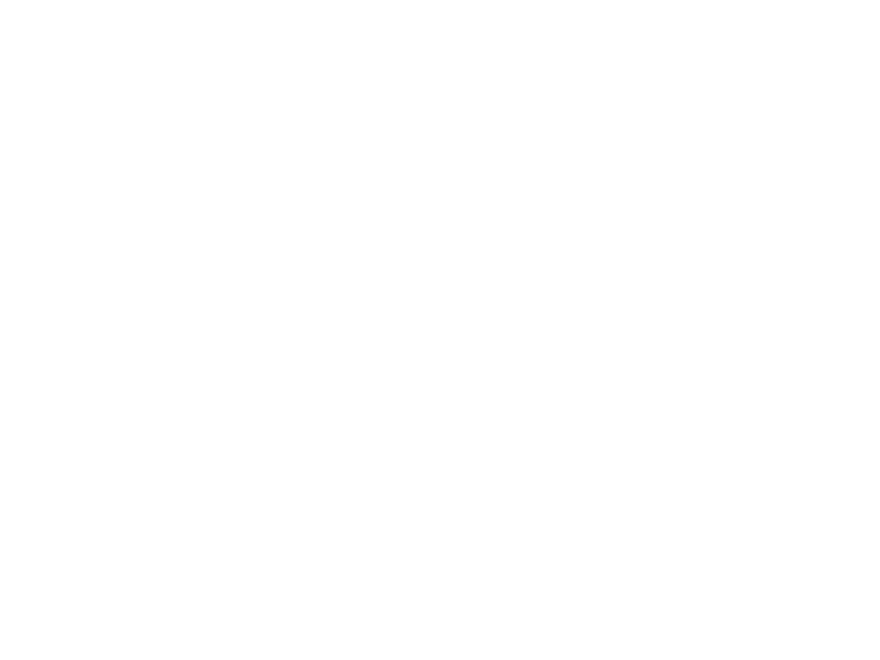

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0020.mp4

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


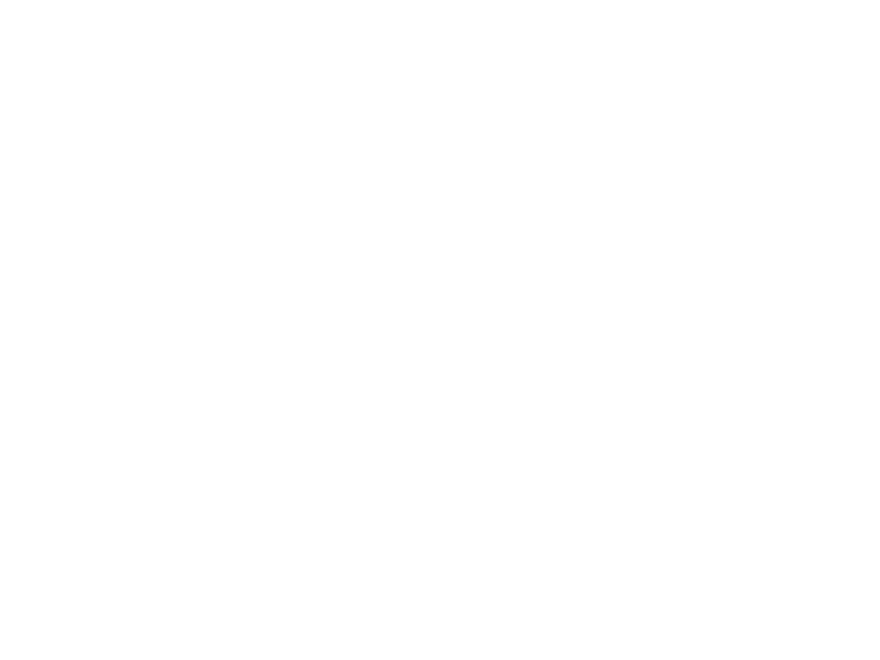

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0020.mp4

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0020\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


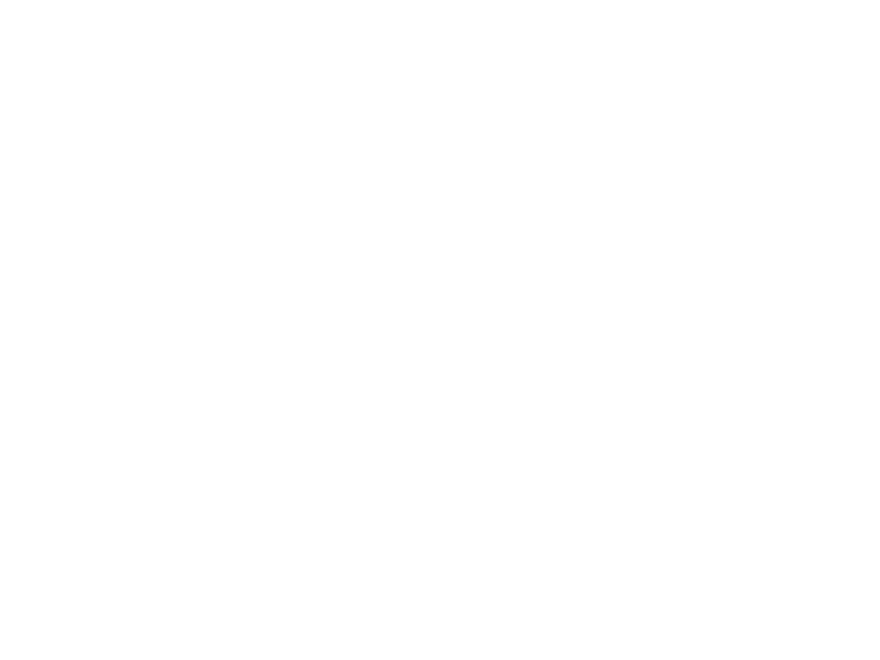

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0021.mp4

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


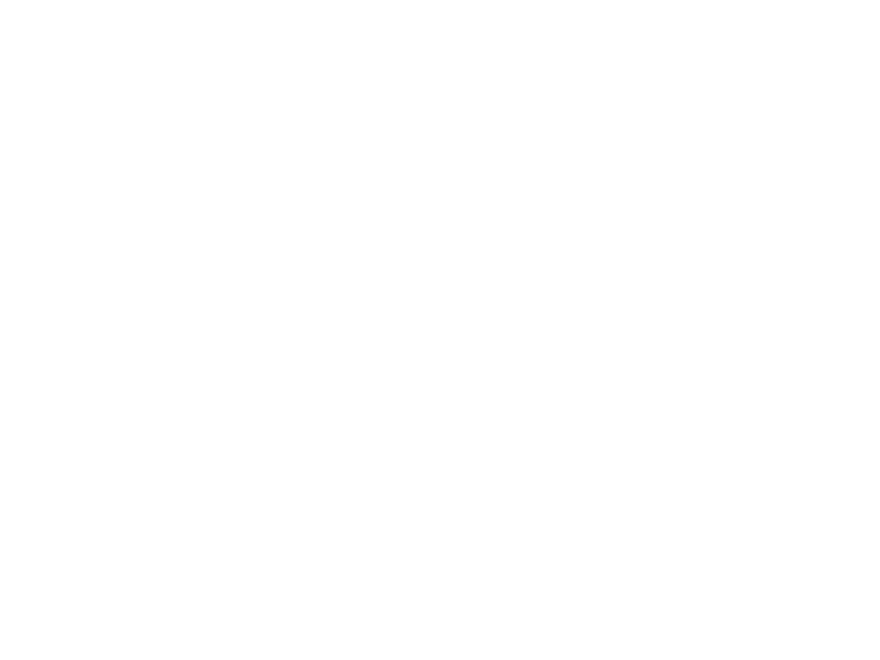

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0021.mp4

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


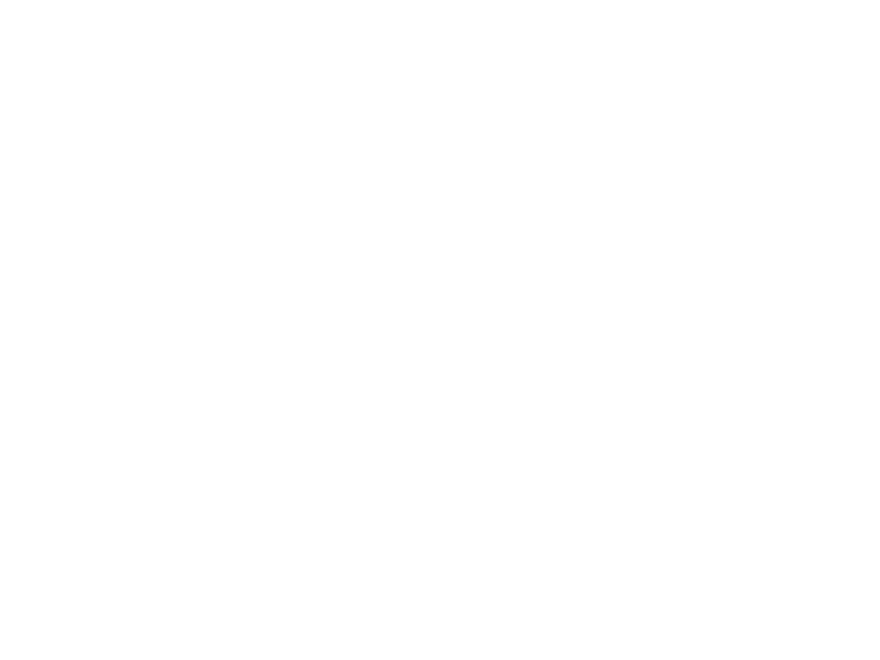

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0021.mp4

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0021\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0022\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


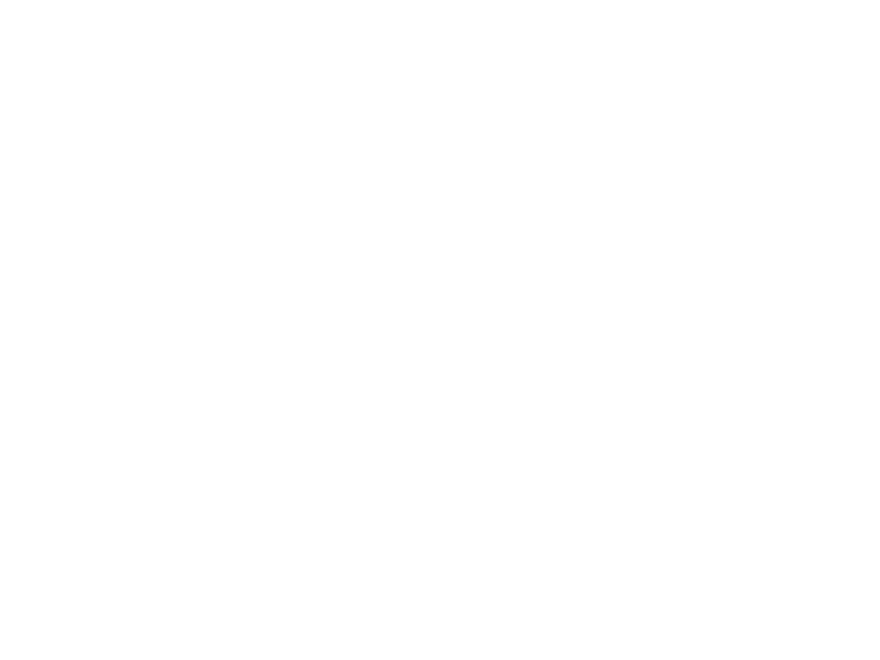

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0022.mp4

D:/HNSCC/HNSCC-01-0022\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


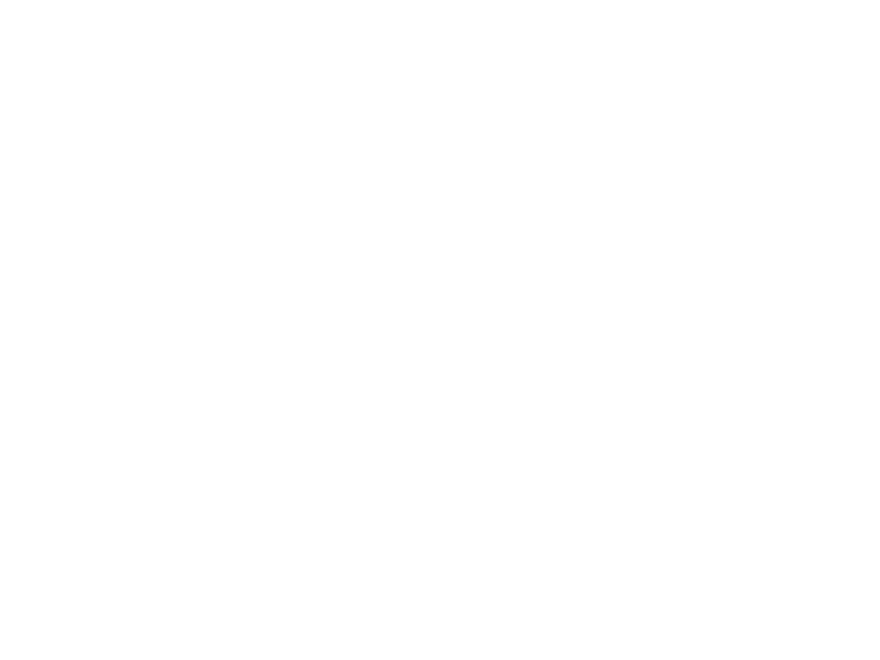

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0022.mp4

D:/HNSCC/HNSCC-01-0022\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


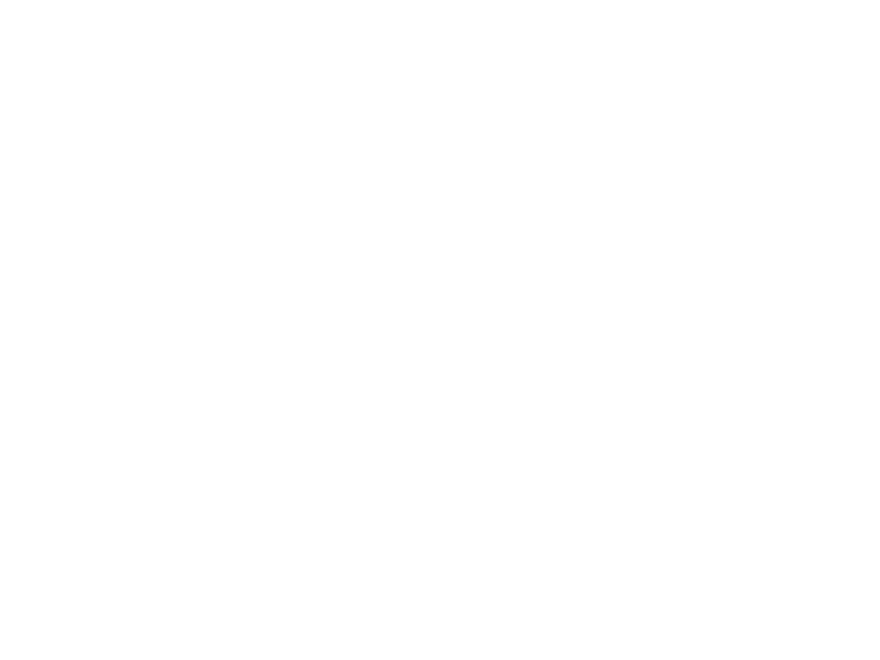

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0022.mp4

D:/HNSCC/HNSCC-01-0022\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0022\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0023\


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\pydicom\filereader.py:313: UserWarning: Expected explicit VR, but found implicit VR - using implicit VR for reading
  warnings.warn(message, UserWarning)


Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
Interpolated
Thickness 2: 3.750
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0023\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
Interpolated
Thickness 2: 3.750
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0023\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
Interpolated
Thickness 2: 3.750
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0023\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
Interpolated
Thickness 2: 3.750
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0023\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
Interpolated
Thickness 2: 3.750
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0026\
Thickness 1: 2.940
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


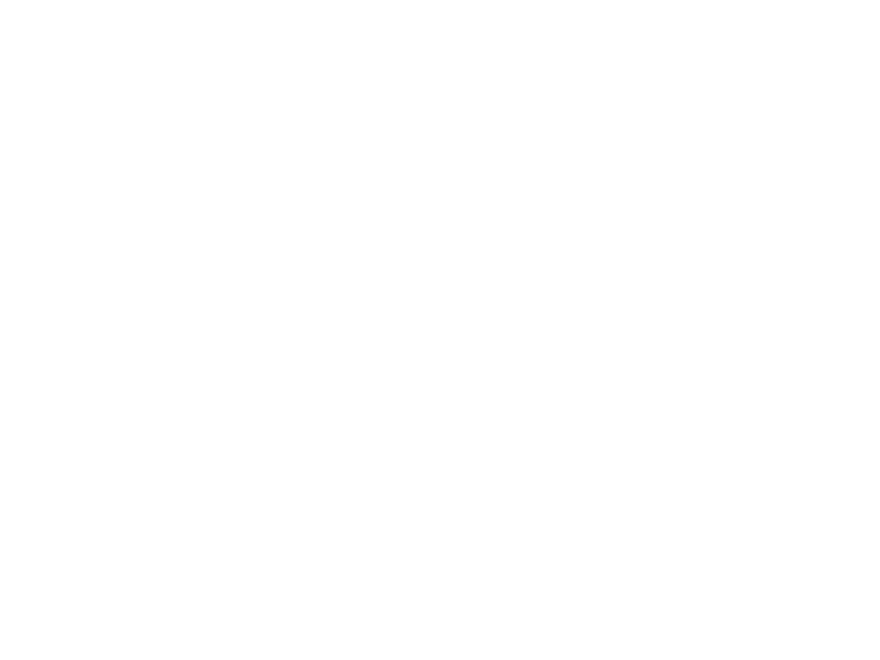

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0026.mp4

D:/HNSCC/HNSCC-01-0026\
Thickness 1: 2.940
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


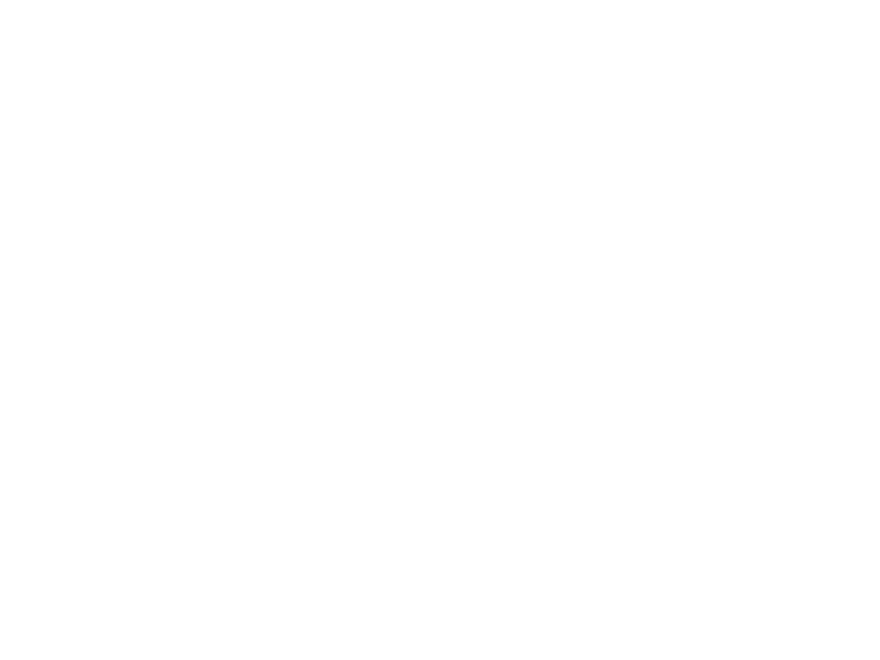

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0026.mp4

D:/HNSCC/HNSCC-01-0026\
Thickness 1: 2.940
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


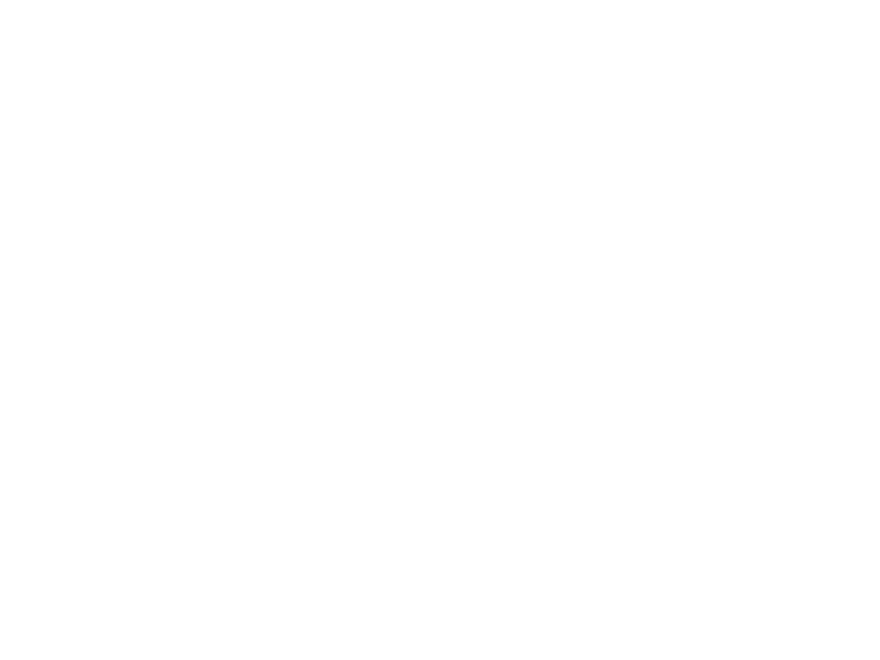

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0026.mp4

D:/HNSCC/HNSCC-01-0026\
Thickness 1: 2.940
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0026\
Thickness 1: 2.940
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0027\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


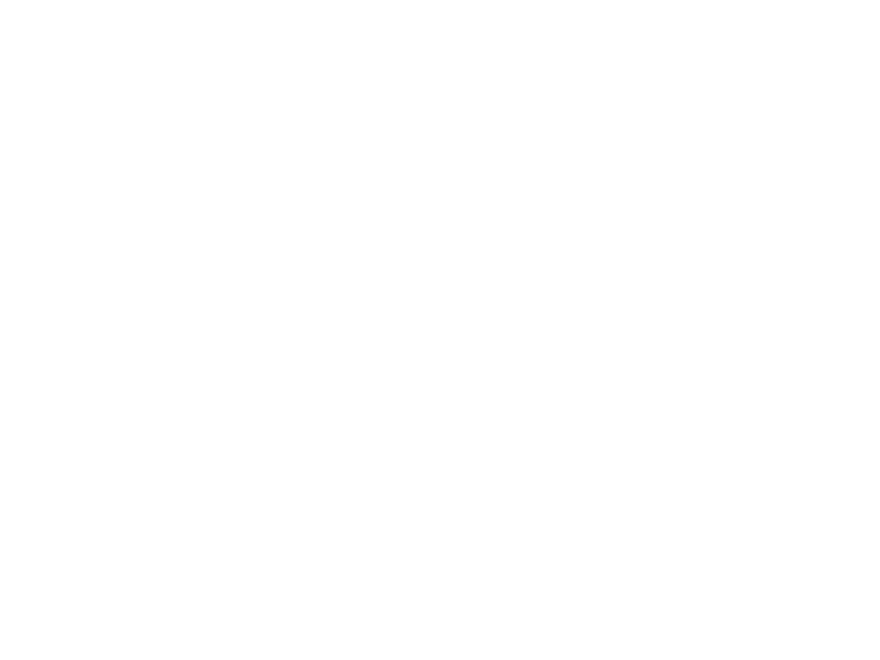

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0027.mp4

D:/HNSCC/HNSCC-01-0027\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


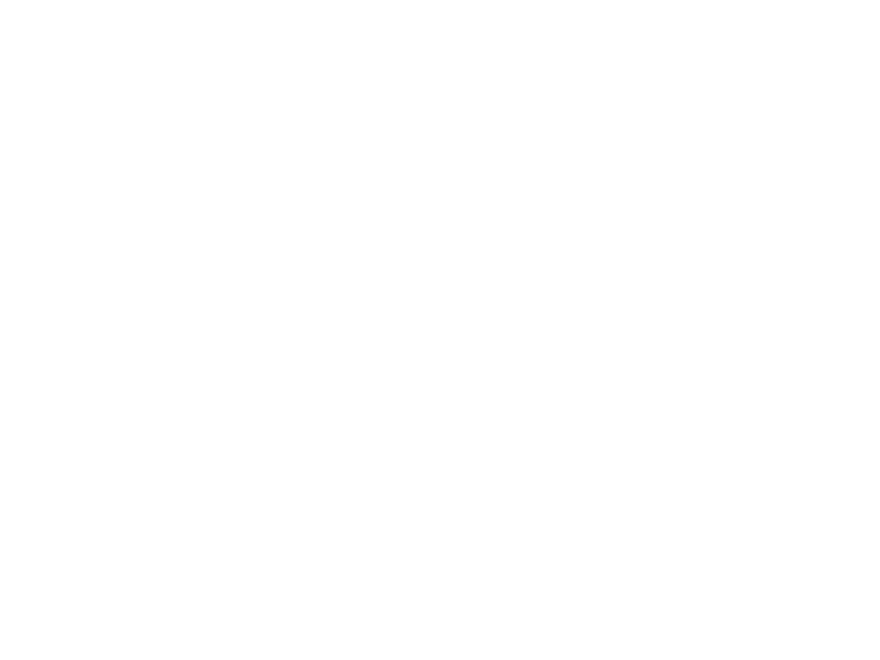

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0027.mp4

D:/HNSCC/HNSCC-01-0027\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


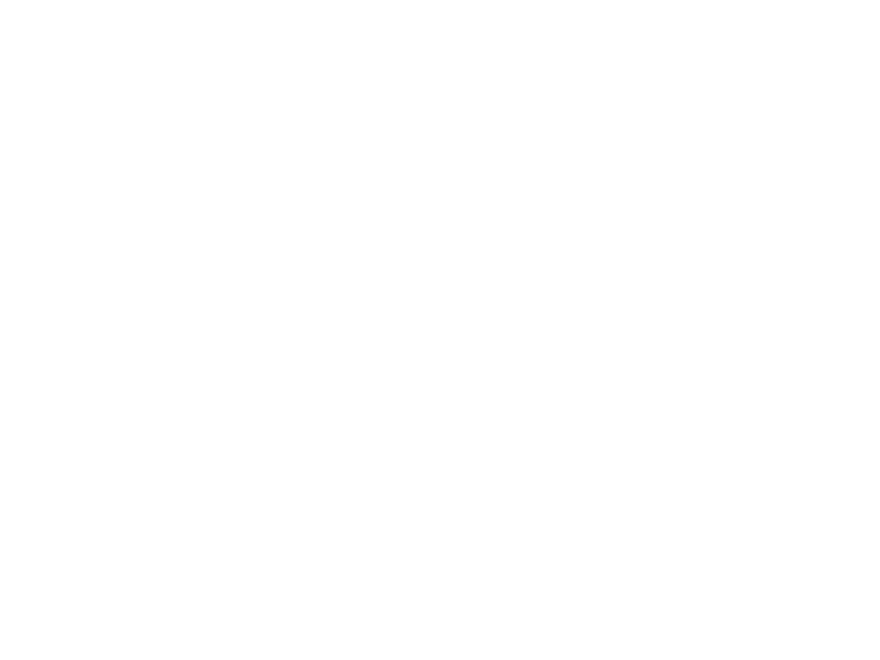

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0027.mp4

D:/HNSCC/HNSCC-01-0027\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0027\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0028\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0028\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0028\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0028\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0028\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
T

C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


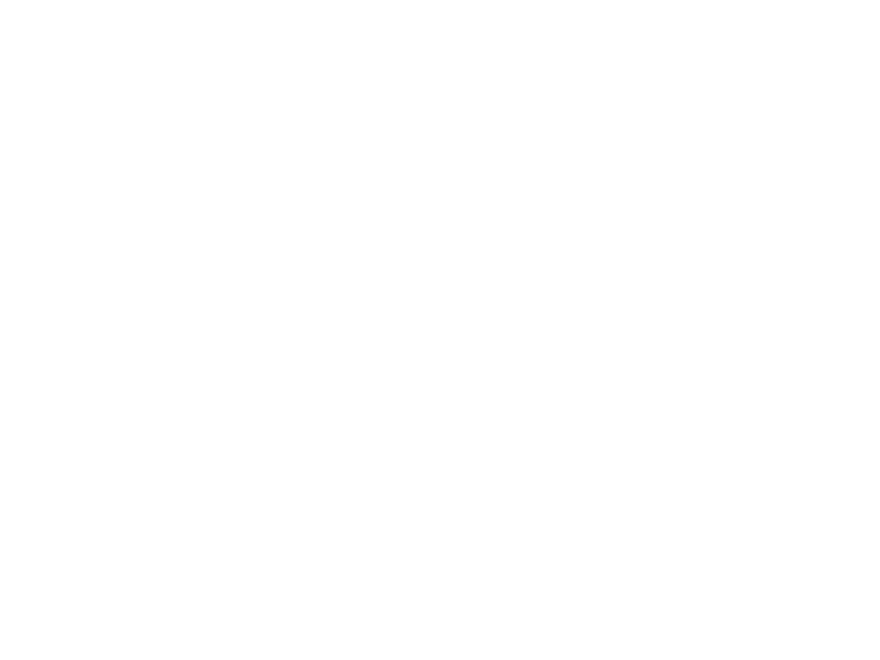

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0029.mp4

D:/HNSCC/HNSCC-01-0029\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


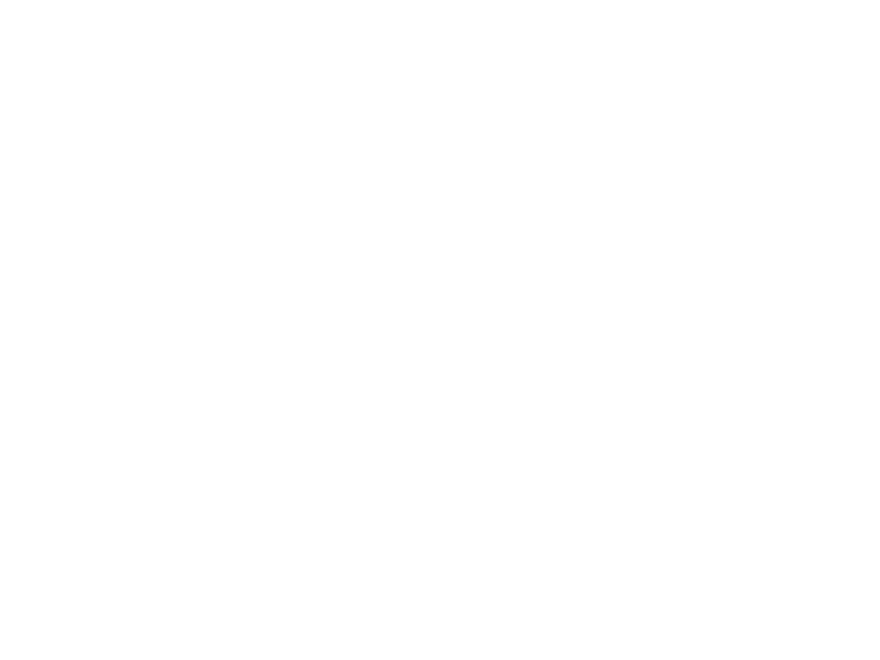

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0029.mp4

D:/HNSCC/HNSCC-01-0029\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


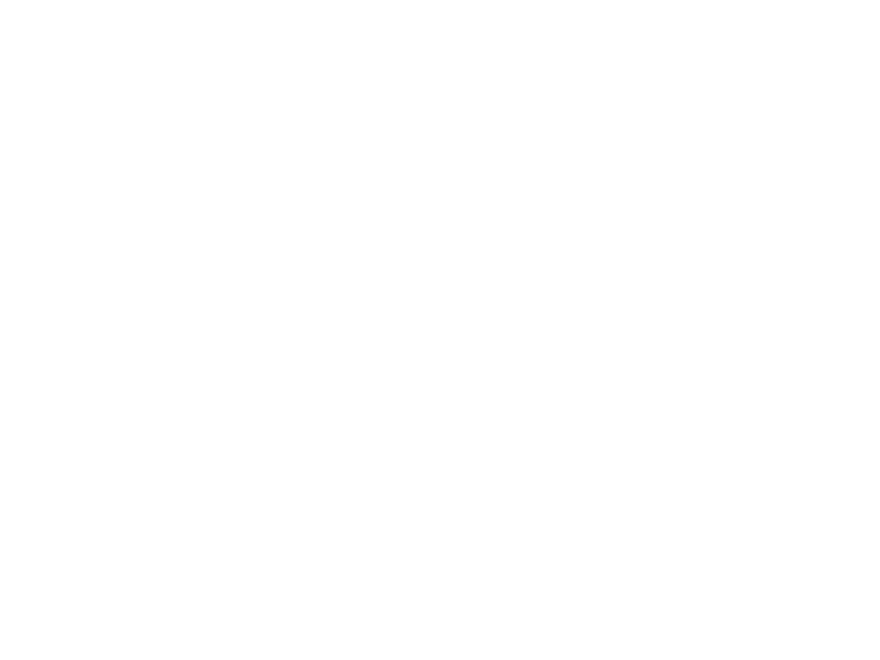

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0029.mp4

D:/HNSCC/HNSCC-01-0029\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0029\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0030\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


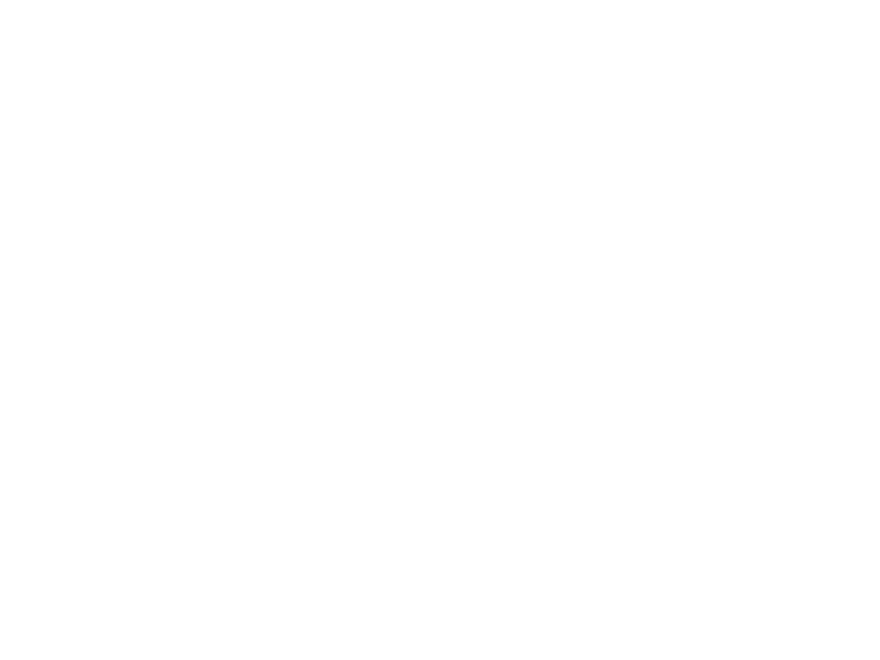

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0030.mp4

D:/HNSCC/HNSCC-01-0030\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


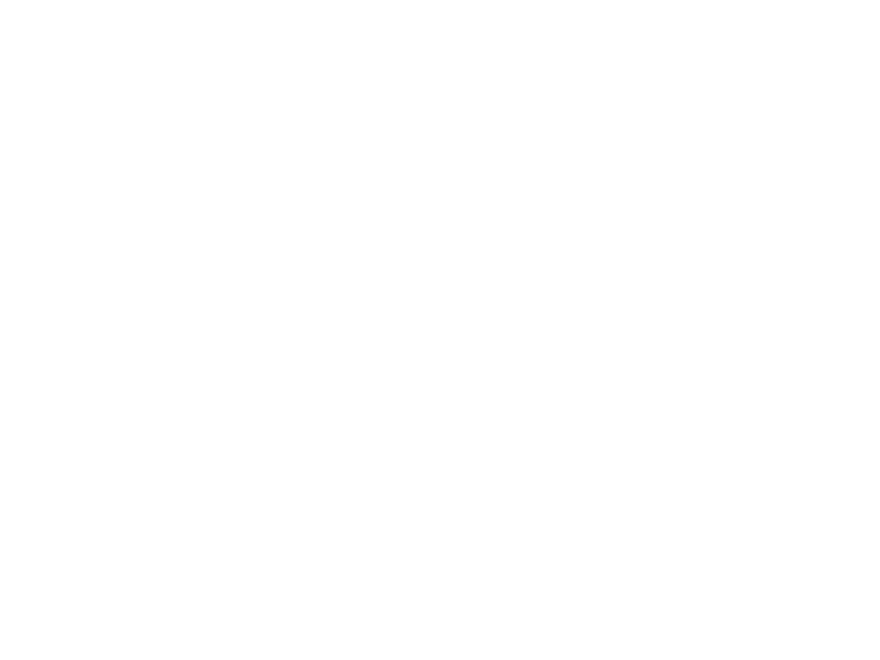

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0030.mp4

D:/HNSCC/HNSCC-01-0030\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


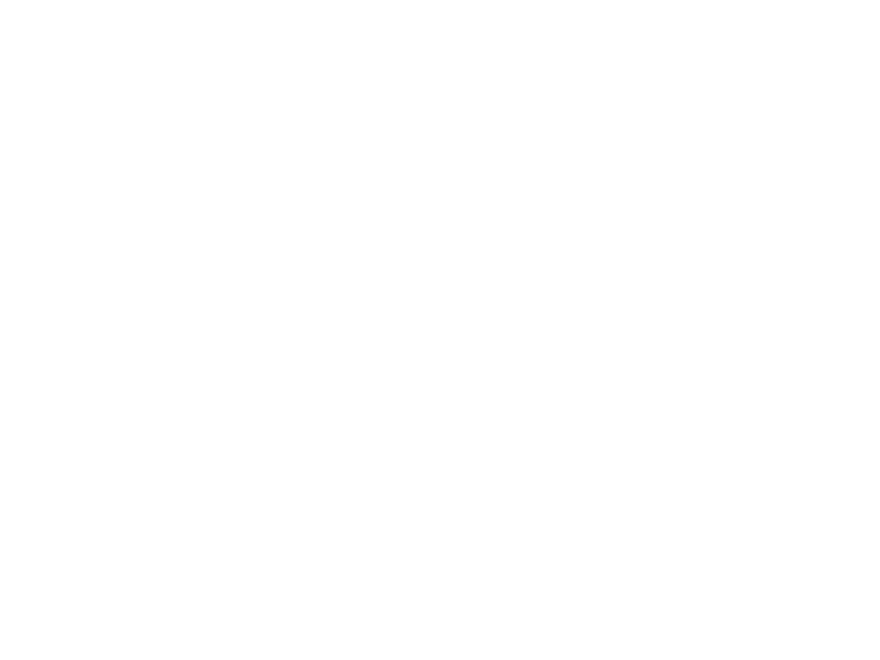

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0030.mp4

D:/HNSCC/HNSCC-01-0030\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0030\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0031\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


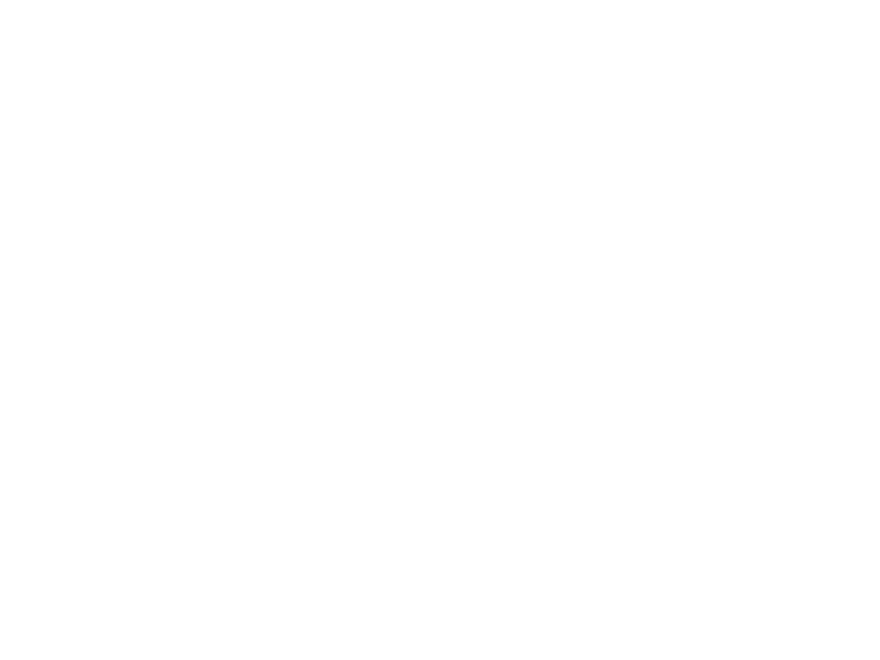

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0031.mp4

D:/HNSCC/HNSCC-01-0031\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


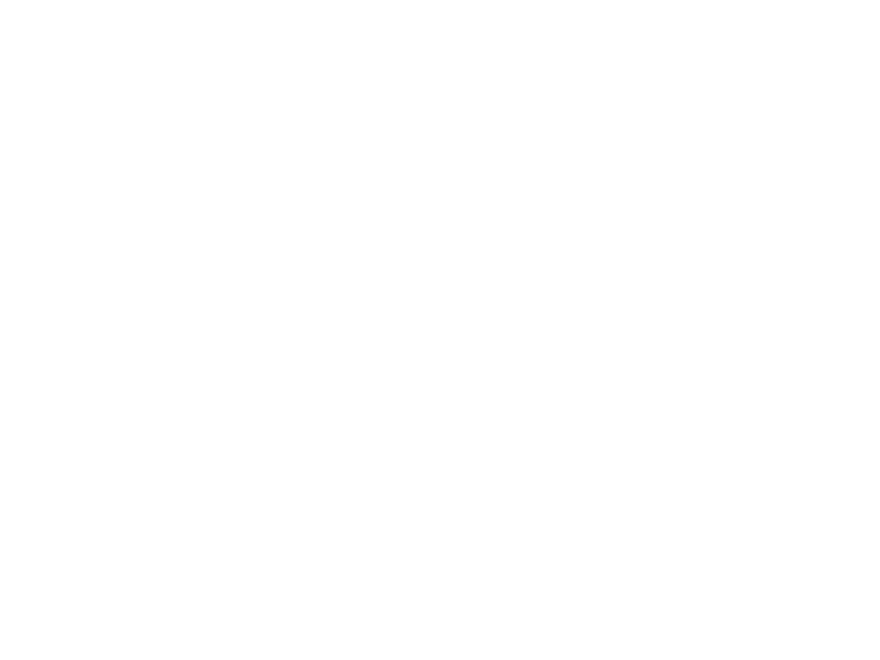

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0031.mp4

D:/HNSCC/HNSCC-01-0031\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


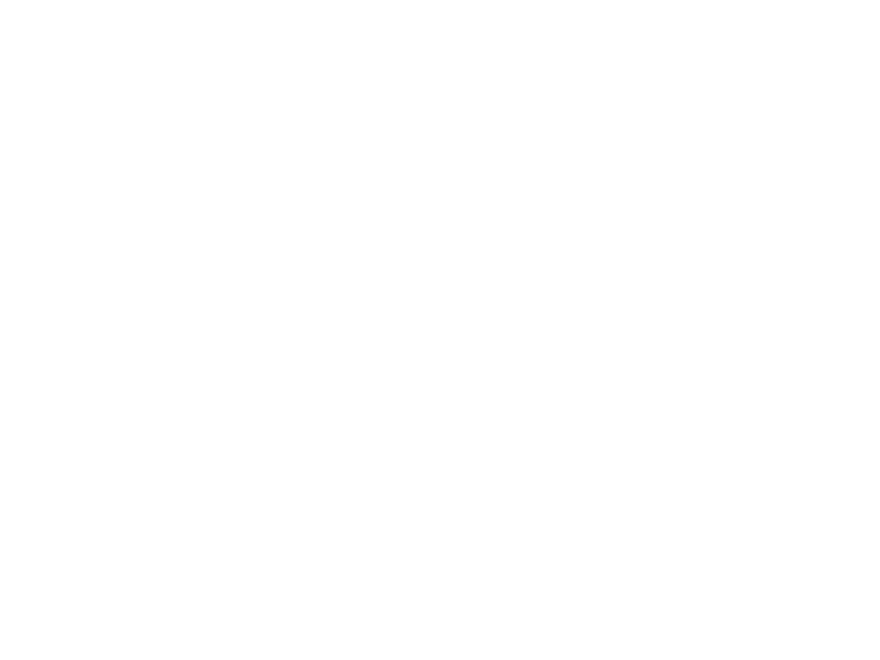

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0031.mp4

D:/HNSCC/HNSCC-01-0031\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0031\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0032\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


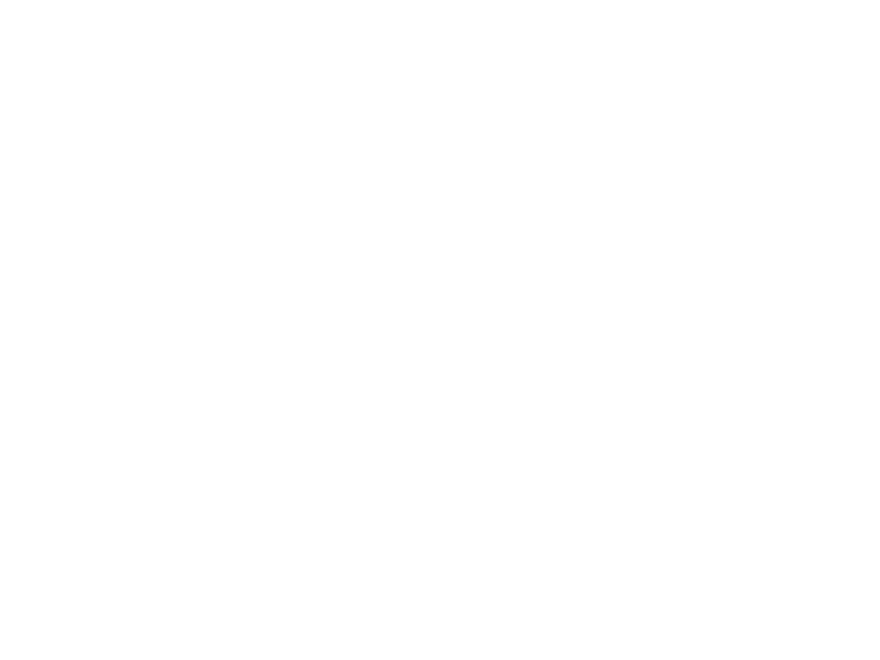

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0032.mp4

D:/HNSCC/HNSCC-01-0032\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


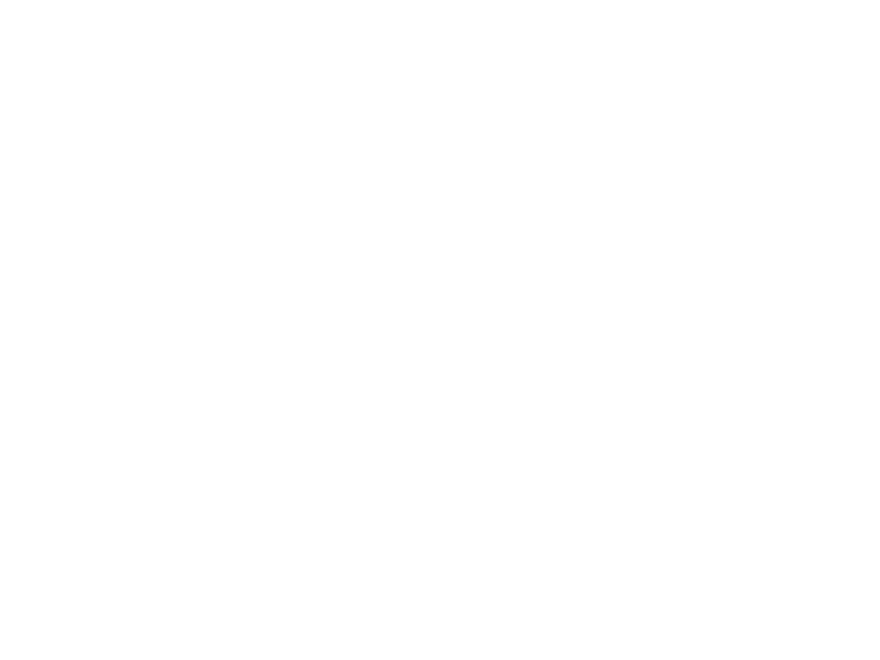

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0032.mp4

D:/HNSCC/HNSCC-01-0032\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


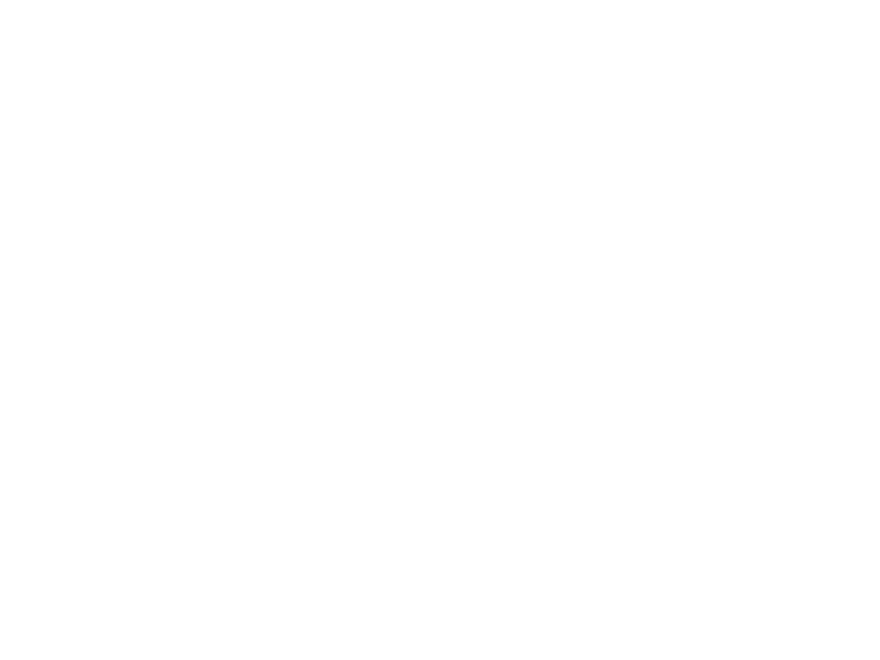

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0032.mp4

D:/HNSCC/HNSCC-01-0032\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


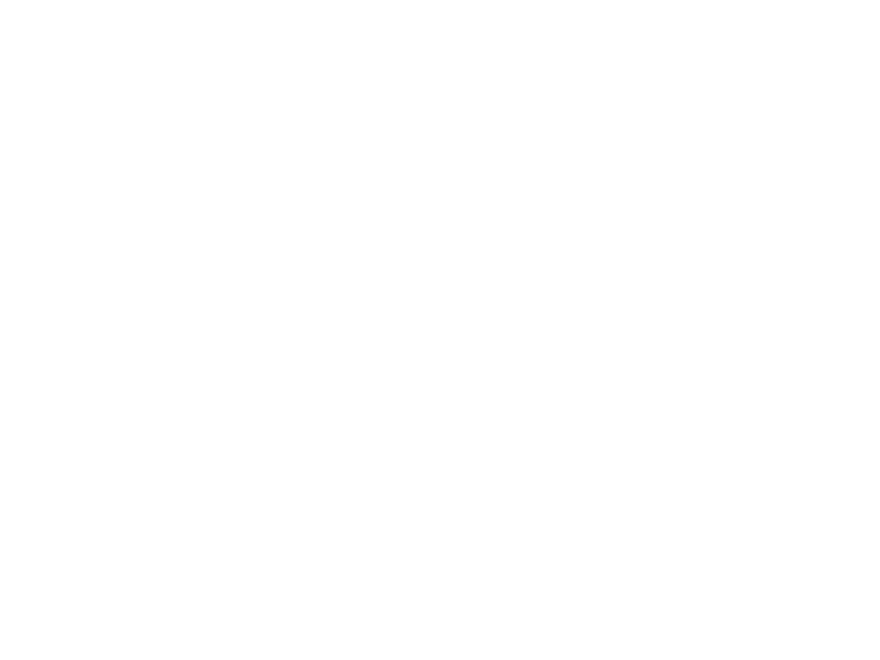

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0032.mp4

D:/HNSCC/HNSCC-01-0032\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


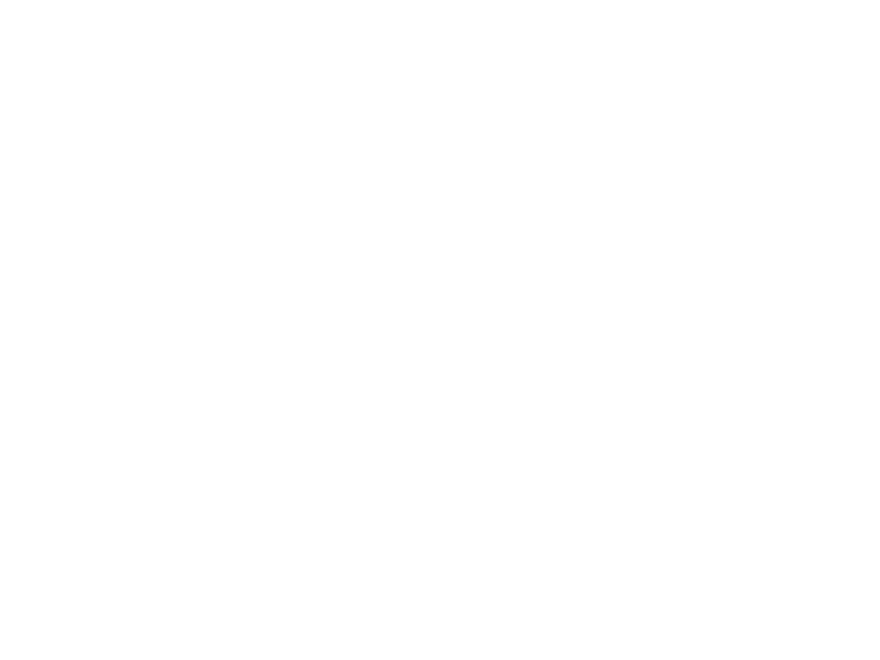

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0032.mp4

D:/HNSCC/HNSCC-01-0033\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


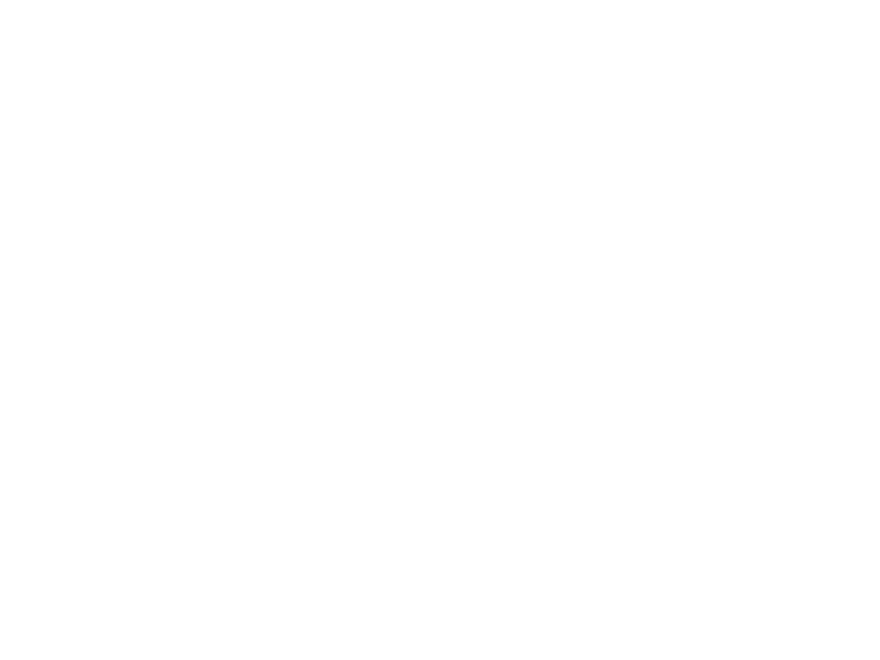

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0033.mp4

D:/HNSCC/HNSCC-01-0033\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


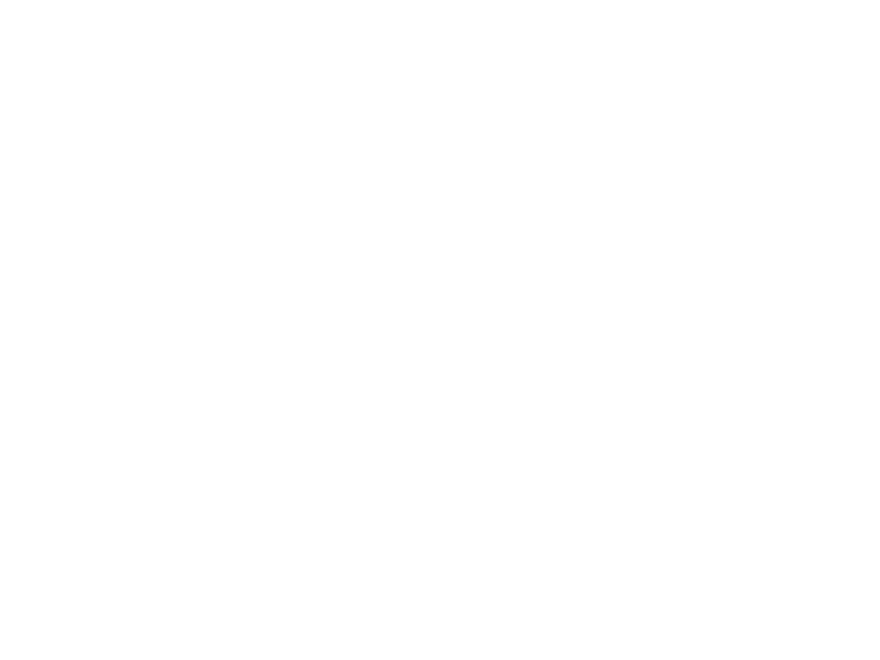

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0033.mp4

D:/HNSCC/HNSCC-01-0033\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


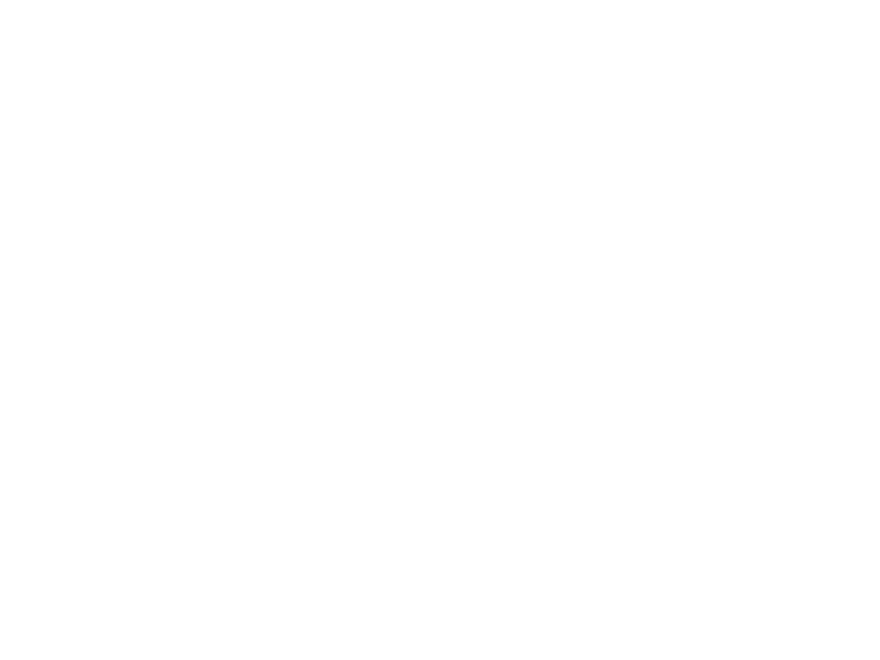

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0033.mp4

D:/HNSCC/HNSCC-01-0033\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0033\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0034\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


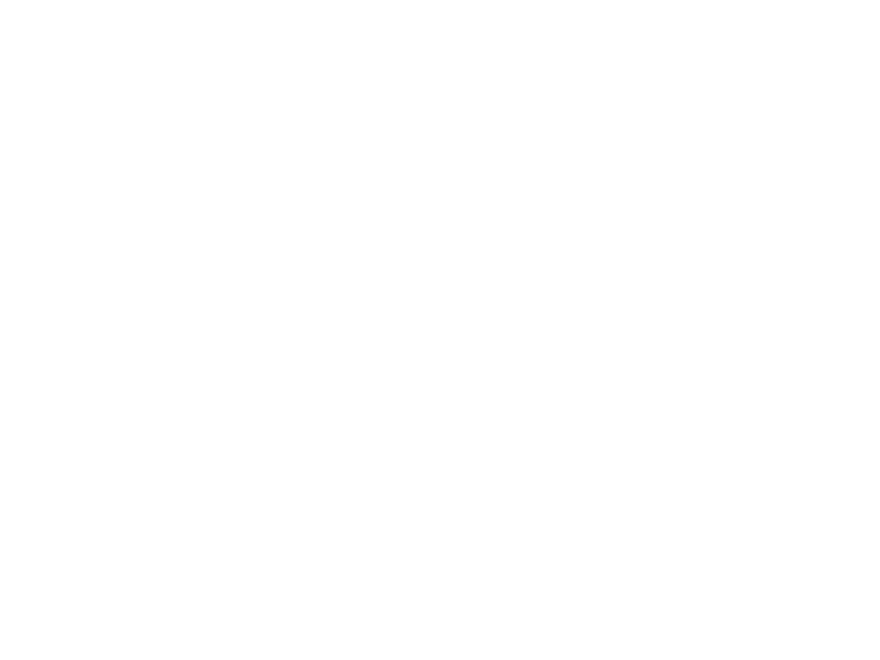

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0034.mp4

D:/HNSCC/HNSCC-01-0034\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


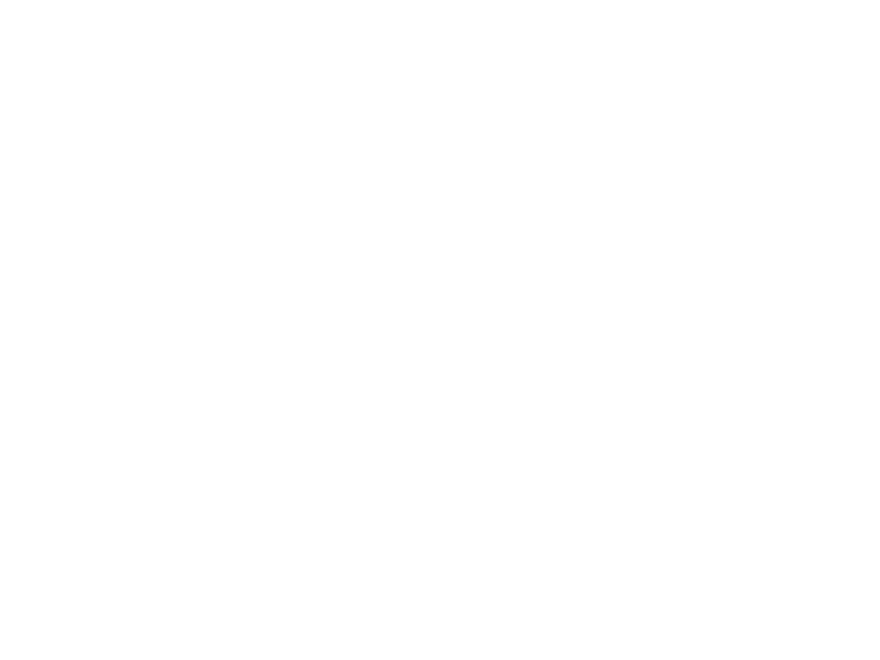

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0034.mp4

D:/HNSCC/HNSCC-01-0034\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


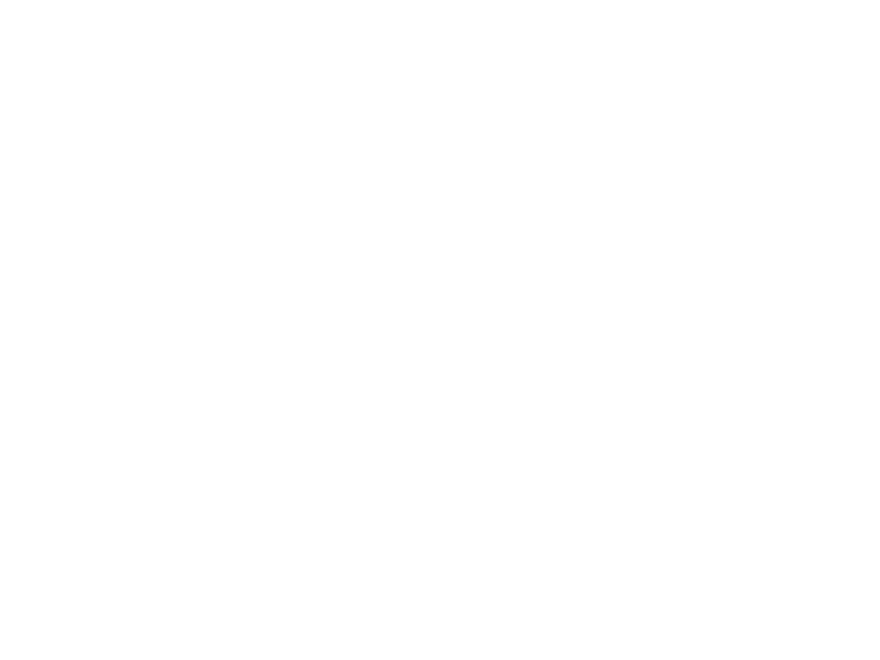

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0034.mp4

D:/HNSCC/HNSCC-01-0034\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0034\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0035\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


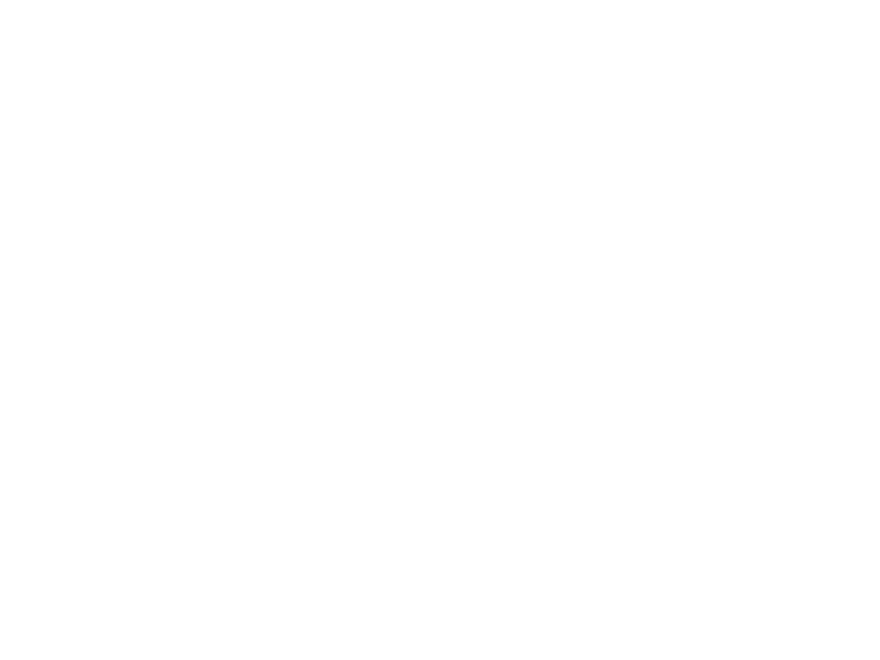

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0035.mp4

D:/HNSCC/HNSCC-01-0035\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


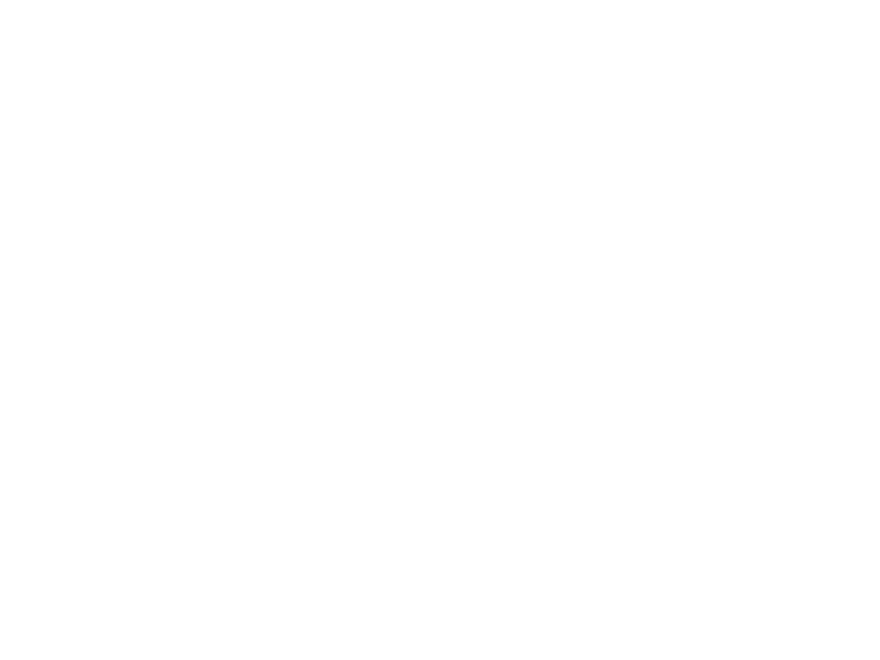

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0035.mp4

D:/HNSCC/HNSCC-01-0035\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


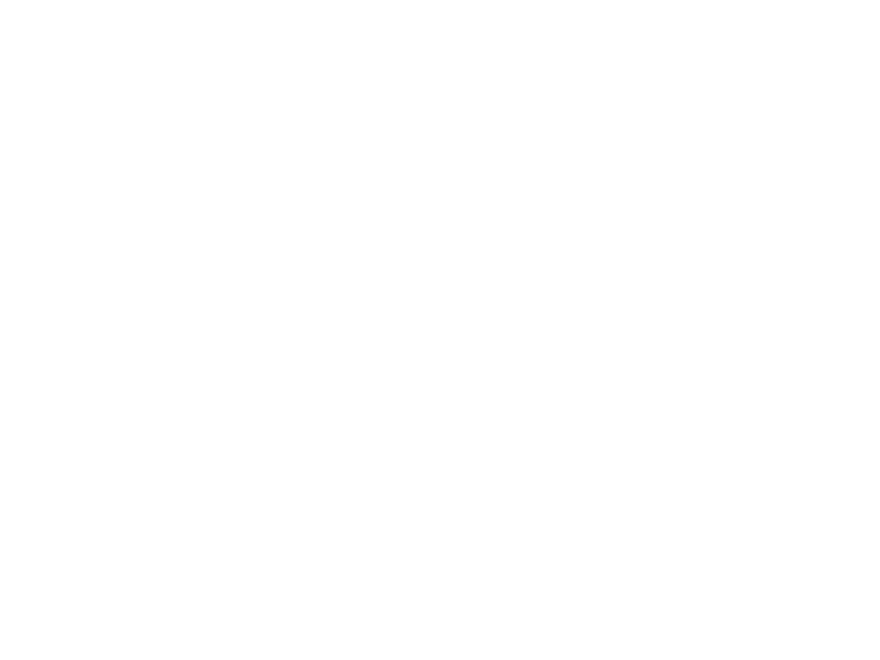

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0035.mp4

D:/HNSCC/HNSCC-01-0035\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0035\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0036\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0036\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0036\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0036\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0036\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0038\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Req

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


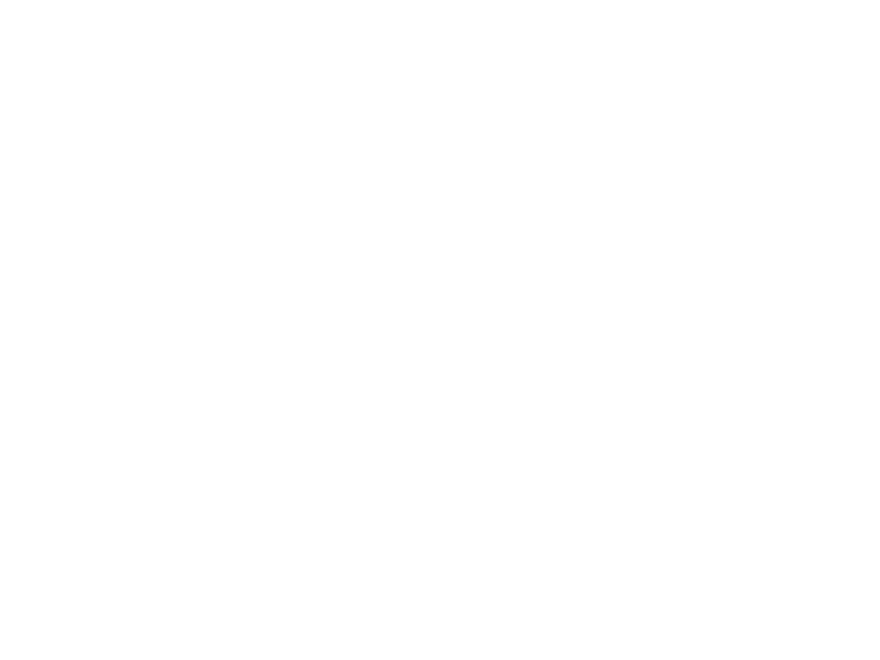

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0038.mp4

D:/HNSCC/HNSCC-01-0038\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


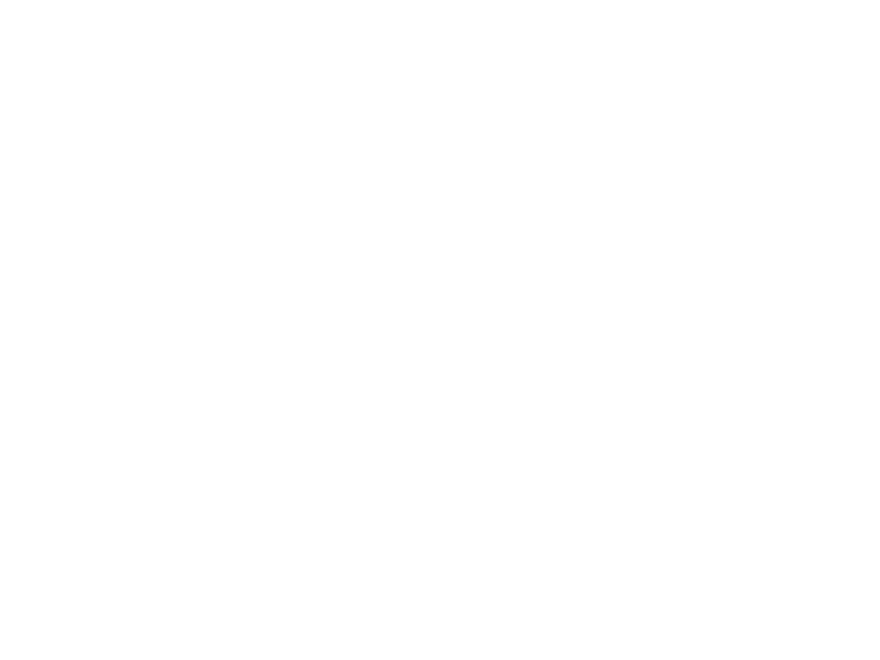

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0038.mp4

D:/HNSCC/HNSCC-01-0038\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


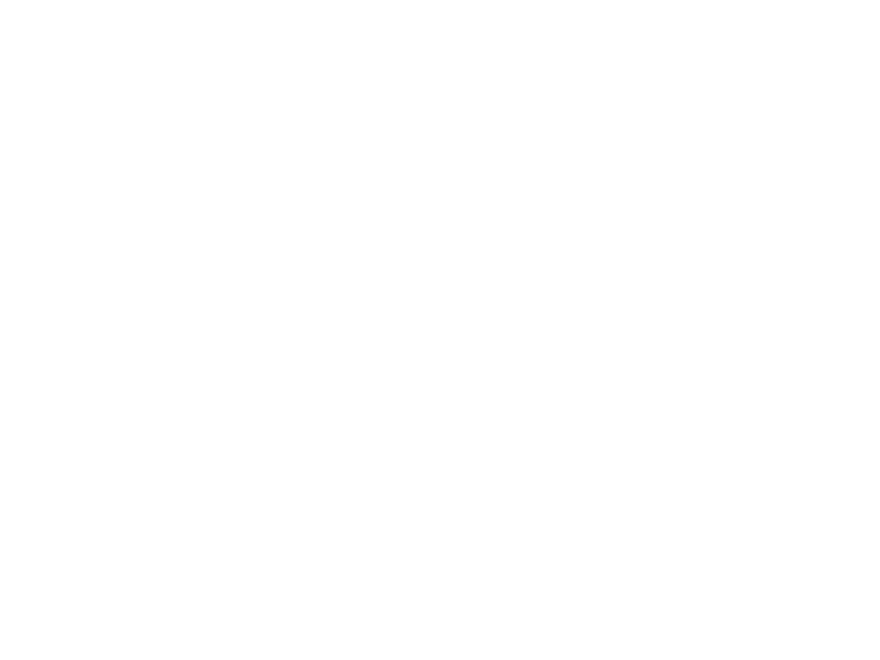

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0038.mp4

D:/HNSCC/HNSCC-01-0038\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


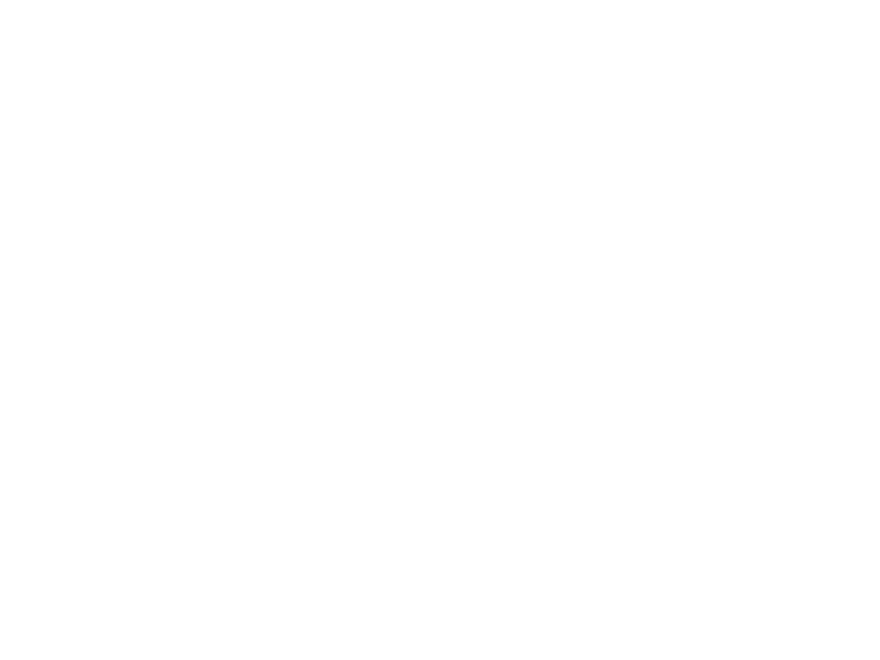

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0038.mp4

D:/HNSCC/HNSCC-01-0038\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


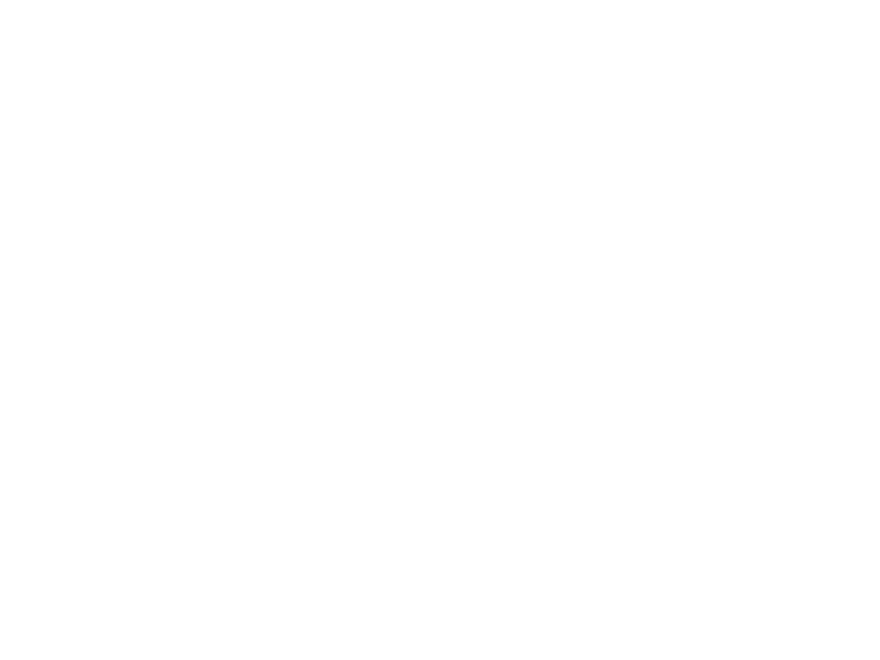

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0038.mp4

D:/HNSCC/HNSCC-01-0039\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0039\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0039\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0039\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0039\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0040\
Thickness 1: 2.560


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


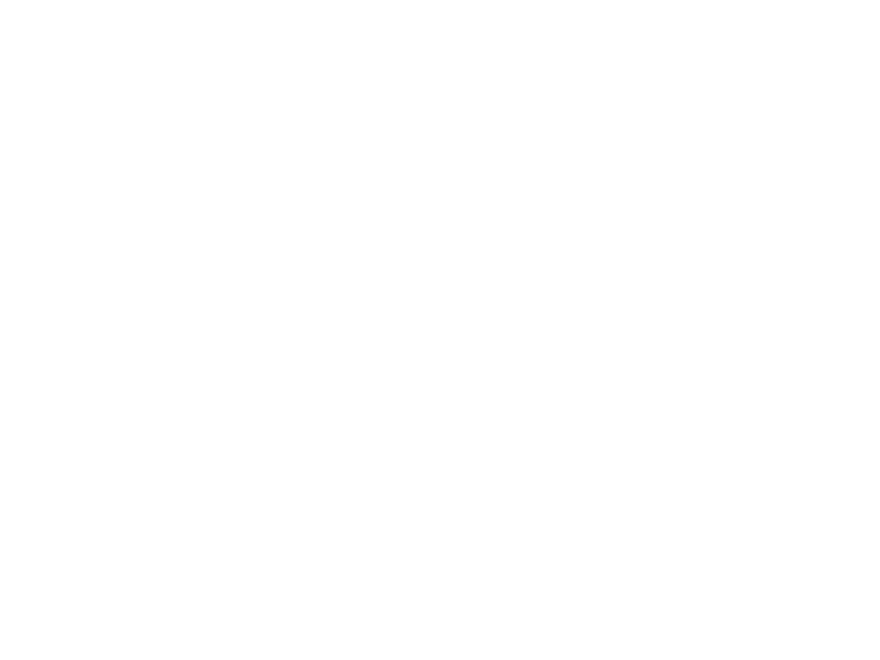

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0040.mp4

D:/HNSCC/HNSCC-01-0040\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


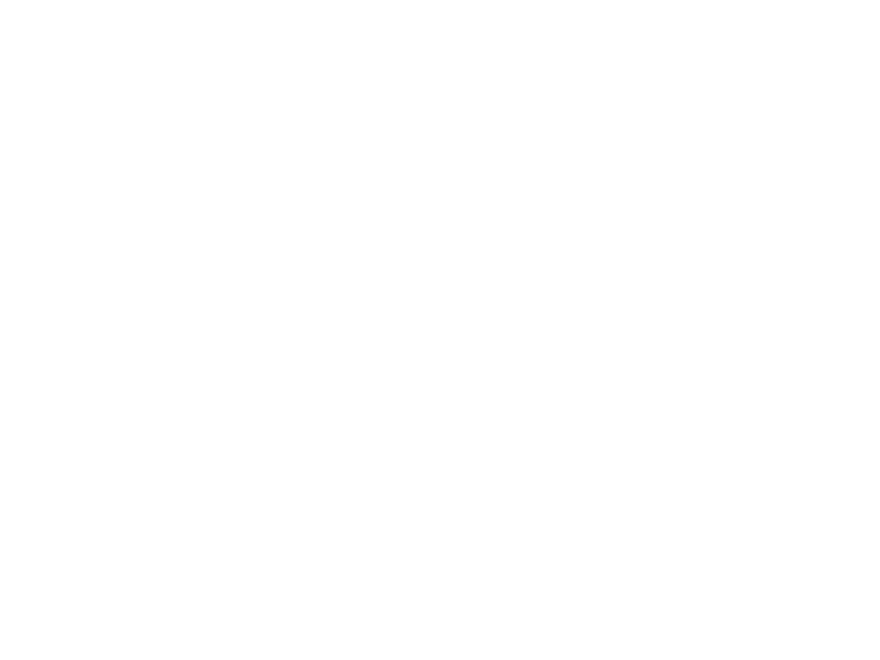

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0040.mp4

D:/HNSCC/HNSCC-01-0040\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


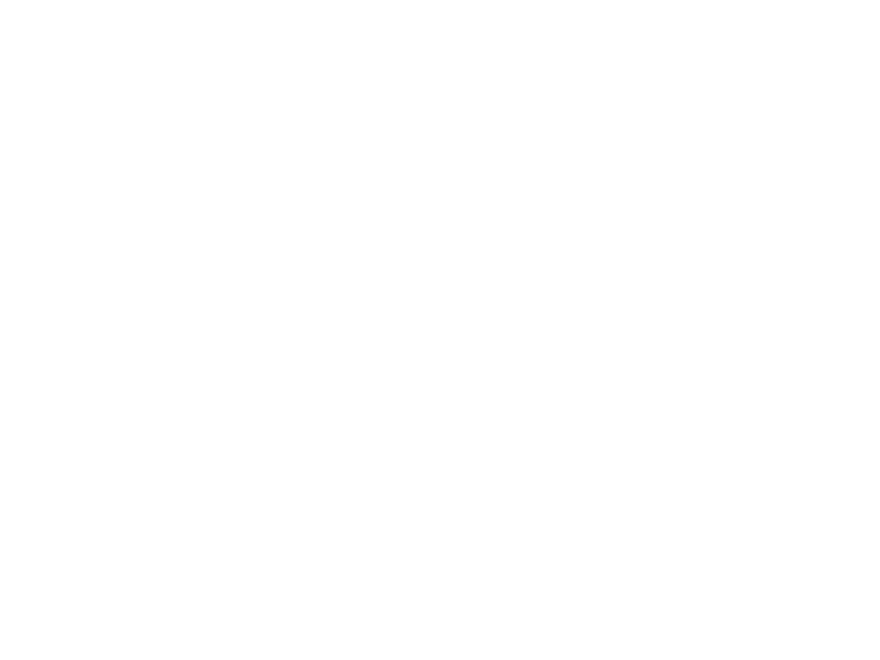

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0040.mp4

D:/HNSCC/HNSCC-01-0040\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0040\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0041\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


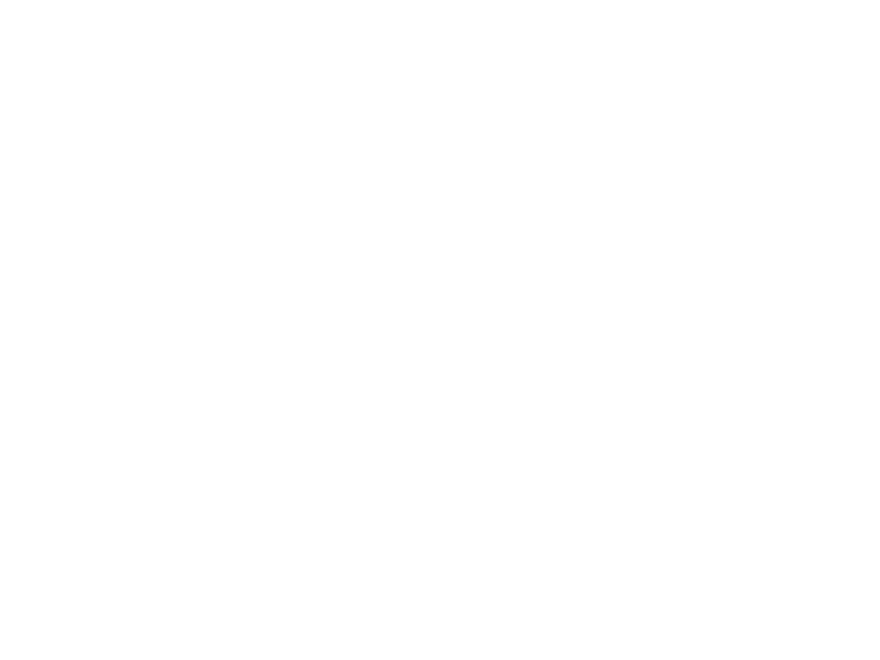

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0041.mp4

D:/HNSCC/HNSCC-01-0041\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


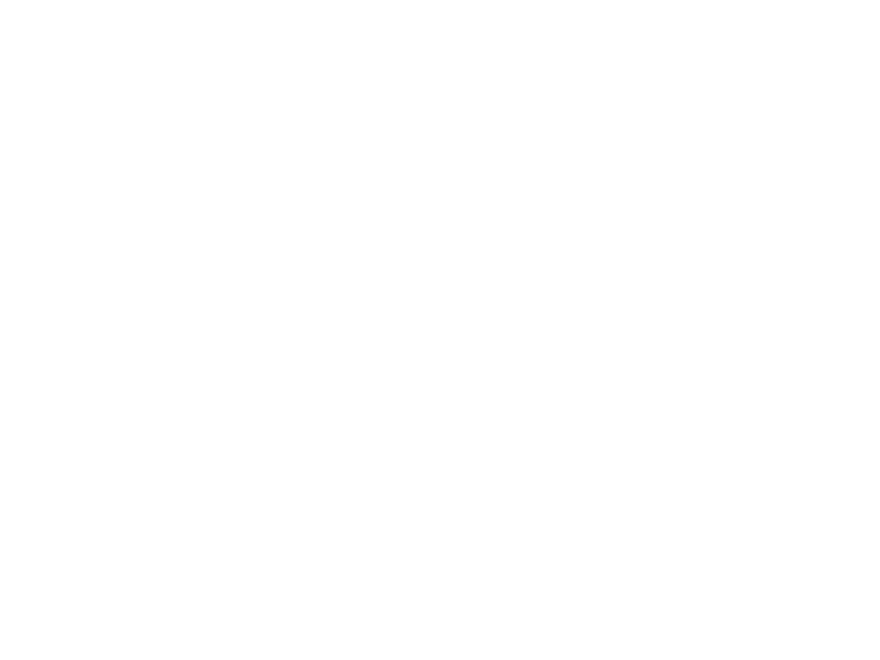

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0041.mp4

D:/HNSCC/HNSCC-01-0041\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


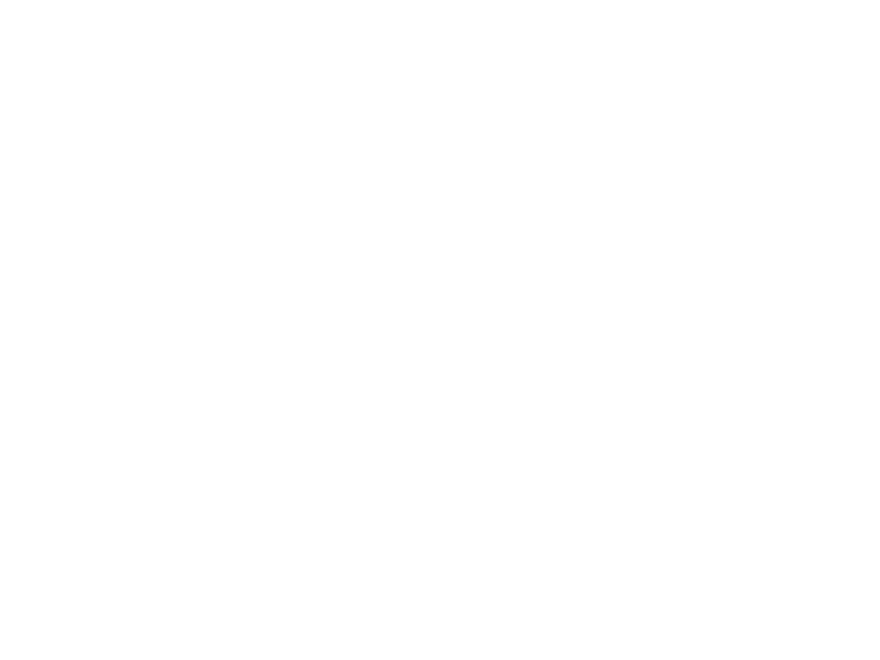

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0041.mp4

D:/HNSCC/HNSCC-01-0041\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0041\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0042\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0042\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0042\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0042\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Numbe

C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


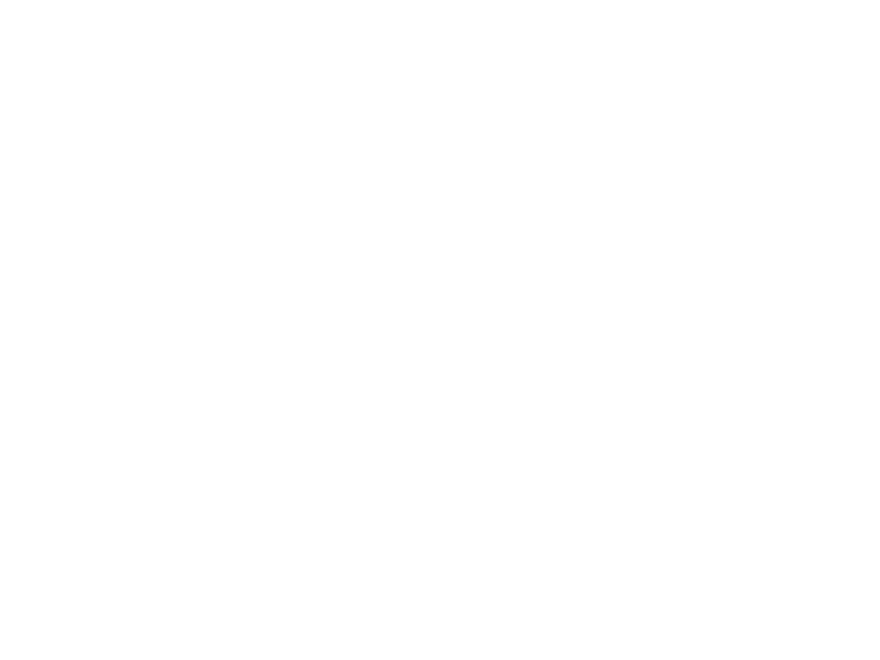

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0043.mp4

D:/HNSCC/HNSCC-01-0043\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0043\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


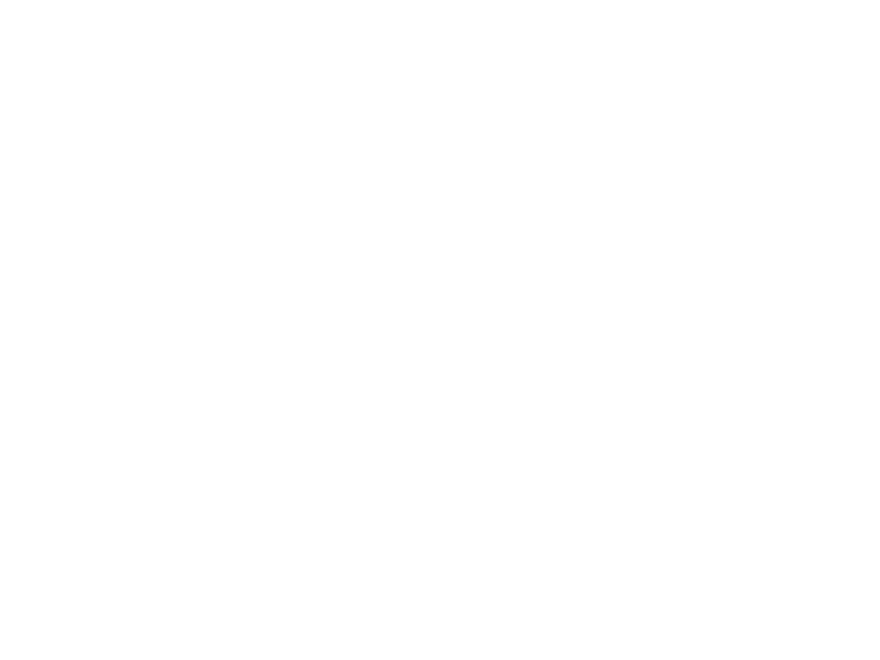

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0043.mp4

D:/HNSCC/HNSCC-01-0043\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0043\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0045\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


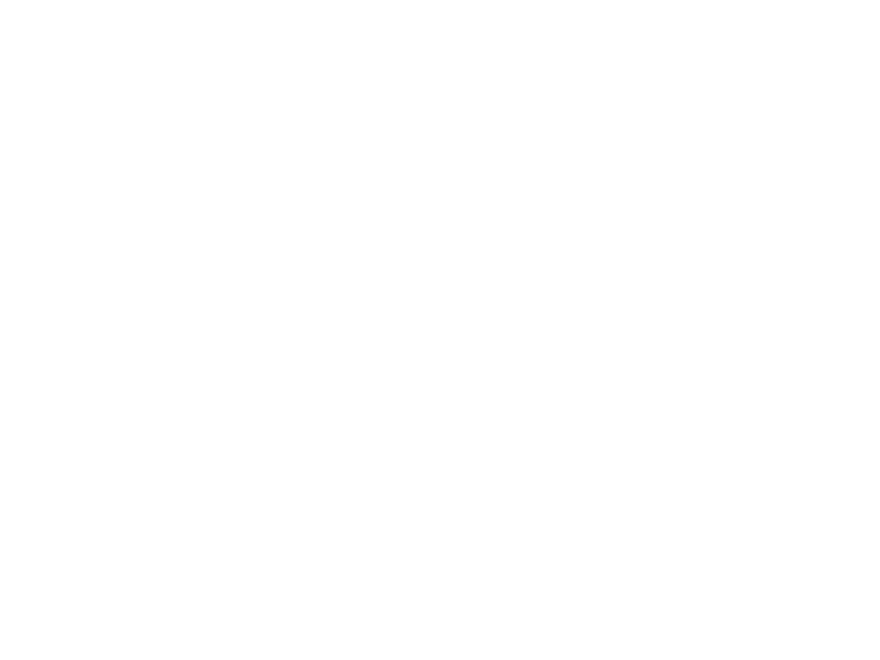

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0045.mp4

D:/HNSCC/HNSCC-01-0045\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


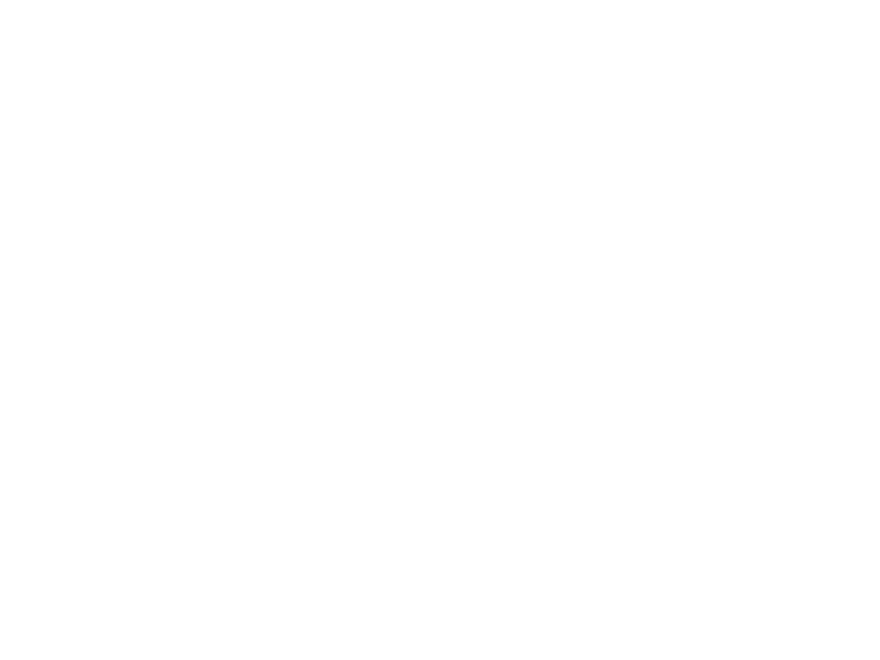

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0045.mp4

D:/HNSCC/HNSCC-01-0045\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


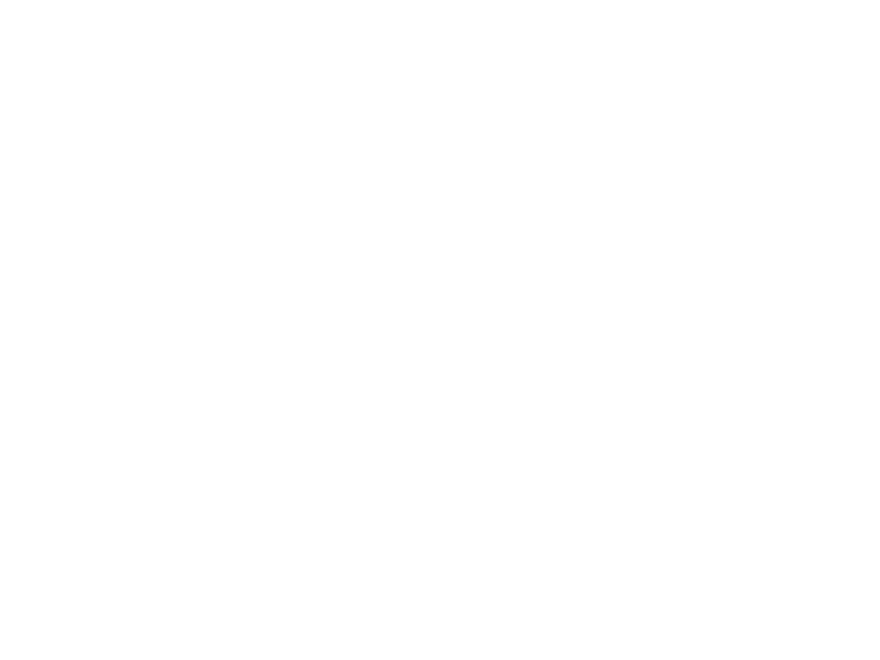

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0045.mp4

D:/HNSCC/HNSCC-01-0045\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


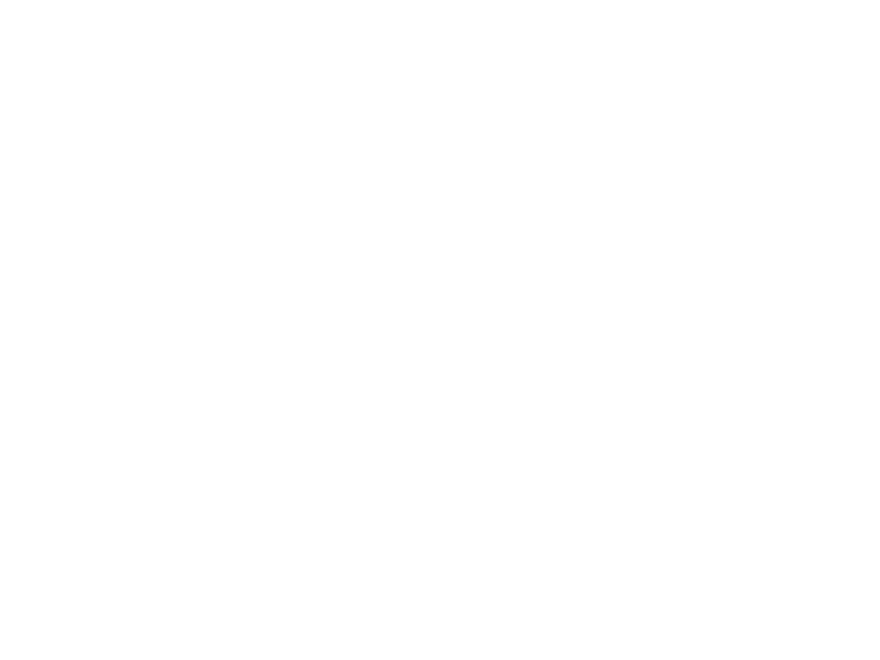

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0045.mp4

D:/HNSCC/HNSCC-01-0045\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


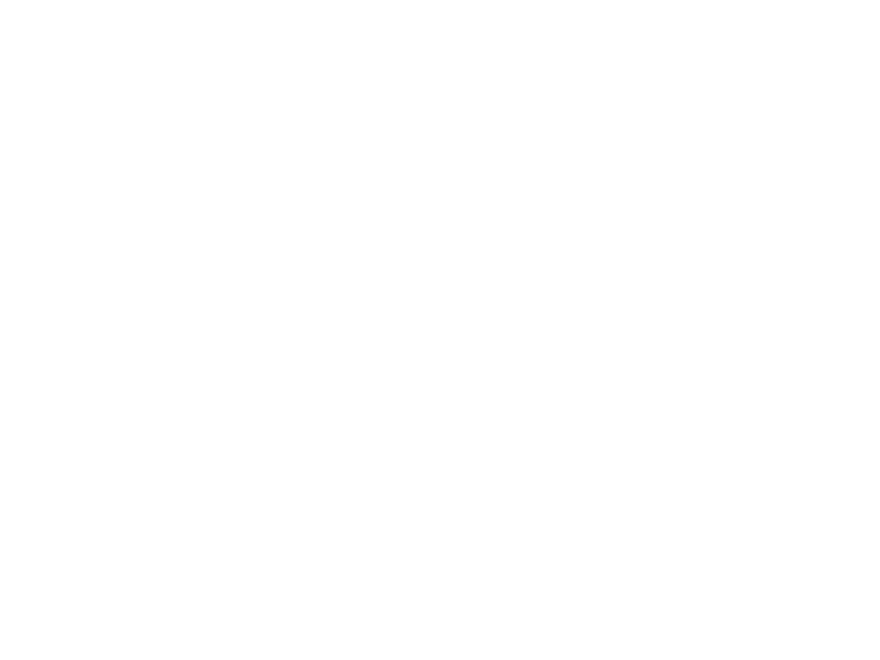

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0045.mp4

D:/HNSCC/HNSCC-01-0046\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


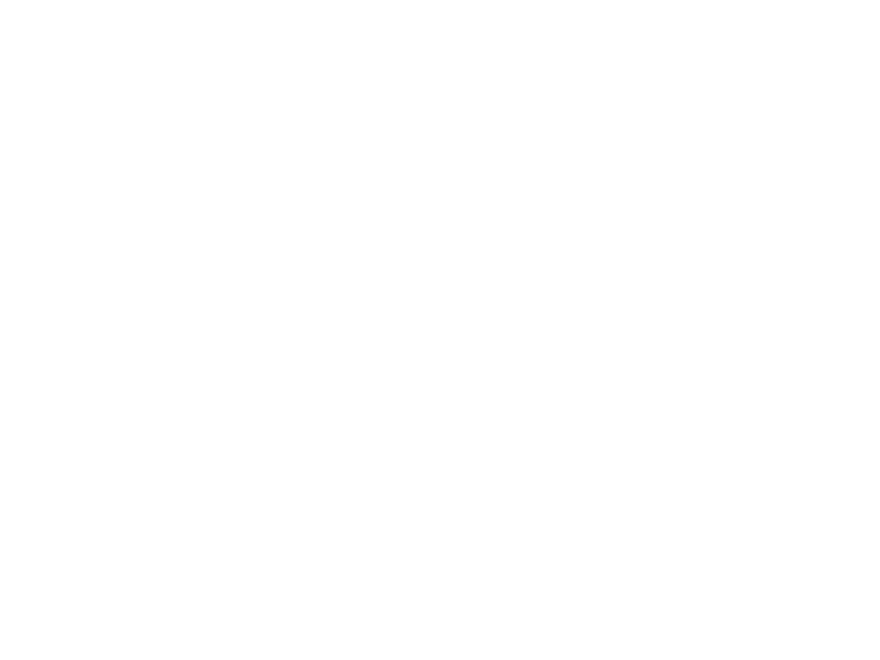

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0046.mp4

D:/HNSCC/HNSCC-01-0046\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


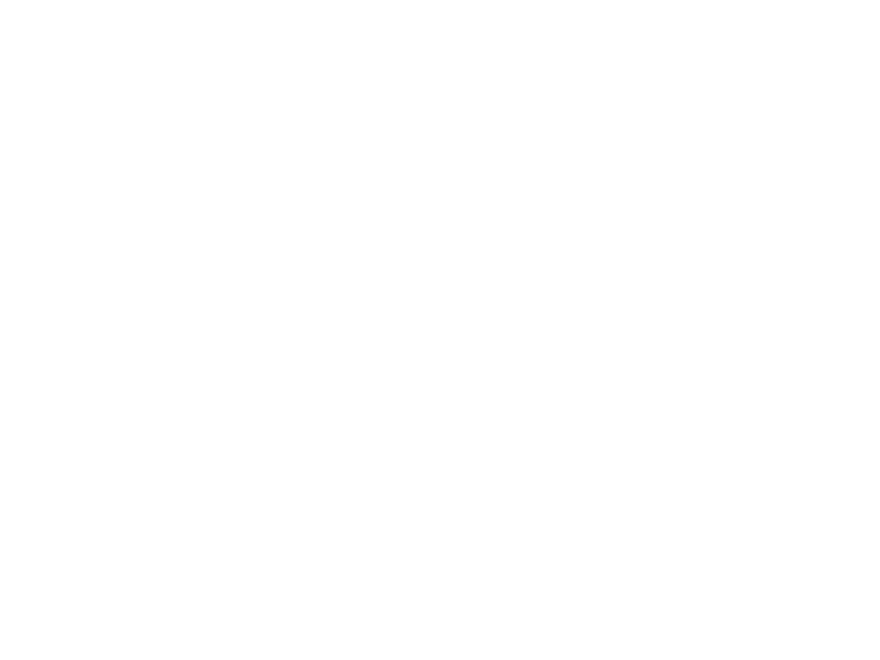

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0046.mp4

D:/HNSCC/HNSCC-01-0046\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


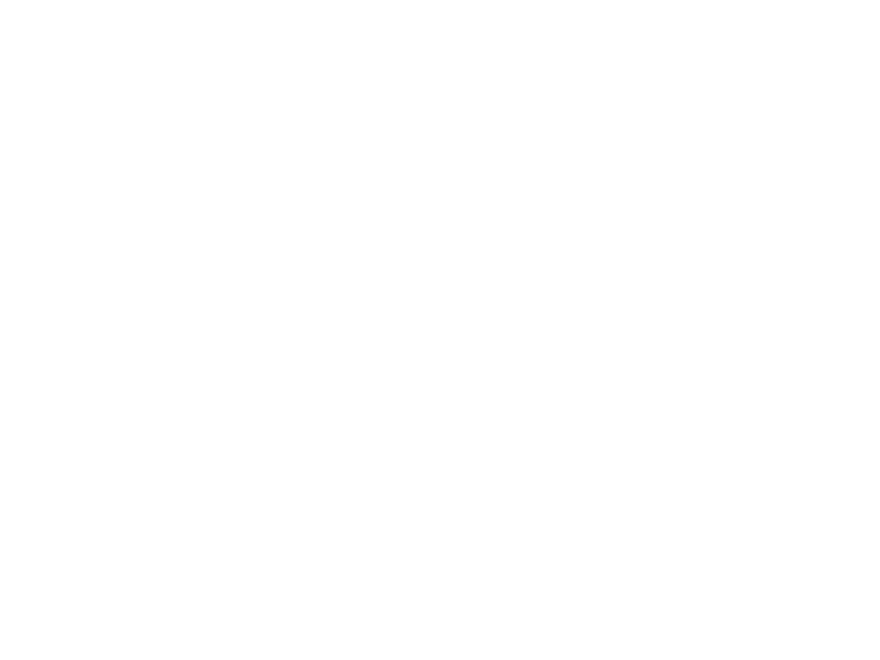

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0046.mp4

D:/HNSCC/HNSCC-01-0046\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0046\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0047\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


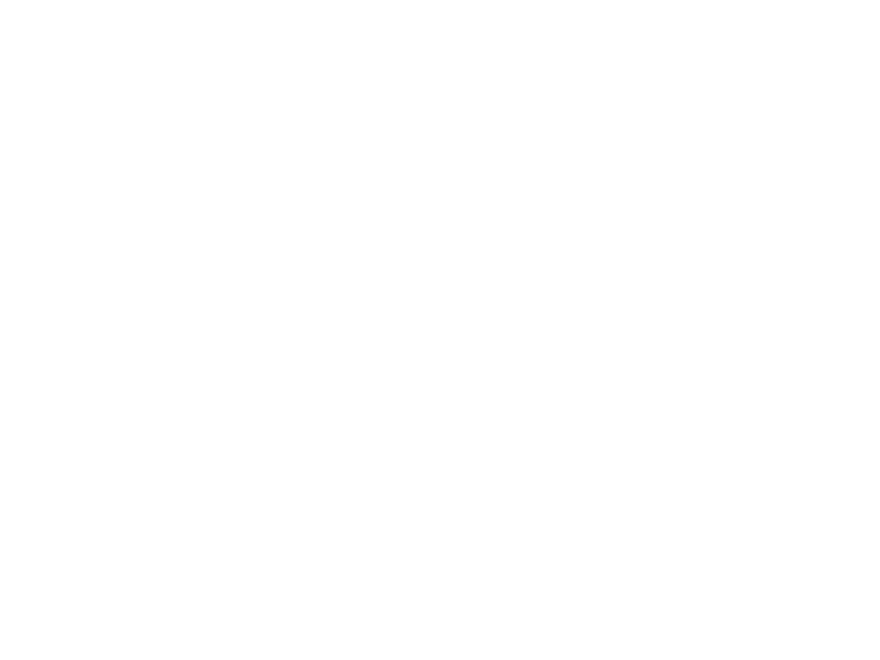

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0047.mp4

D:/HNSCC/HNSCC-01-0047\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


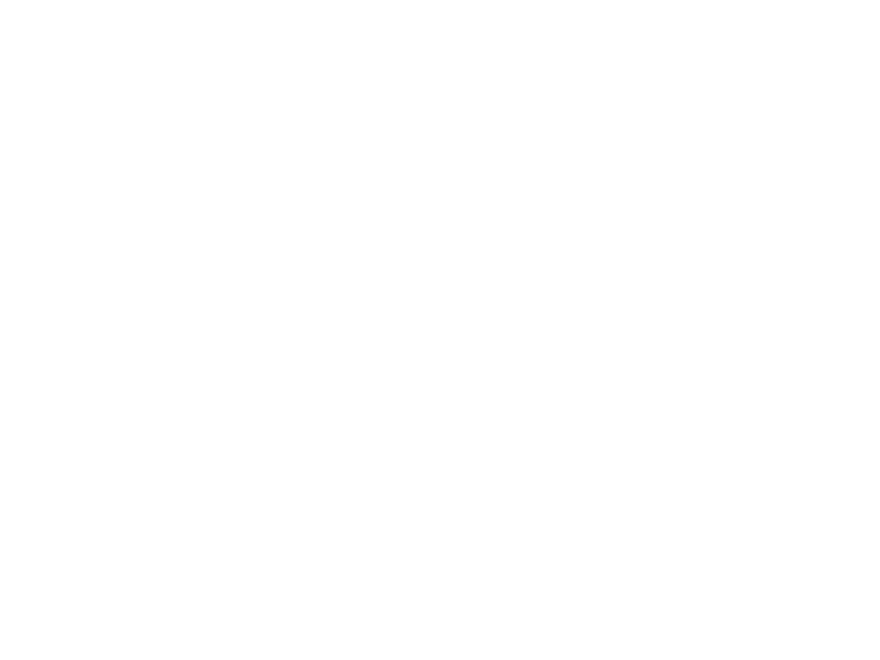

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0047.mp4

D:/HNSCC/HNSCC-01-0047\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


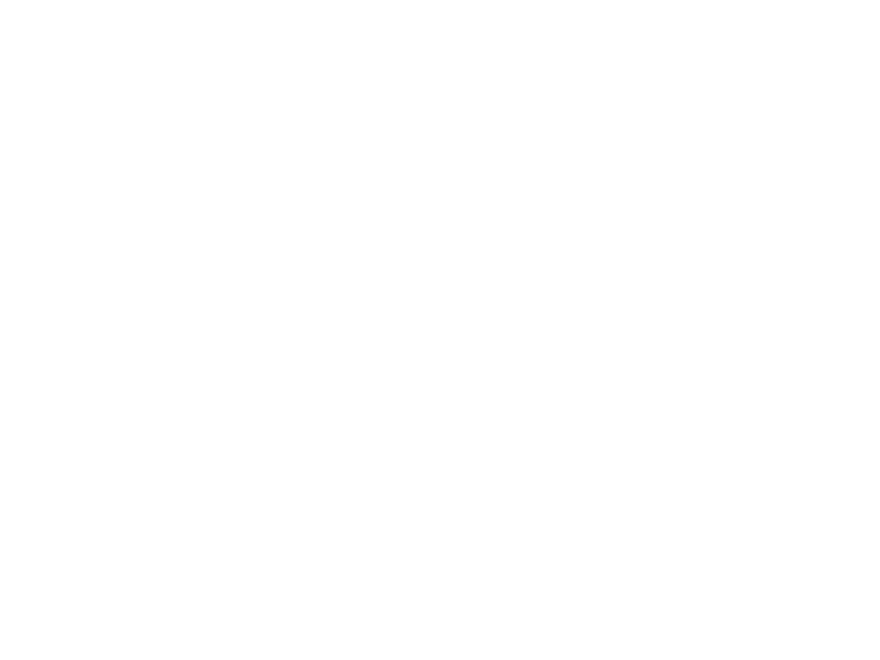

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0047.mp4

D:/HNSCC/HNSCC-01-0047\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0047\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0048\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


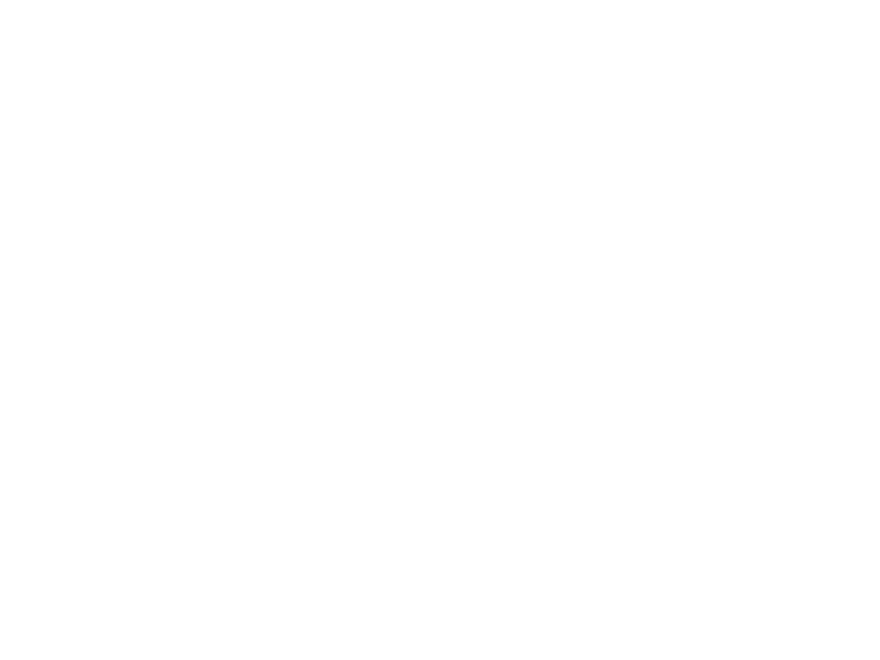

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0048.mp4

D:/HNSCC/HNSCC-01-0048\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


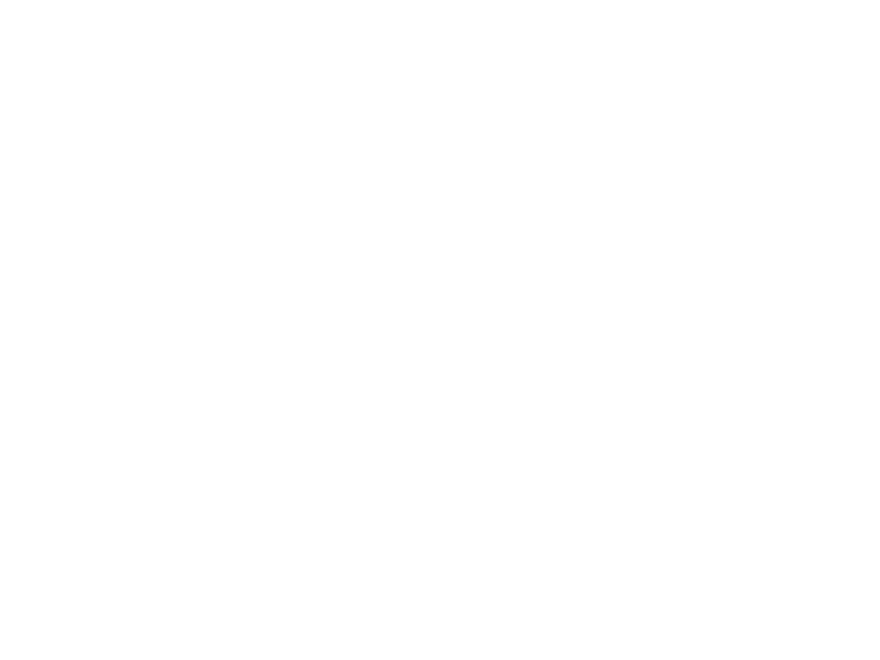

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0048.mp4

D:/HNSCC/HNSCC-01-0048\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


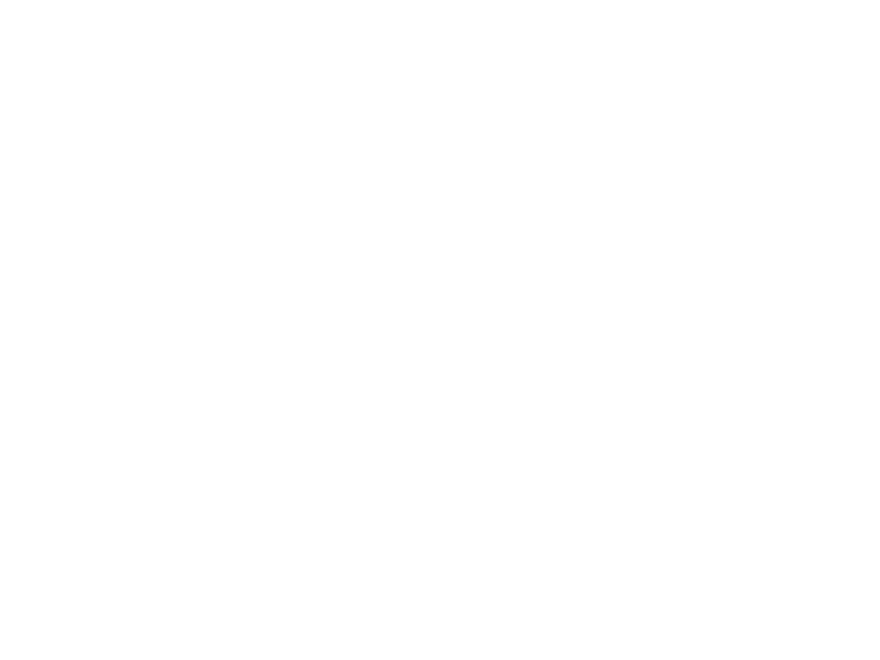

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0048.mp4

D:/HNSCC/HNSCC-01-0048\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0048\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0049\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


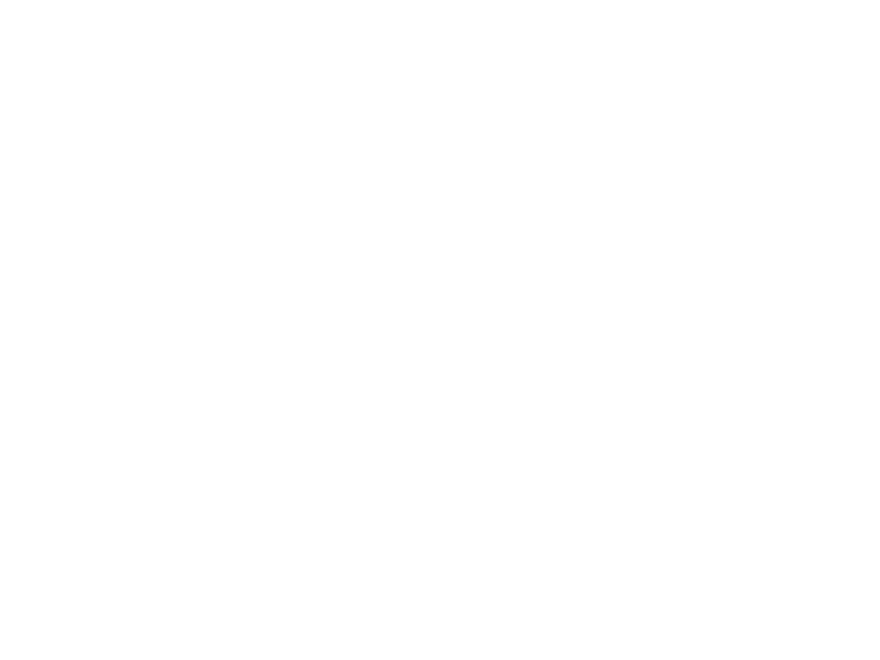

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0049.mp4

D:/HNSCC/HNSCC-01-0049\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


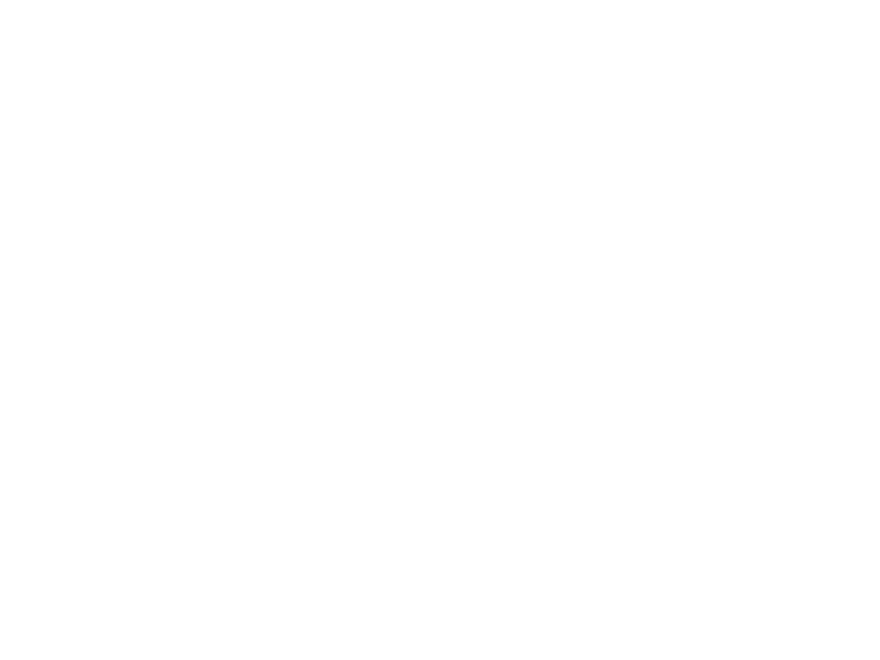

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0049.mp4

D:/HNSCC/HNSCC-01-0049\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


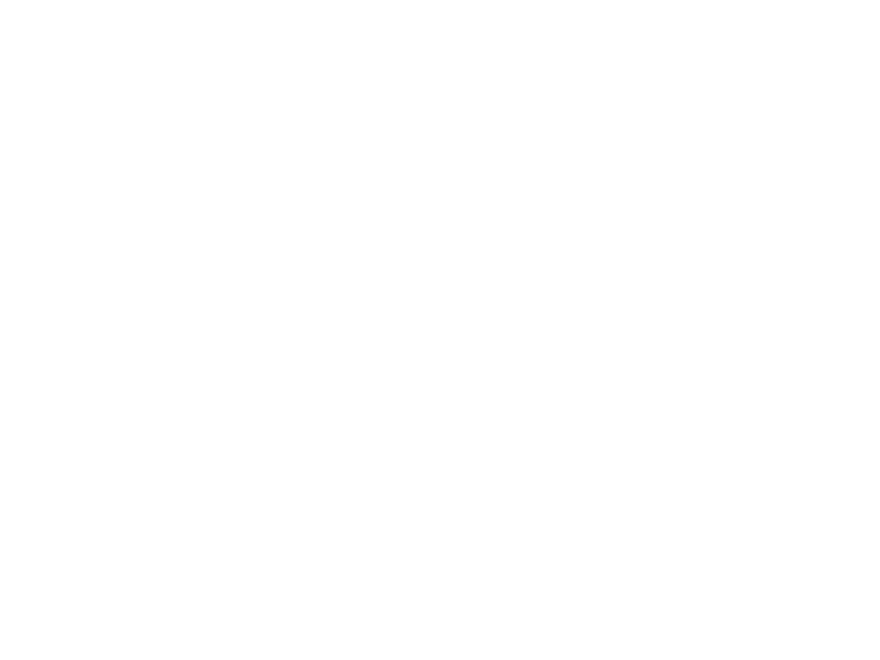

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0049.mp4

D:/HNSCC/HNSCC-01-0049\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0049\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:46
Required:45
1

D:/HNSCC/HNSCC-01-0050\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


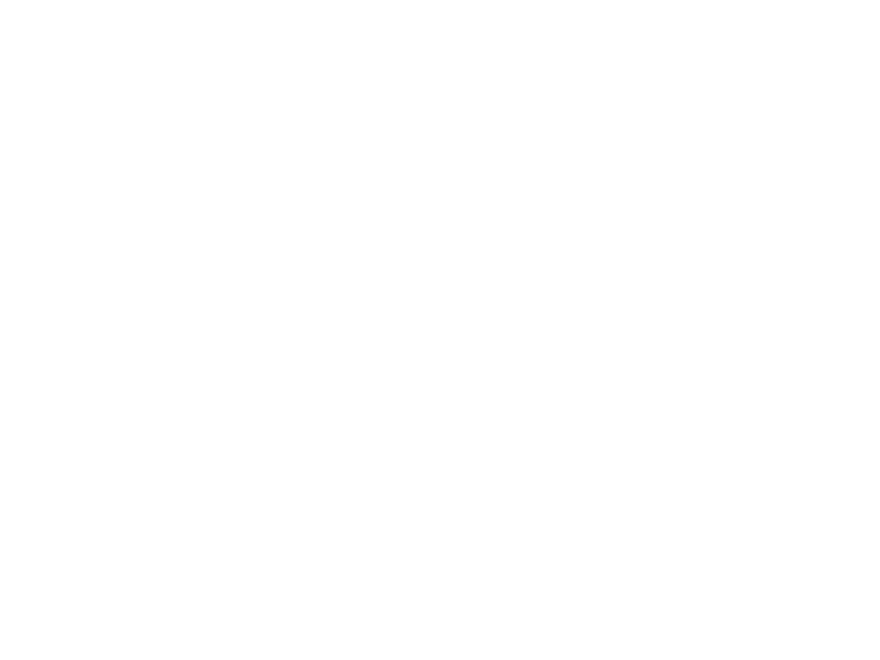

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0050.mp4

D:/HNSCC/HNSCC-01-0050\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


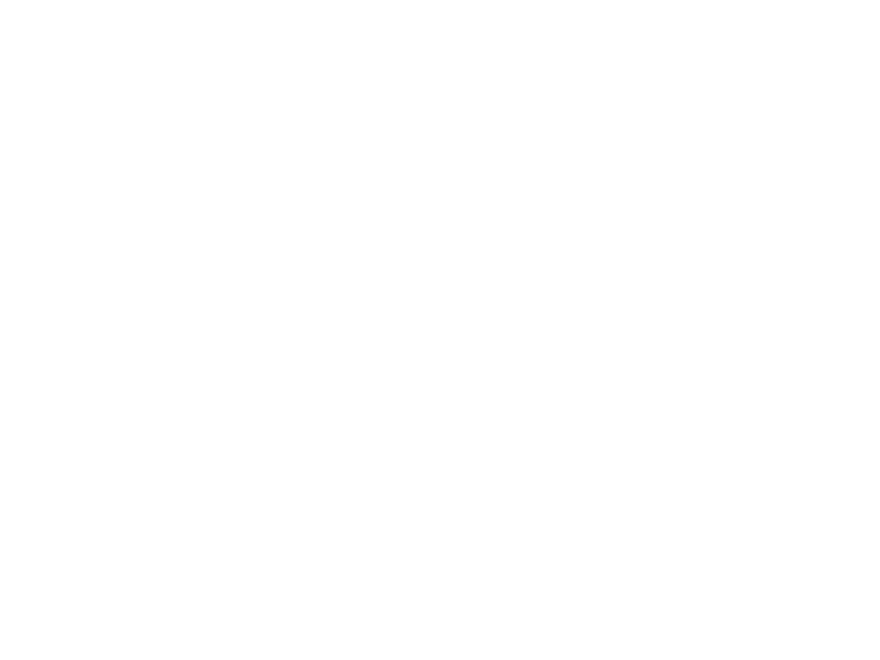

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0050.mp4

D:/HNSCC/HNSCC-01-0050\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


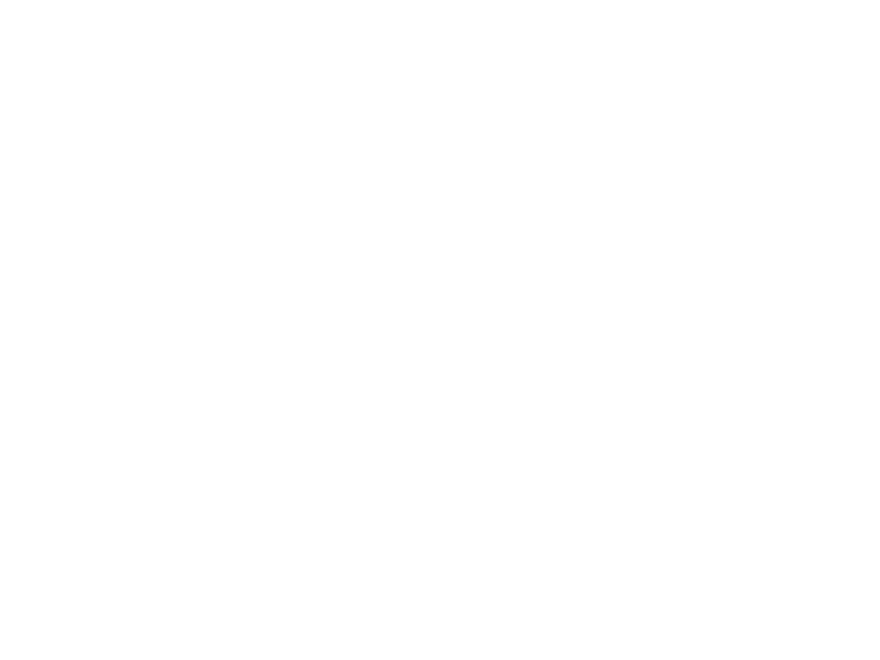

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0050.mp4

D:/HNSCC/HNSCC-01-0050\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


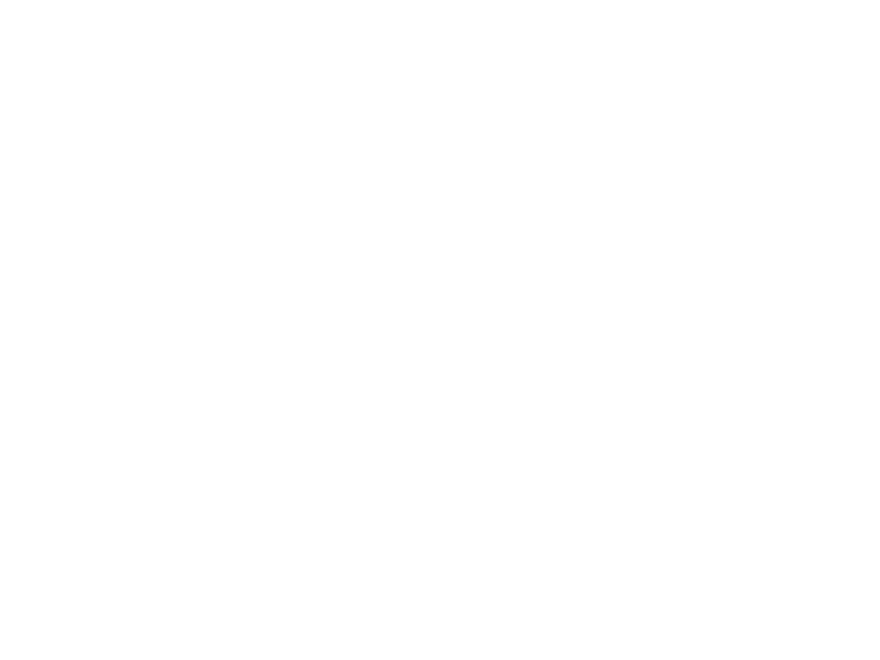

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0050.mp4

D:/HNSCC/HNSCC-01-0050\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


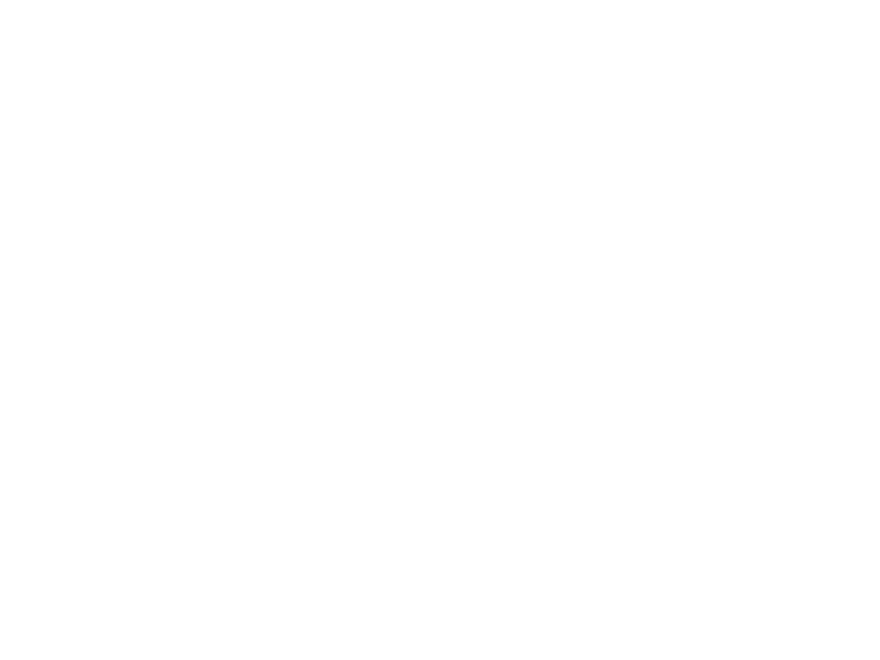

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0050.mp4

D:/HNSCC/HNSCC-01-0051\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


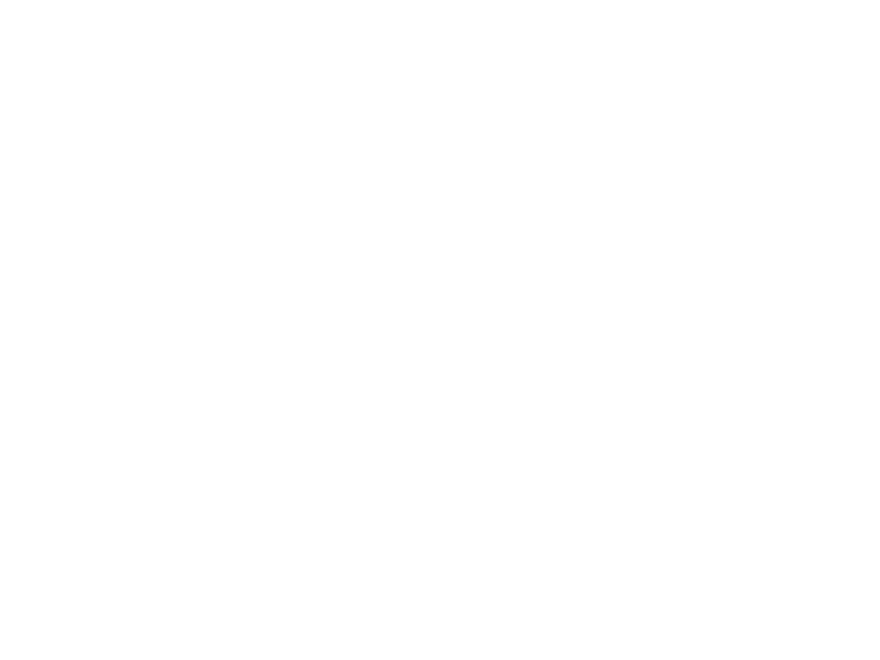

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0051.mp4

D:/HNSCC/HNSCC-01-0051\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


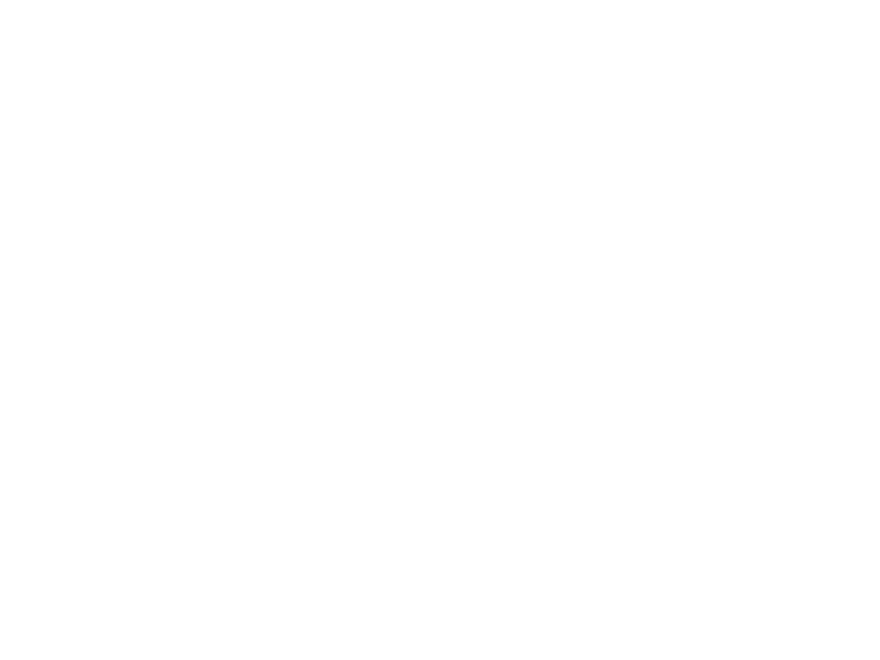

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0051.mp4

D:/HNSCC/HNSCC-01-0051\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


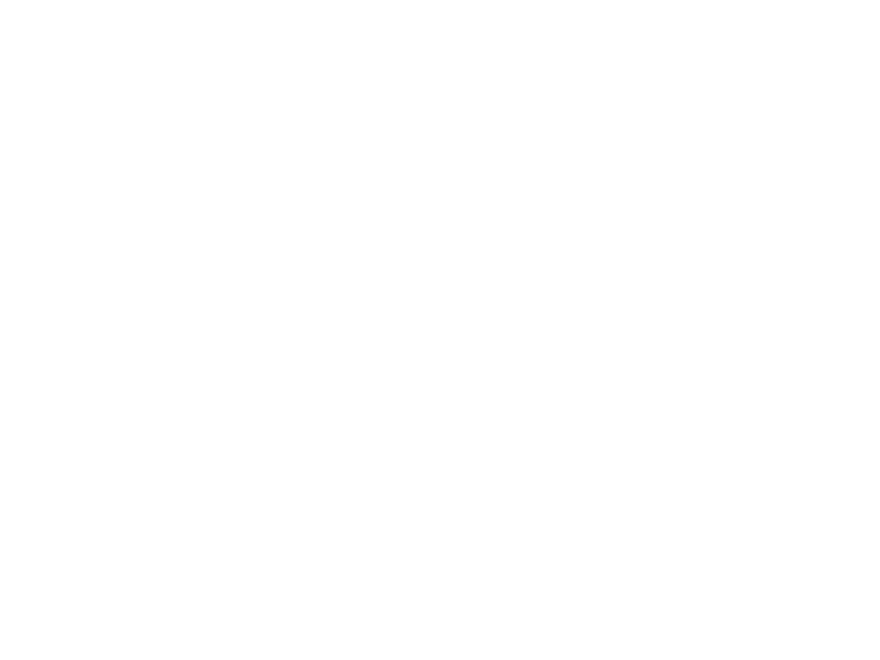

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0051.mp4

D:/HNSCC/HNSCC-01-0051\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


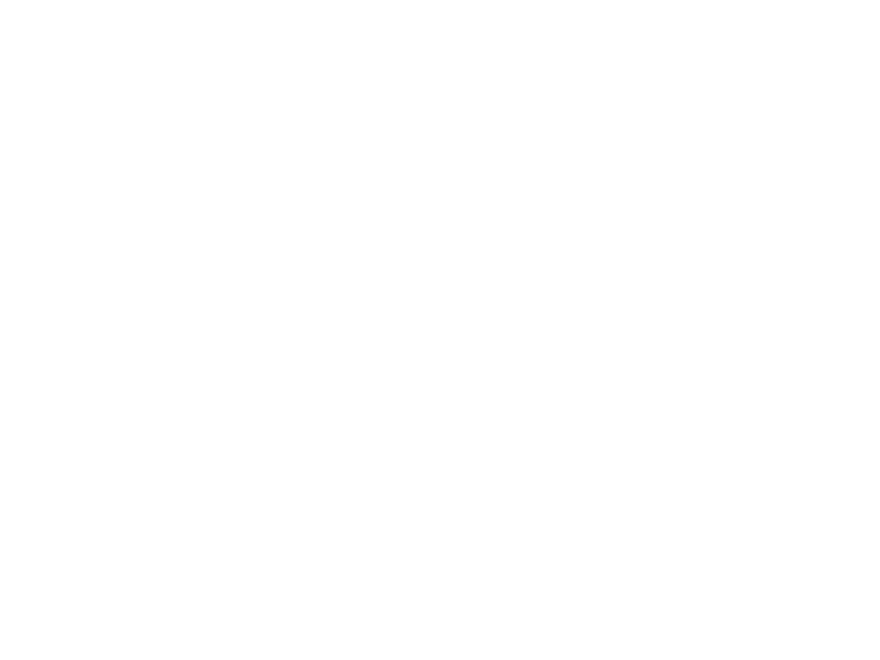

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0051.mp4

D:/HNSCC/HNSCC-01-0051\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


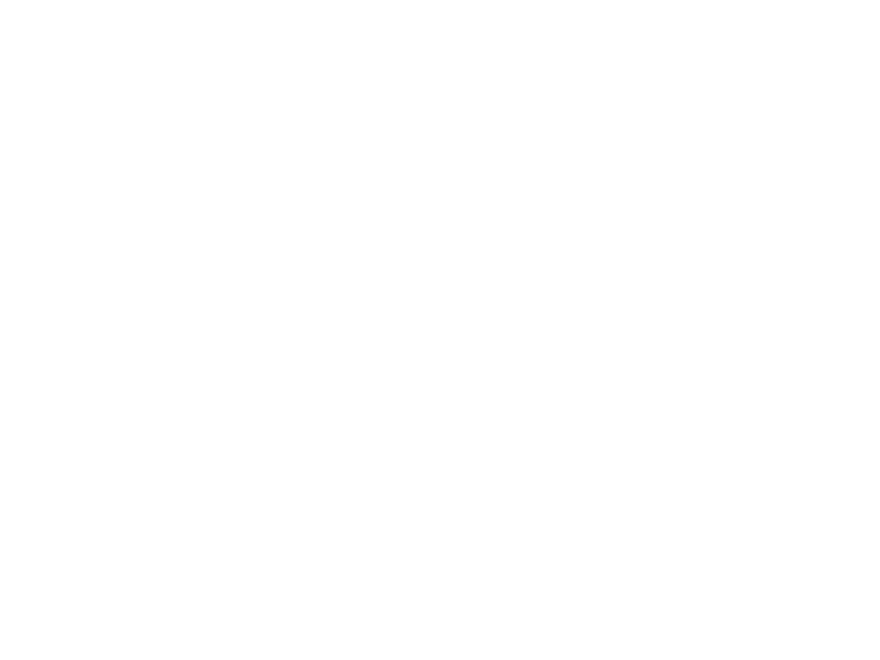

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0051.mp4

D:/HNSCC/HNSCC-01-0053\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


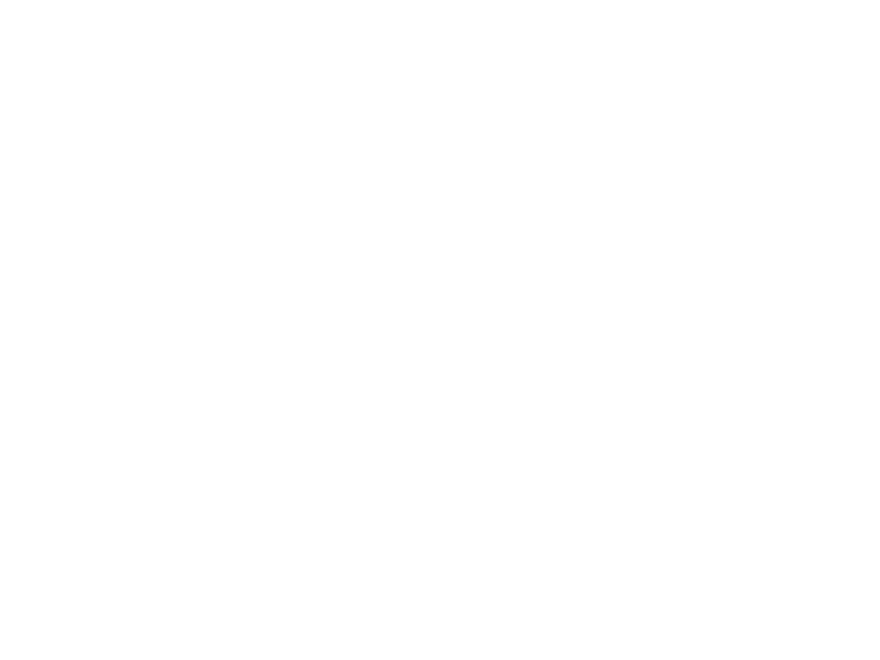

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0053.mp4

D:/HNSCC/HNSCC-01-0053\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


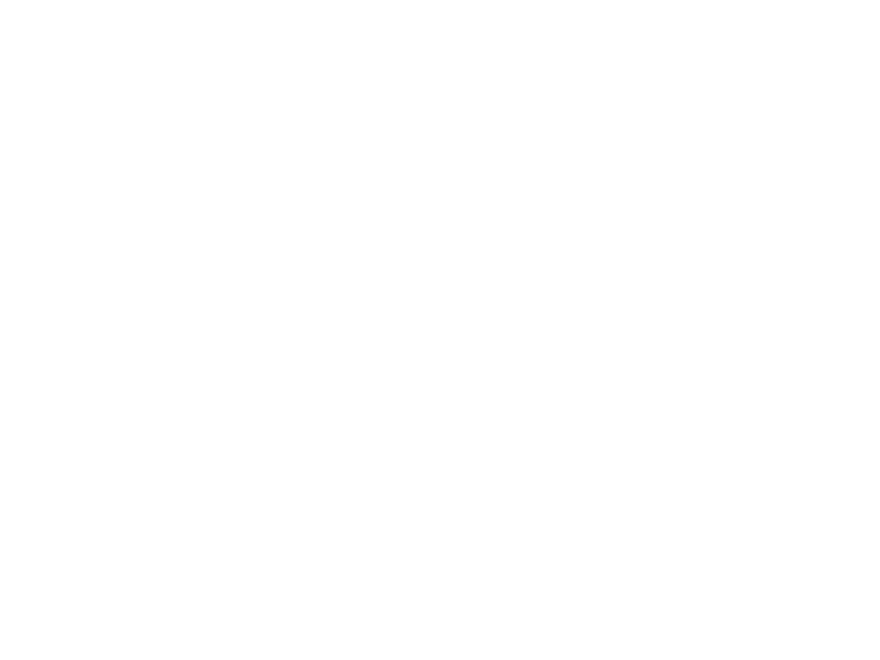

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0053.mp4

D:/HNSCC/HNSCC-01-0053\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


45


<IPython.core.display.Javascript object>


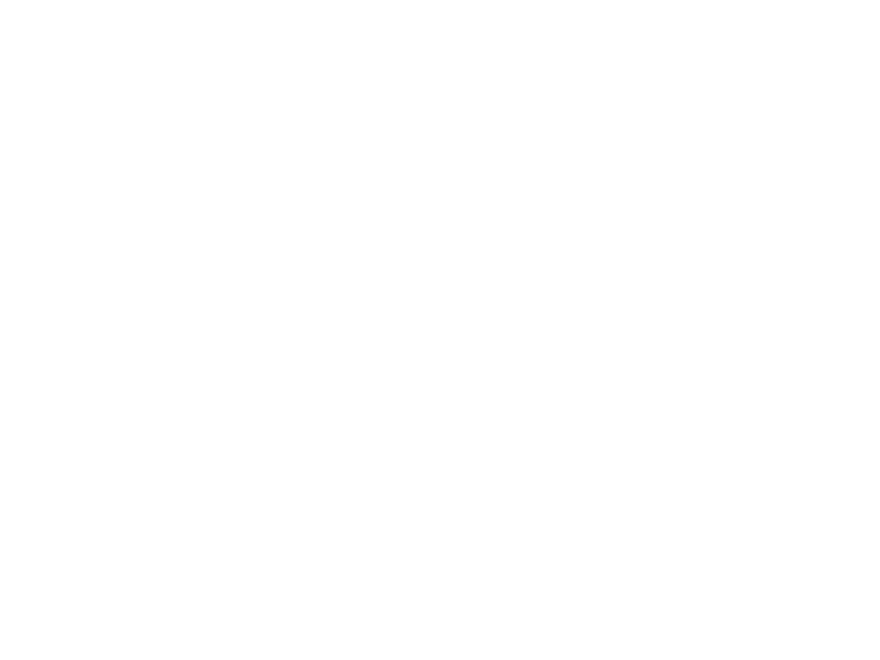

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0053.mp4

D:/HNSCC/HNSCC-01-0053\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0053\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0054\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


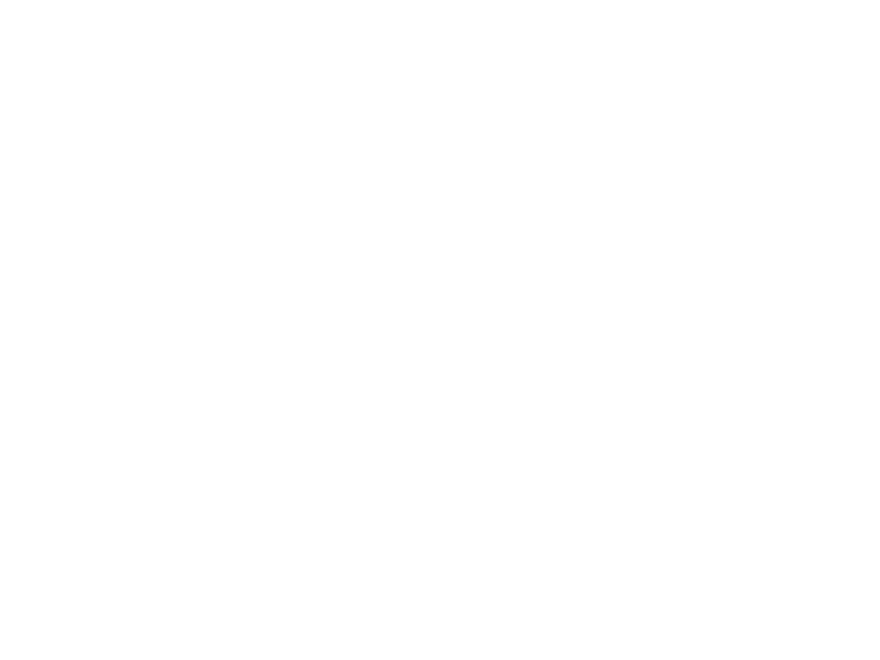

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0054.mp4

D:/HNSCC/HNSCC-01-0054\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


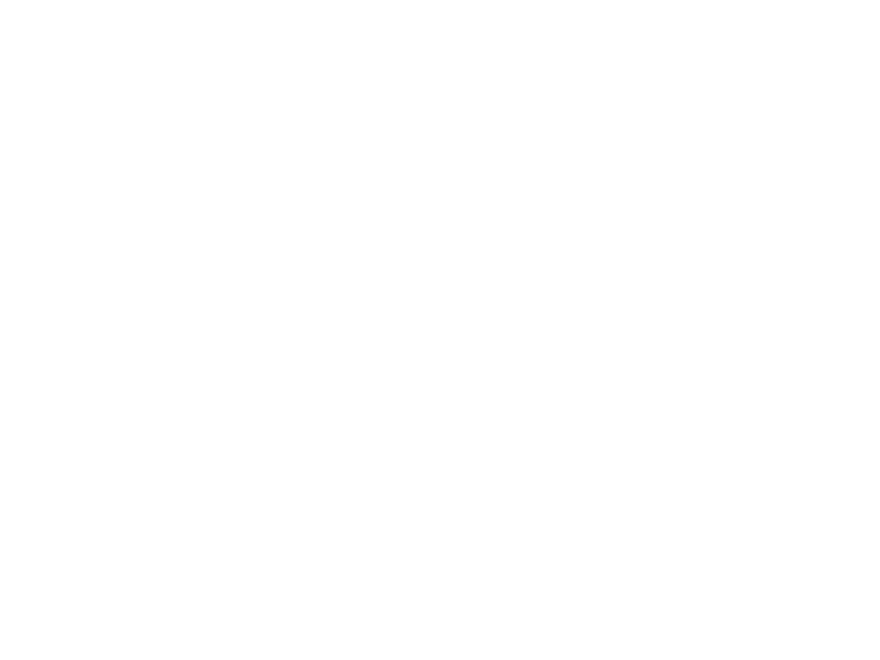

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0054.mp4

D:/HNSCC/HNSCC-01-0054\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


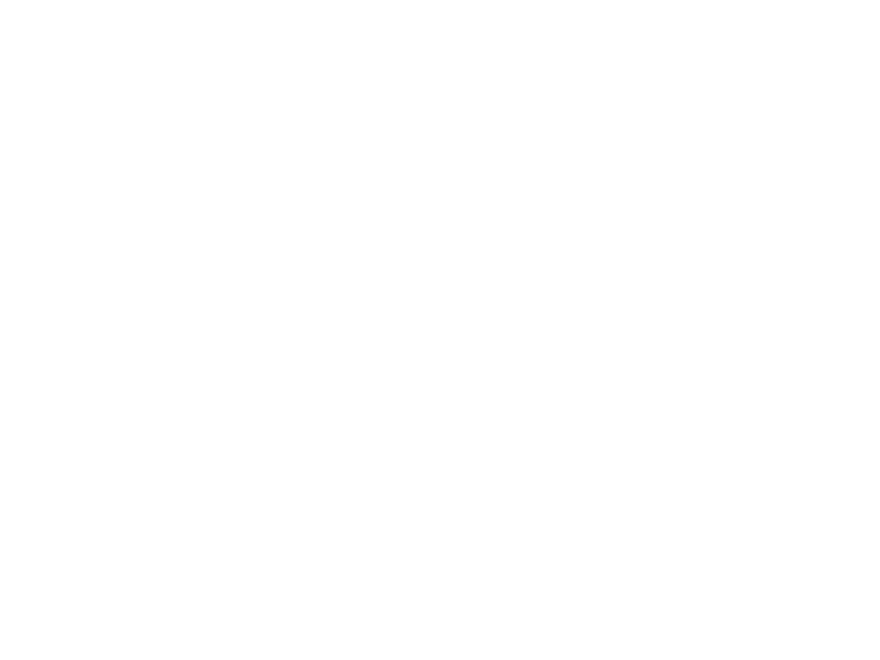

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0054.mp4

D:/HNSCC/HNSCC-01-0054\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0054\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0055\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


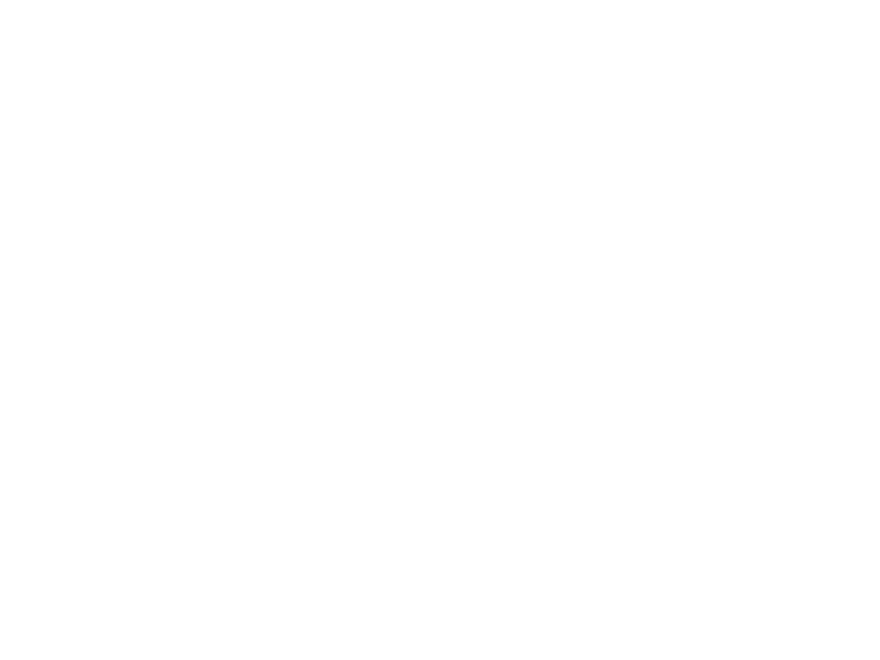

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0055.mp4

D:/HNSCC/HNSCC-01-0055\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


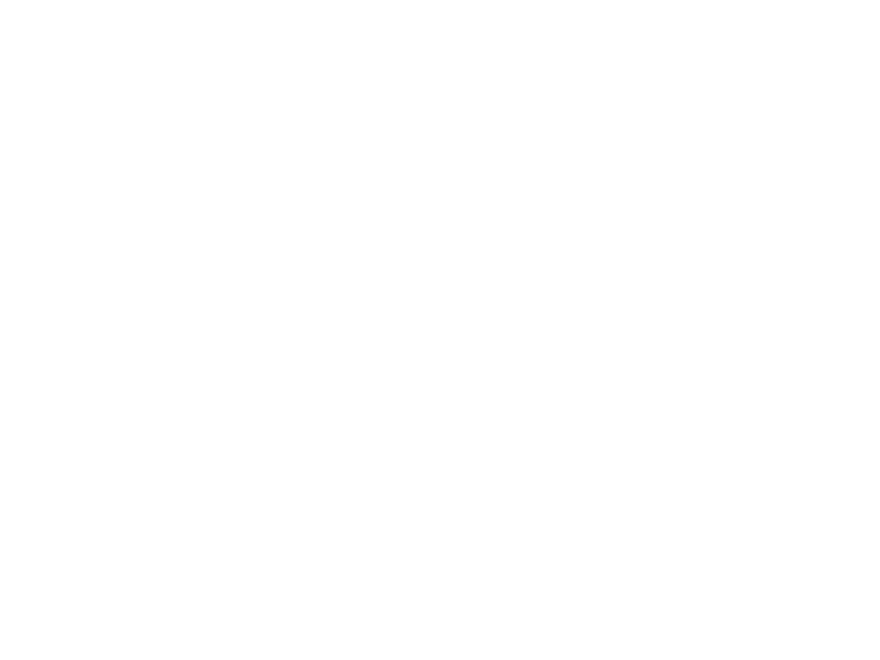

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0055.mp4

D:/HNSCC/HNSCC-01-0055\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


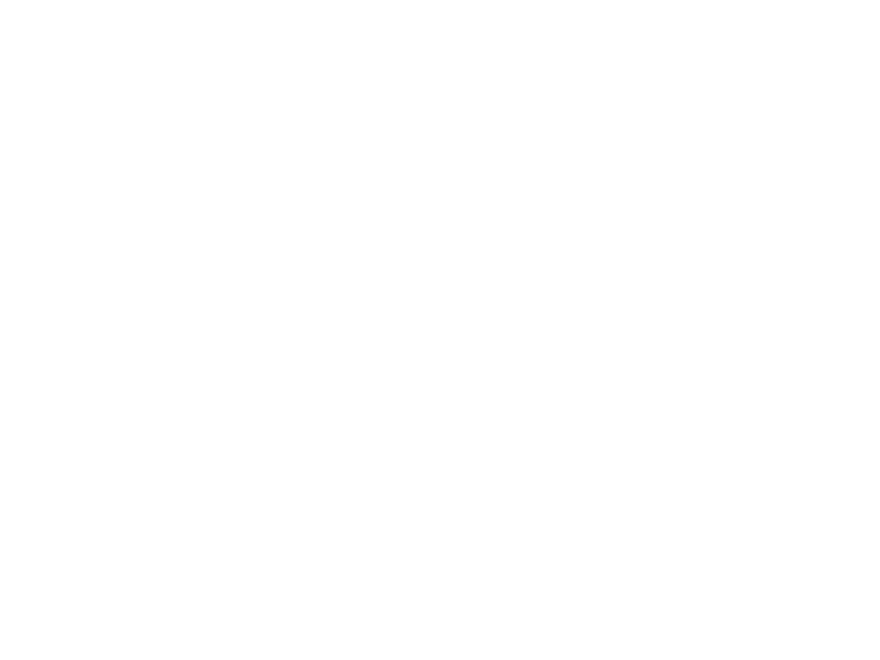

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0055.mp4

D:/HNSCC/HNSCC-01-0055\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0055\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0056\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


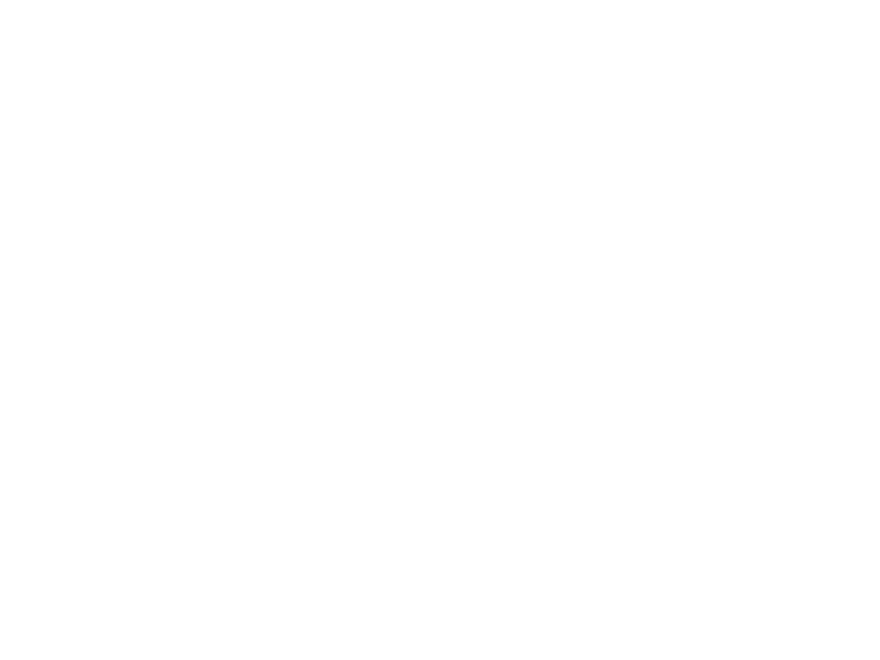

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0056.mp4

D:/HNSCC/HNSCC-01-0056\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


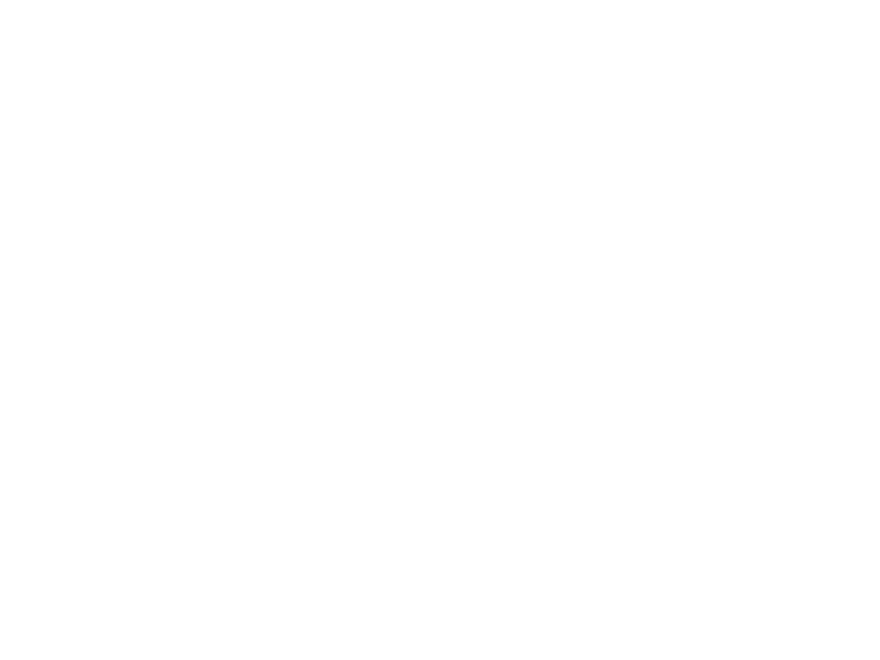

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0056.mp4

D:/HNSCC/HNSCC-01-0056\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


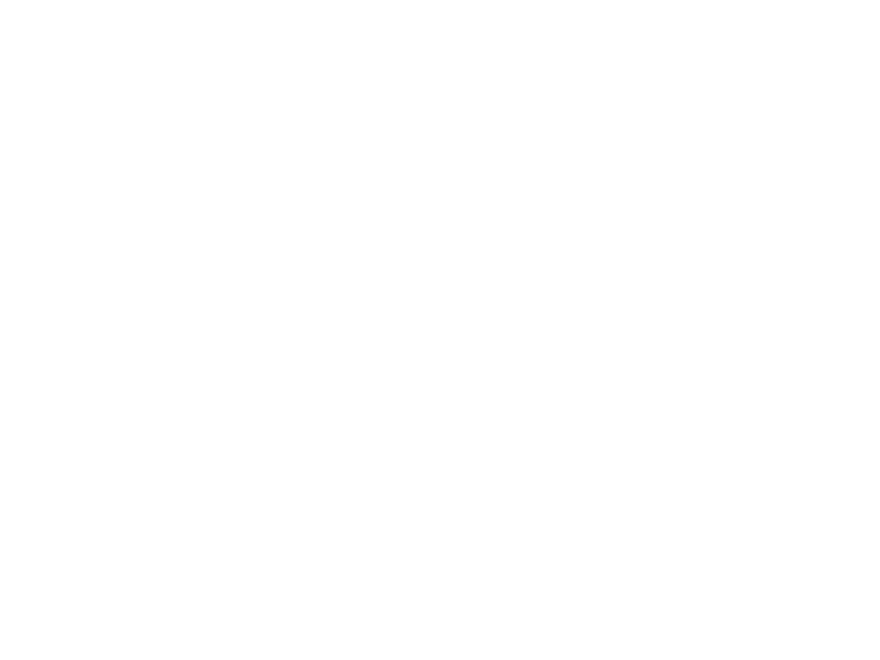

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0056.mp4

D:/HNSCC/HNSCC-01-0056\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0056\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0057\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


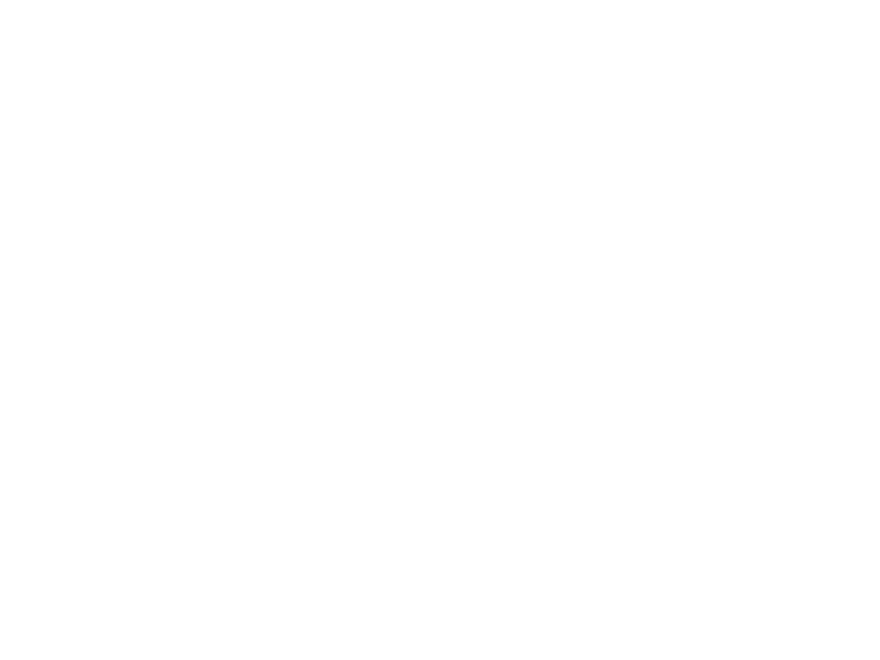

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0057.mp4

D:/HNSCC/HNSCC-01-0057\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


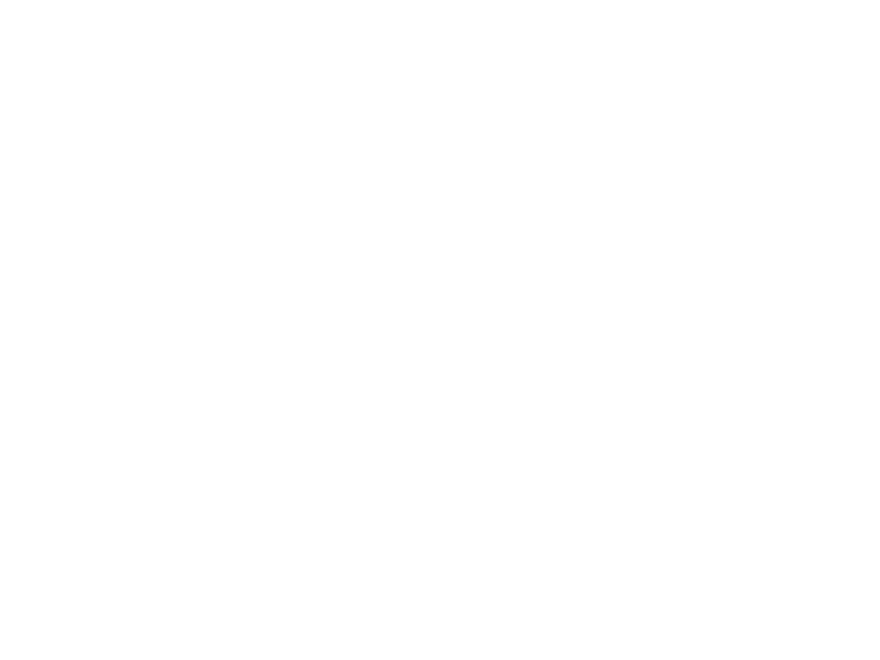

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0057.mp4

D:/HNSCC/HNSCC-01-0057\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


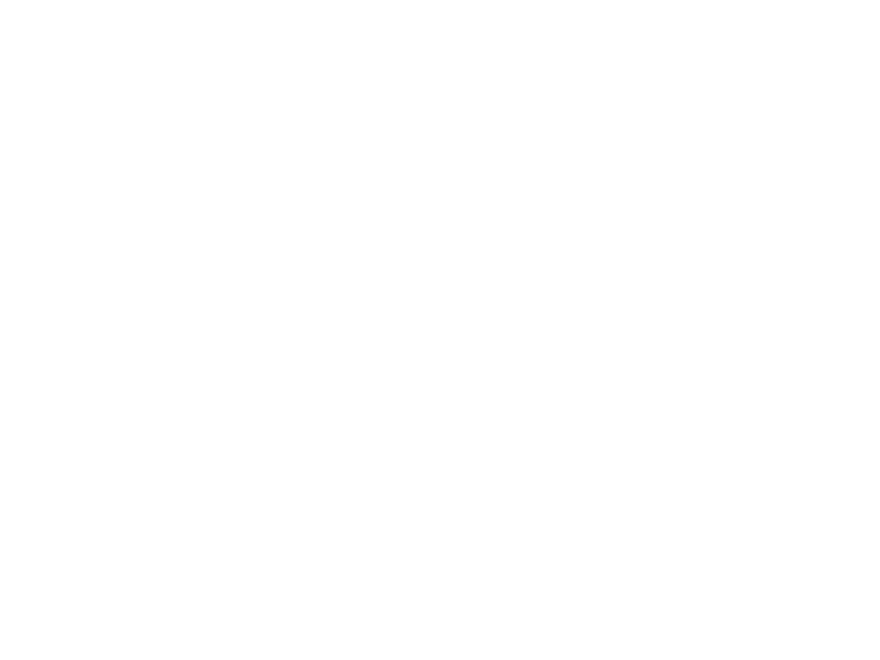

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0057.mp4

D:/HNSCC/HNSCC-01-0057\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0057\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0058\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


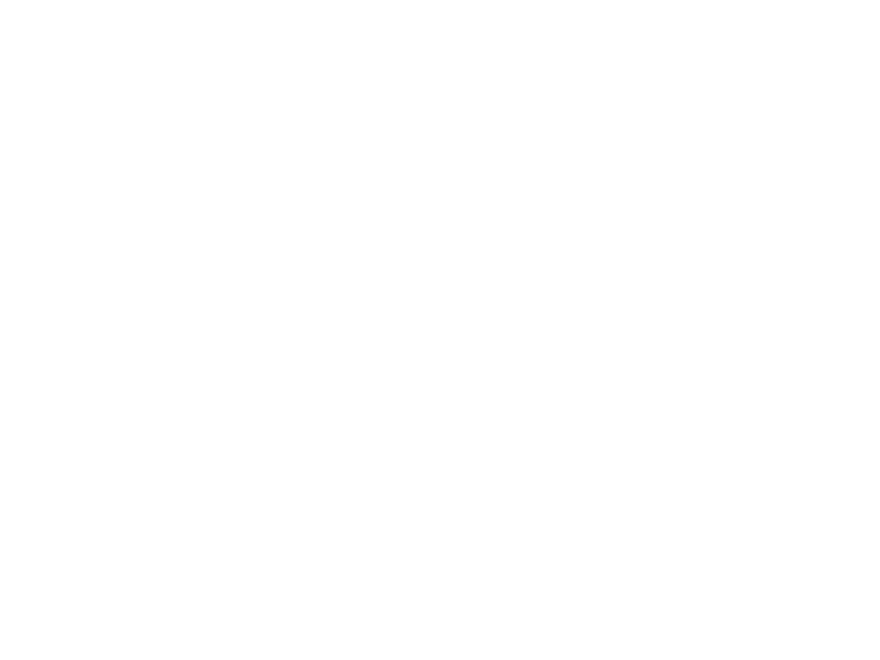

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0058.mp4

D:/HNSCC/HNSCC-01-0058\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


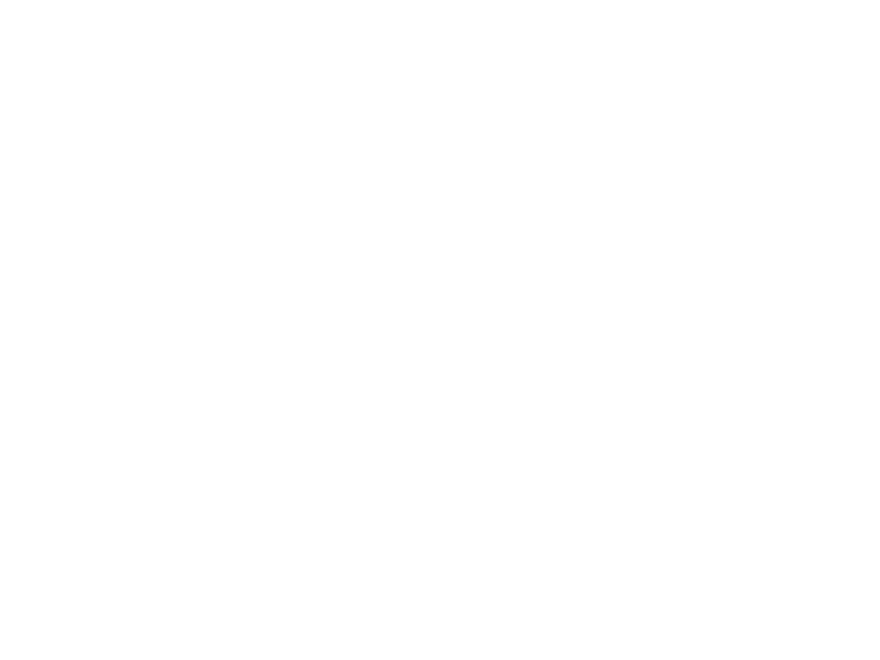

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0058.mp4

D:/HNSCC/HNSCC-01-0058\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


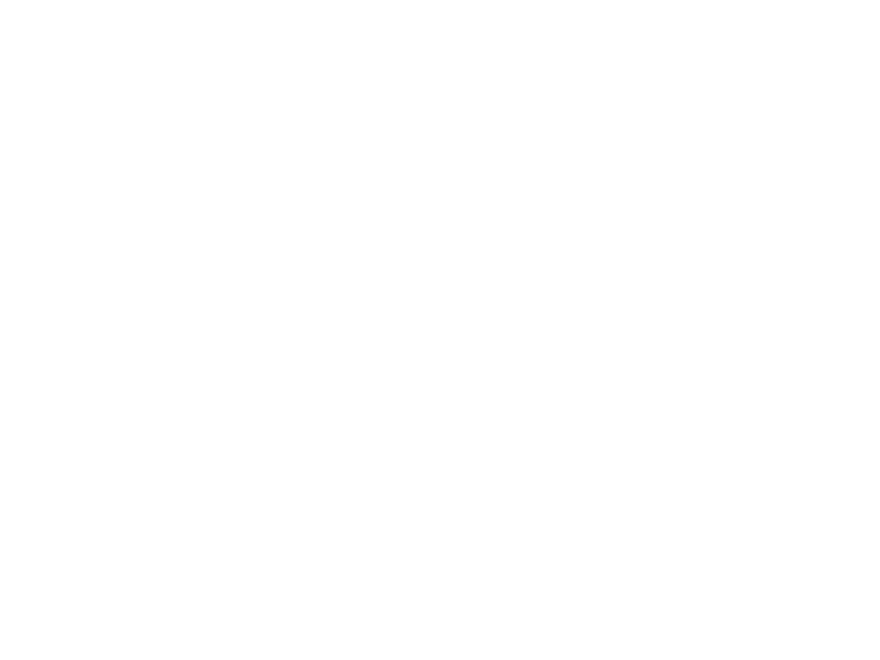

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0058.mp4

D:/HNSCC/HNSCC-01-0058\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0058\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0059\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


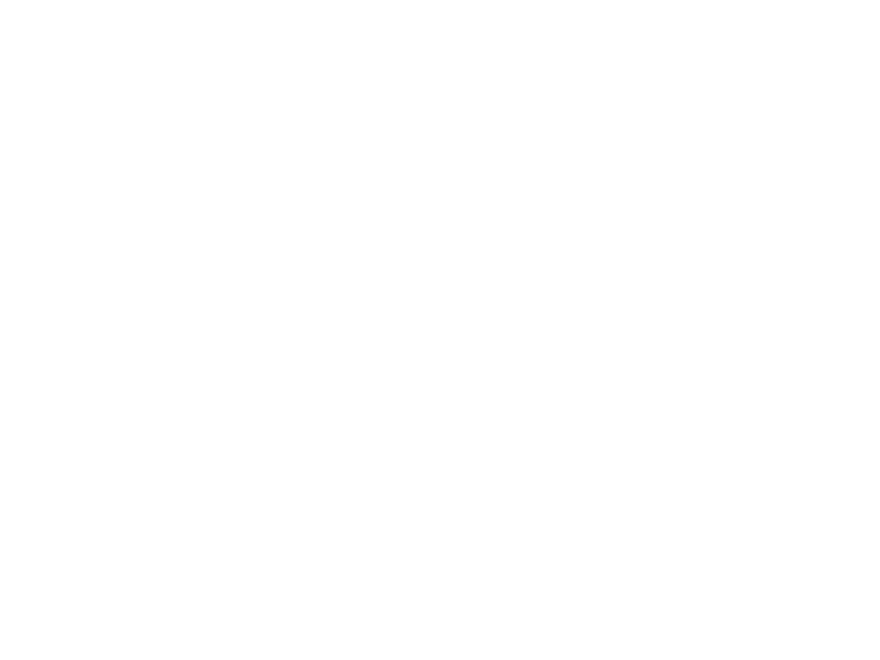

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0059.mp4

D:/HNSCC/HNSCC-01-0059\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


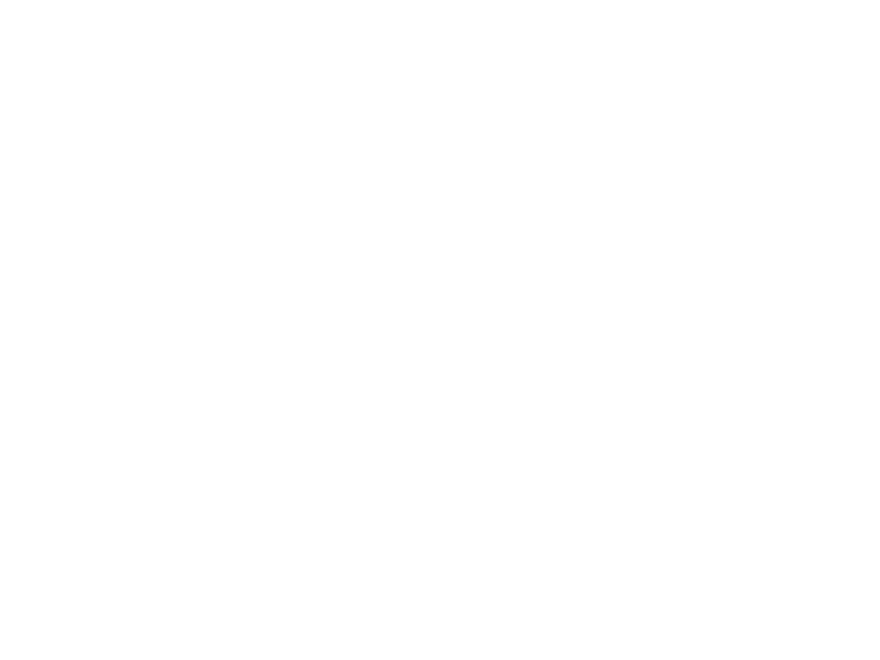

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0059.mp4

D:/HNSCC/HNSCC-01-0059\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


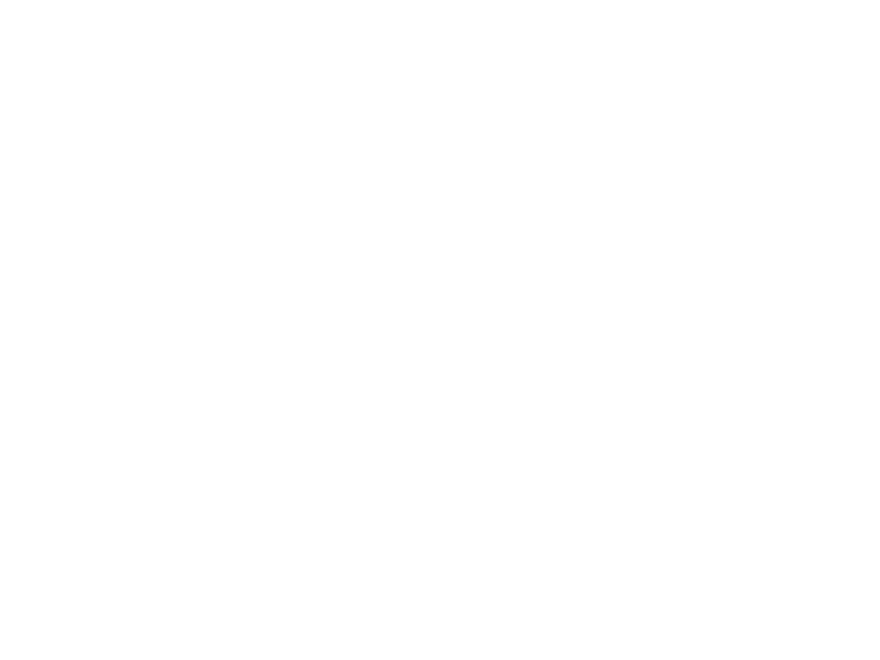

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0059.mp4

D:/HNSCC/HNSCC-01-0059\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0059\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0060\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


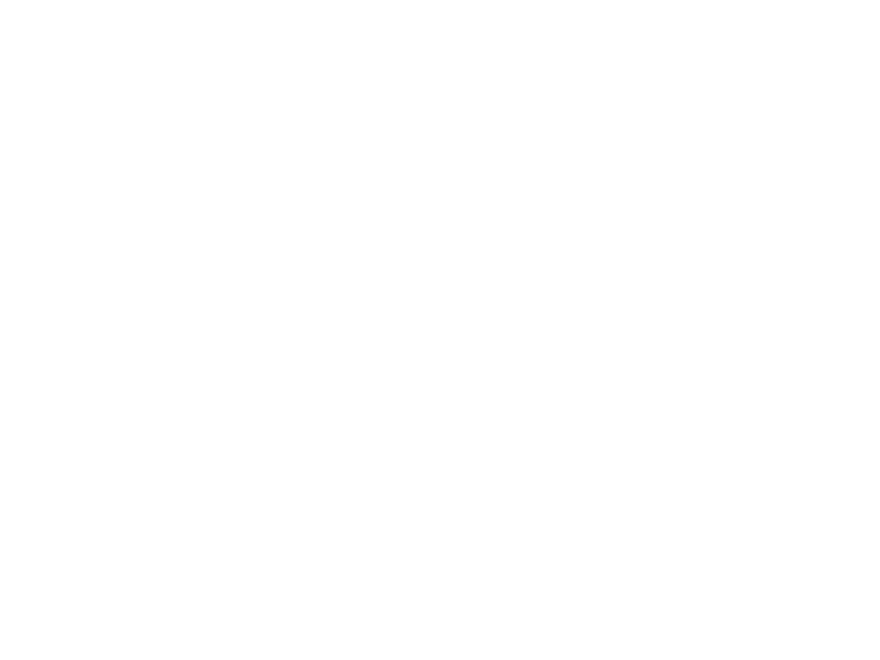

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0060.mp4

D:/HNSCC/HNSCC-01-0060\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


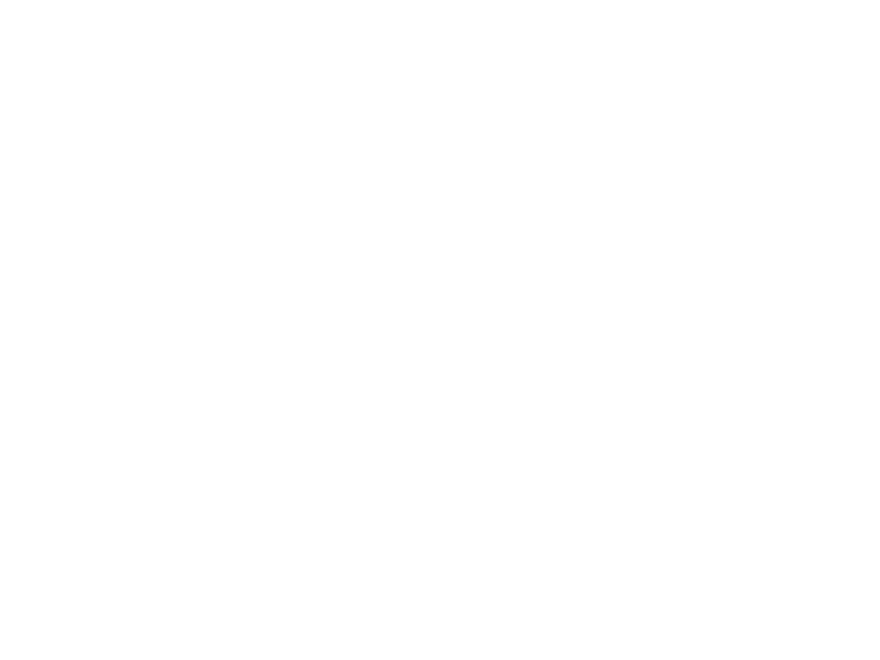

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0060.mp4

D:/HNSCC/HNSCC-01-0060\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


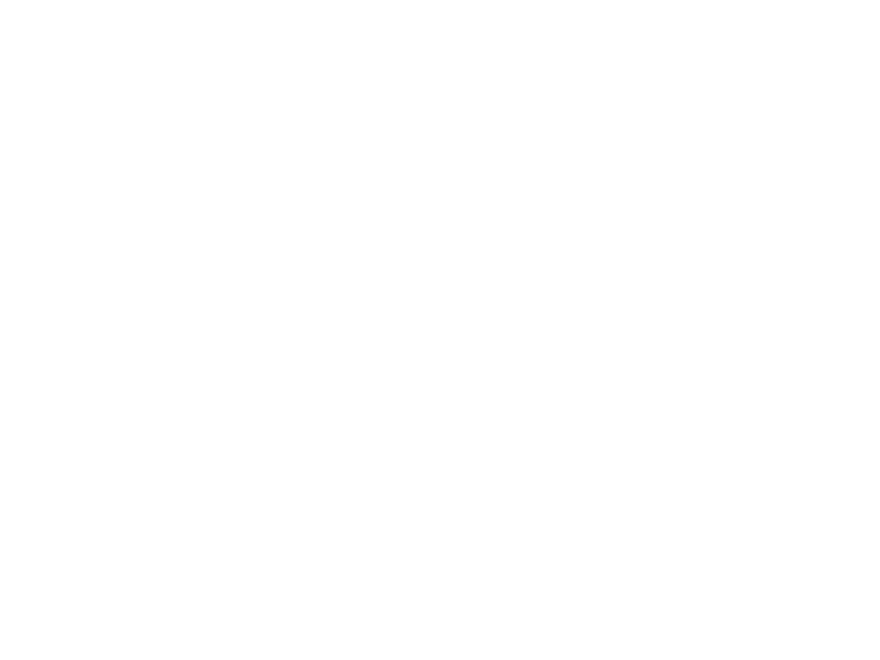

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0060.mp4

D:/HNSCC/HNSCC-01-0060\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0060\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0061\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


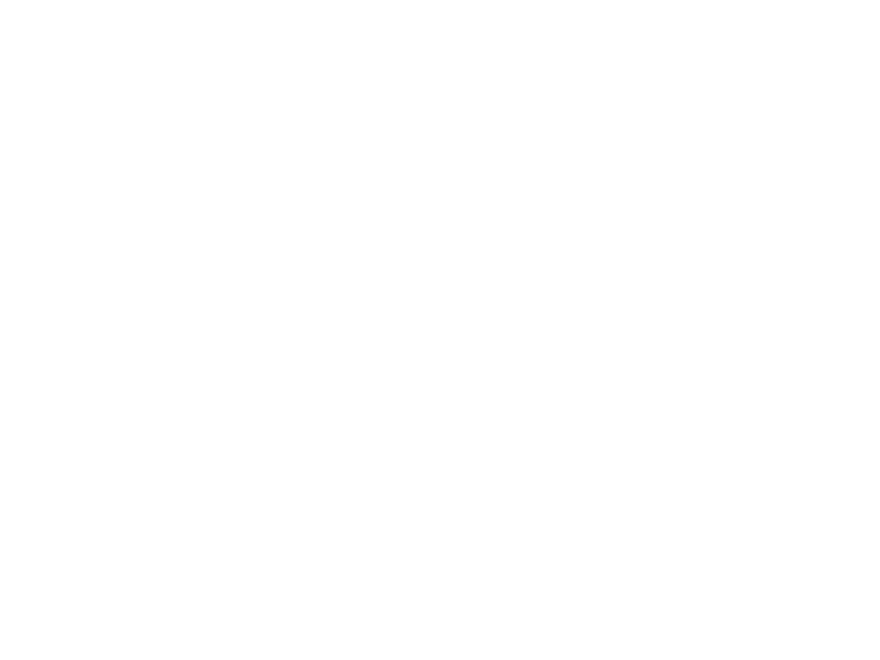

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0061.mp4

D:/HNSCC/HNSCC-01-0061\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


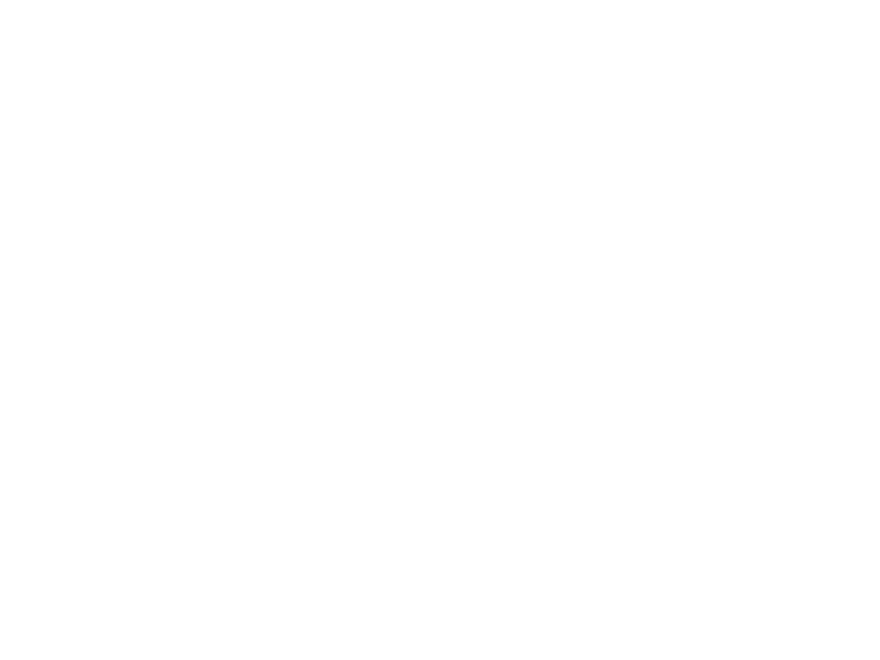

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0061.mp4

D:/HNSCC/HNSCC-01-0061\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


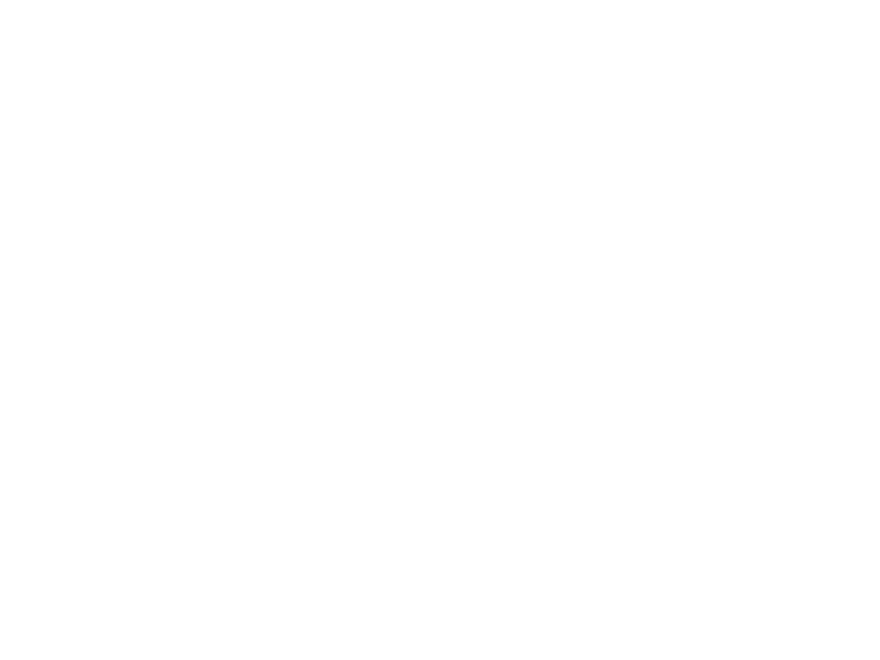

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0061.mp4

D:/HNSCC/HNSCC-01-0061\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0061\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0062\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0062\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0062\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0062\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0062\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0063\
Thickness 1: 2.500
Thickness 

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


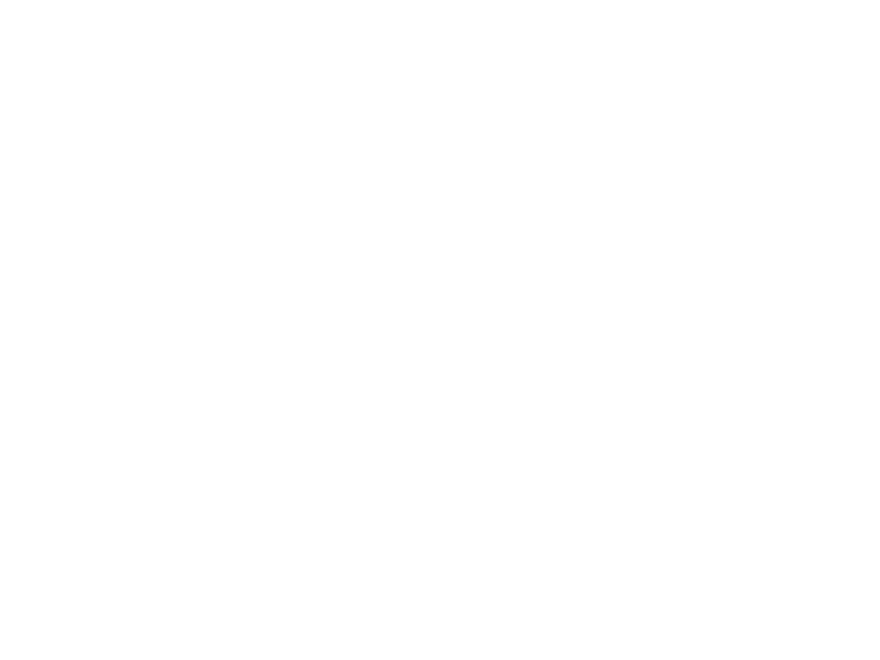

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0063.mp4

D:/HNSCC/HNSCC-01-0063\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


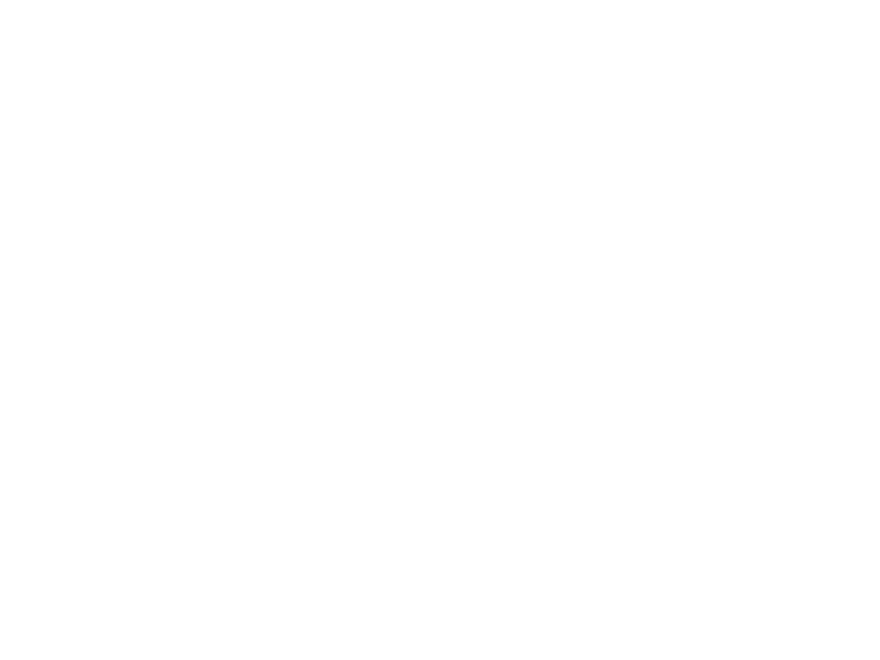

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0063.mp4

D:/HNSCC/HNSCC-01-0063\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


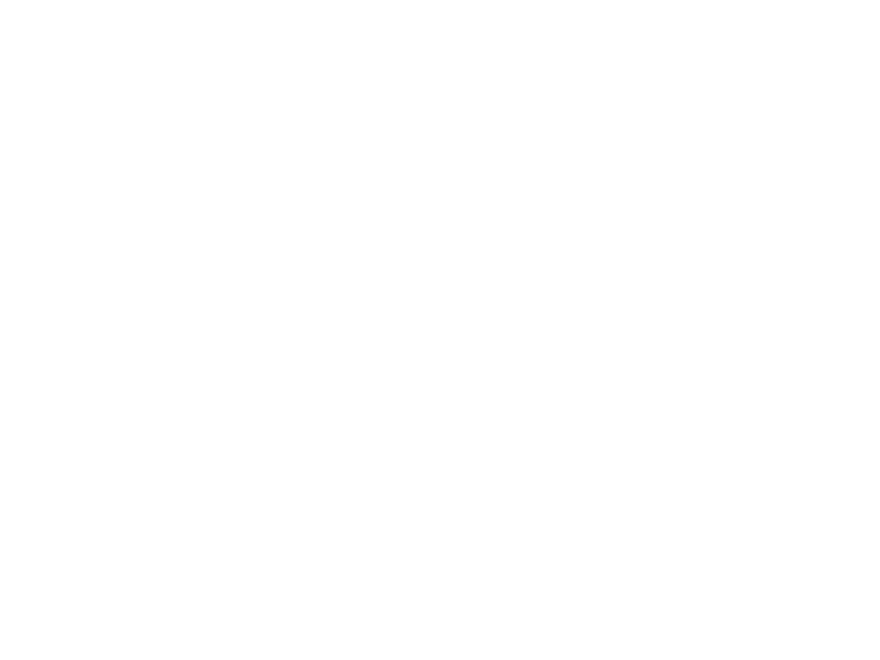

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0063.mp4

D:/HNSCC/HNSCC-01-0063\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0063\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0064\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


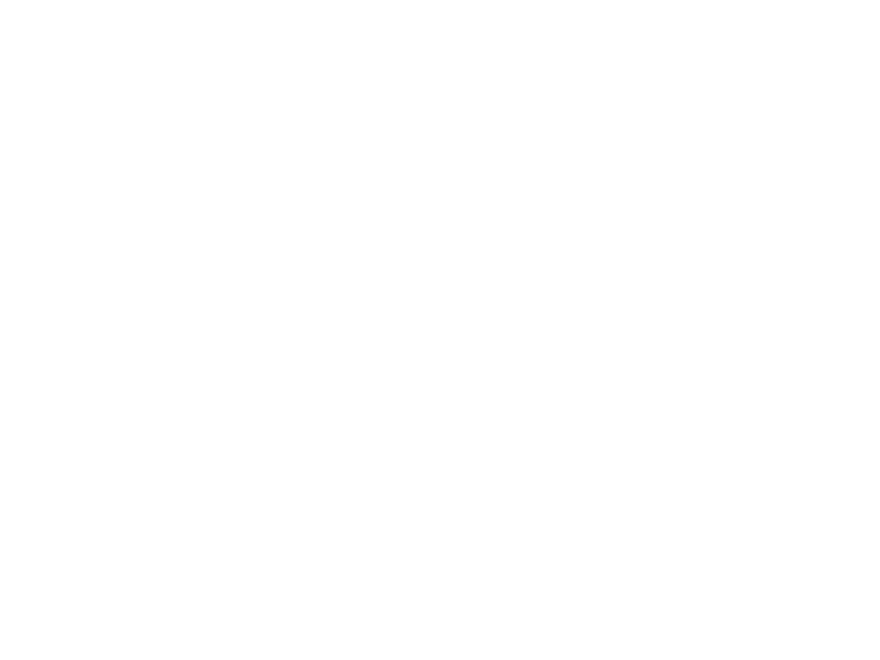

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0064.mp4

D:/HNSCC/HNSCC-01-0064\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


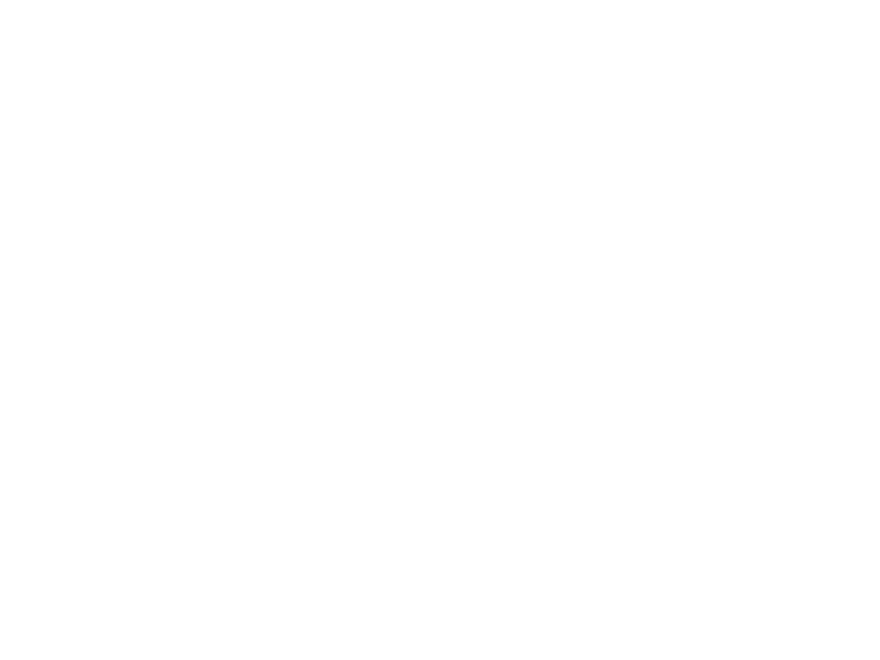

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0064.mp4

D:/HNSCC/HNSCC-01-0064\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


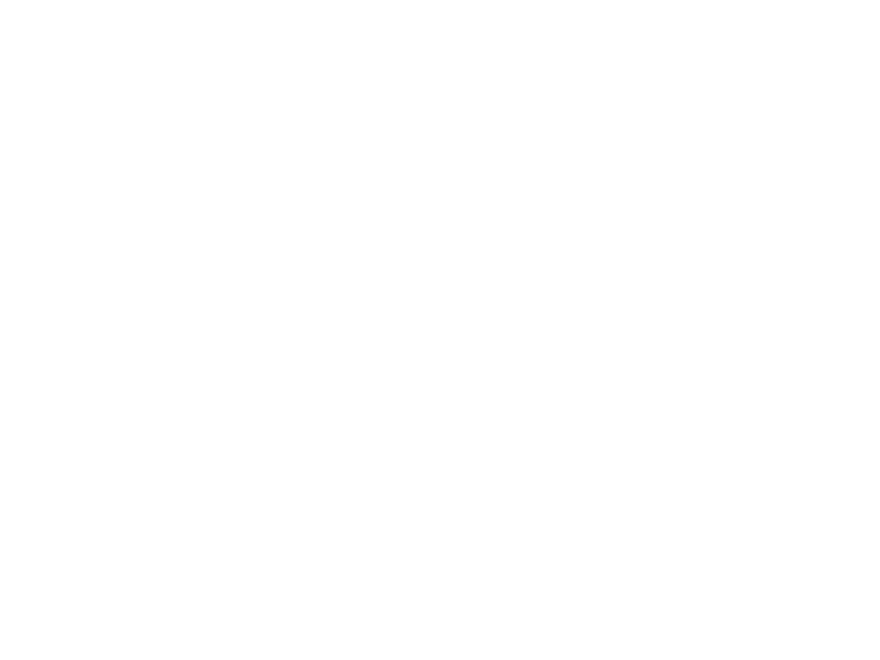

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0064.mp4

D:/HNSCC/HNSCC-01-0064\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0064\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0065\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


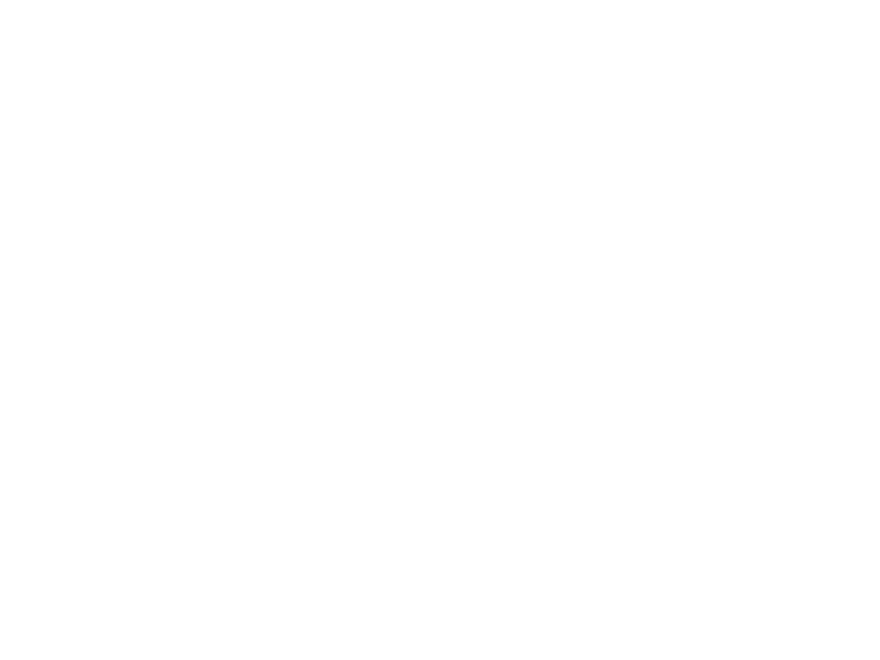

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0065.mp4

D:/HNSCC/HNSCC-01-0065\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


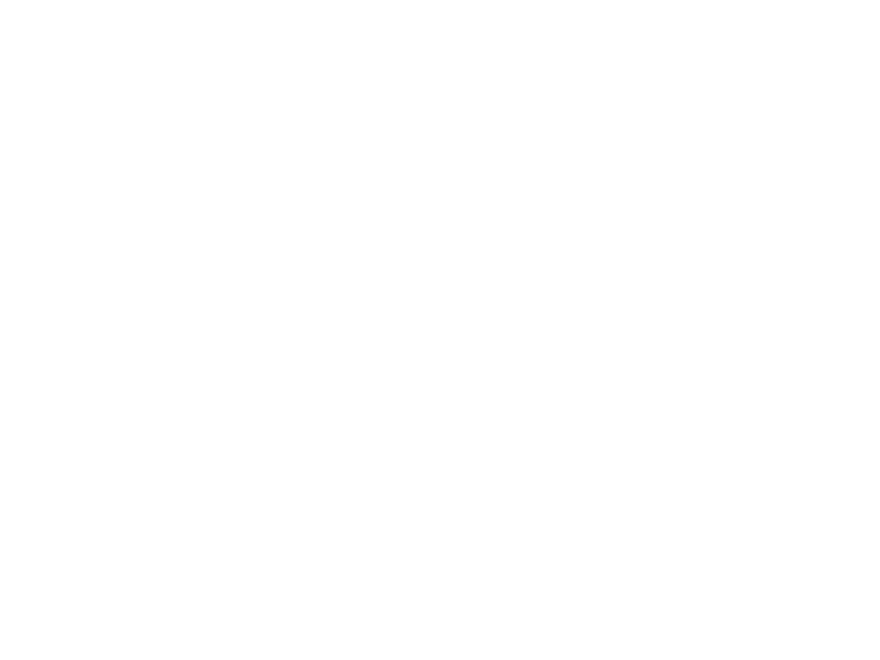

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0065.mp4

D:/HNSCC/HNSCC-01-0065\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


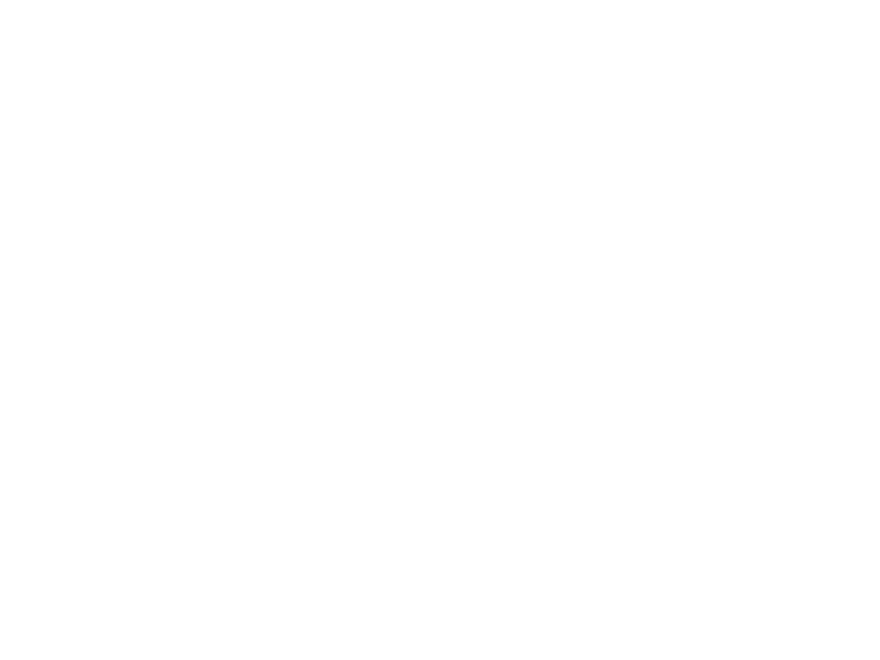

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0065.mp4

D:/HNSCC/HNSCC-01-0065\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0065\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0066\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


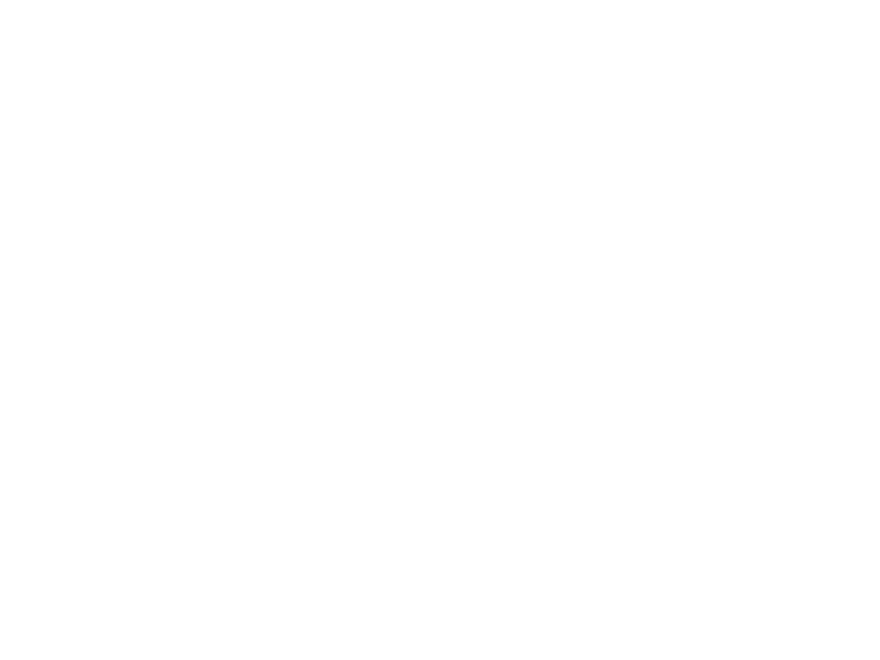

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0066.mp4

D:/HNSCC/HNSCC-01-0066\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


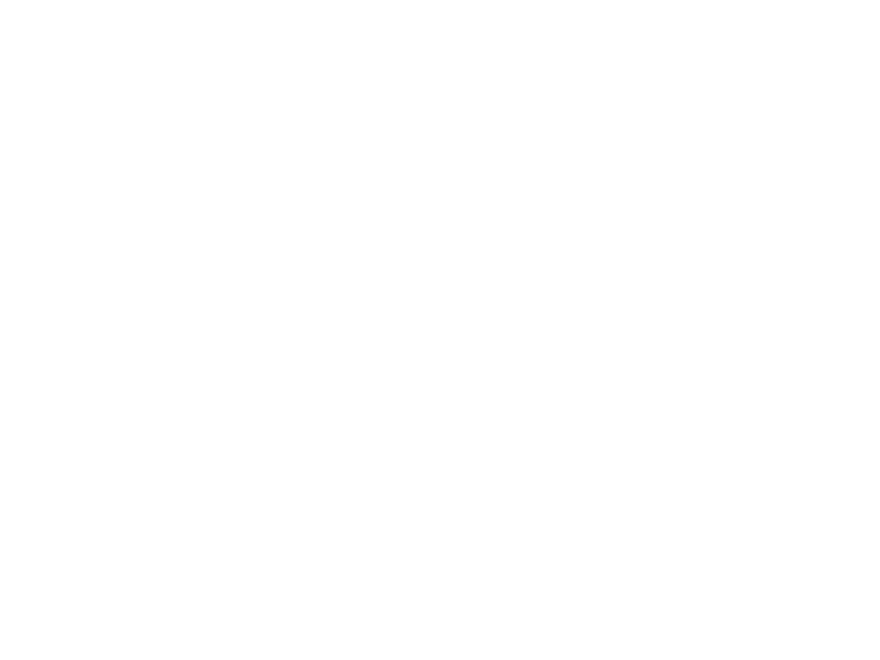

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0066.mp4

D:/HNSCC/HNSCC-01-0066\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


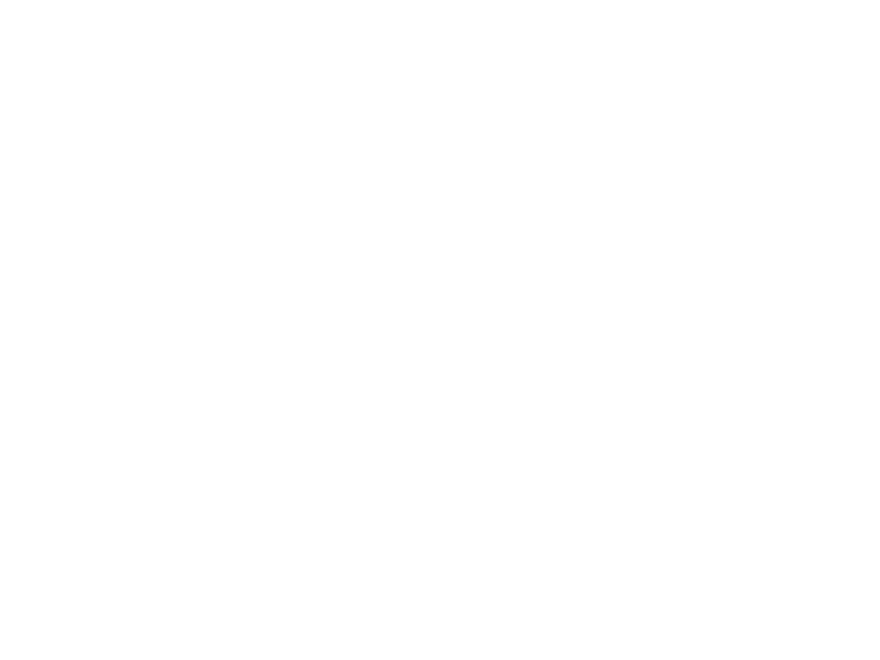

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0066.mp4

D:/HNSCC/HNSCC-01-0066\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0066\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0067\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


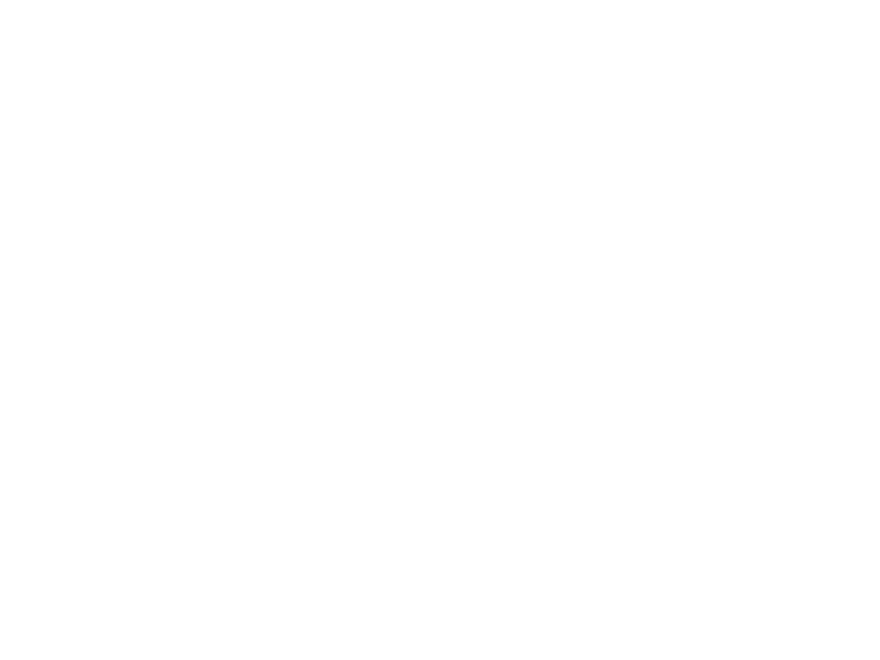

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0067.mp4

D:/HNSCC/HNSCC-01-0067\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


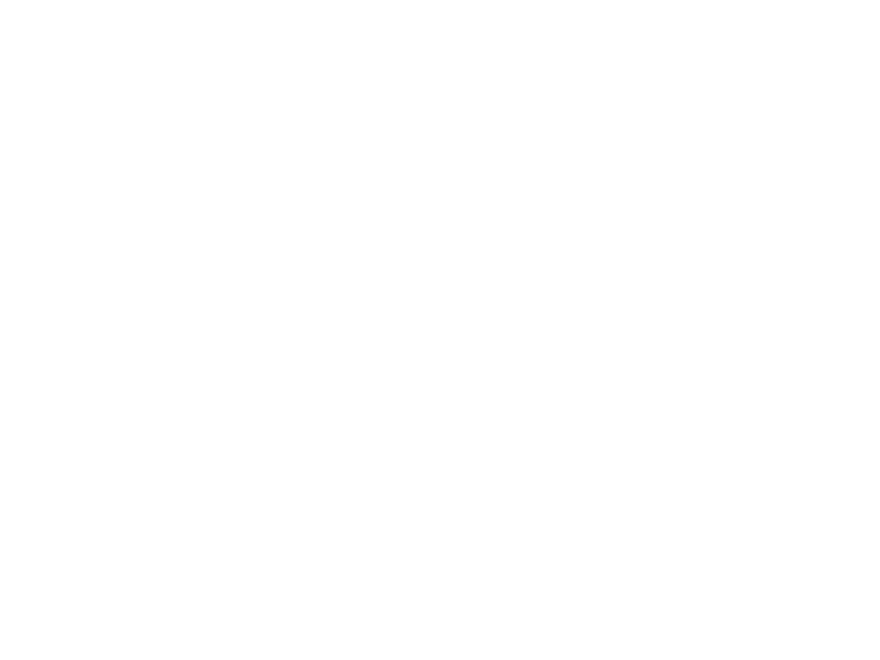

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0067.mp4

D:/HNSCC/HNSCC-01-0067\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


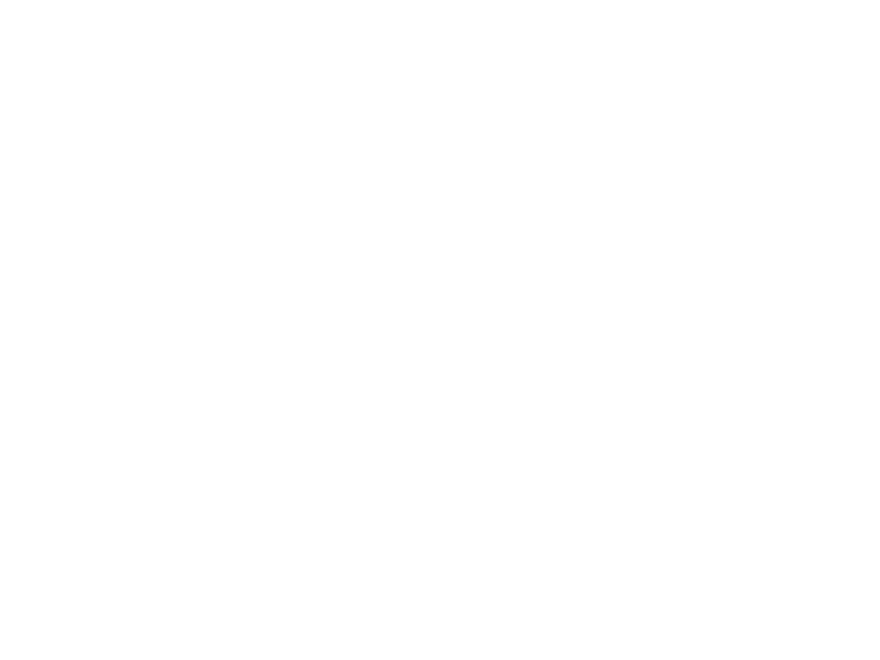

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0067.mp4

D:/HNSCC/HNSCC-01-0067\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0067\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0068\
Thickness 1: 2.570
Thickness 2: 3.000
Thickness 3: 2.570
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


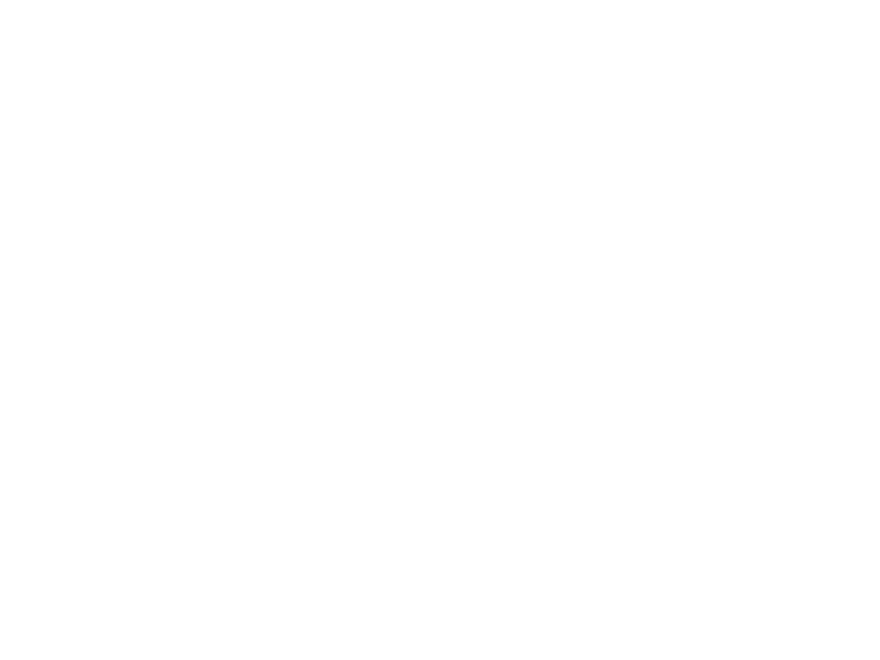

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0068.mp4

D:/HNSCC/HNSCC-01-0068\
Thickness 1: 2.570
Thickness 2: 3.000
Thickness 3: 2.570
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


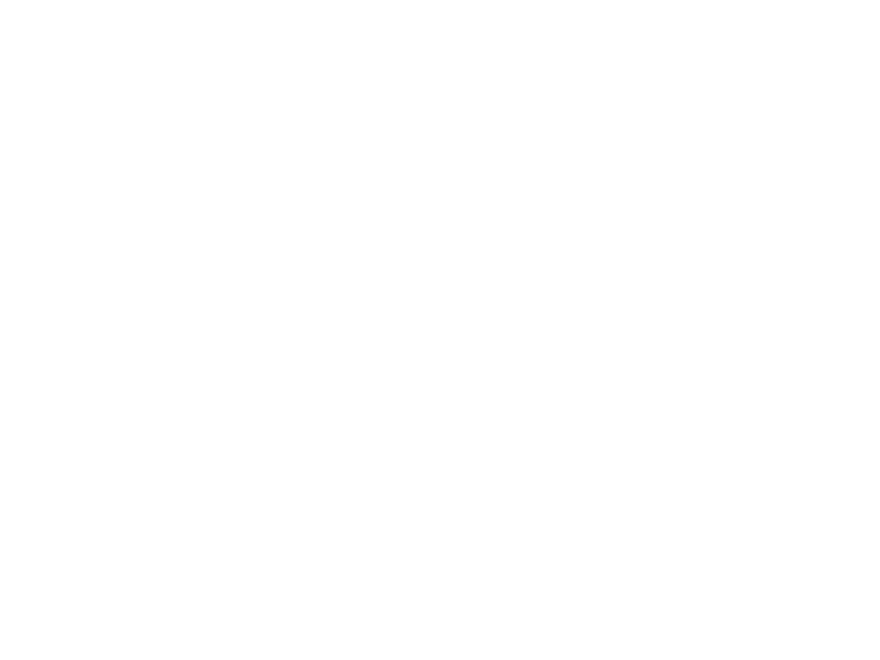

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0068.mp4

D:/HNSCC/HNSCC-01-0068\
Thickness 1: 2.570
Thickness 2: 3.000
Thickness 3: 2.570
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


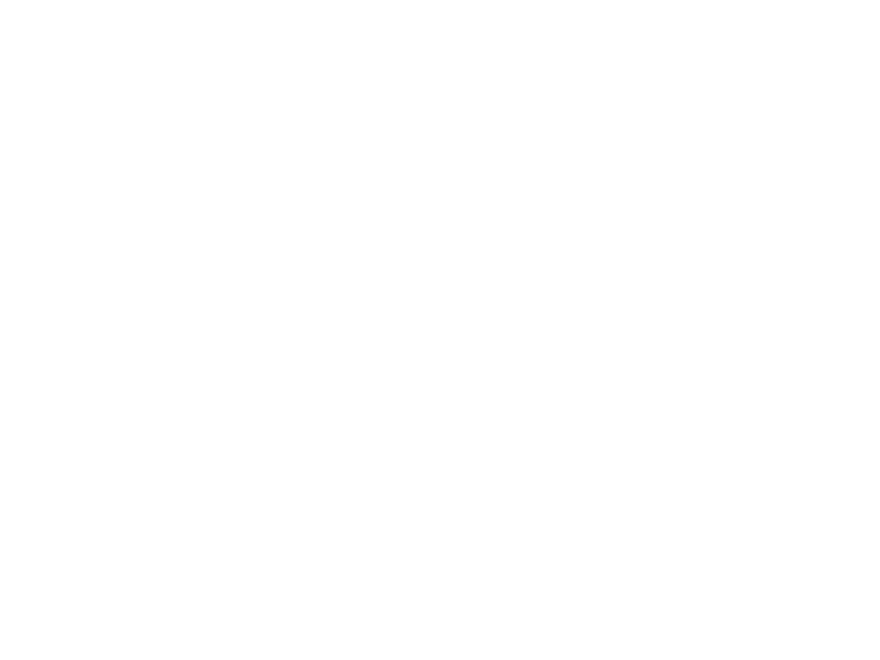

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0068.mp4

D:/HNSCC/HNSCC-01-0068\
Thickness 1: 2.570
Thickness 2: 3.000
Thickness 3: 2.570
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0068\
Thickness 1: 2.570
Thickness 2: 3.000
Thickness 3: 2.570
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0069\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


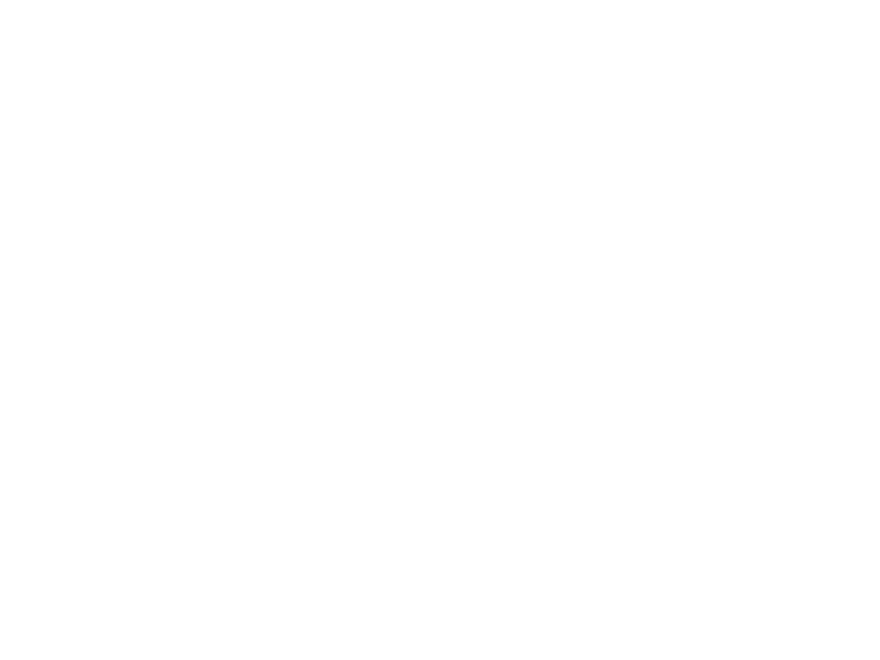

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0069.mp4

D:/HNSCC/HNSCC-01-0069\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


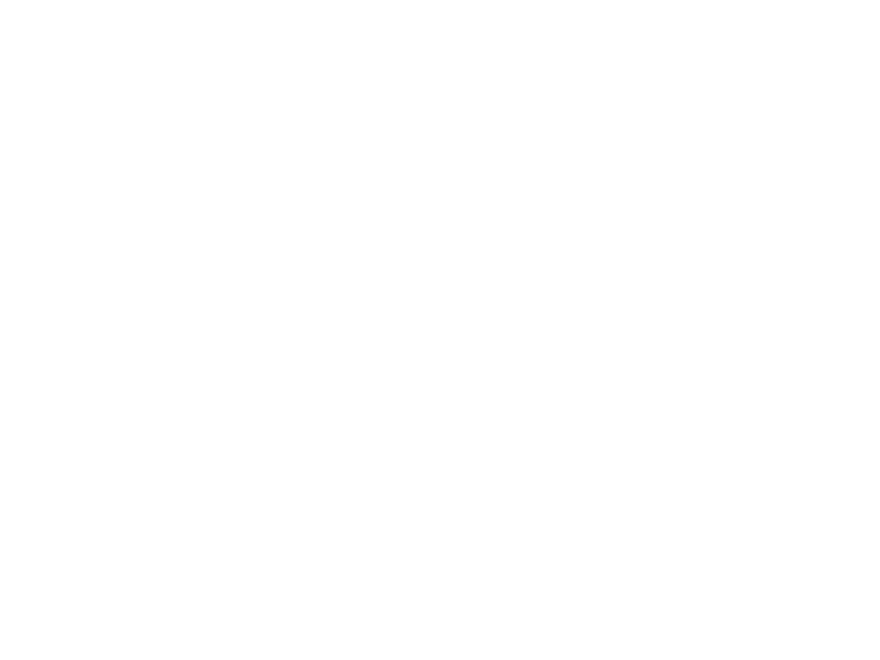

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0069.mp4

D:/HNSCC/HNSCC-01-0069\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


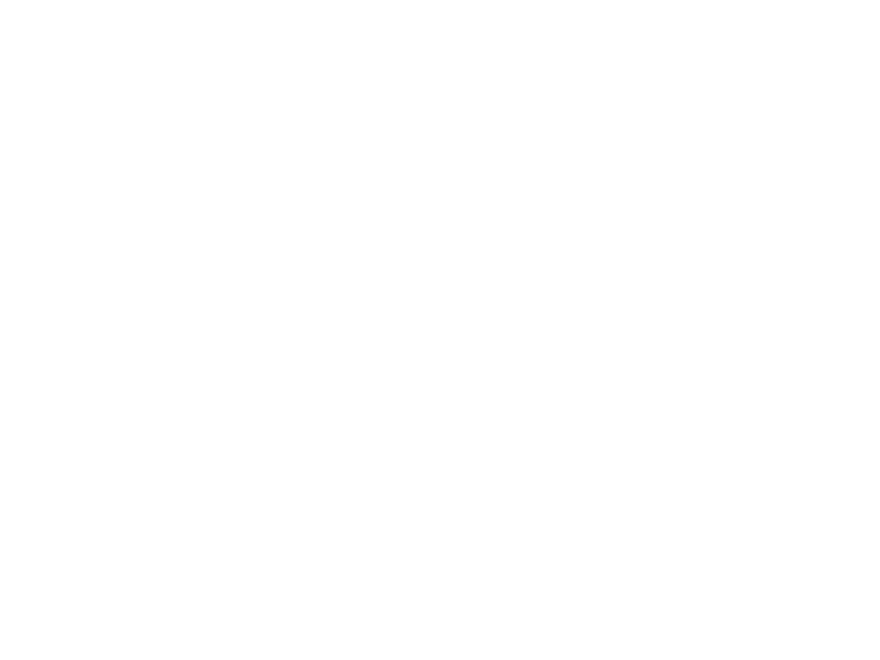

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0069.mp4

D:/HNSCC/HNSCC-01-0069\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0069\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0070\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0070\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0070\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0070\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0070\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0071\
Thickness 1: 2.500
Thickness 

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


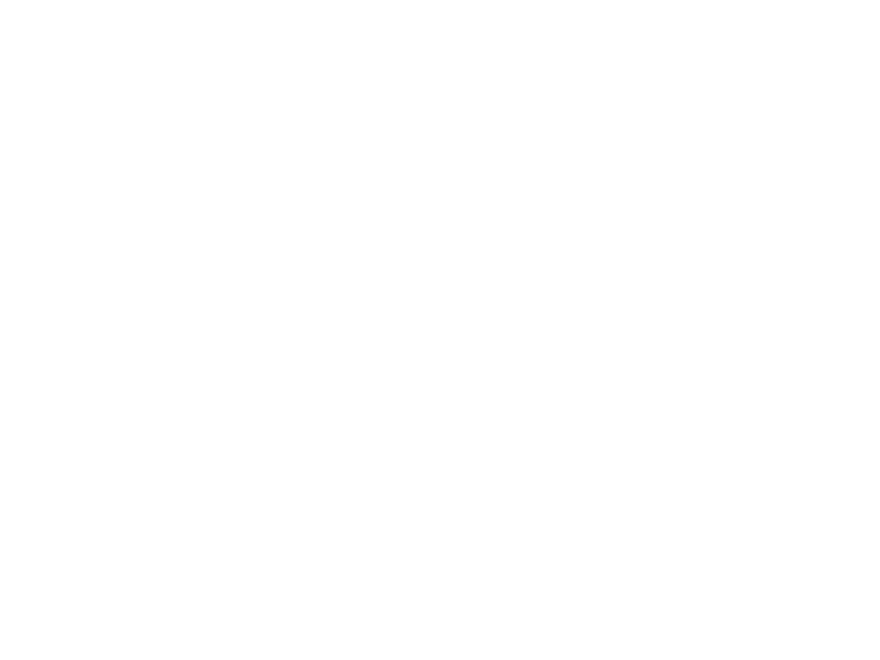

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0071.mp4

D:/HNSCC/HNSCC-01-0071\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


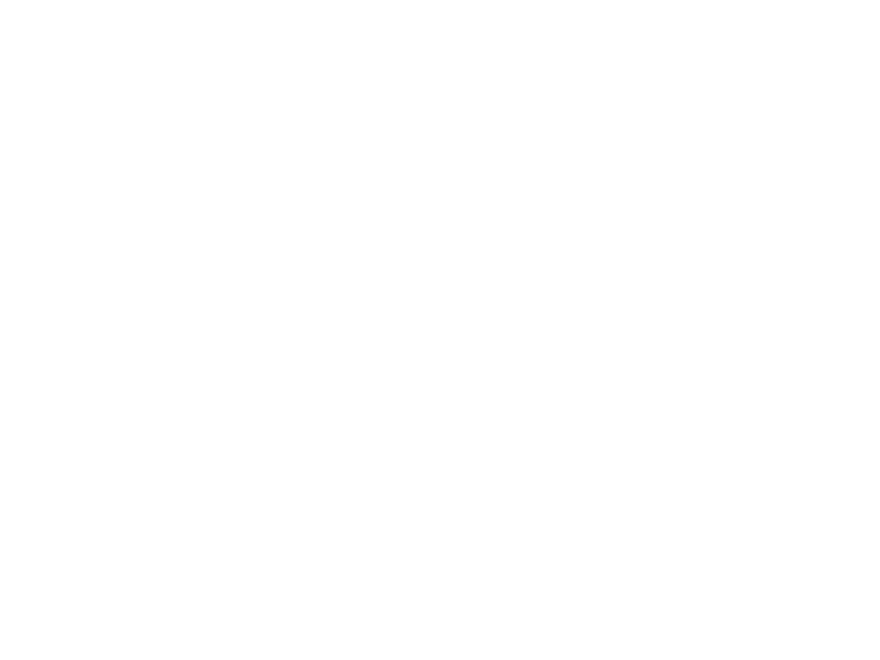

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0071.mp4

D:/HNSCC/HNSCC-01-0071\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


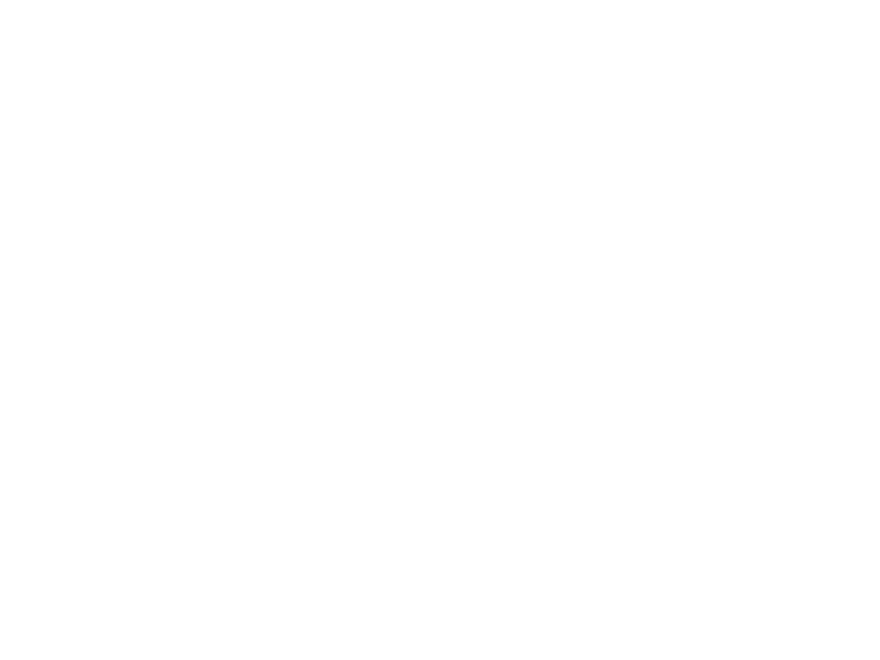

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0071.mp4

D:/HNSCC/HNSCC-01-0071\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0071\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0072\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


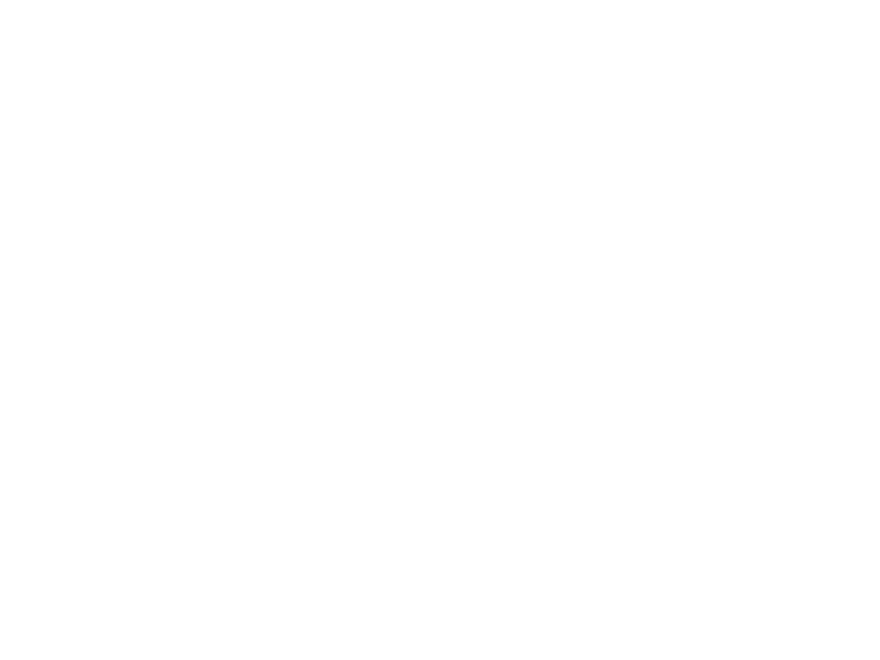

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0072.mp4

D:/HNSCC/HNSCC-01-0072\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


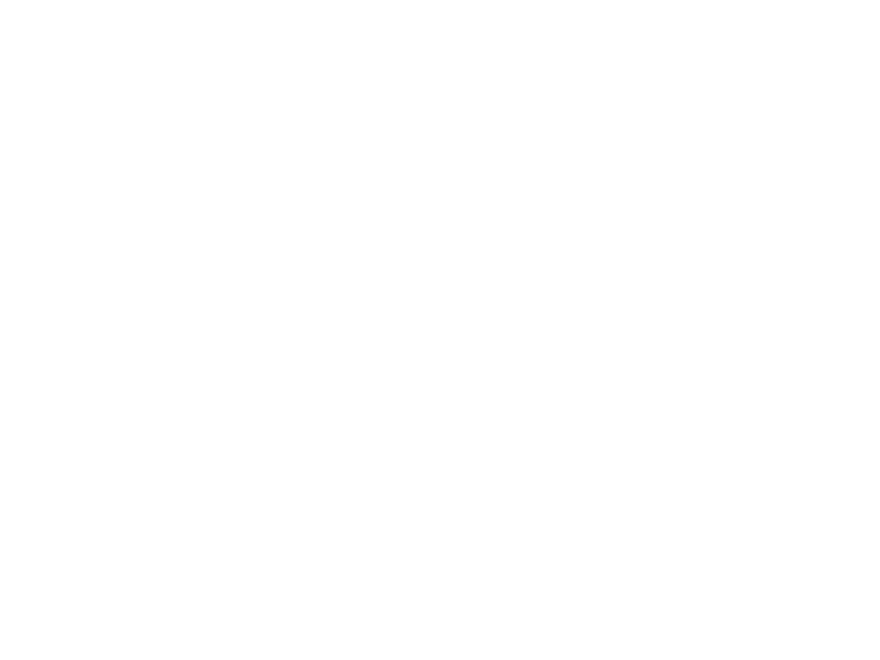

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0072.mp4

D:/HNSCC/HNSCC-01-0072\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


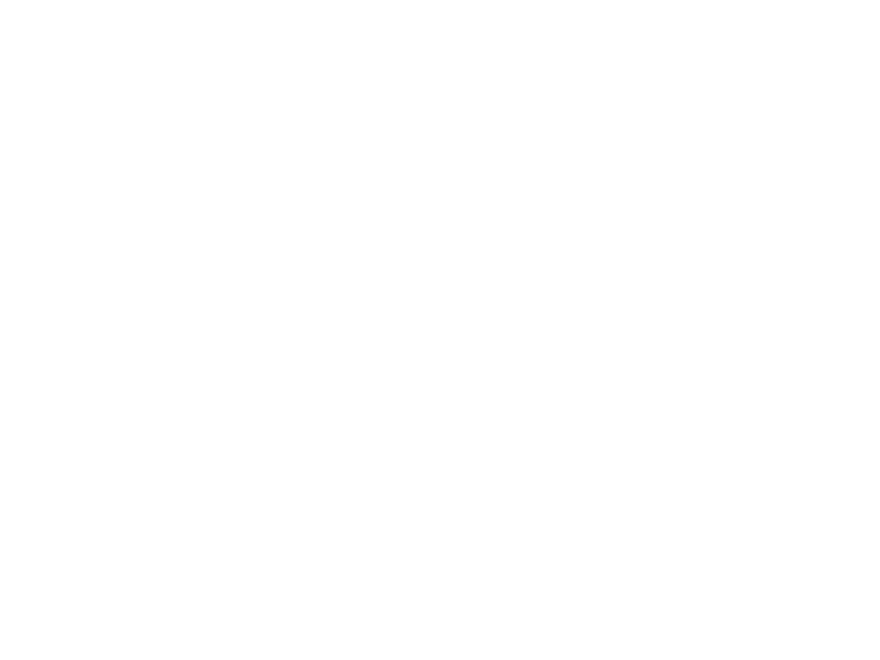

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0072.mp4

D:/HNSCC/HNSCC-01-0072\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0072\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0073\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


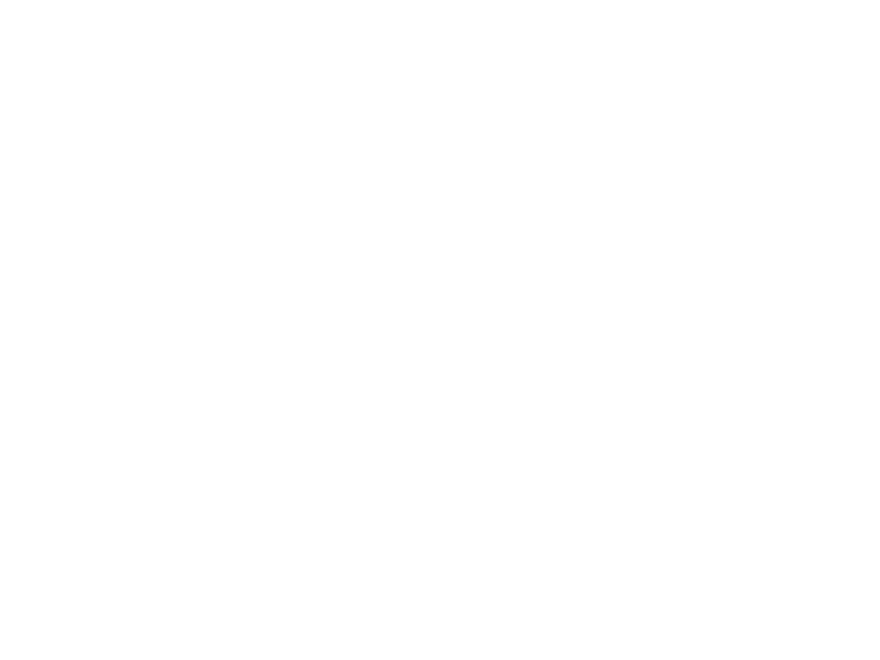

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0073.mp4

D:/HNSCC/HNSCC-01-0073\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


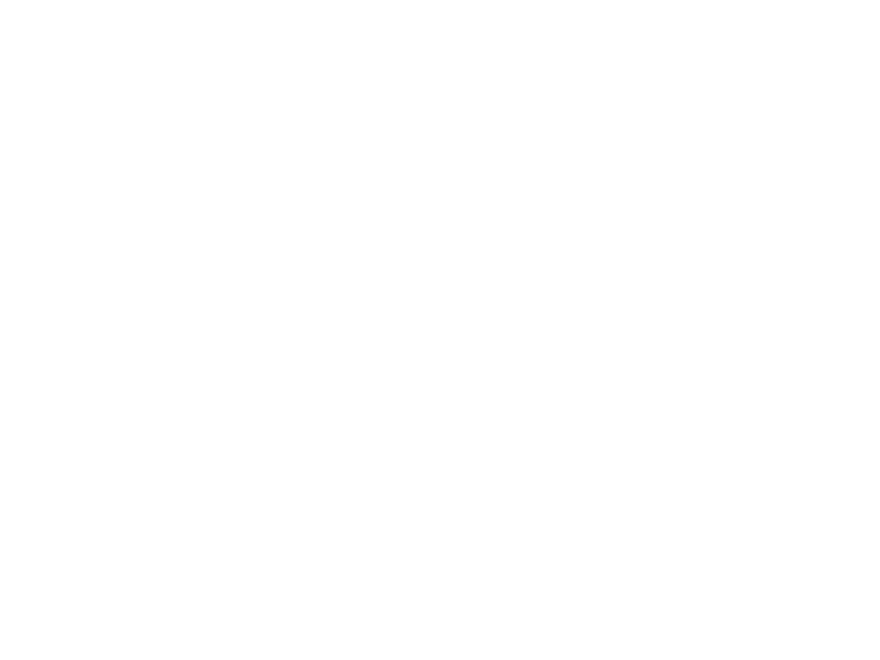

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0073.mp4

D:/HNSCC/HNSCC-01-0073\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


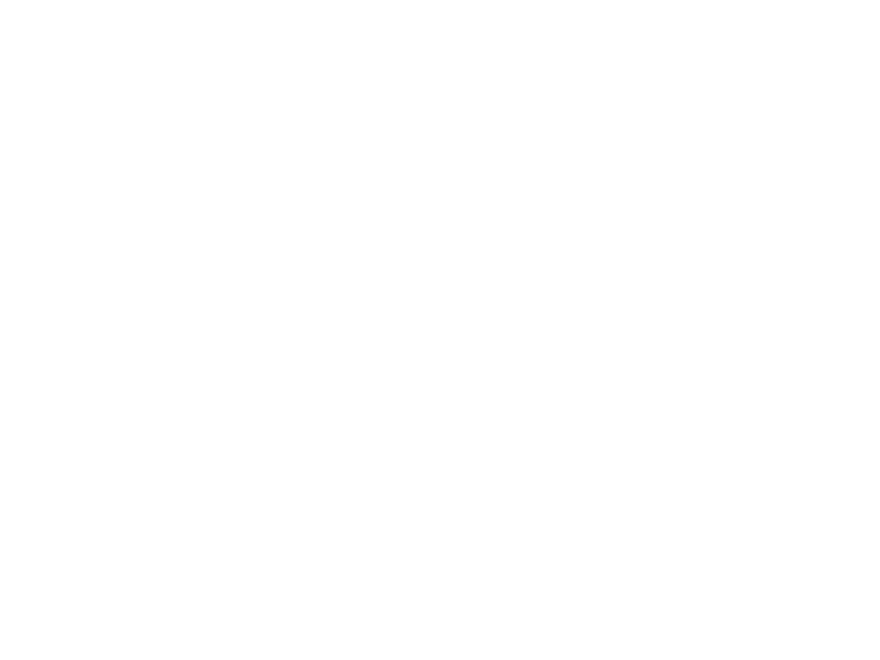

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0073.mp4

D:/HNSCC/HNSCC-01-0073\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0073\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0074\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


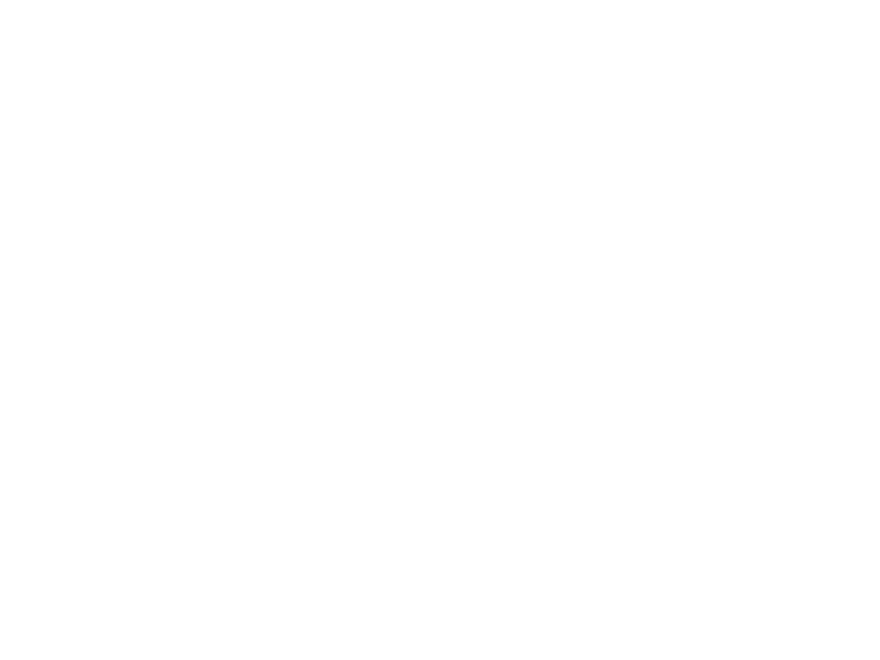

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0074.mp4

D:/HNSCC/HNSCC-01-0074\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


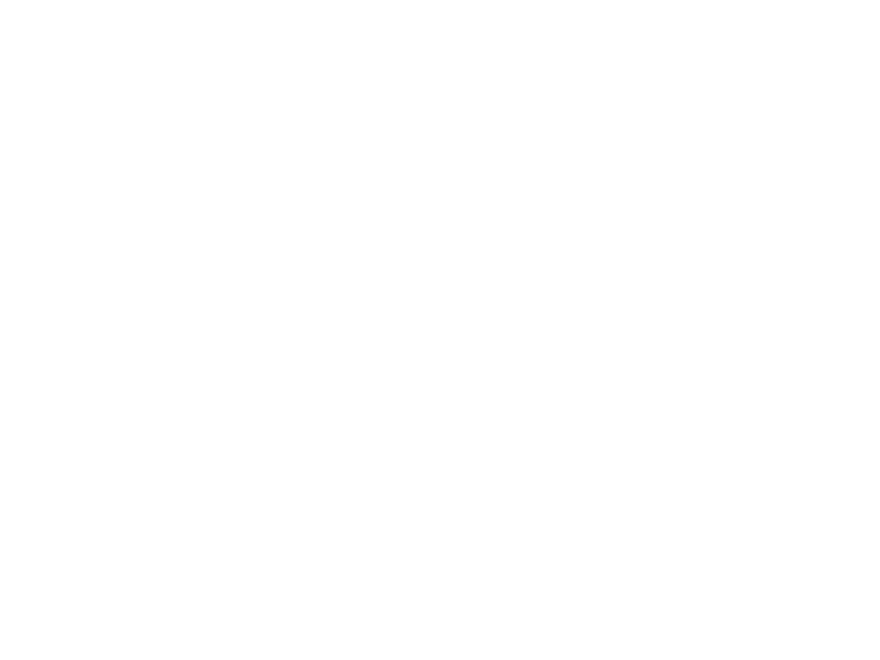

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0074.mp4

D:/HNSCC/HNSCC-01-0074\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


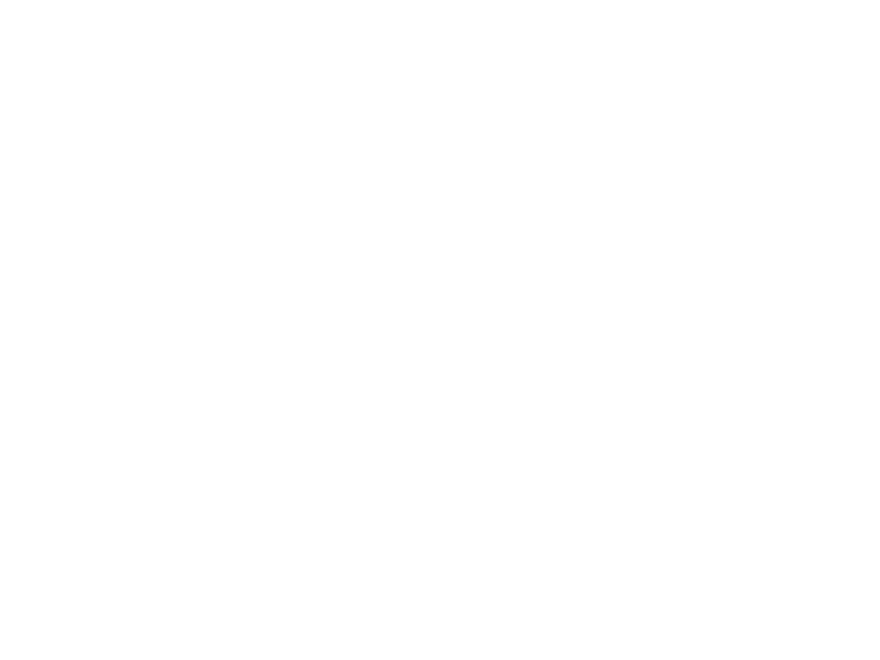

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0074.mp4

D:/HNSCC/HNSCC-01-0074\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0074\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0075\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


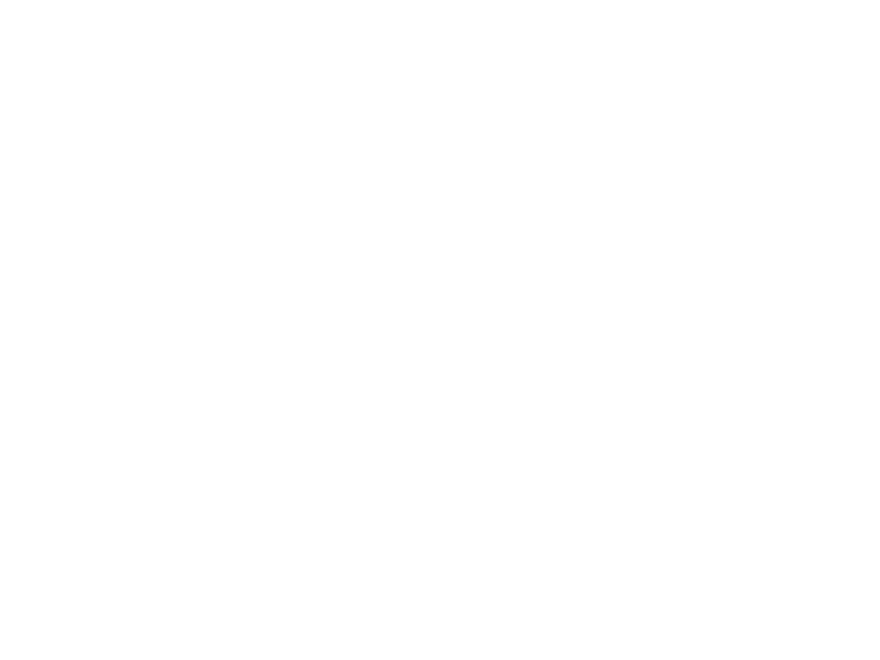

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0075.mp4

D:/HNSCC/HNSCC-01-0075\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


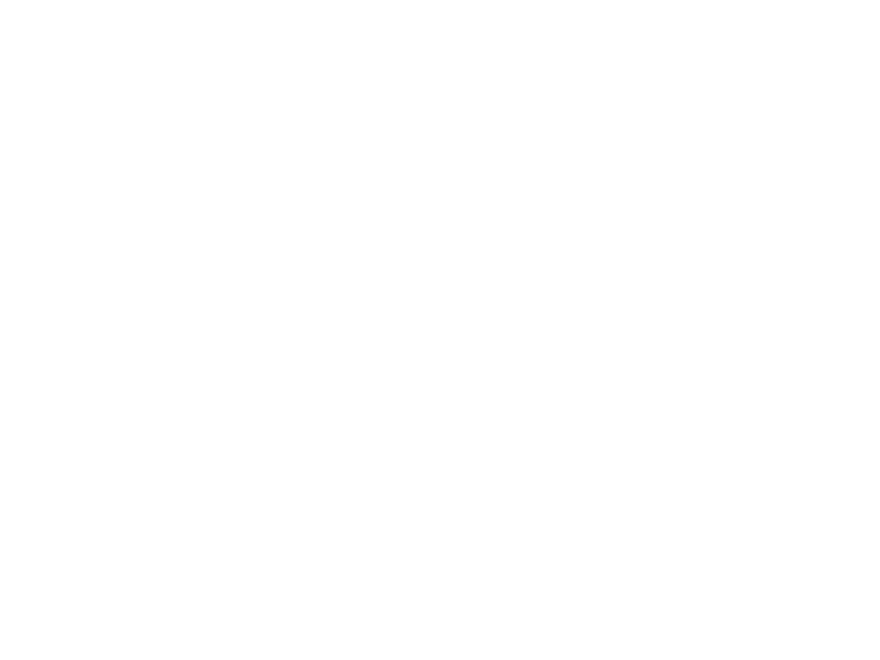

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0075.mp4

D:/HNSCC/HNSCC-01-0075\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


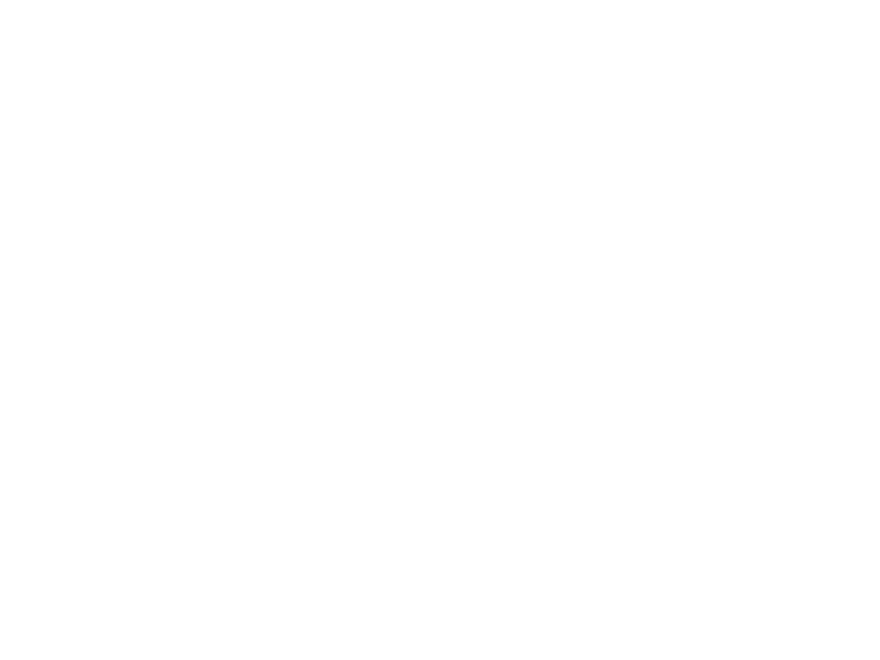

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0075.mp4

D:/HNSCC/HNSCC-01-0075\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0075\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0076\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


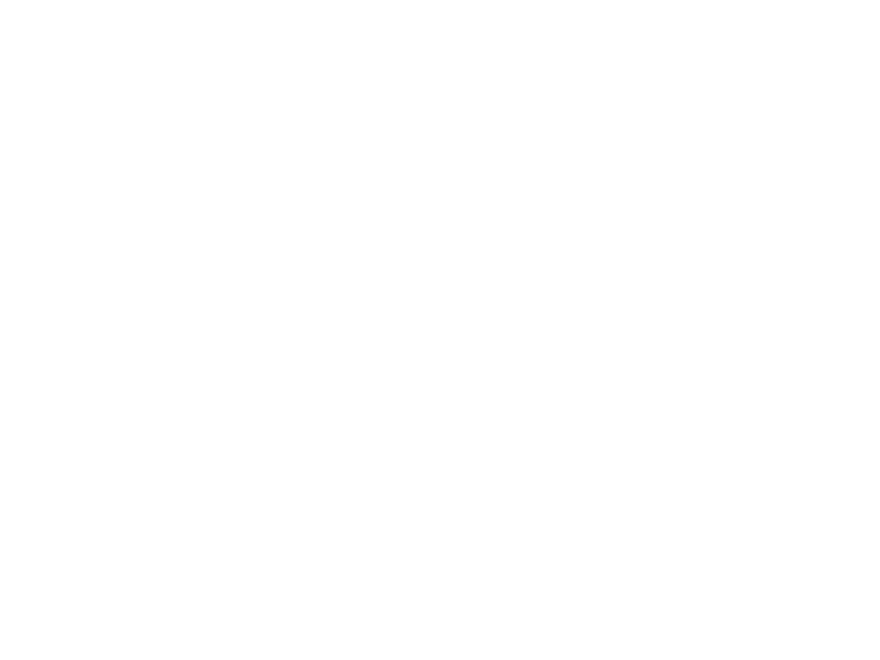

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0076.mp4

D:/HNSCC/HNSCC-01-0076\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


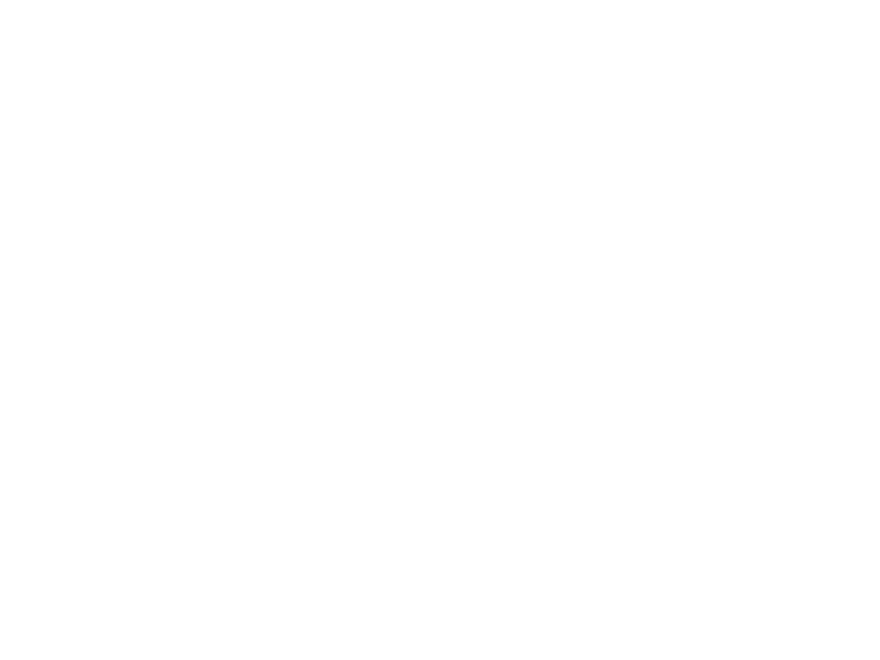

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0076.mp4

D:/HNSCC/HNSCC-01-0076\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


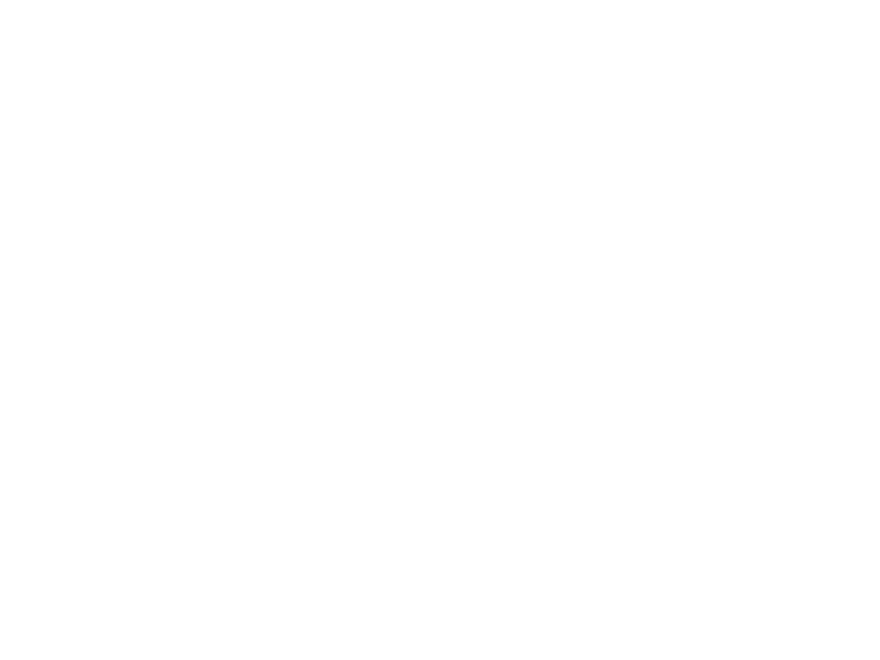

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0076.mp4

D:/HNSCC/HNSCC-01-0076\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0076\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0077\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


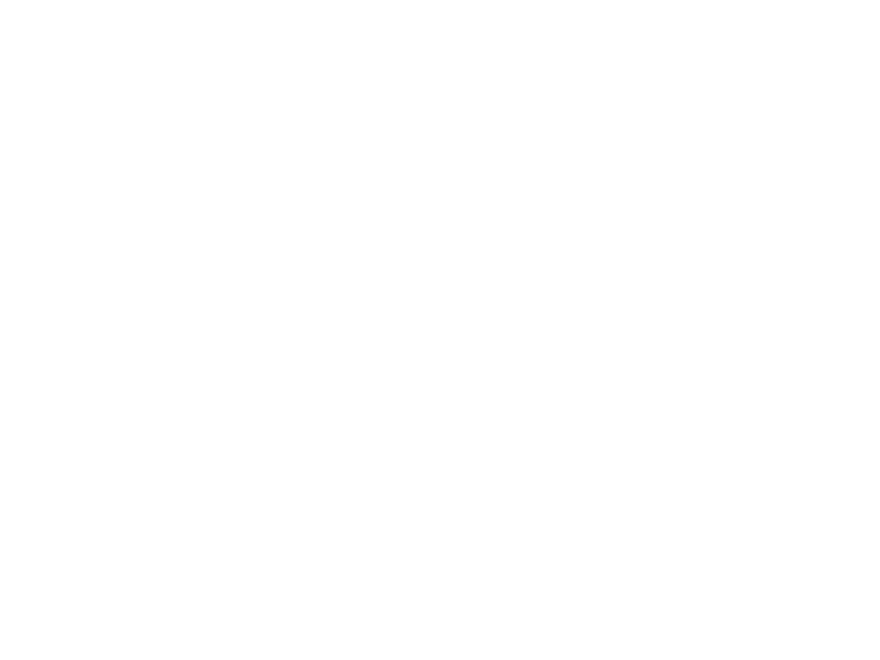

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0077.mp4

D:/HNSCC/HNSCC-01-0077\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


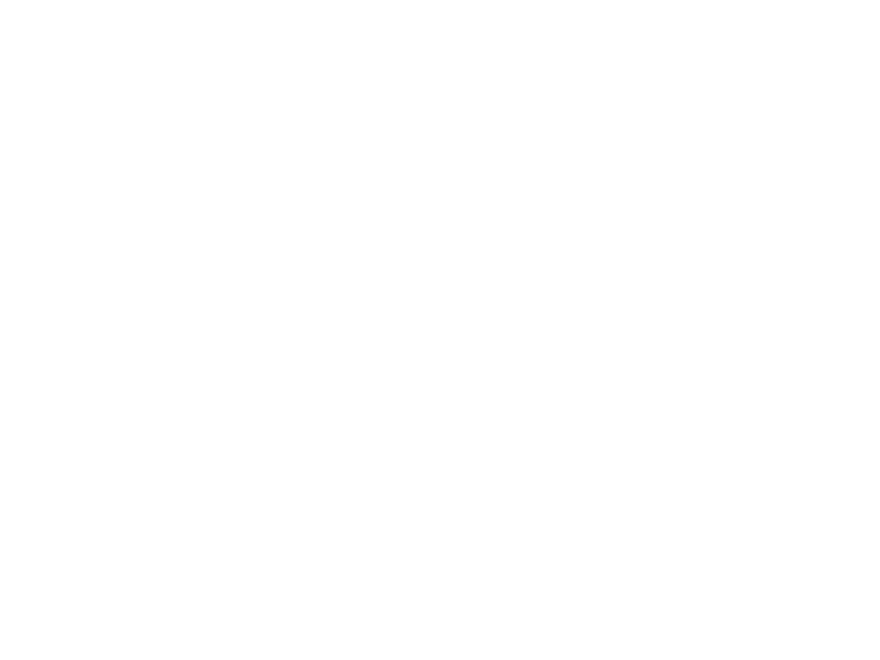

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0077.mp4

D:/HNSCC/HNSCC-01-0077\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


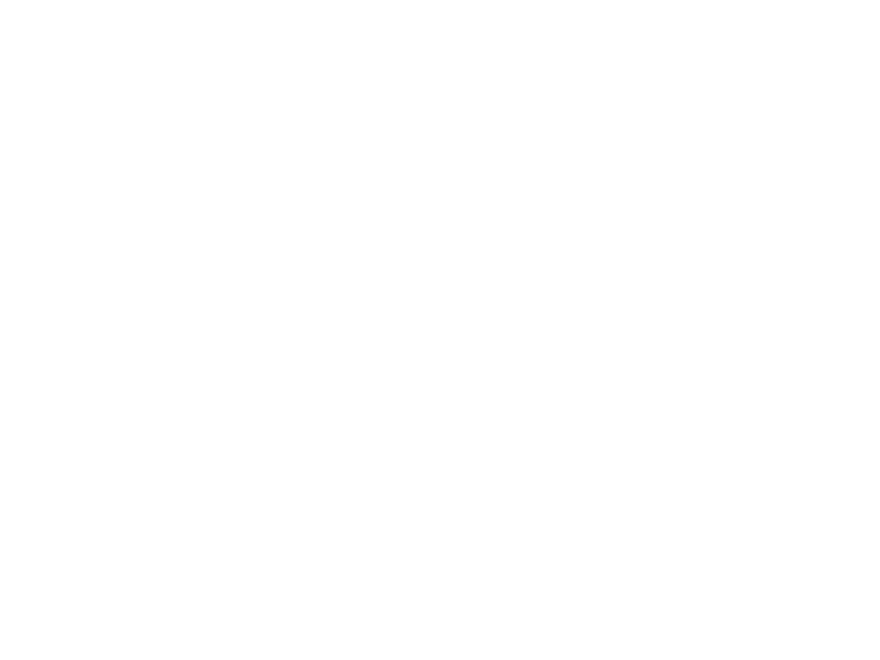

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0077.mp4

D:/HNSCC/HNSCC-01-0077\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0077\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0078\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


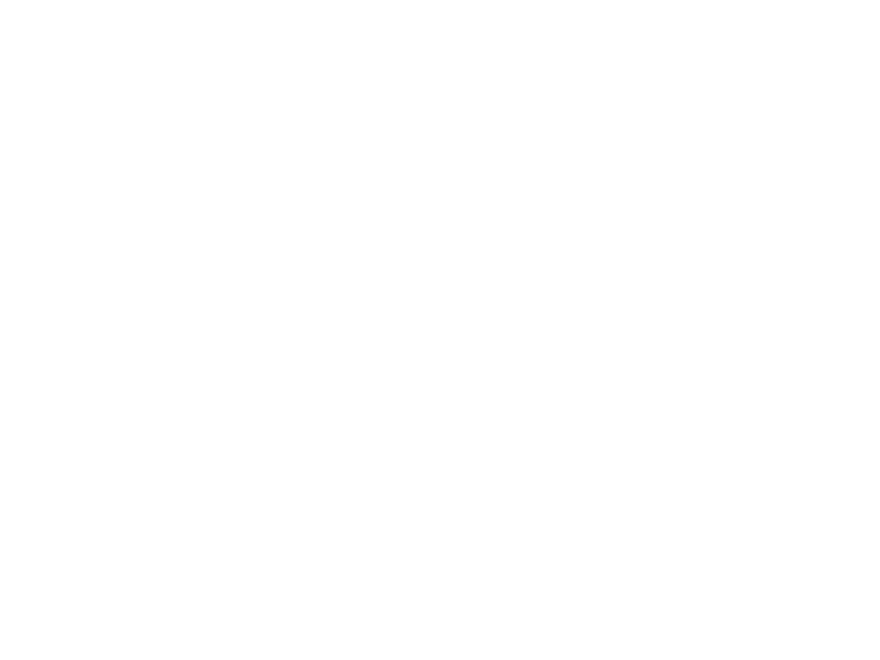

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0078.mp4

D:/HNSCC/HNSCC-01-0078\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


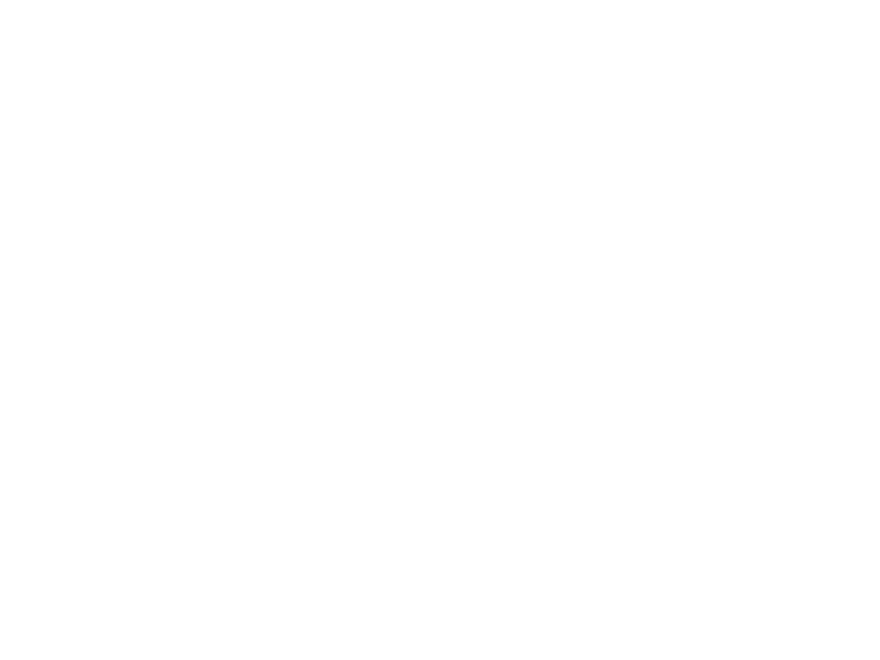

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0078.mp4

D:/HNSCC/HNSCC-01-0078\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


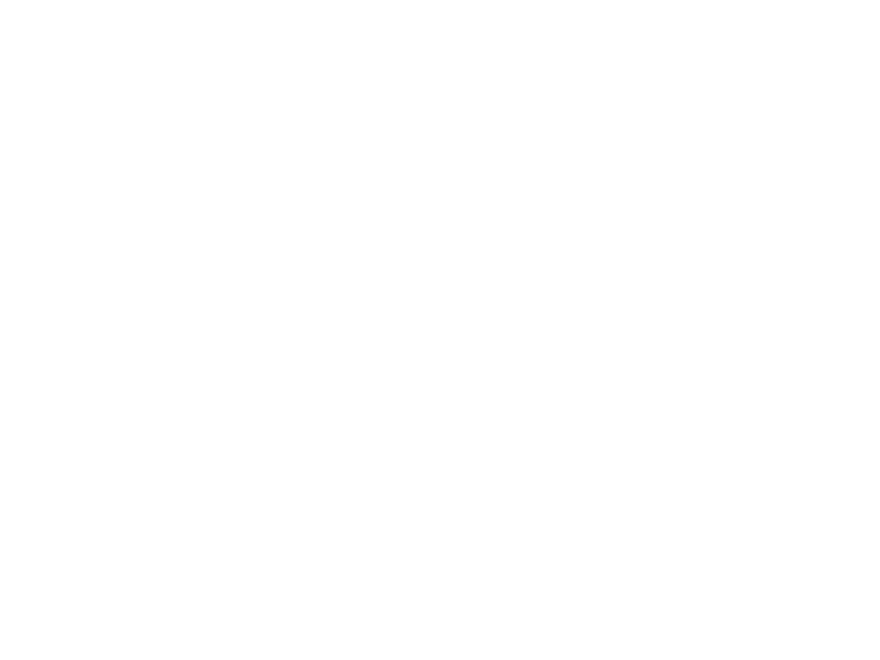

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0078.mp4

D:/HNSCC/HNSCC-01-0078\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0078\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0079\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0079\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0079\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0079\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Numbe

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


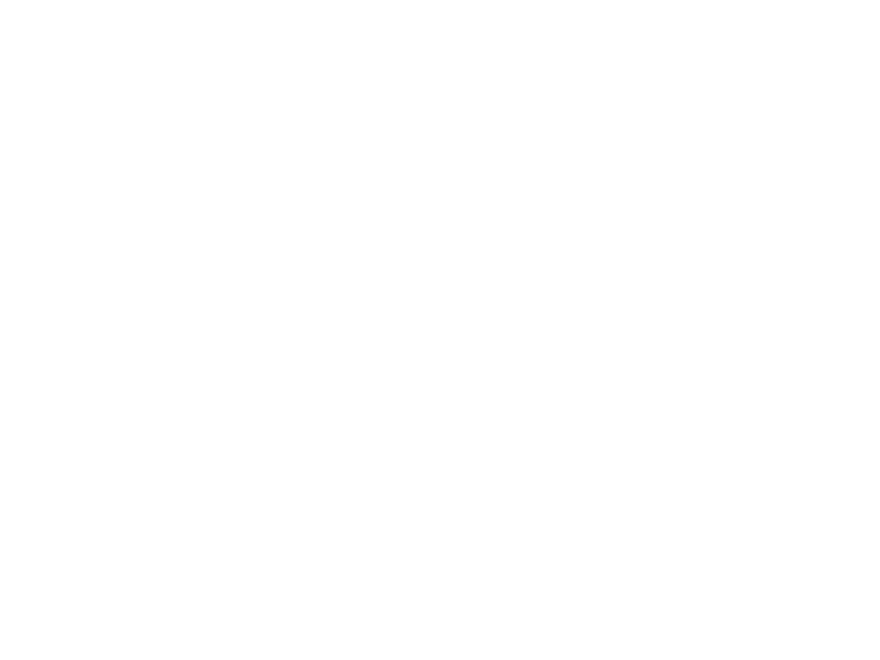

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0081.mp4

D:/HNSCC/HNSCC-01-0081\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0081\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


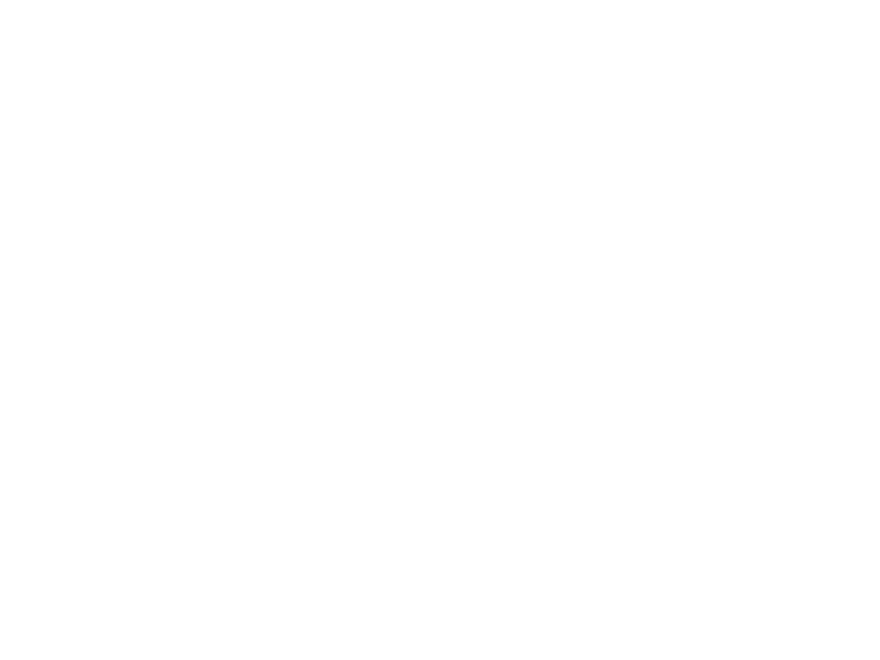

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0081.mp4

D:/HNSCC/HNSCC-01-0081\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0081\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0082\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


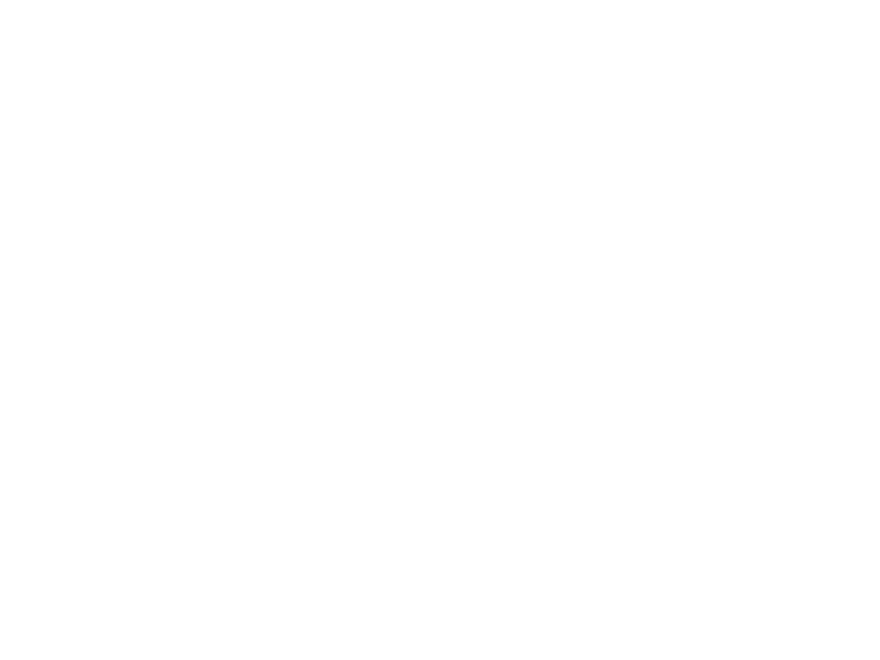

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0082.mp4

D:/HNSCC/HNSCC-01-0082\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


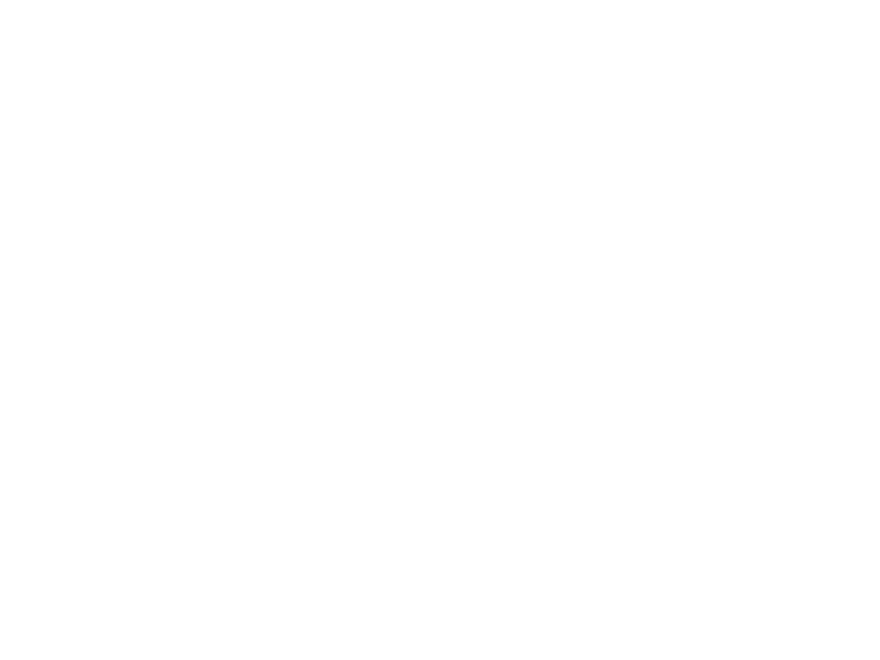

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0082.mp4

D:/HNSCC/HNSCC-01-0082\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


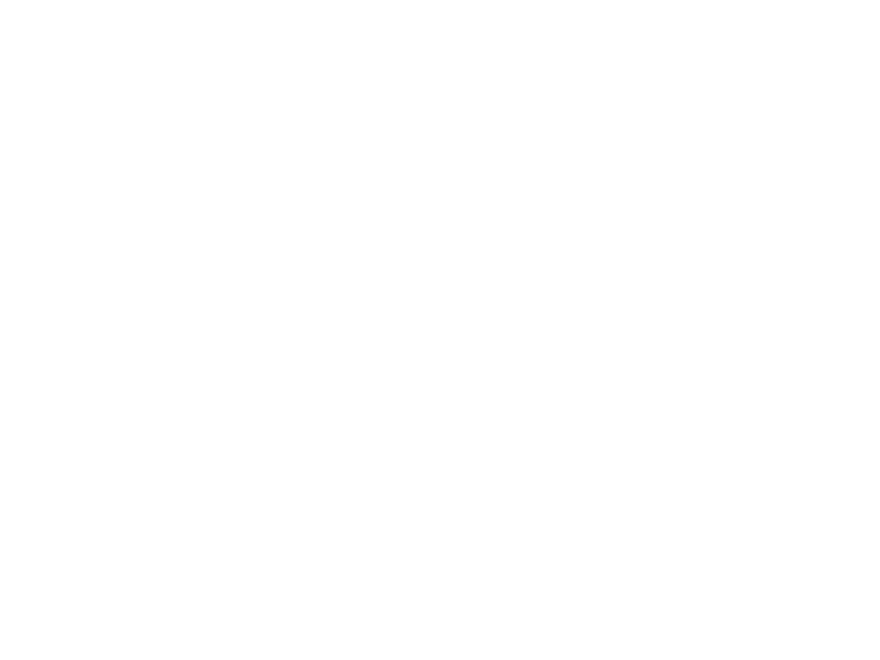

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0082.mp4

D:/HNSCC/HNSCC-01-0082\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0082\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0083\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


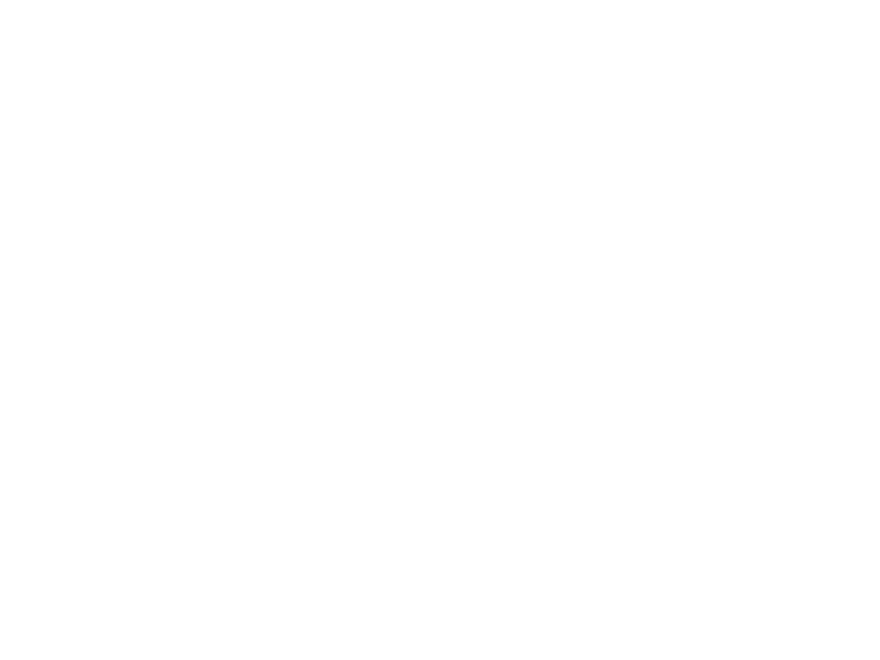

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0083.mp4

D:/HNSCC/HNSCC-01-0083\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


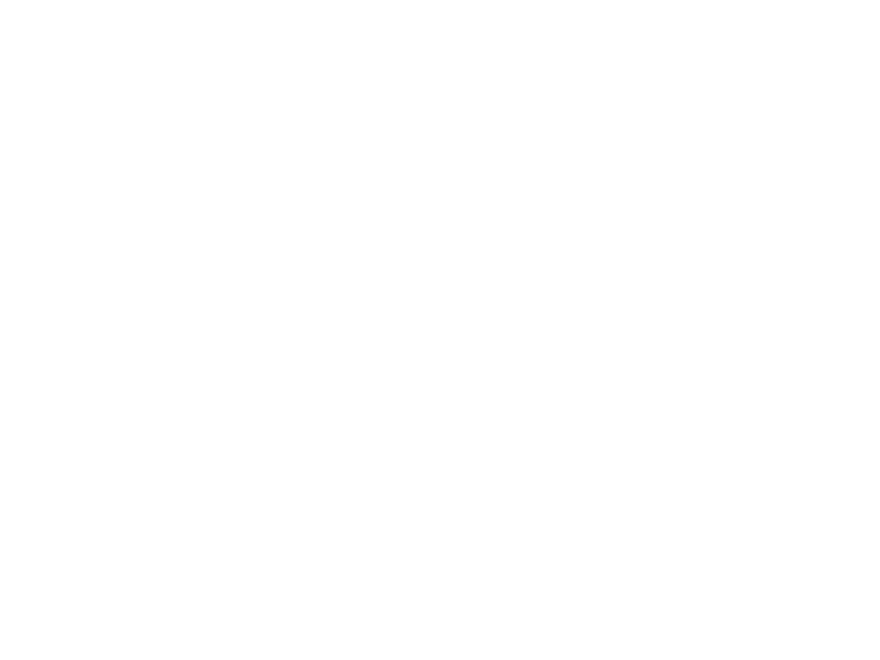

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0083.mp4

D:/HNSCC/HNSCC-01-0083\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


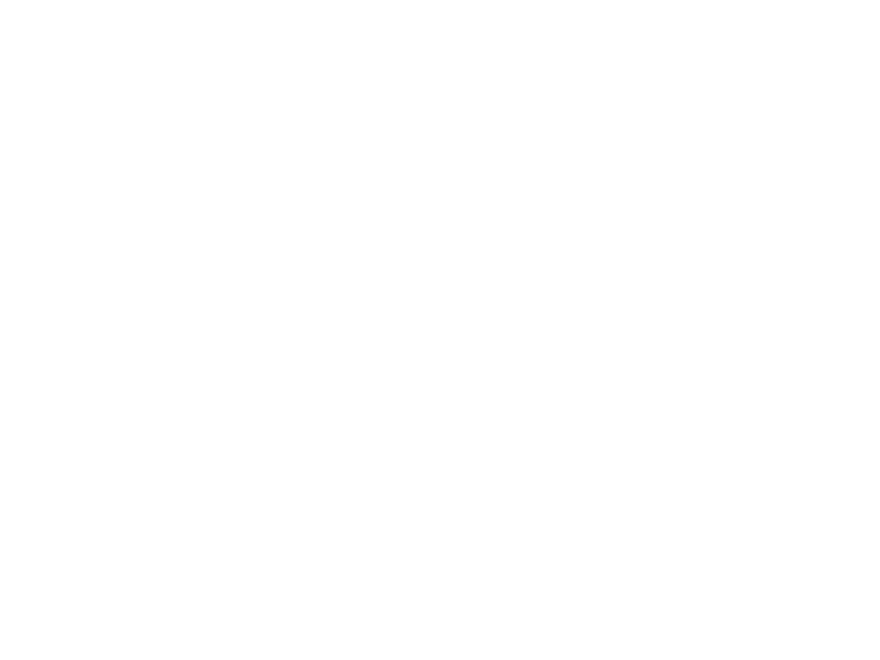

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0083.mp4

D:/HNSCC/HNSCC-01-0083\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0083\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0084\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


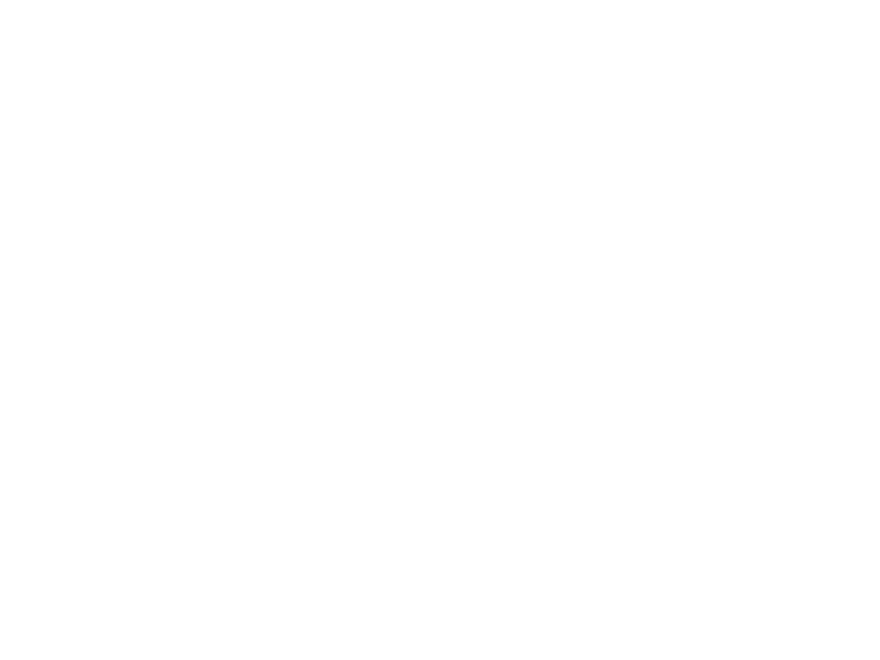

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0084.mp4

D:/HNSCC/HNSCC-01-0084\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


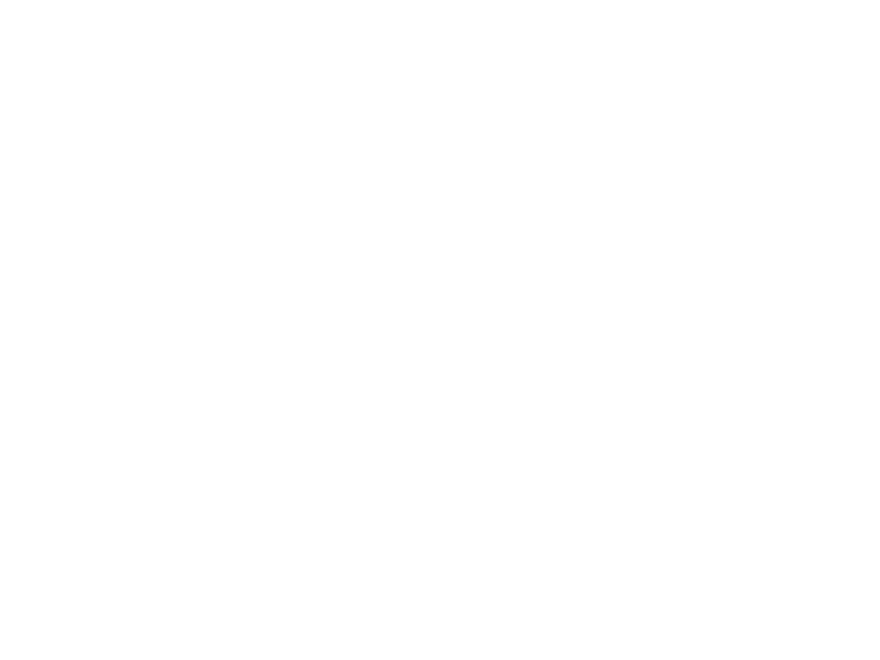

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0084.mp4

D:/HNSCC/HNSCC-01-0084\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


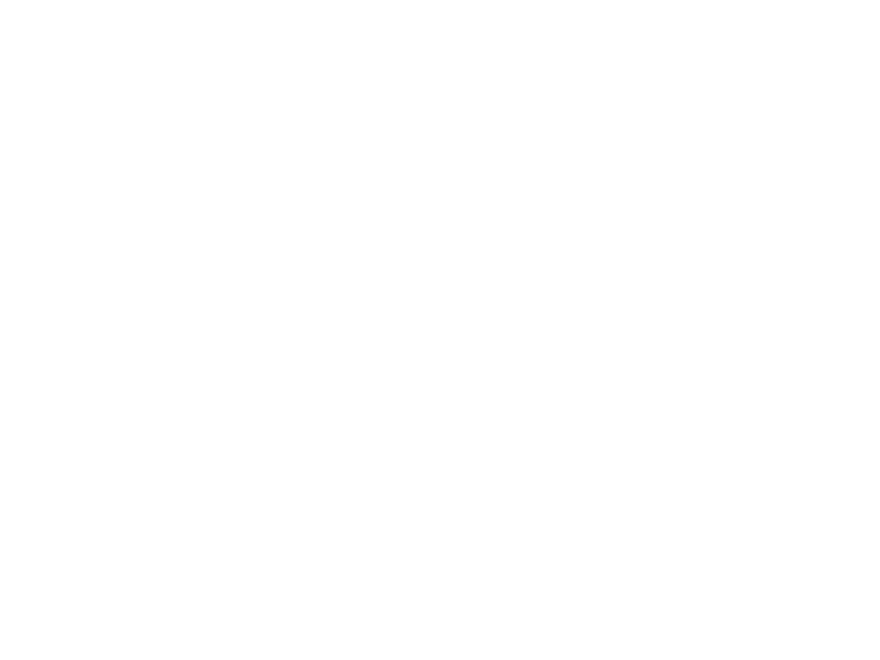

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0084.mp4

D:/HNSCC/HNSCC-01-0084\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


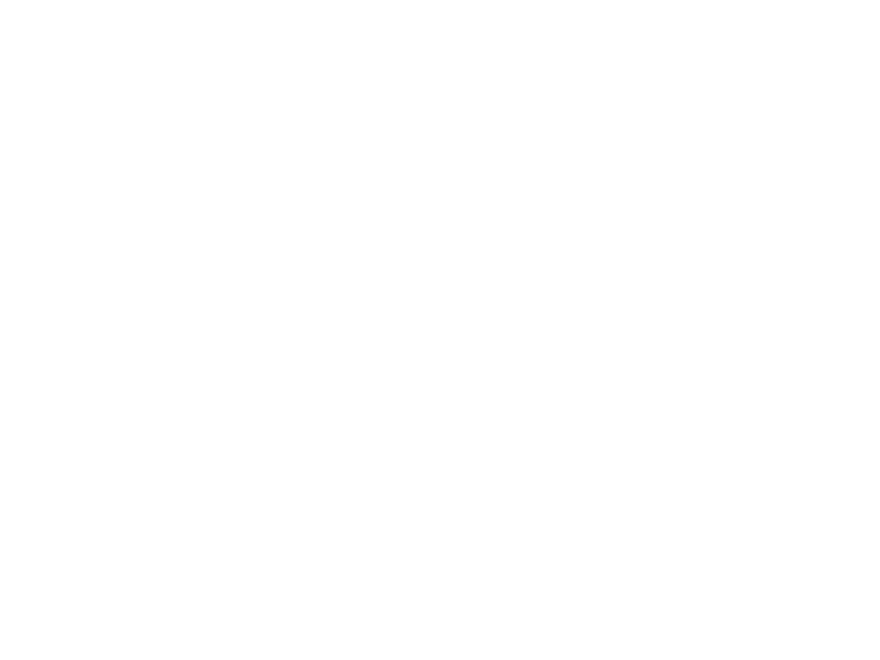

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0084.mp4

D:/HNSCC/HNSCC-01-0084\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


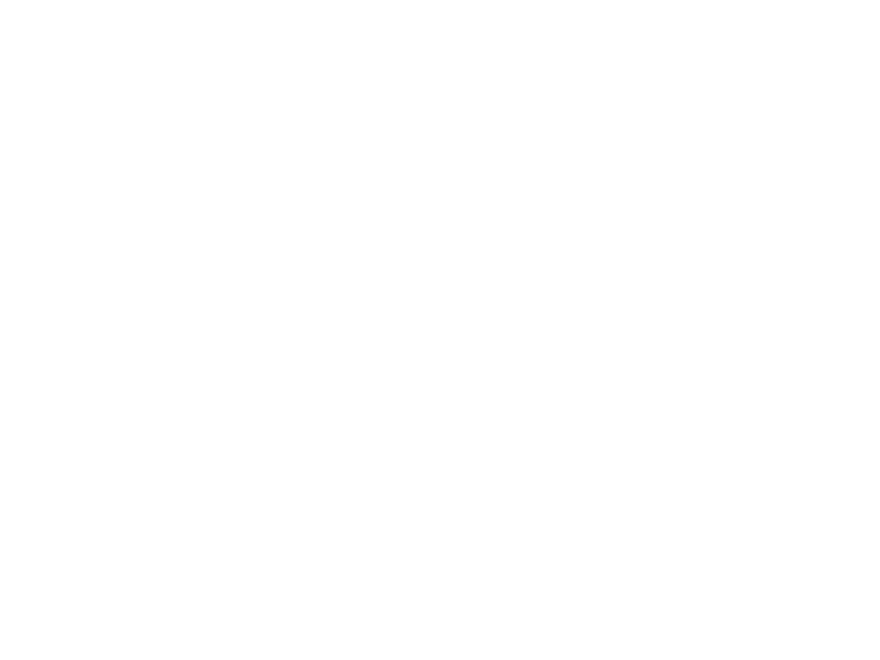

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0084.mp4

D:/HNSCC/HNSCC-01-0085\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


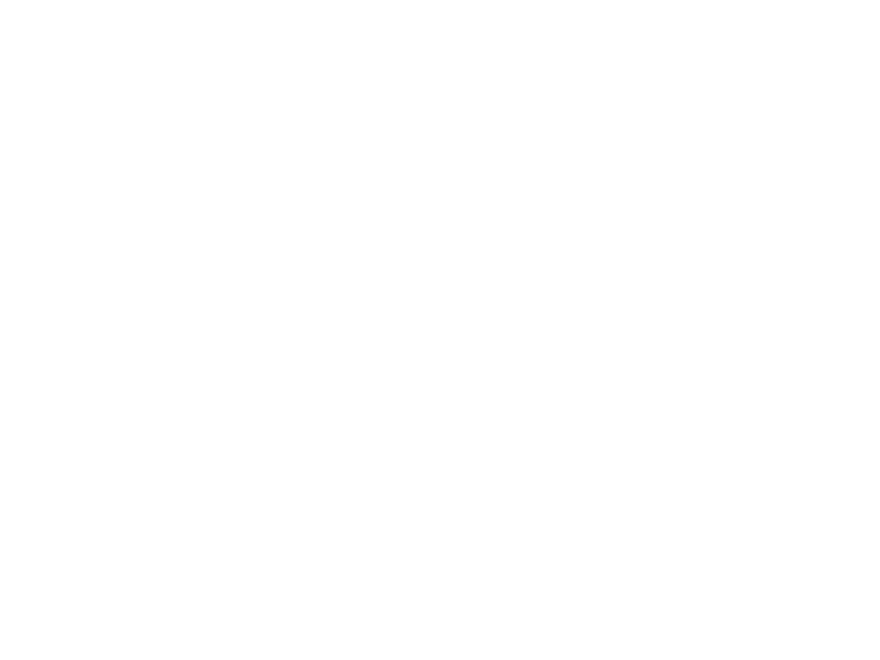

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0085.mp4

D:/HNSCC/HNSCC-01-0085\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


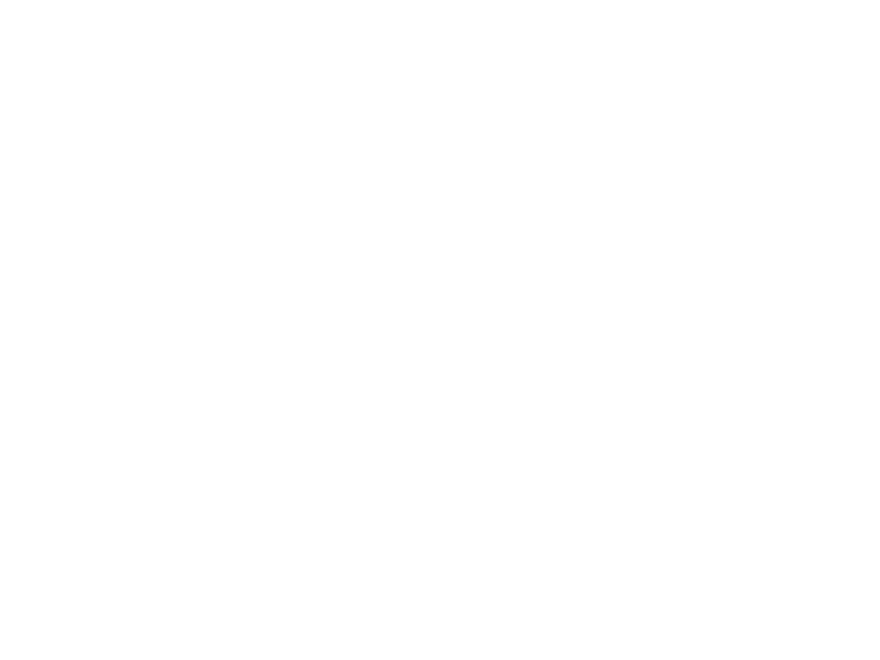

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0085.mp4

D:/HNSCC/HNSCC-01-0085\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


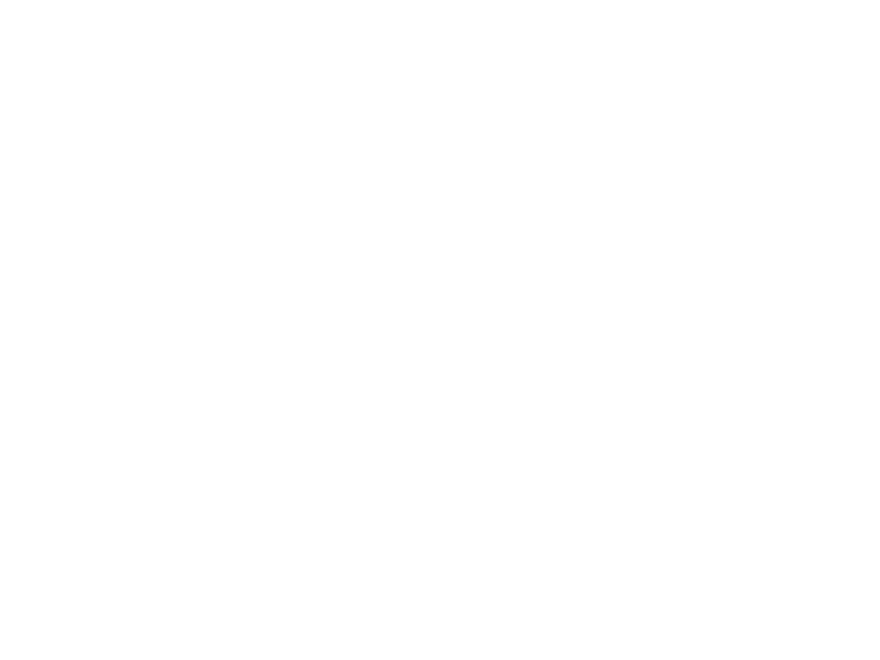

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0085.mp4

D:/HNSCC/HNSCC-01-0085\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0085\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0086\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


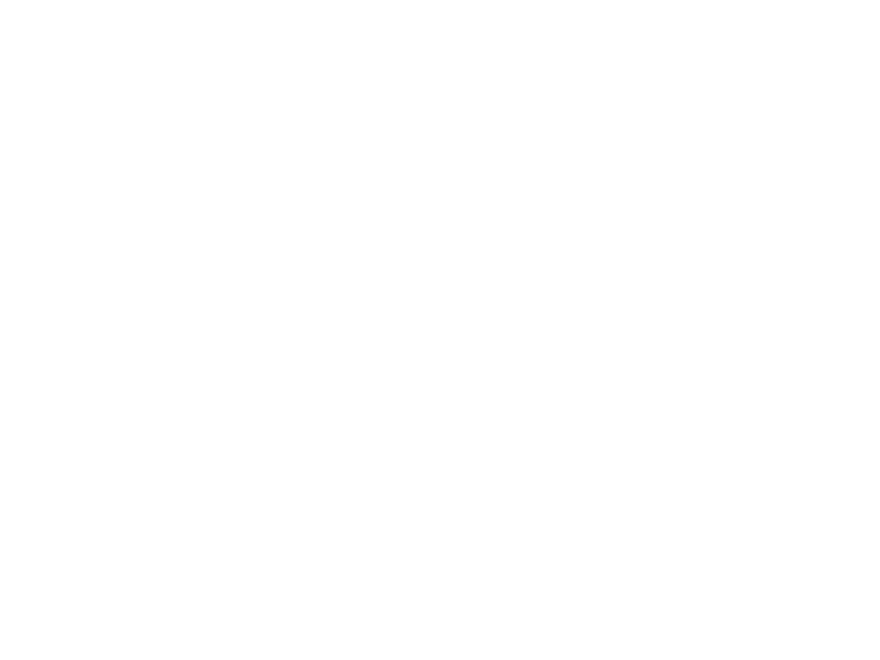

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0086.mp4

D:/HNSCC/HNSCC-01-0086\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


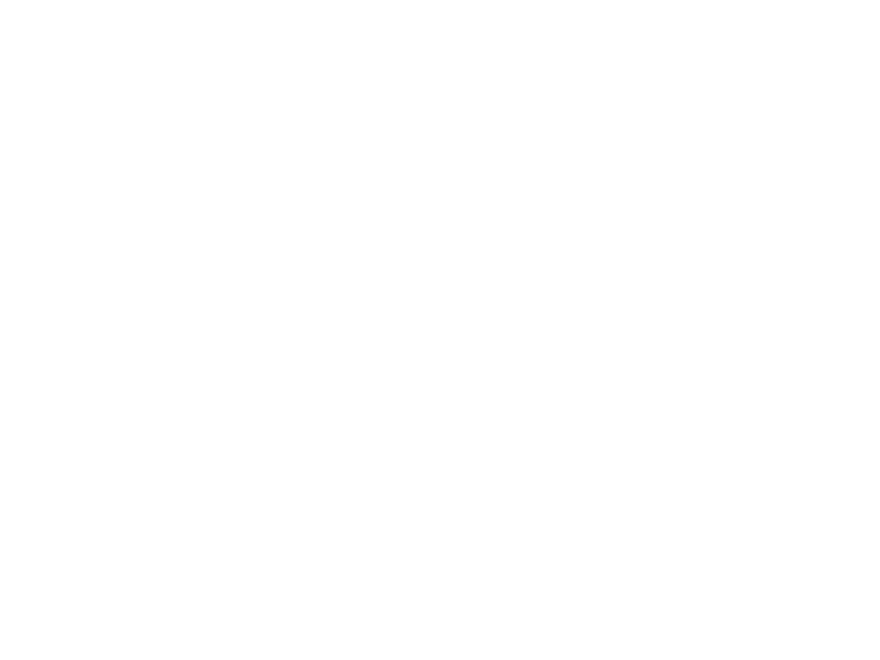

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0086.mp4

D:/HNSCC/HNSCC-01-0086\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
45
45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


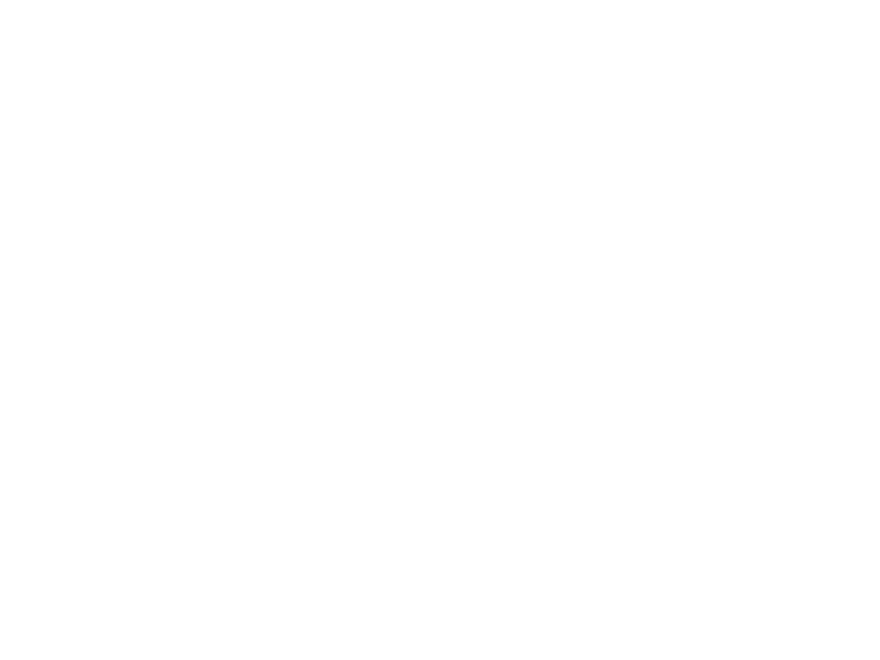

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0086.mp4

D:/HNSCC/HNSCC-01-0086\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0086\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices:45
Required:45
1

D:/HNSCC/HNSCC-01-0087\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


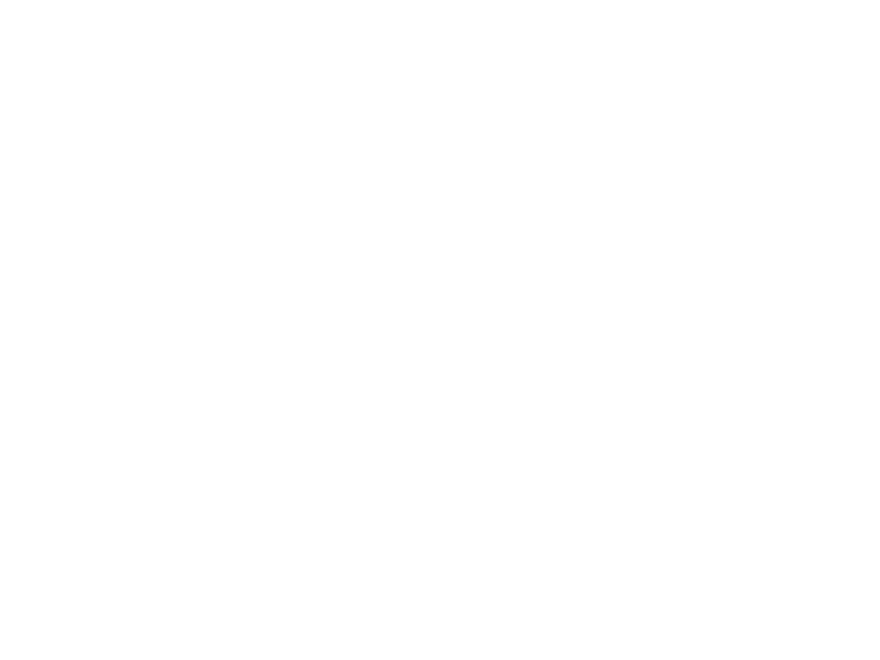

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0087.mp4

D:/HNSCC/HNSCC-01-0087\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


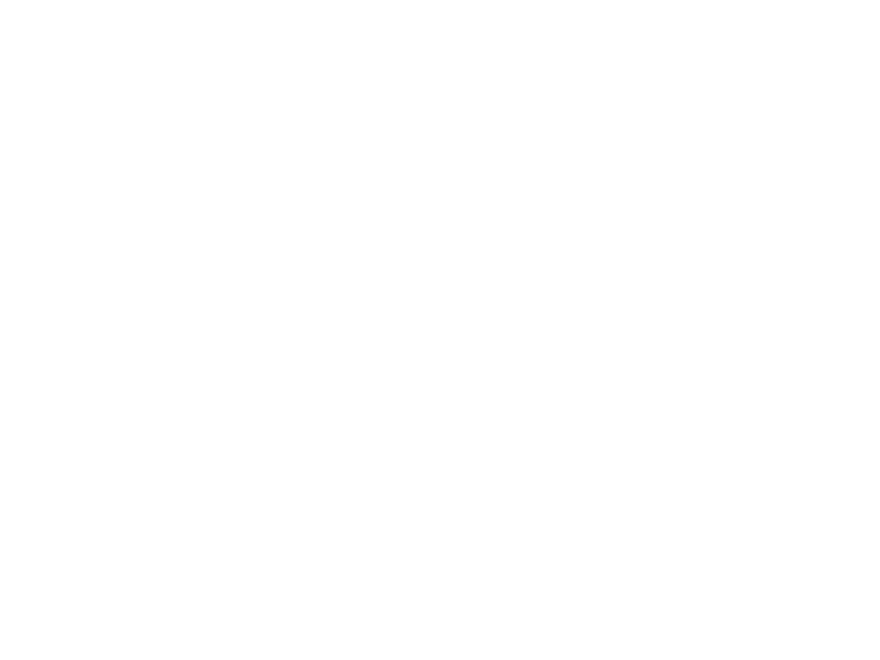

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0087.mp4

D:/HNSCC/HNSCC-01-0087\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


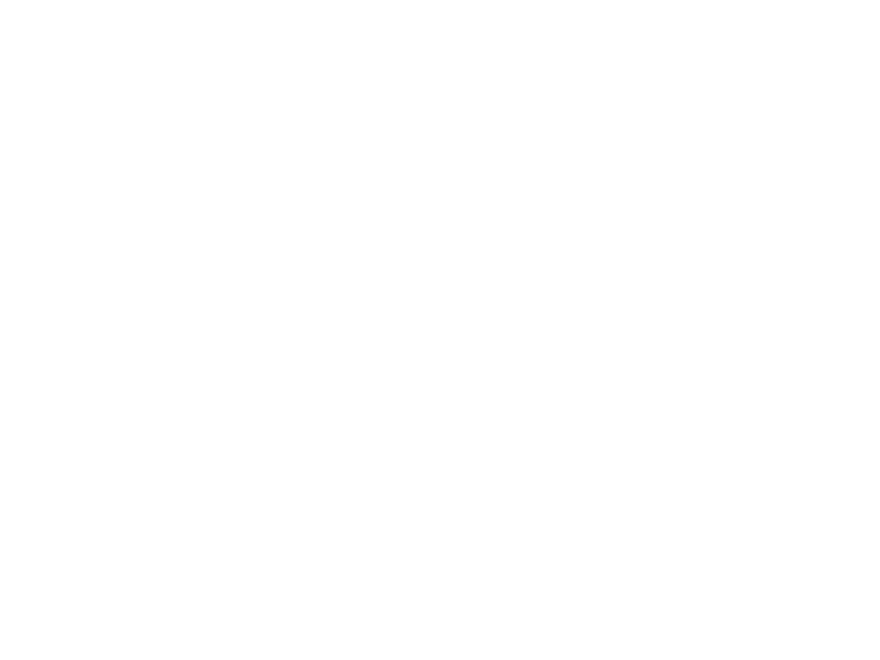

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0087.mp4

D:/HNSCC/HNSCC-01-0087\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0087\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0088\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


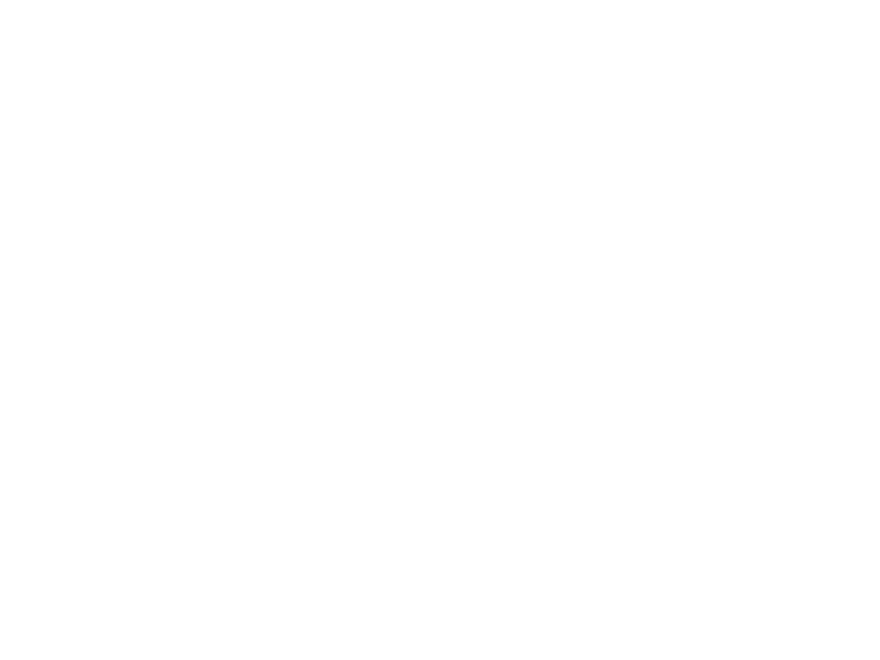

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0088.mp4

D:/HNSCC/HNSCC-01-0088\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


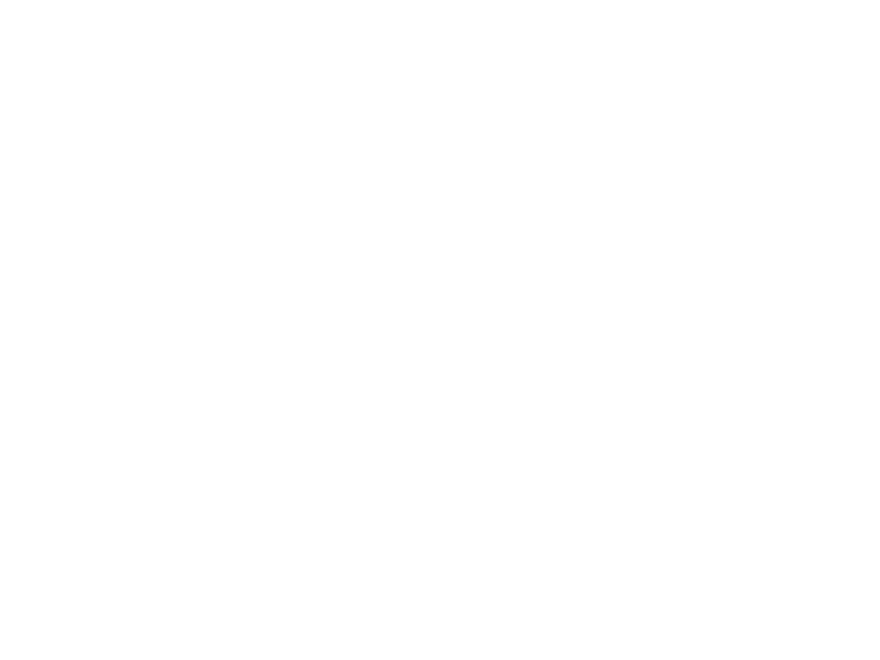

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0088.mp4

D:/HNSCC/HNSCC-01-0088\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


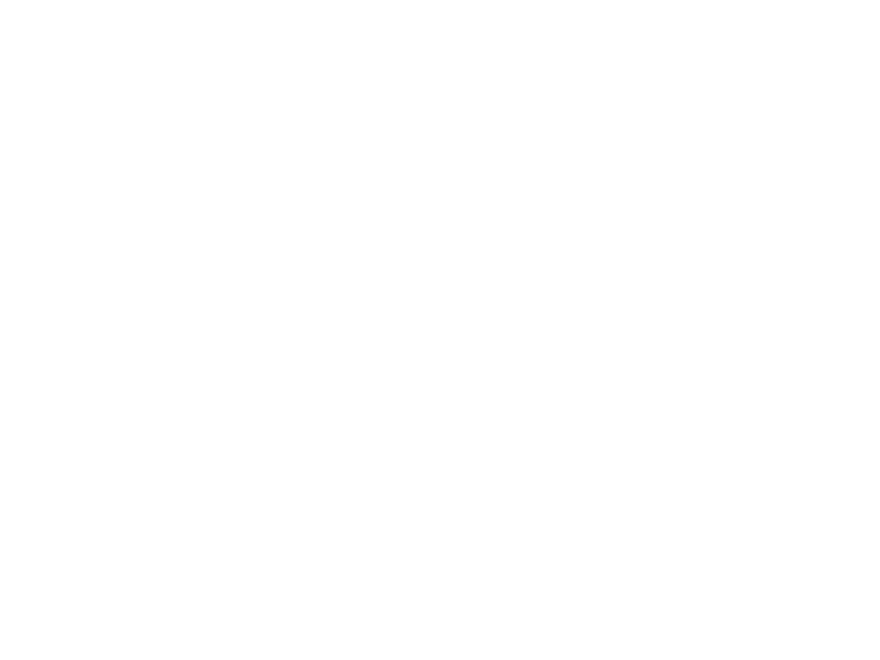

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0088.mp4

D:/HNSCC/HNSCC-01-0088\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0088\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0089\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


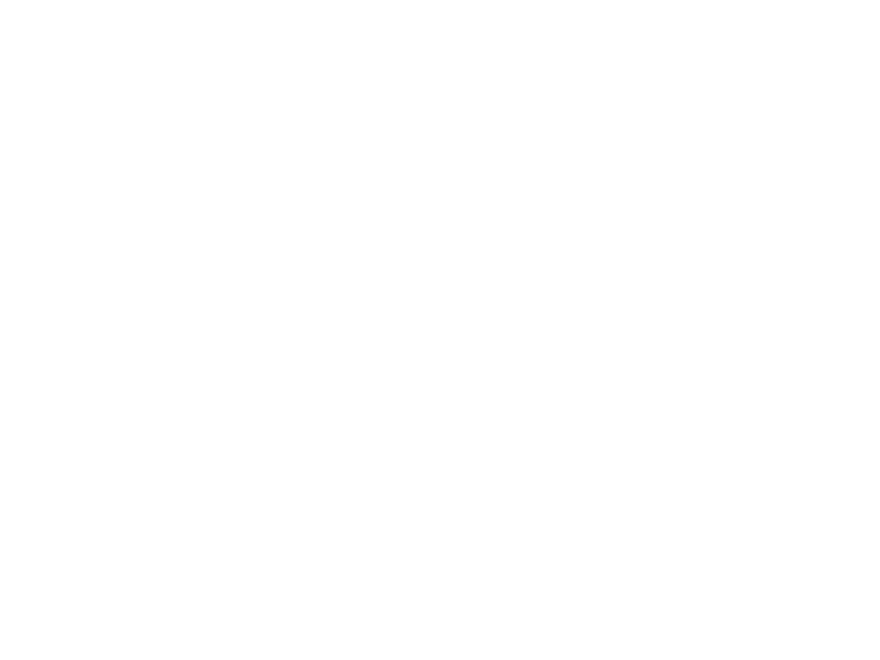

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0089.mp4

D:/HNSCC/HNSCC-01-0089\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


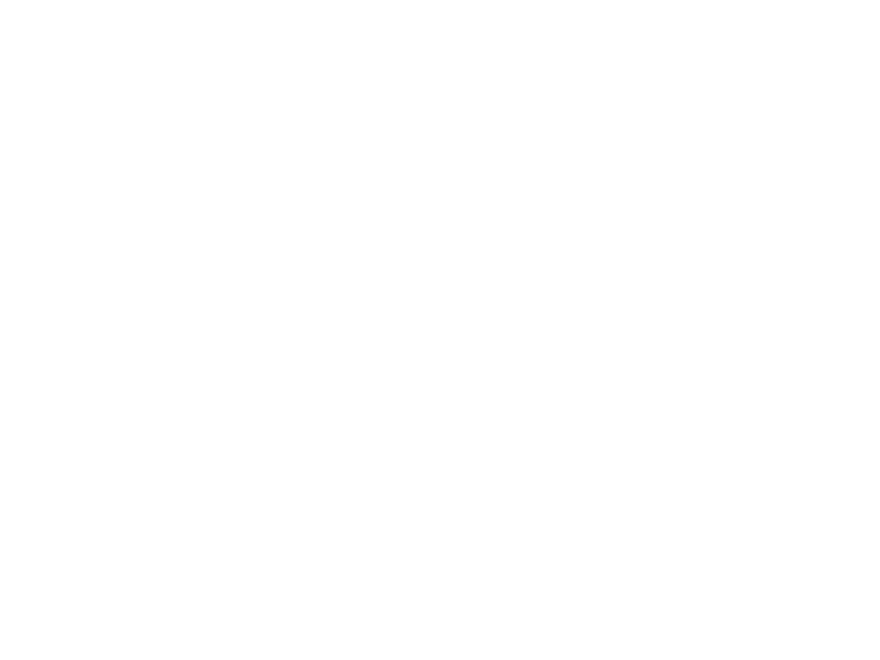

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0089.mp4

D:/HNSCC/HNSCC-01-0089\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


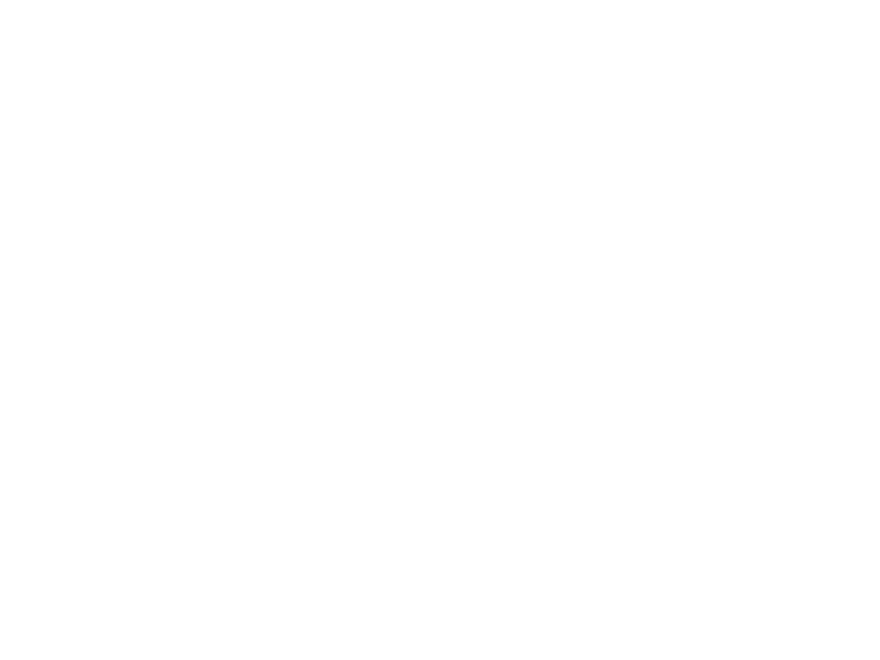

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0089.mp4

D:/HNSCC/HNSCC-01-0089\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


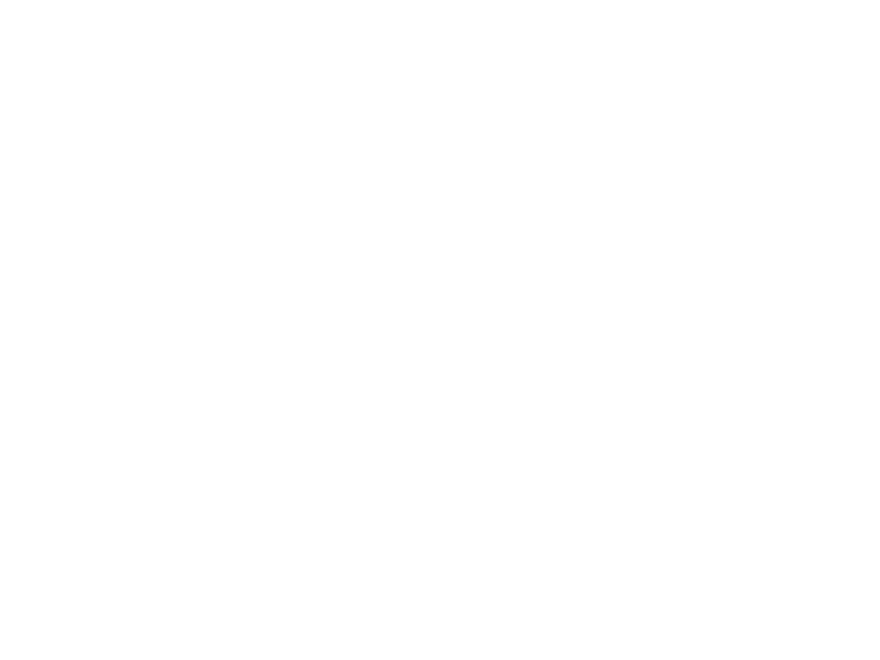

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0089.mp4

D:/HNSCC/HNSCC-01-0089\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


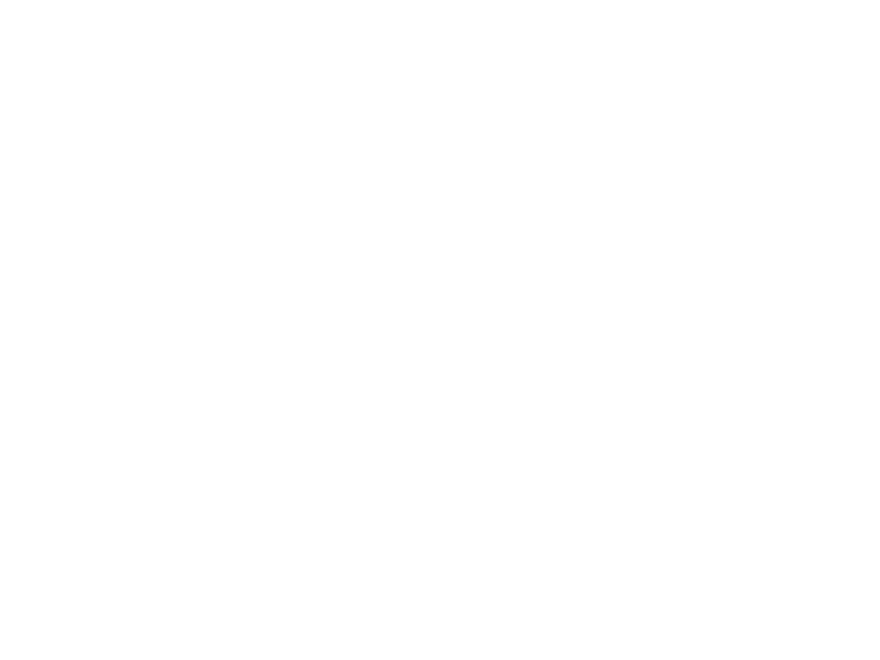

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0089.mp4

D:/HNSCC/HNSCC-01-0090\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


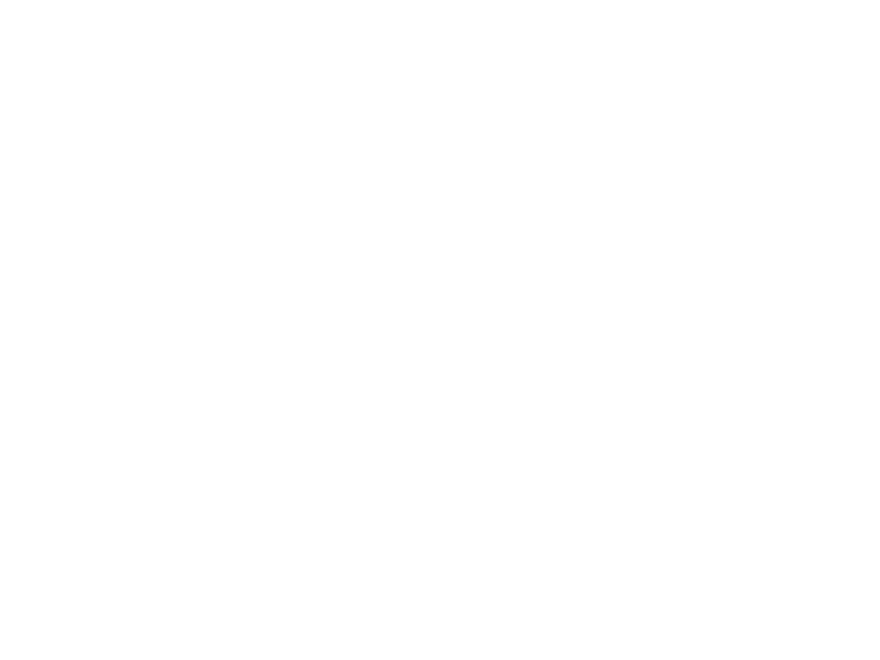

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0090.mp4

D:/HNSCC/HNSCC-01-0090\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


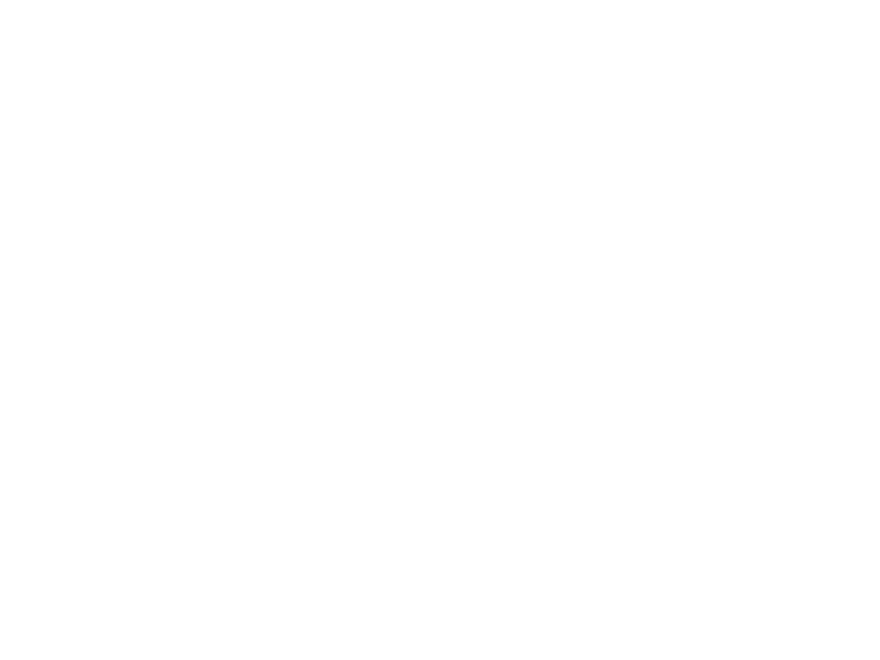

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0090.mp4

D:/HNSCC/HNSCC-01-0090\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


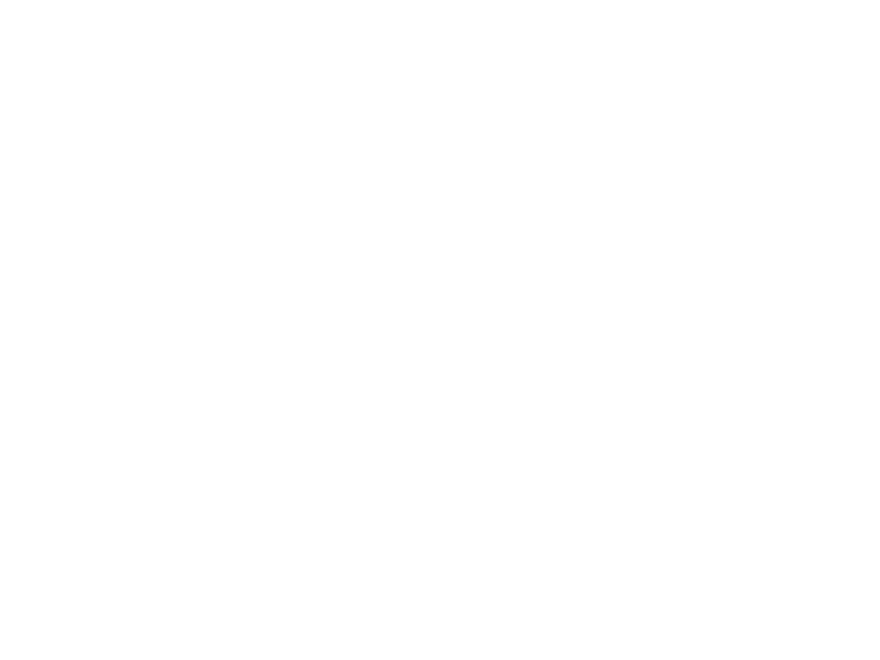

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0090.mp4

D:/HNSCC/HNSCC-01-0090\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0090\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0091\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


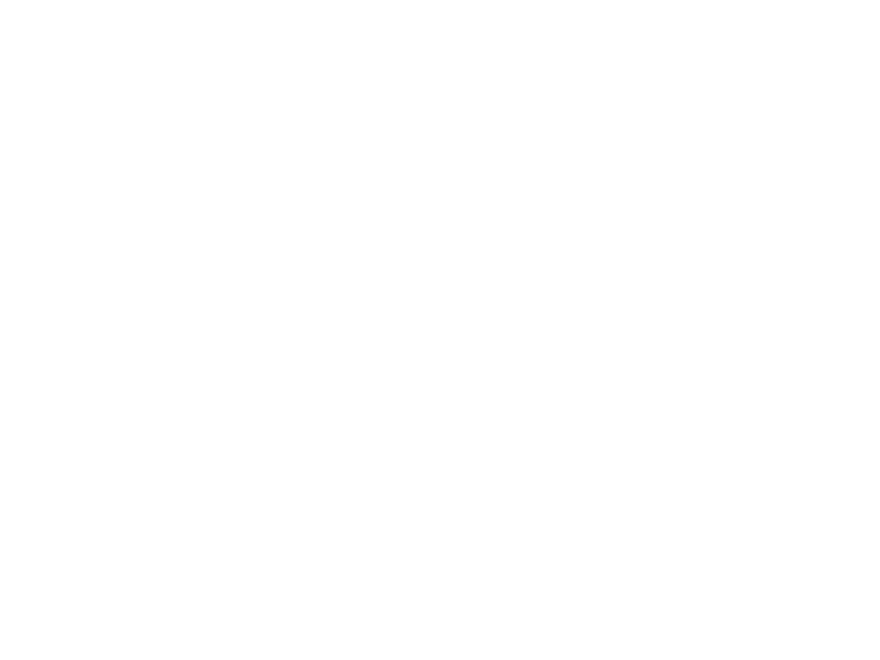

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0091.mp4

D:/HNSCC/HNSCC-01-0091\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


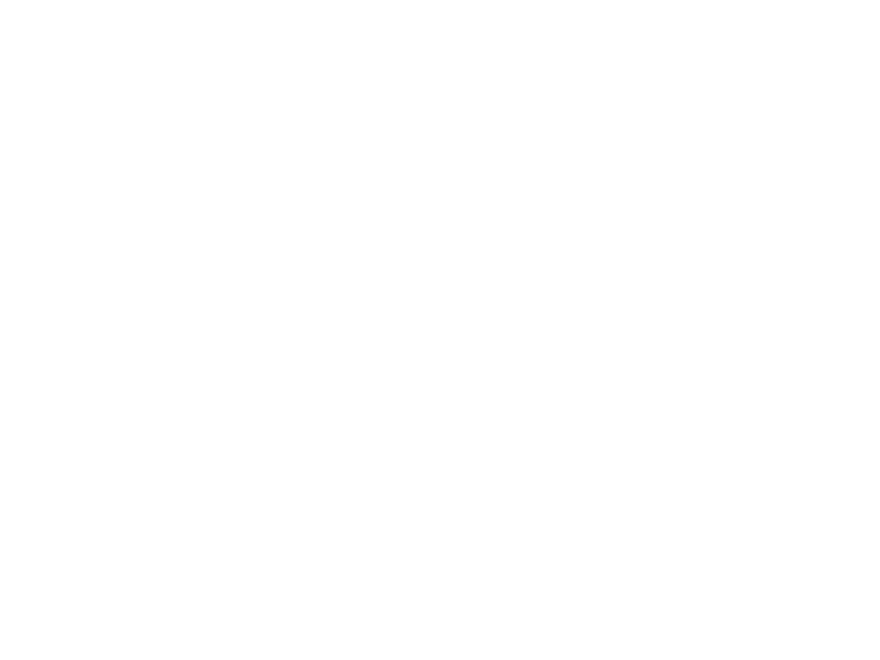

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0091.mp4

D:/HNSCC/HNSCC-01-0091\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


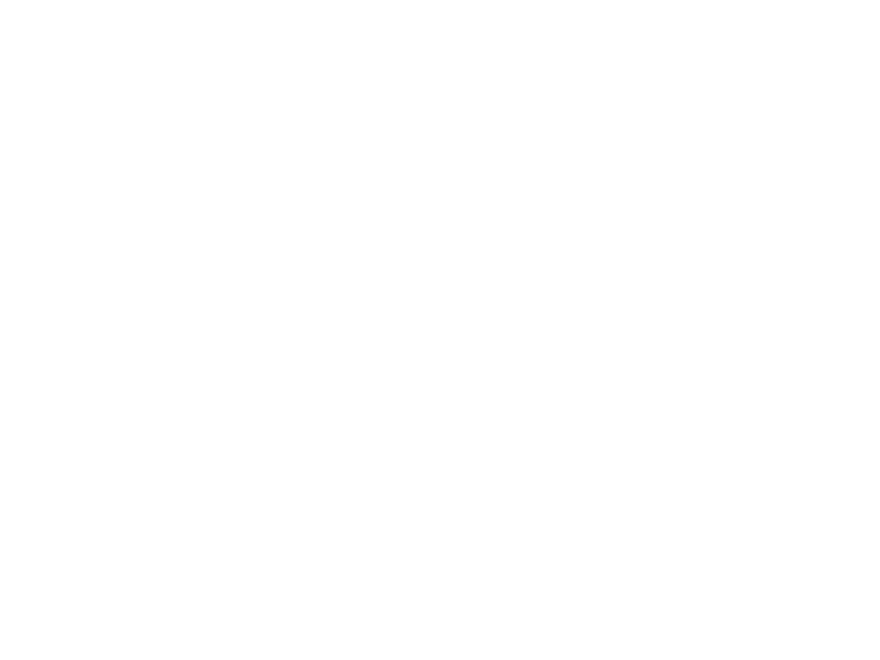

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0091.mp4

D:/HNSCC/HNSCC-01-0091\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0091\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0092\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


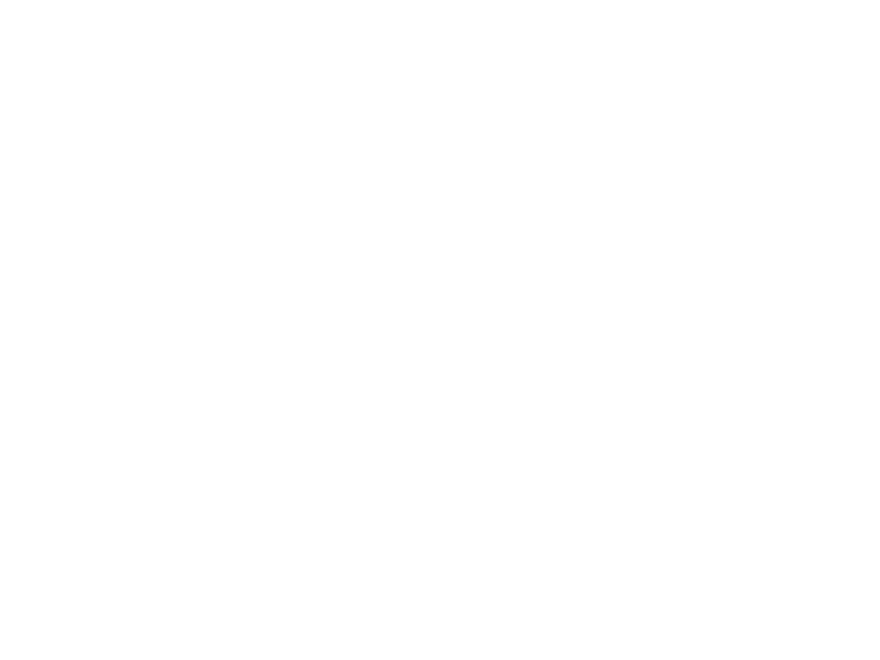

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0092.mp4

D:/HNSCC/HNSCC-01-0092\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


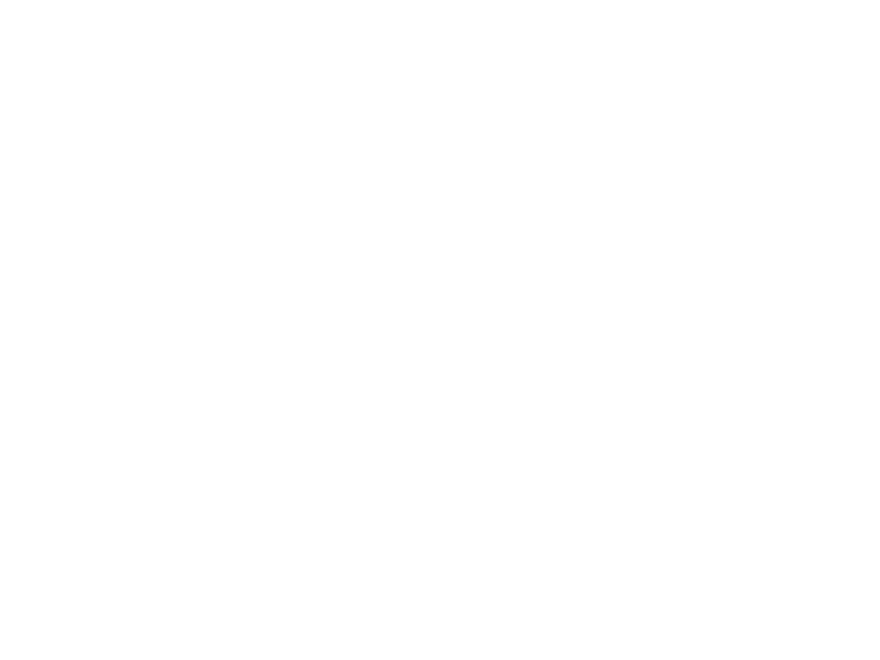

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0092.mp4

D:/HNSCC/HNSCC-01-0092\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


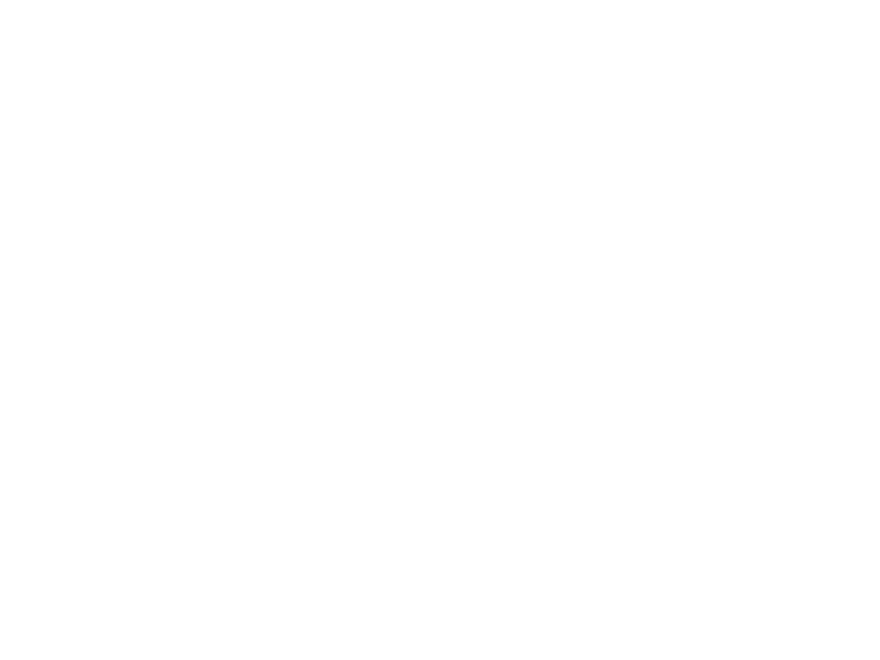

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0092.mp4

D:/HNSCC/HNSCC-01-0092\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0092\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0093\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


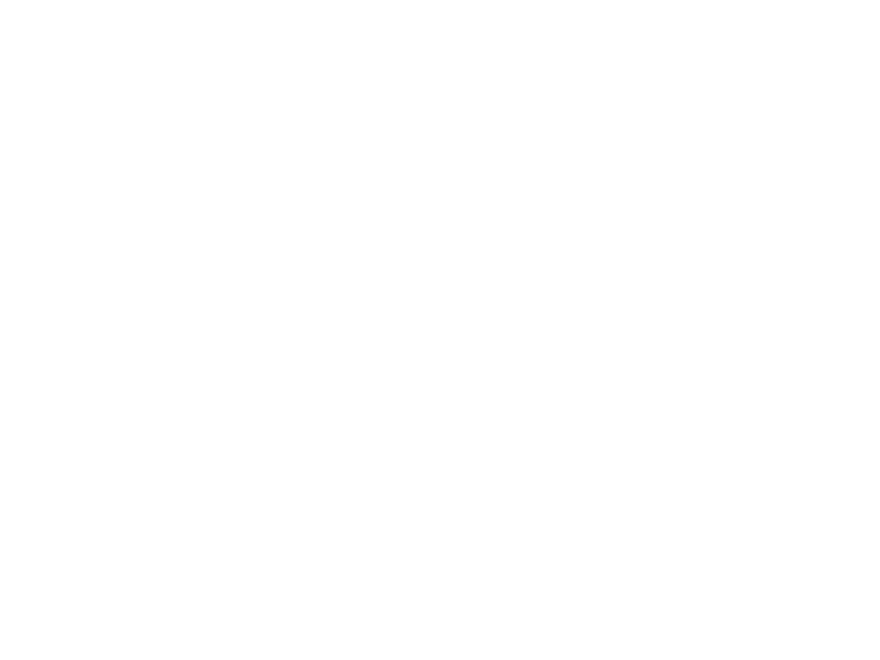

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0093.mp4

D:/HNSCC/HNSCC-01-0093\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


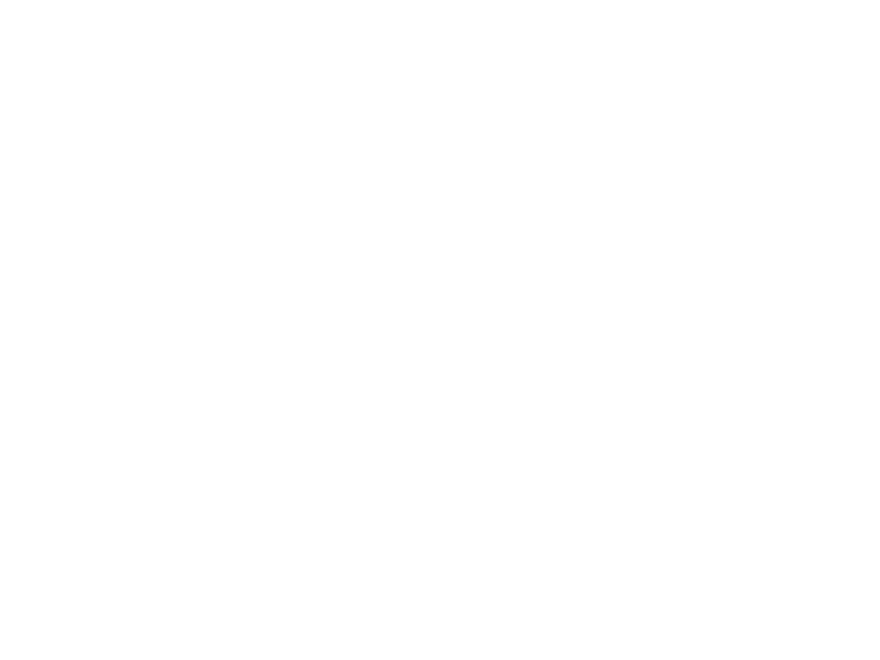

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0093.mp4

D:/HNSCC/HNSCC-01-0093\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


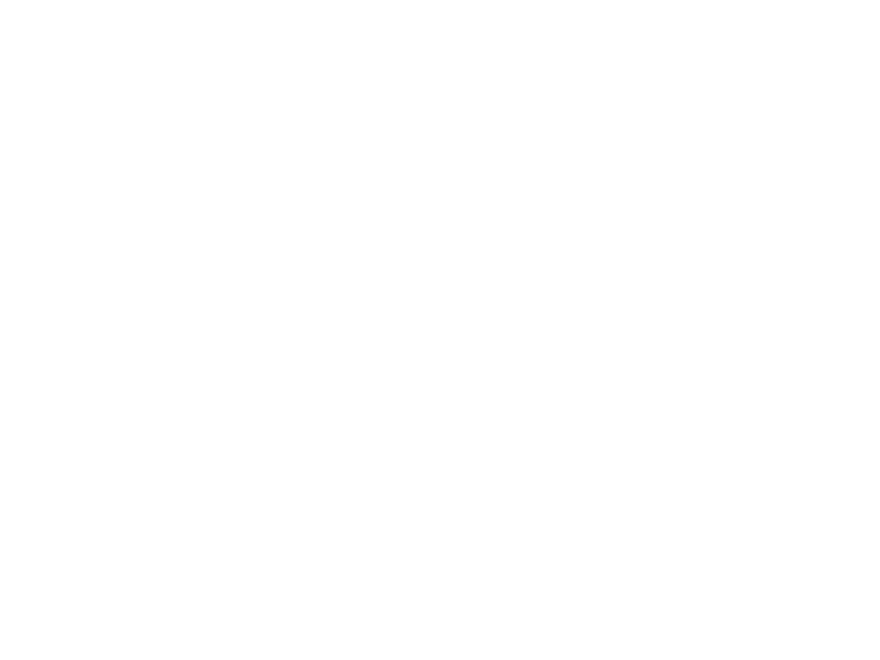

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0093.mp4

D:/HNSCC/HNSCC-01-0093\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0093\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0094\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0094\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0094\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0094\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0094\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0095\
Thickness 1: 2.500
Thickness 

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


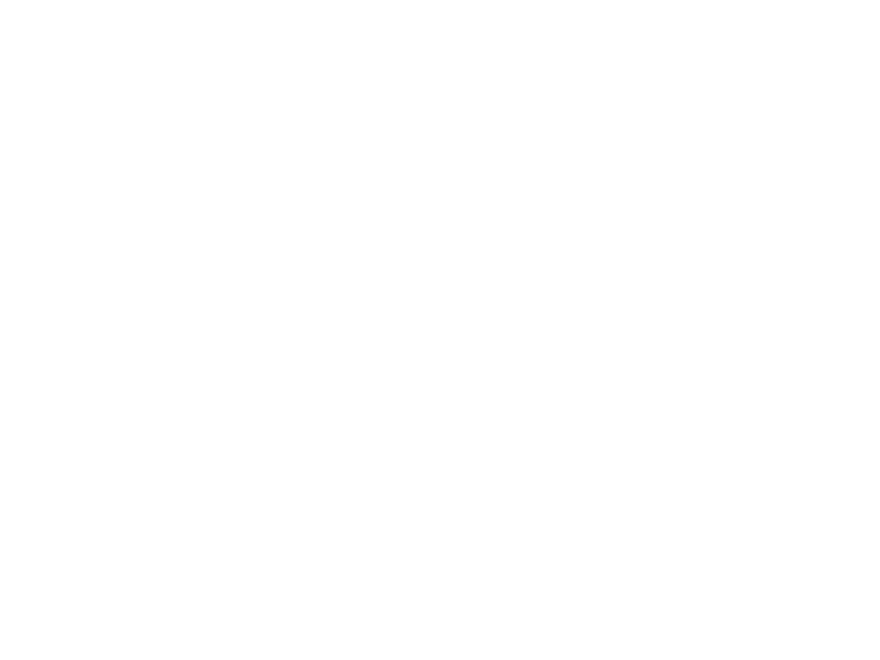

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0095.mp4

D:/HNSCC/HNSCC-01-0095\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


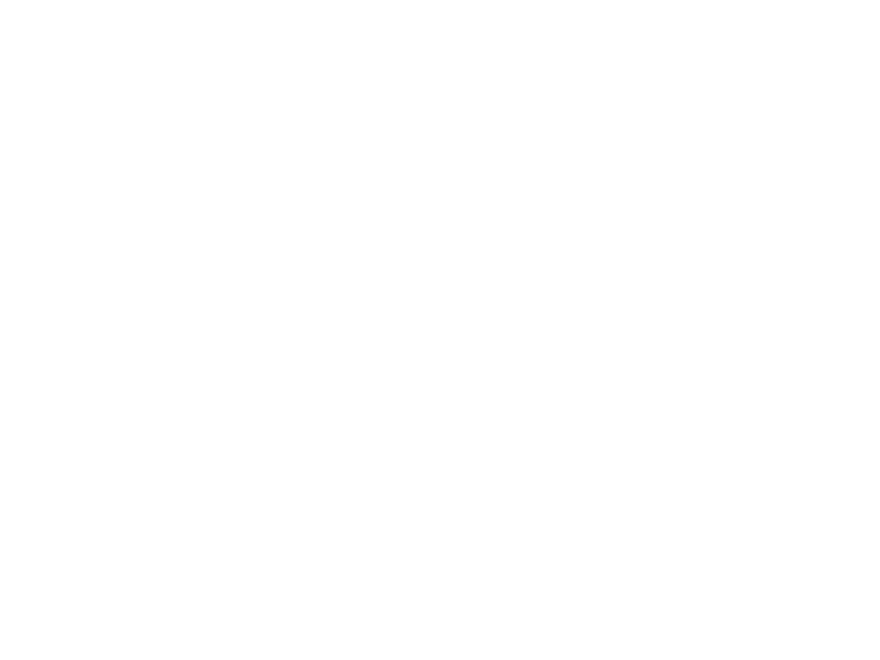

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0095.mp4

D:/HNSCC/HNSCC-01-0095\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


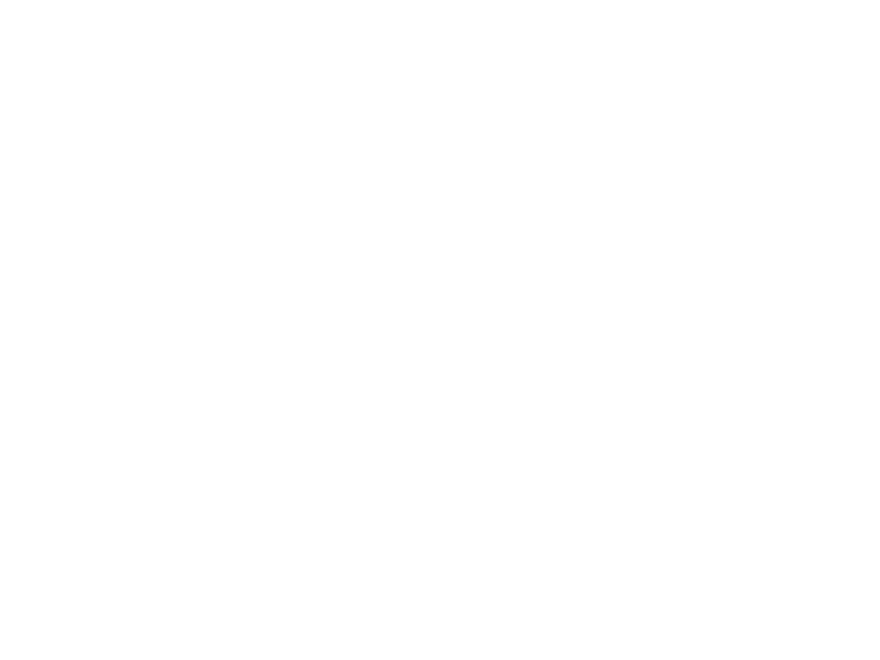

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0095.mp4

D:/HNSCC/HNSCC-01-0095\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0095\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0096\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


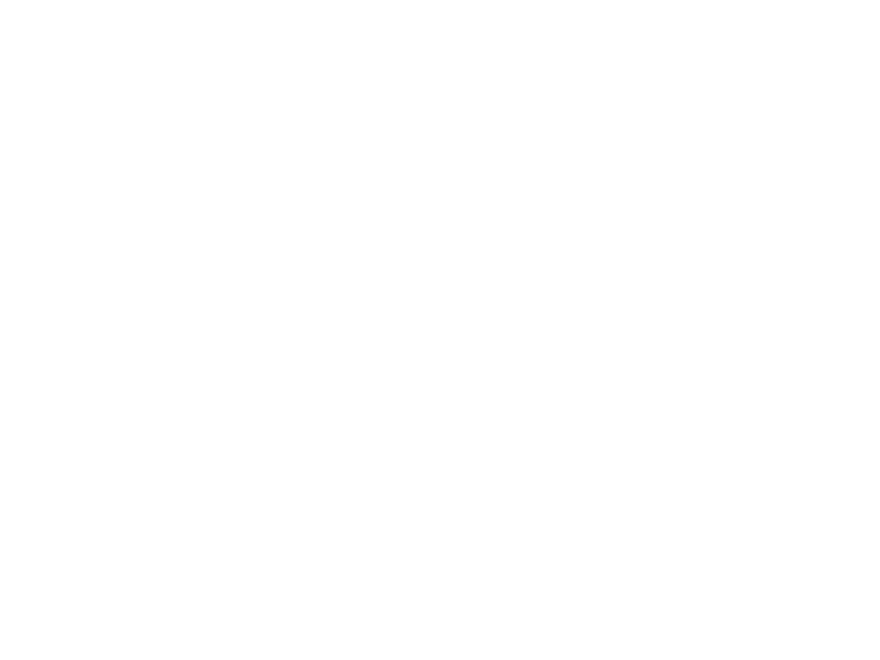

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0096.mp4

D:/HNSCC/HNSCC-01-0096\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


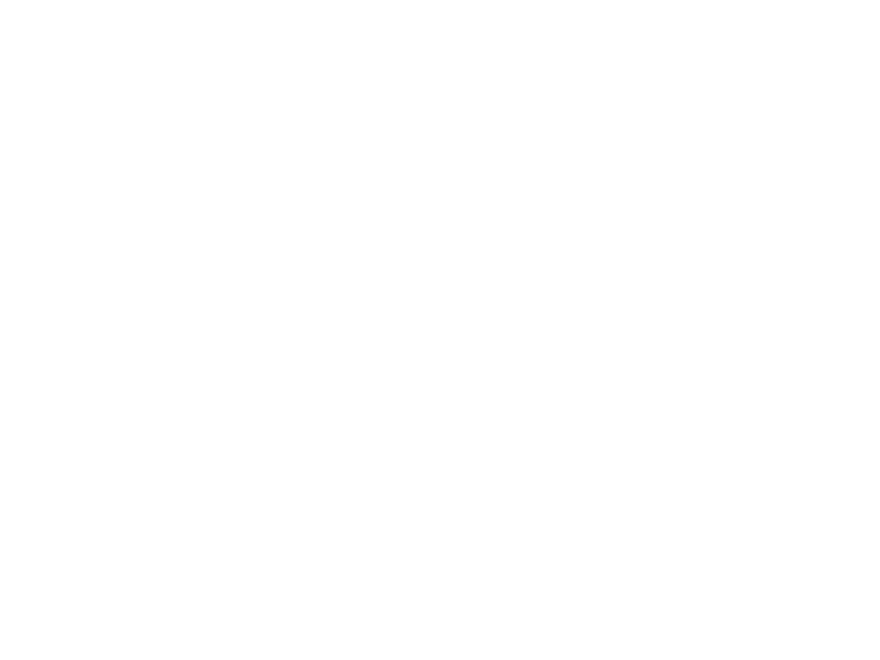

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0096.mp4

D:/HNSCC/HNSCC-01-0096\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


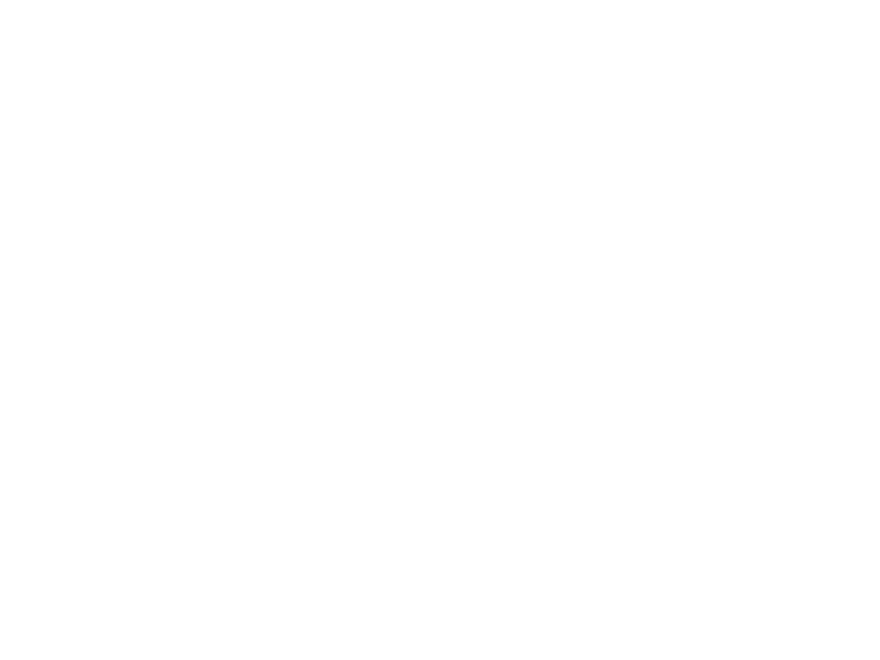

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0096.mp4

D:/HNSCC/HNSCC-01-0096\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0096\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


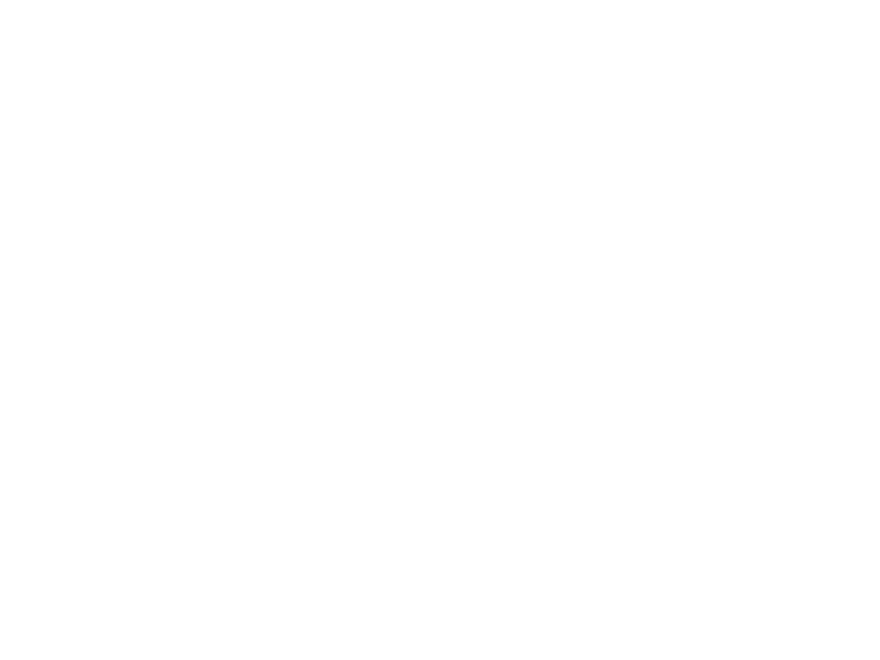

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0096.mp4

D:/HNSCC/HNSCC-01-0097\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


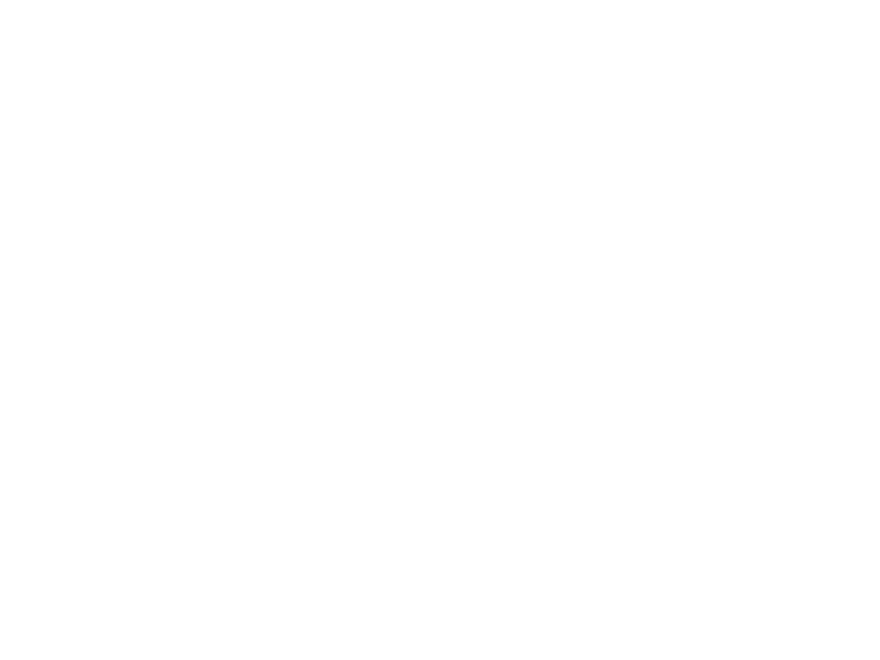

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0097.mp4

D:/HNSCC/HNSCC-01-0097\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


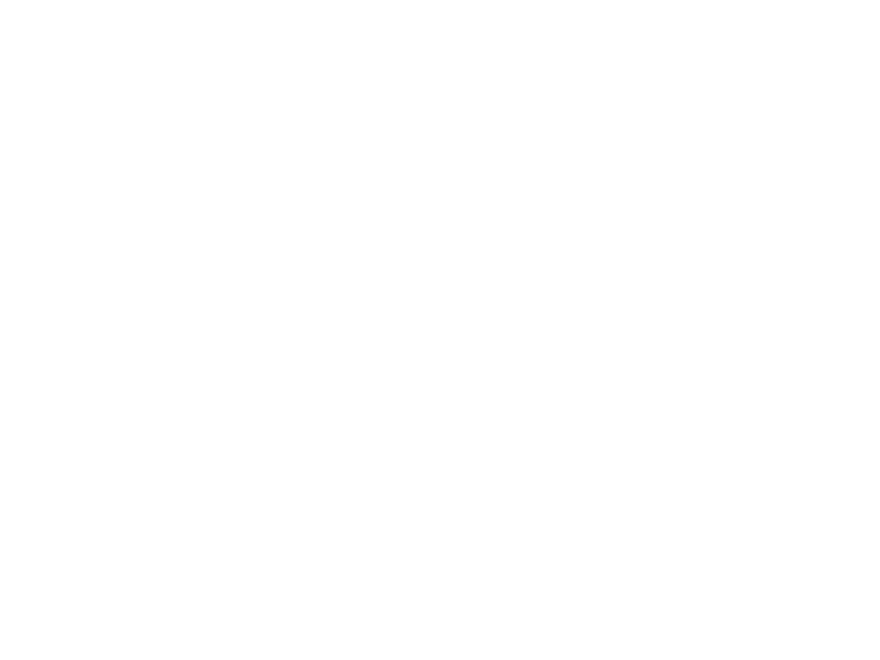

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0097.mp4

D:/HNSCC/HNSCC-01-0097\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


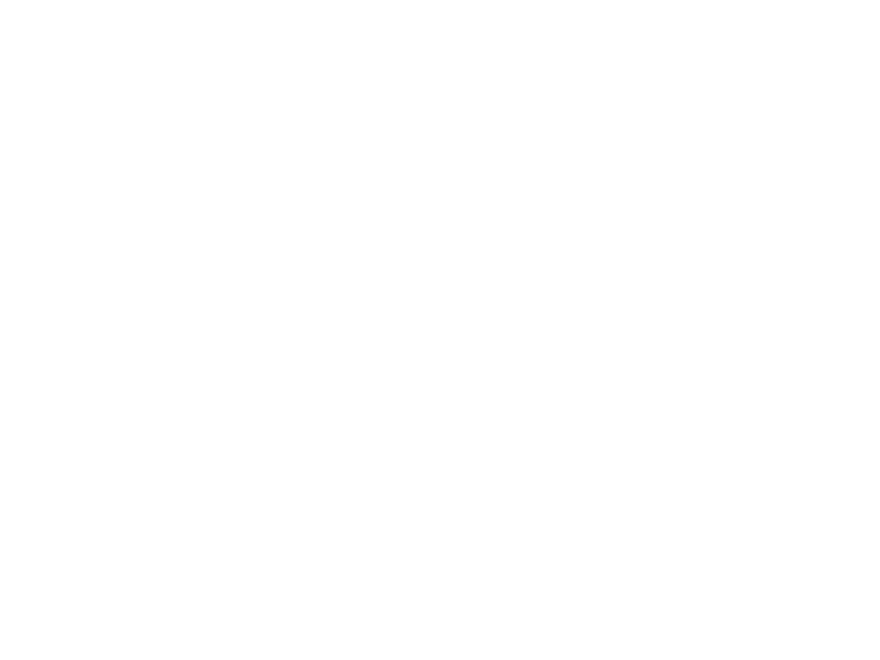

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0097.mp4

D:/HNSCC/HNSCC-01-0097\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0097\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0098\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0098\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0098\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0098\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0098\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0099\
Thickness 1: 2.500
Thickness 

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


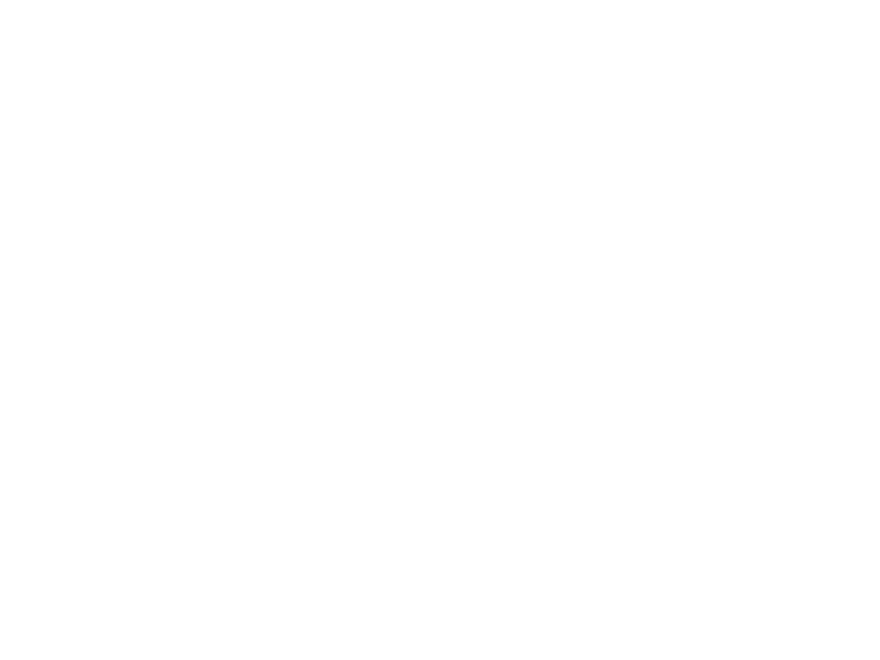

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0099.mp4

D:/HNSCC/HNSCC-01-0099\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0099\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


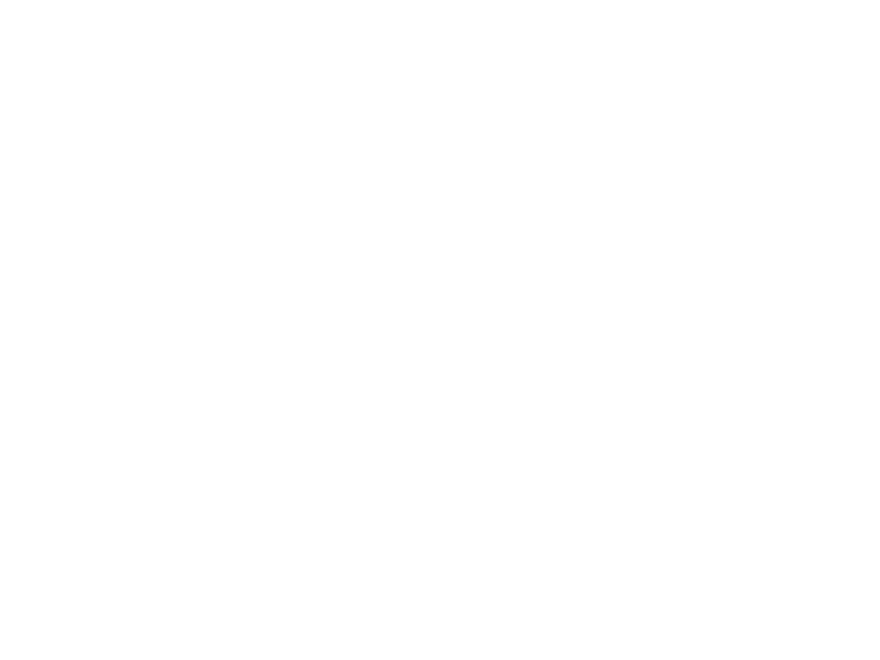

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0099.mp4

D:/HNSCC/HNSCC-01-0099\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0099\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0100\


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\pydicom\filereader.py:313: UserWarning: Expected explicit VR, but found implicit VR - using implicit VR for reading
  warnings.warn(message, UserWarning)


Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
Interpolated
Thickness 2: 3.750
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0100\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
Interpolated
Thickness 2: 3.750
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0100\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
Interpolated
Thickness 2: 3.750
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0100\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
Interpolated
Thickness 2: 3.750
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0100\
Thickness 1: 3.270
Thickness 2: 3.750
Thickness 3: 3.270
check 3: 3.500
Thickness 3: 3.250
Interpolated
Thickness 2: 3.750
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0101\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


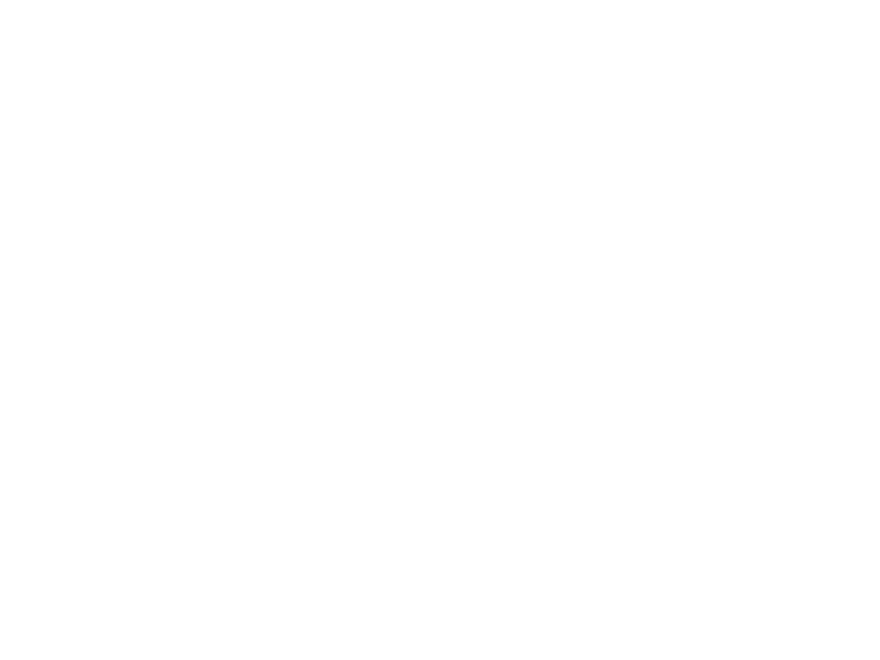

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0101.mp4

D:/HNSCC/HNSCC-01-0101\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


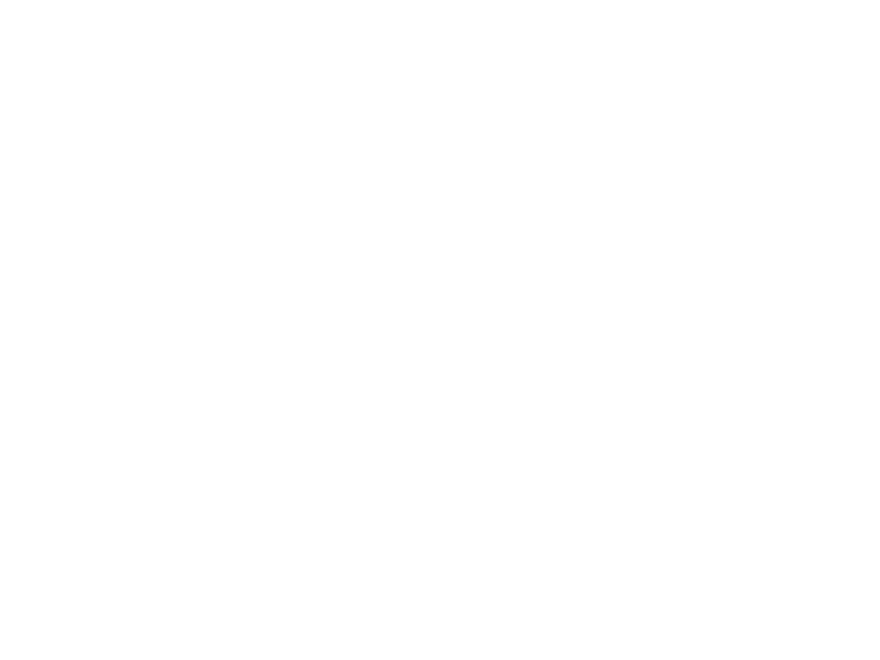

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0101.mp4

D:/HNSCC/HNSCC-01-0101\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


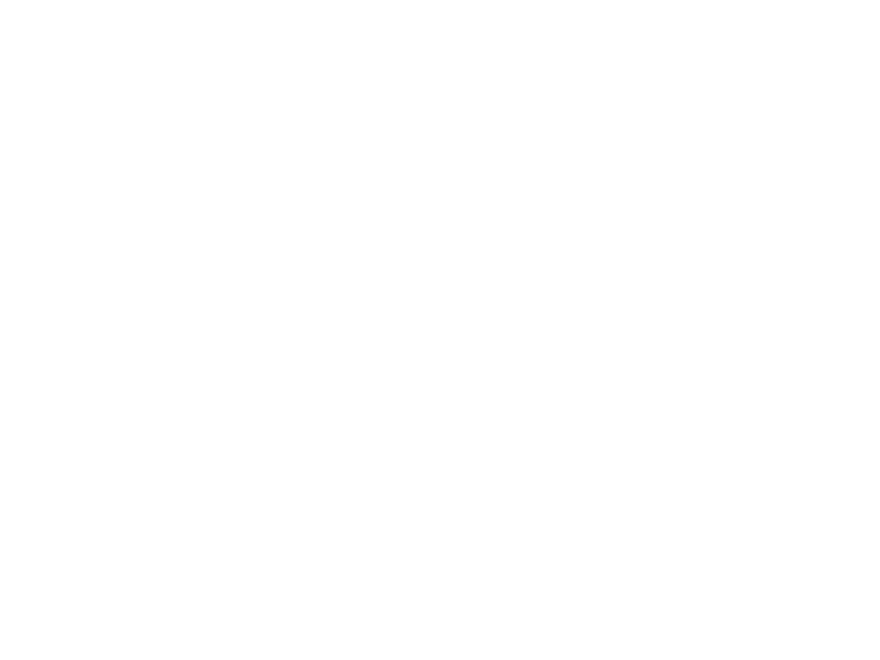

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0101.mp4

D:/HNSCC/HNSCC-01-0101\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0101\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0102\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


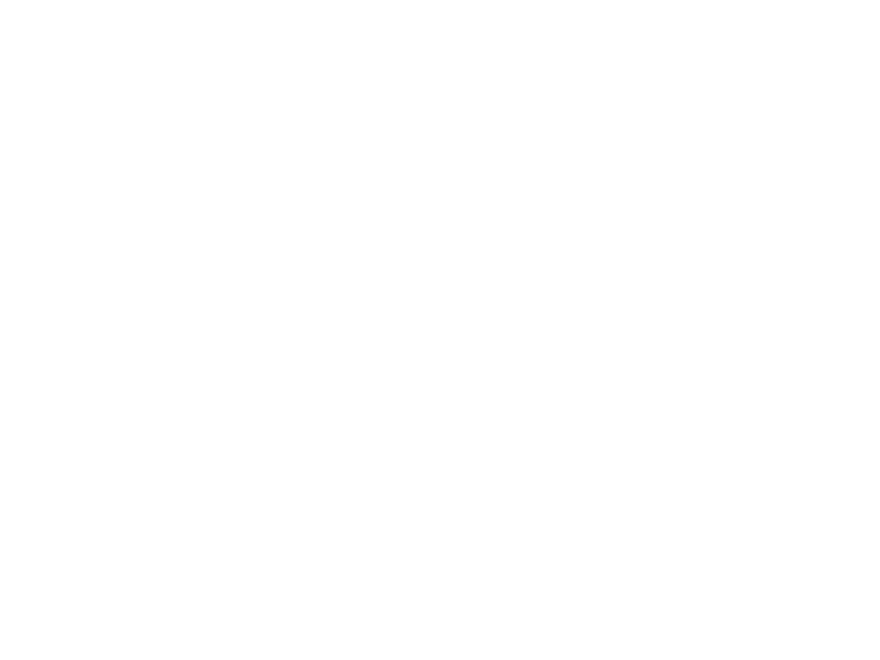

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0102.mp4

D:/HNSCC/HNSCC-01-0102\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


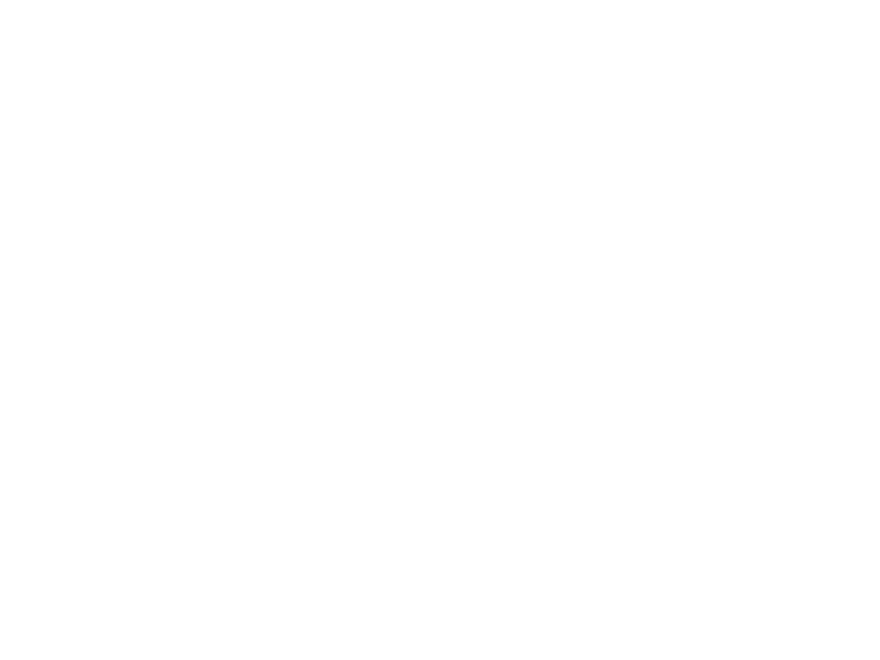

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0102.mp4

D:/HNSCC/HNSCC-01-0102\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


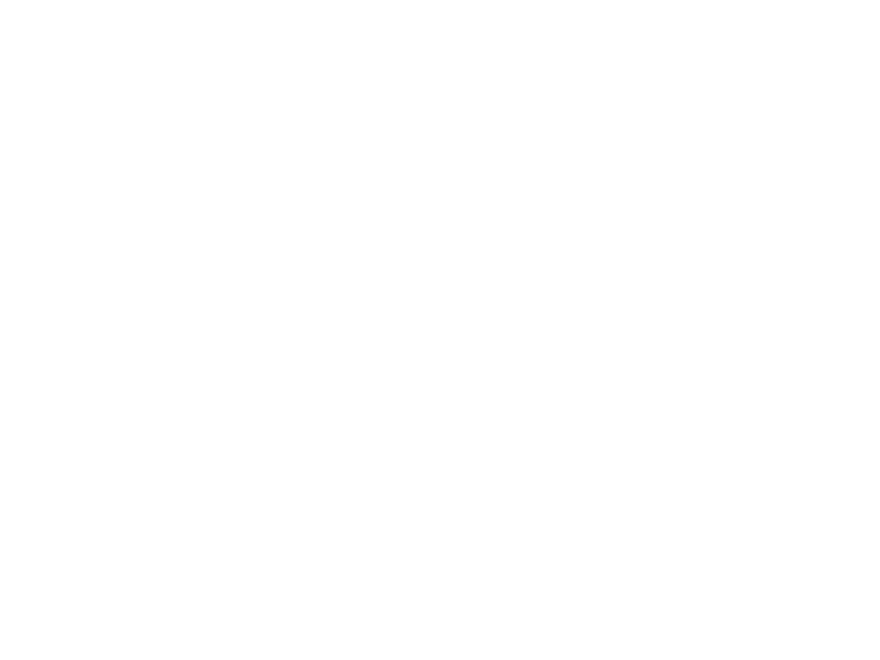

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0102.mp4

D:/HNSCC/HNSCC-01-0102\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0102\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0103\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


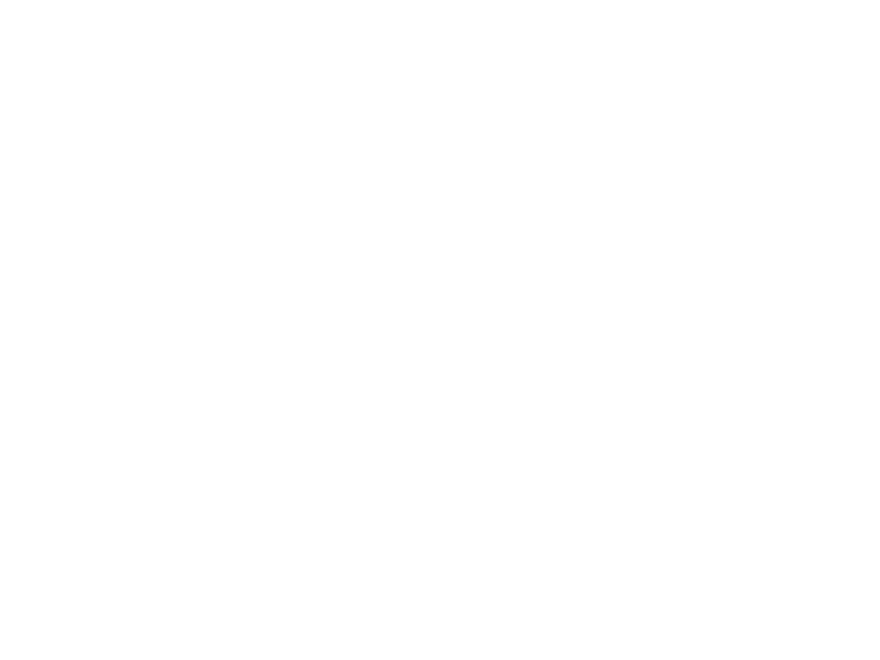

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0103.mp4

D:/HNSCC/HNSCC-01-0103\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


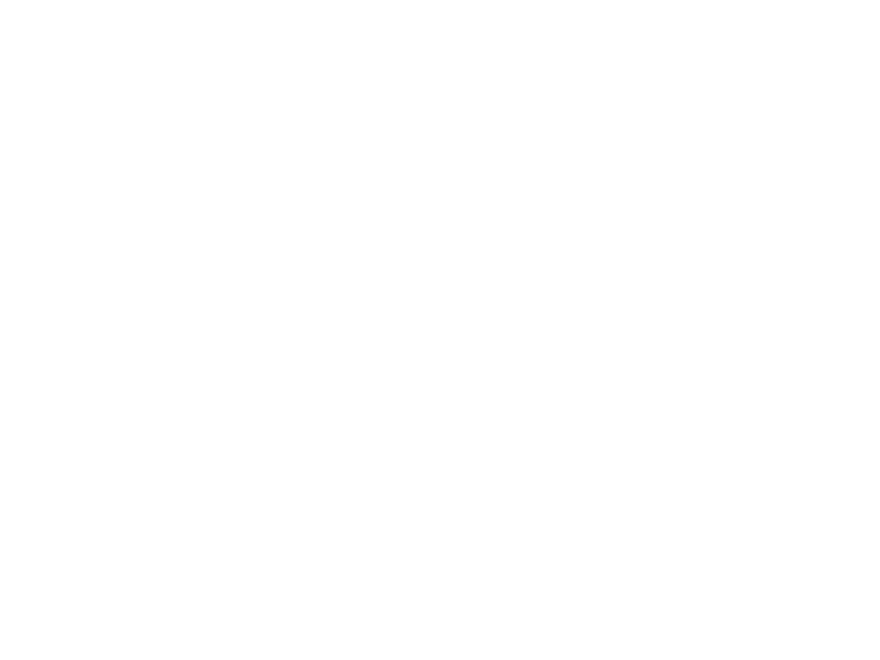

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0103.mp4

D:/HNSCC/HNSCC-01-0103\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


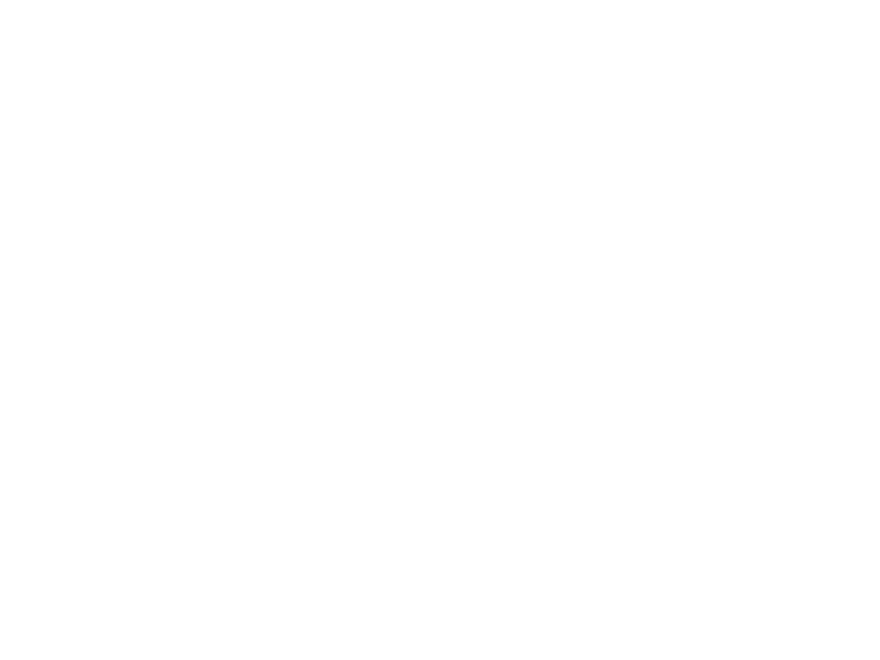

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0103.mp4

D:/HNSCC/HNSCC-01-0103\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


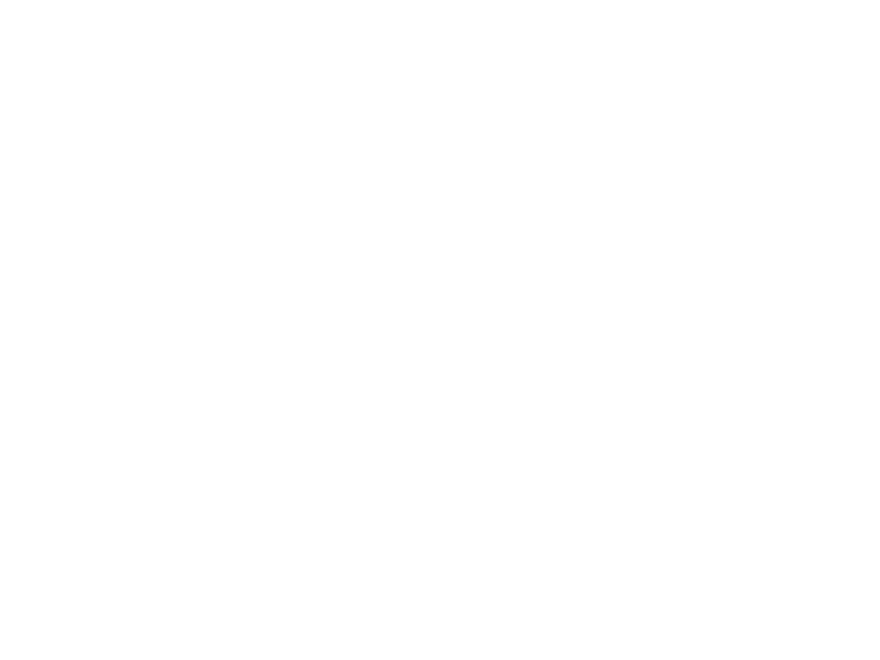

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0103.mp4

D:/HNSCC/HNSCC-01-0103\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


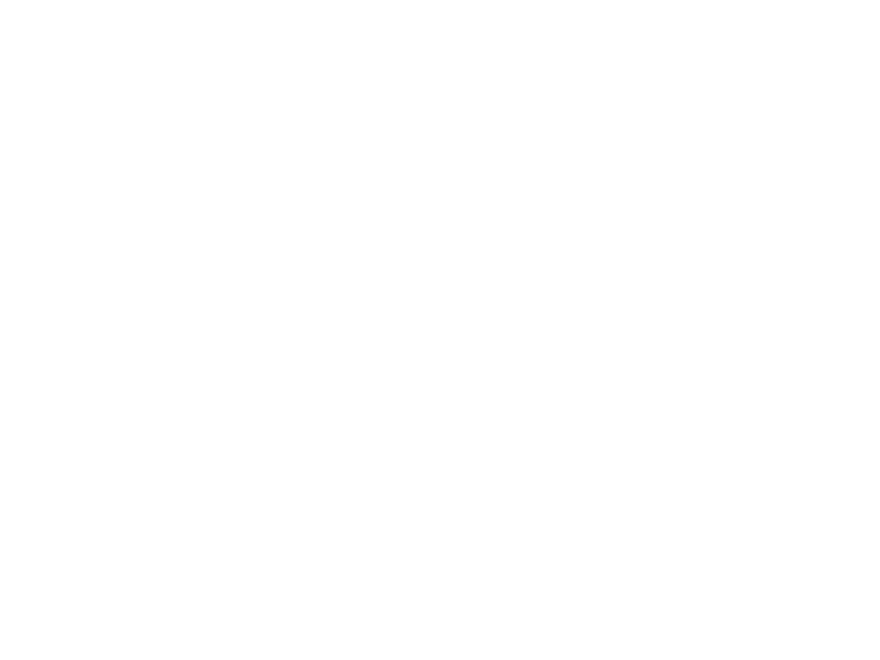

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0103.mp4

D:/HNSCC/HNSCC-01-0104\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


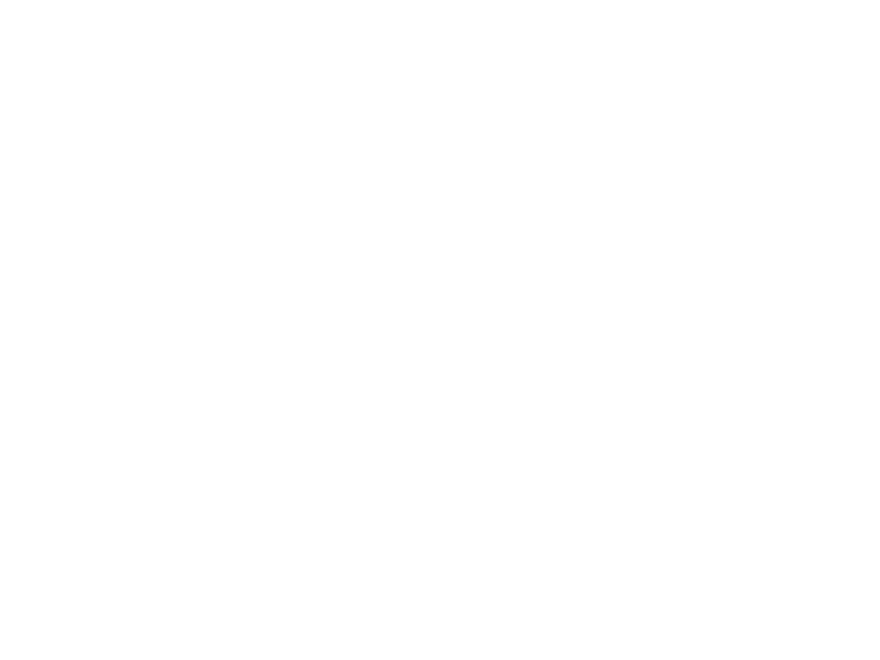

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0104.mp4

D:/HNSCC/HNSCC-01-0104\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


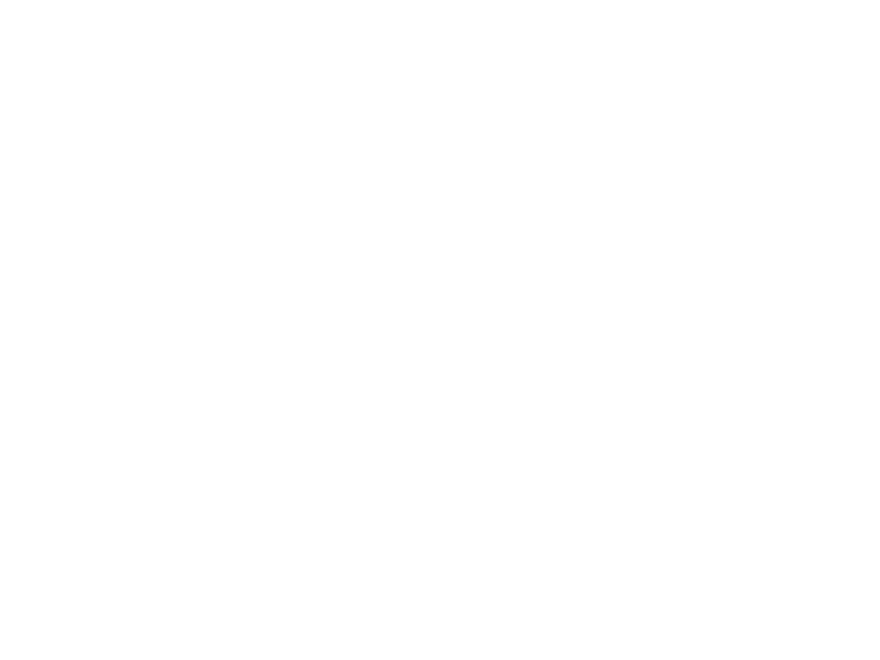

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0104.mp4

D:/HNSCC/HNSCC-01-0104\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


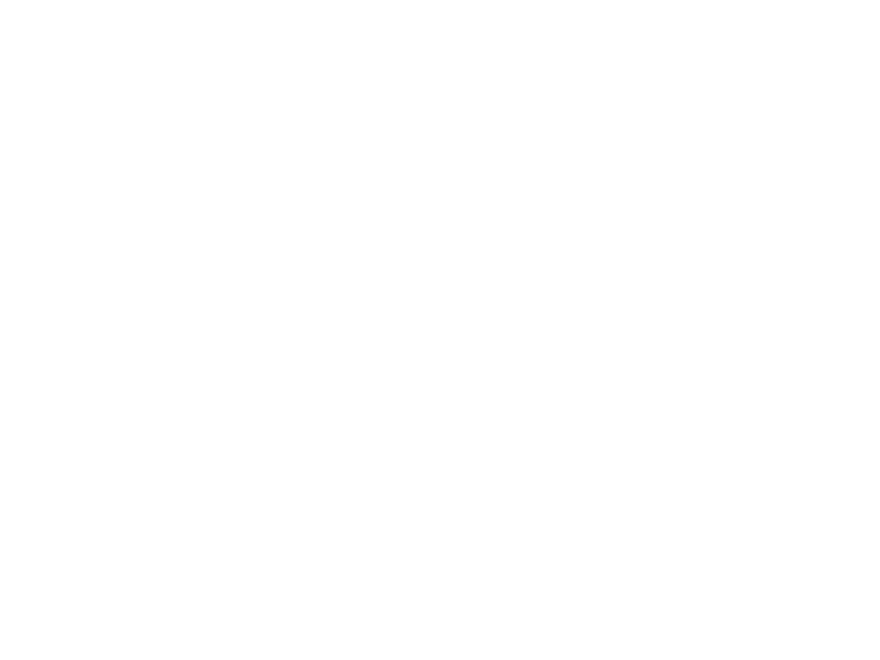

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0104.mp4

D:/HNSCC/HNSCC-01-0104\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0104\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0105\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


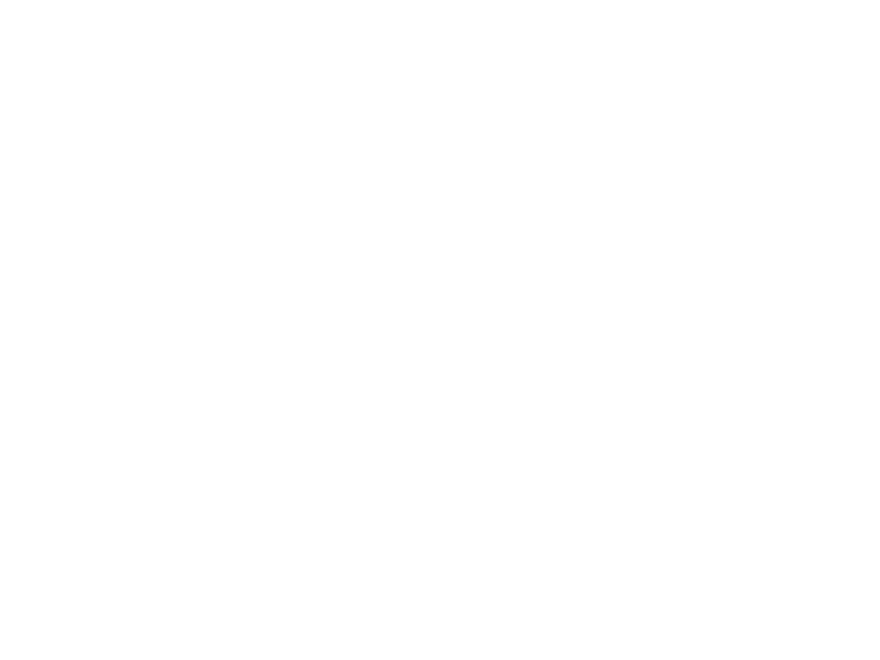

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0105.mp4

D:/HNSCC/HNSCC-01-0105\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


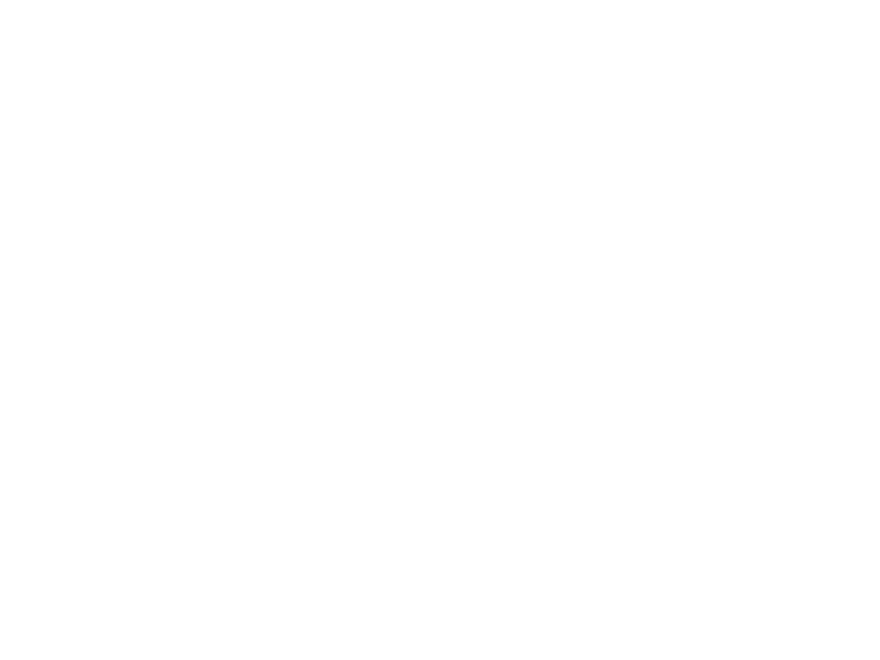

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0105.mp4

D:/HNSCC/HNSCC-01-0105\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


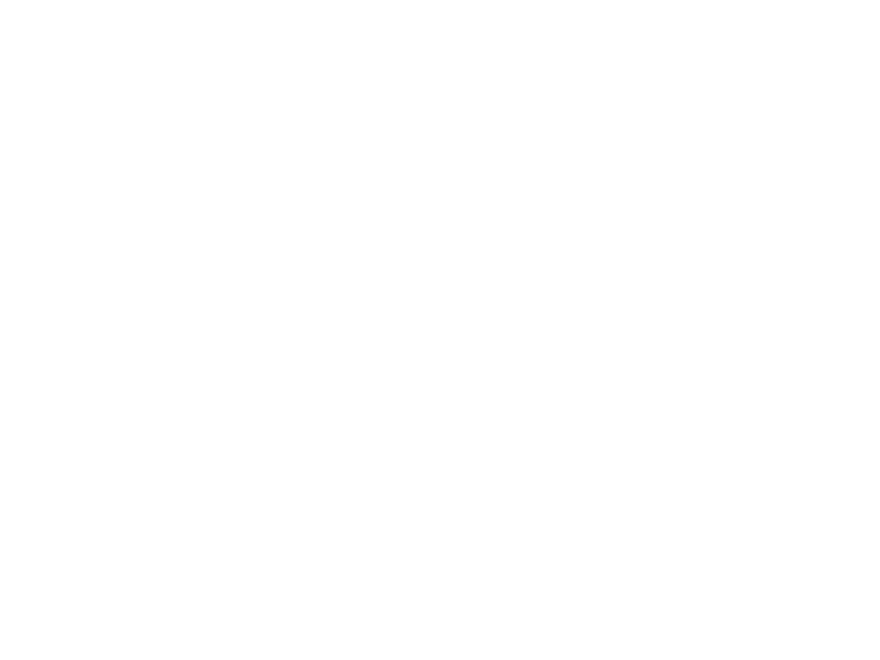

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0105.mp4

D:/HNSCC/HNSCC-01-0105\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0105\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0106\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


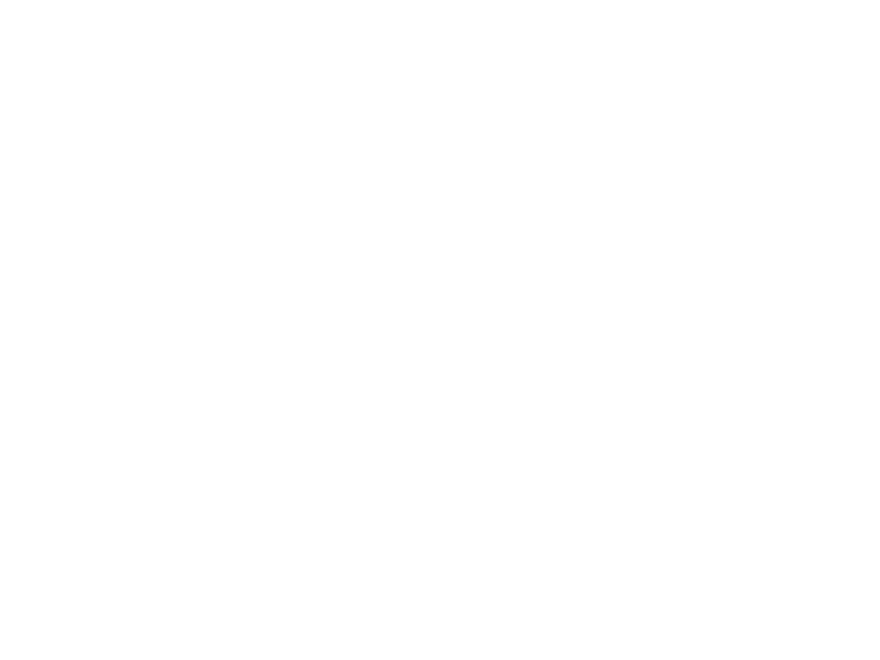

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0106.mp4

D:/HNSCC/HNSCC-01-0106\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0106\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


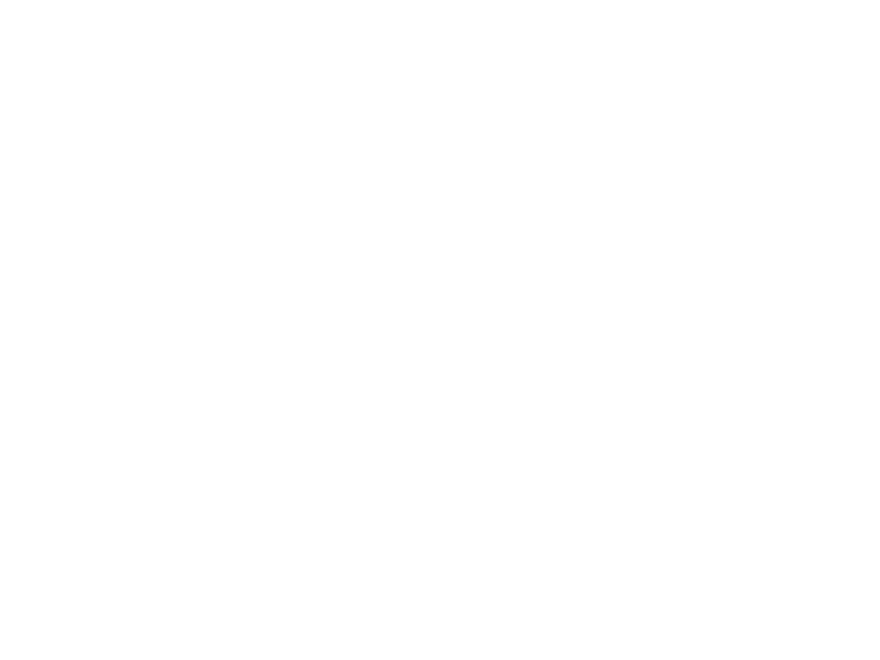

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0106.mp4

D:/HNSCC/HNSCC-01-0106\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0106\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0107\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


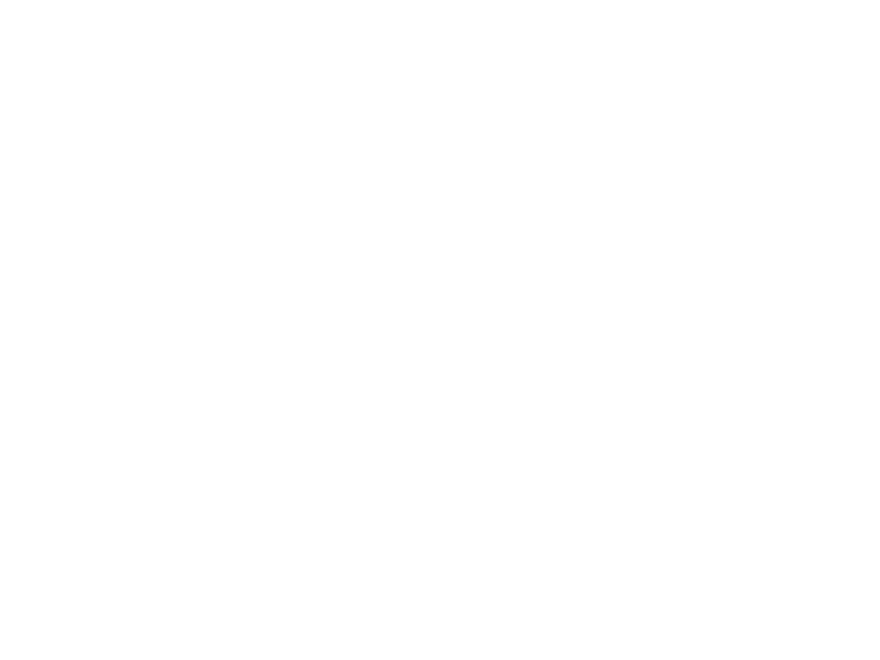

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0107.mp4

D:/HNSCC/HNSCC-01-0107\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


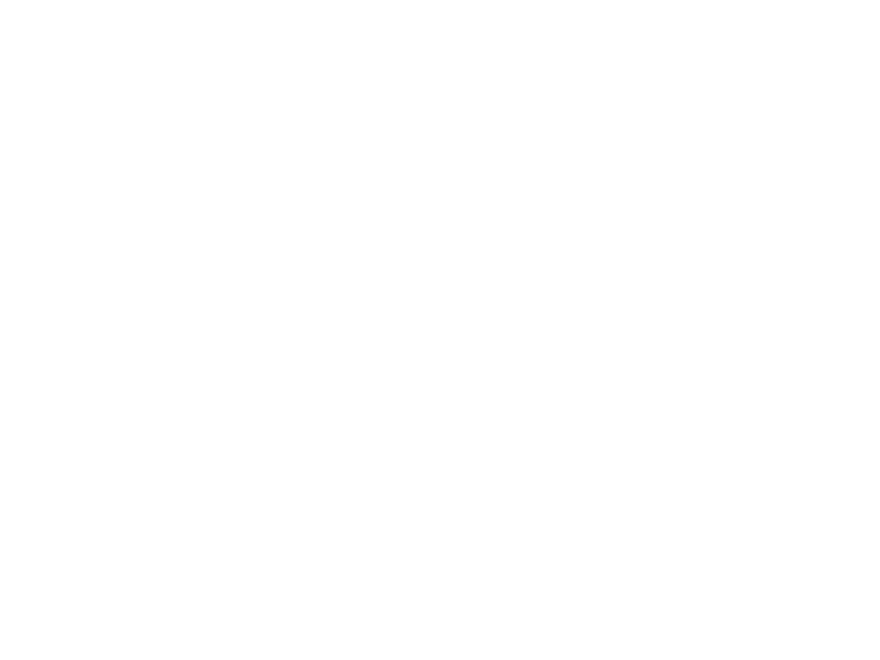

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0107.mp4

D:/HNSCC/HNSCC-01-0107\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


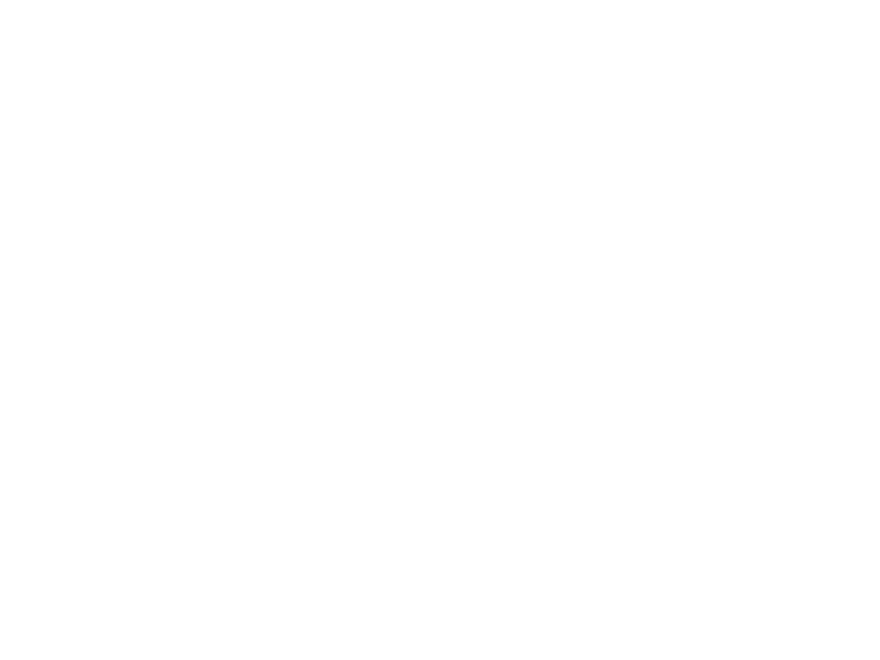

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0107.mp4

D:/HNSCC/HNSCC-01-0107\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0107\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0108\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


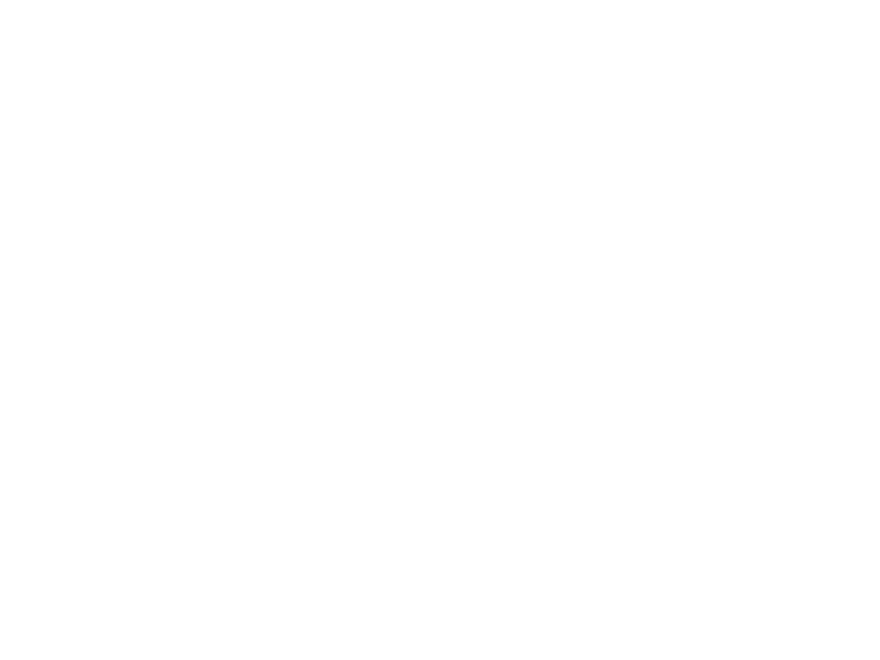

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0108.mp4

D:/HNSCC/HNSCC-01-0108\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


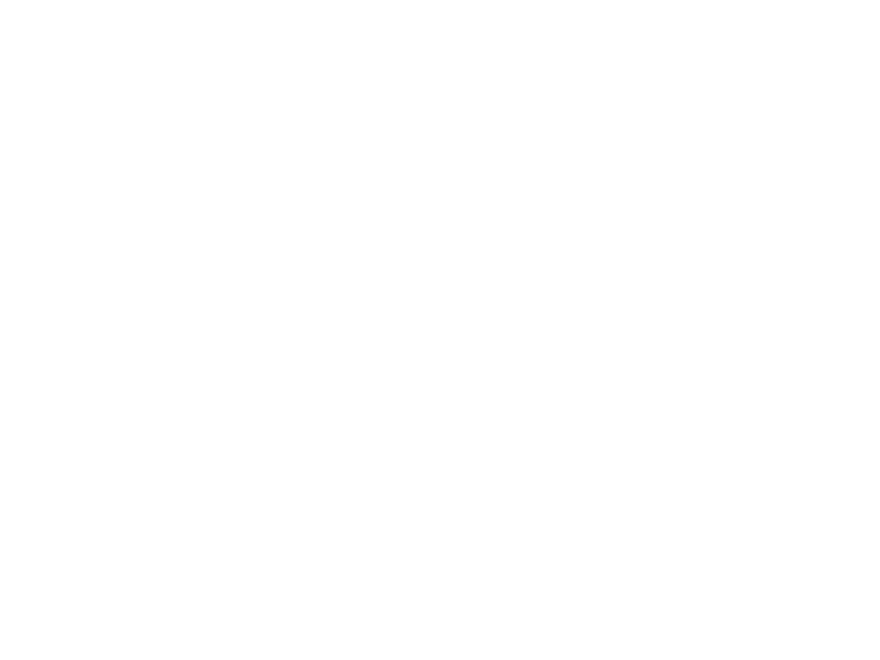

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0108.mp4

D:/HNSCC/HNSCC-01-0108\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


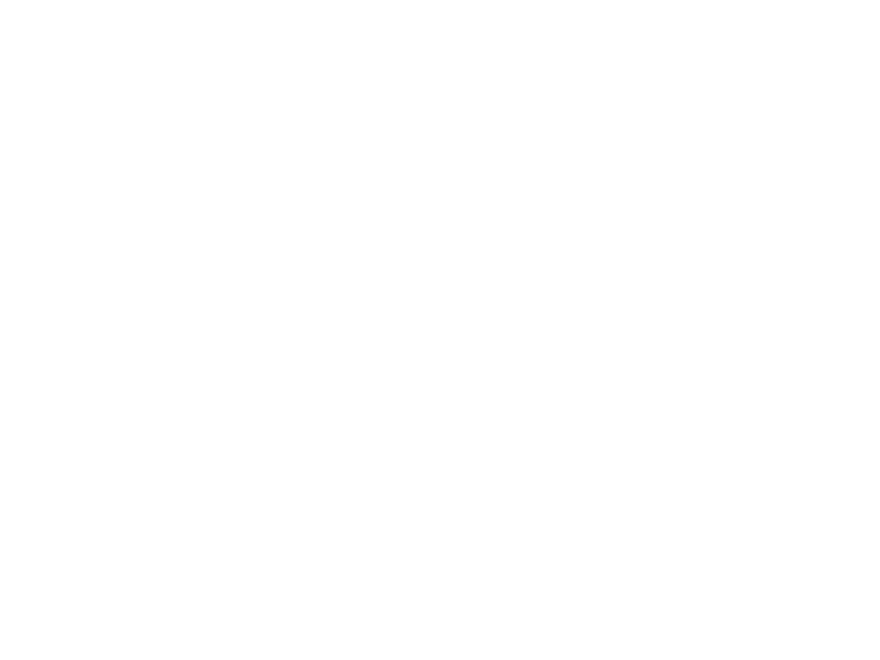

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0108.mp4

D:/HNSCC/HNSCC-01-0108\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


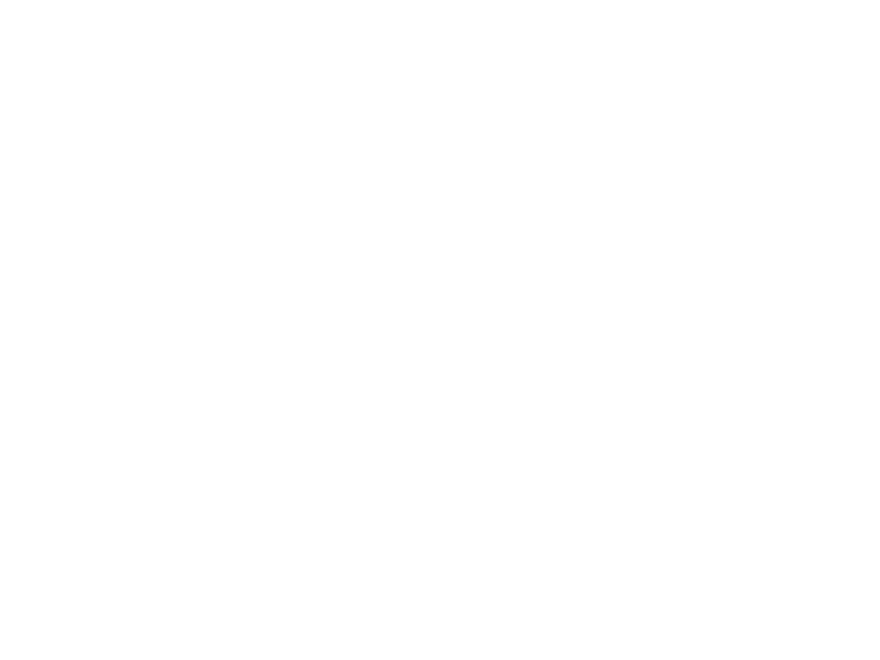

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0108.mp4

D:/HNSCC/HNSCC-01-0108\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


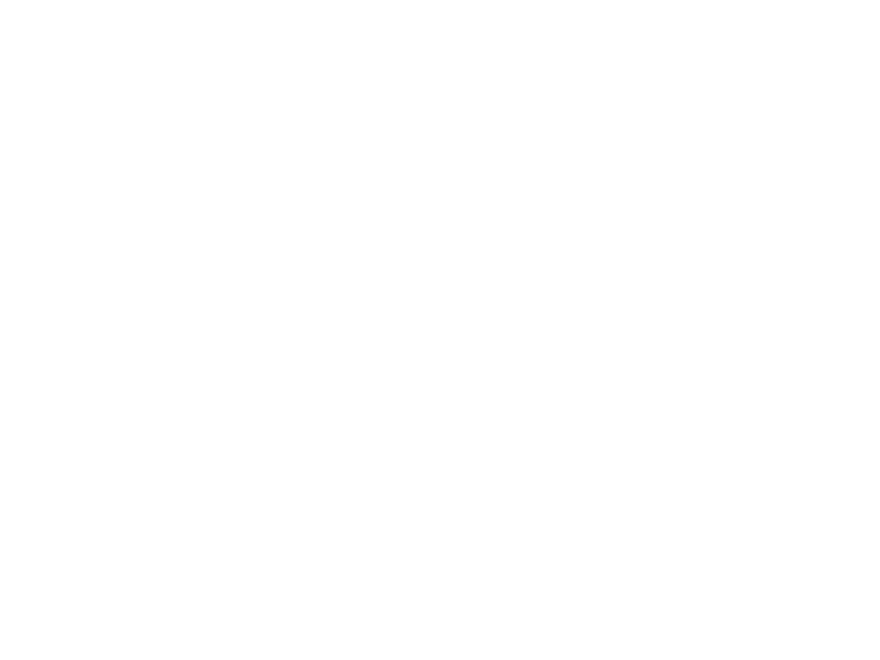

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0108.mp4

D:/HNSCC/HNSCC-01-0109\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


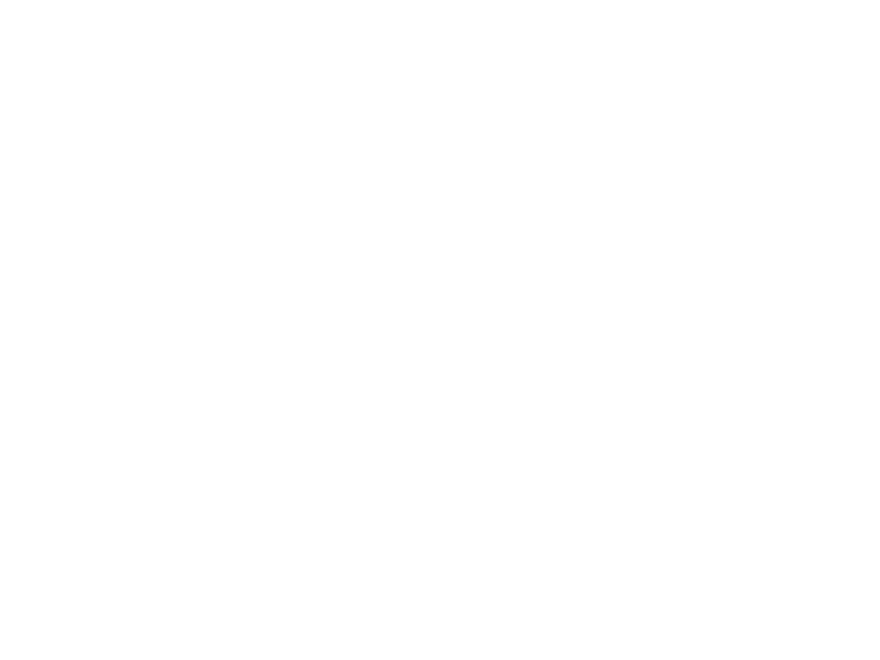

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0109.mp4

D:/HNSCC/HNSCC-01-0109\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


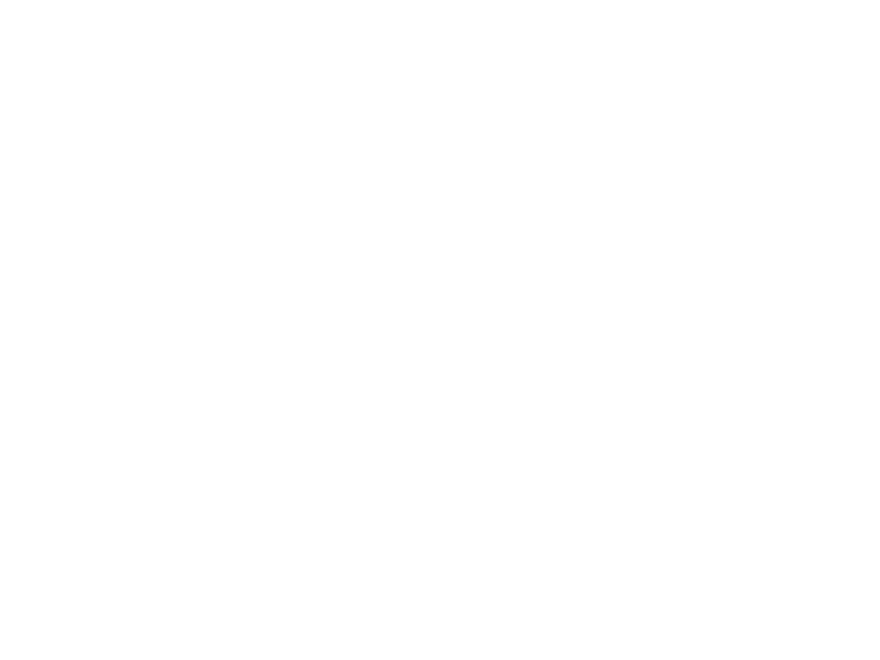

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0109.mp4

D:/HNSCC/HNSCC-01-0109\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


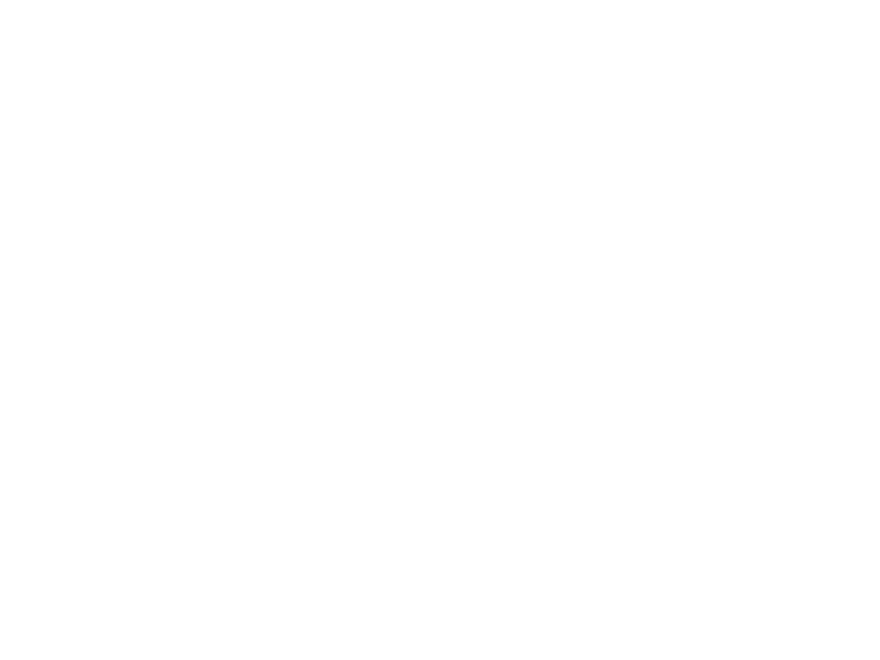

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0109.mp4

D:/HNSCC/HNSCC-01-0109\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


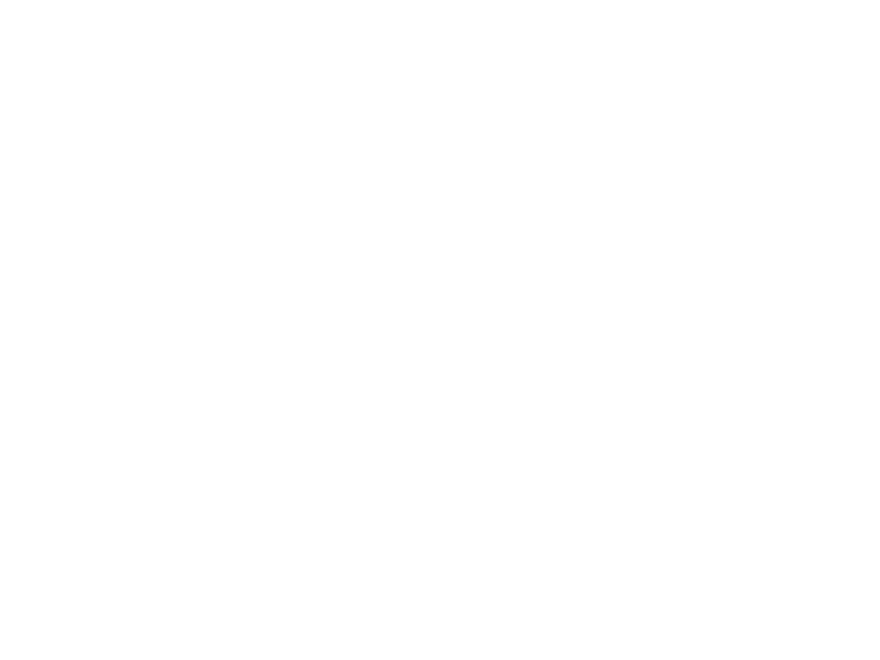

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0109.mp4

D:/HNSCC/HNSCC-01-0109\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


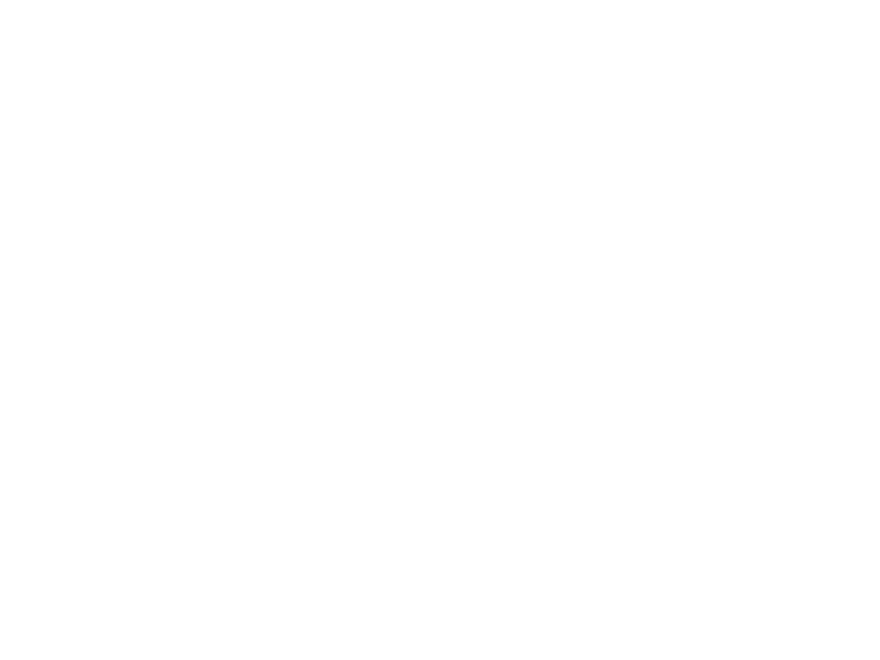

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0109.mp4

D:/HNSCC/HNSCC-01-0110\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


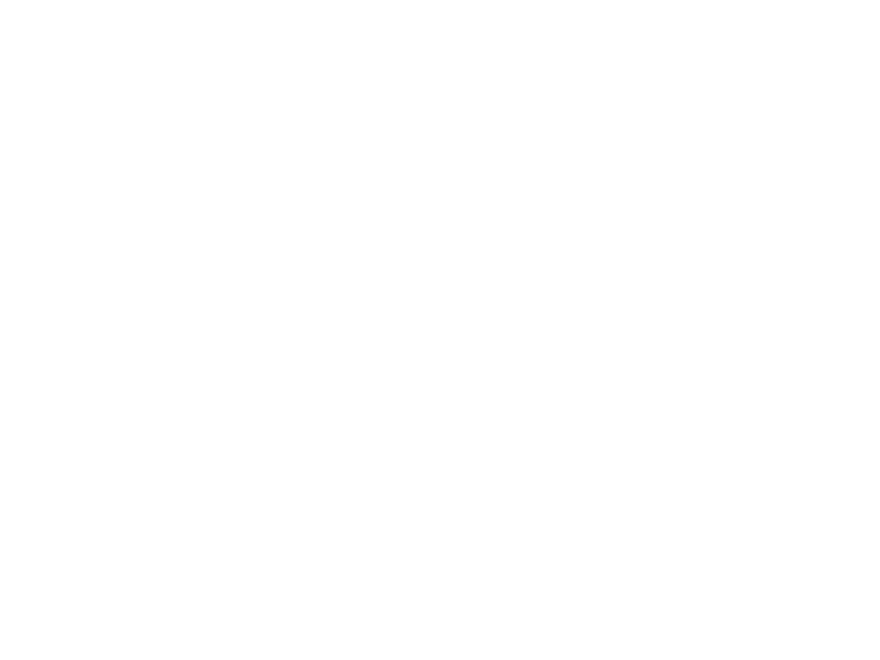

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0110.mp4

D:/HNSCC/HNSCC-01-0110\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


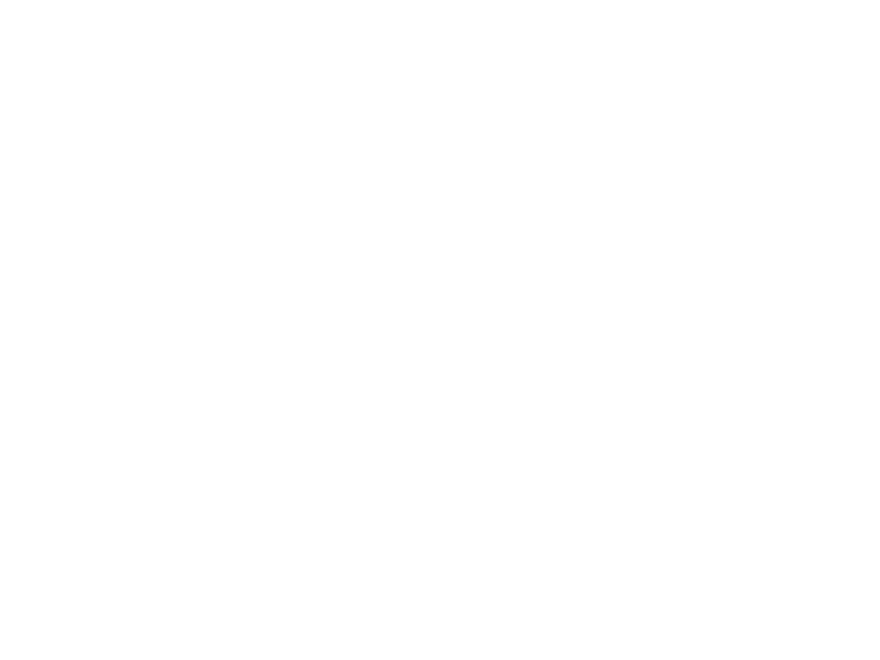

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0110.mp4

D:/HNSCC/HNSCC-01-0110\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


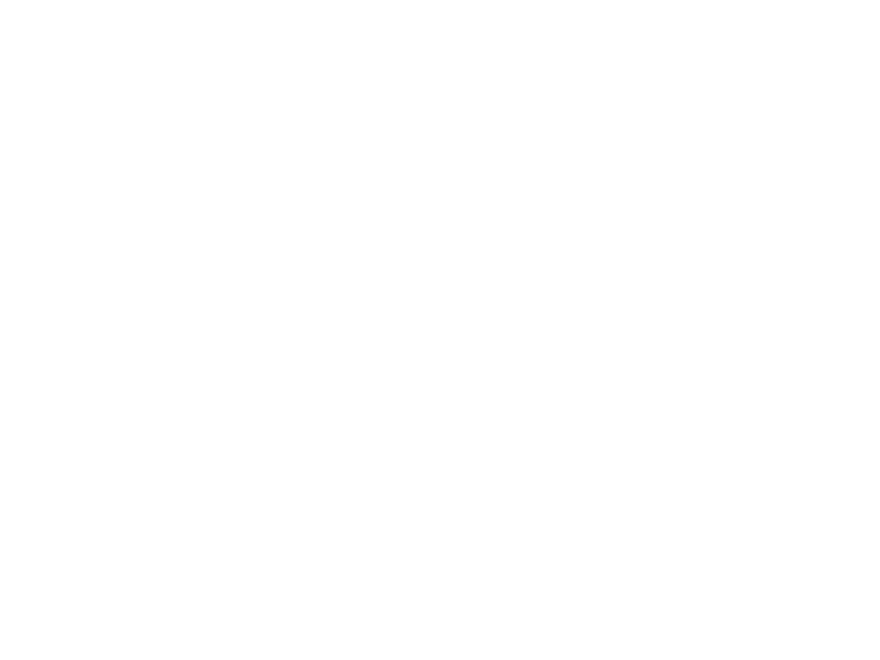

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0110.mp4

D:/HNSCC/HNSCC-01-0110\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0110\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0111\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


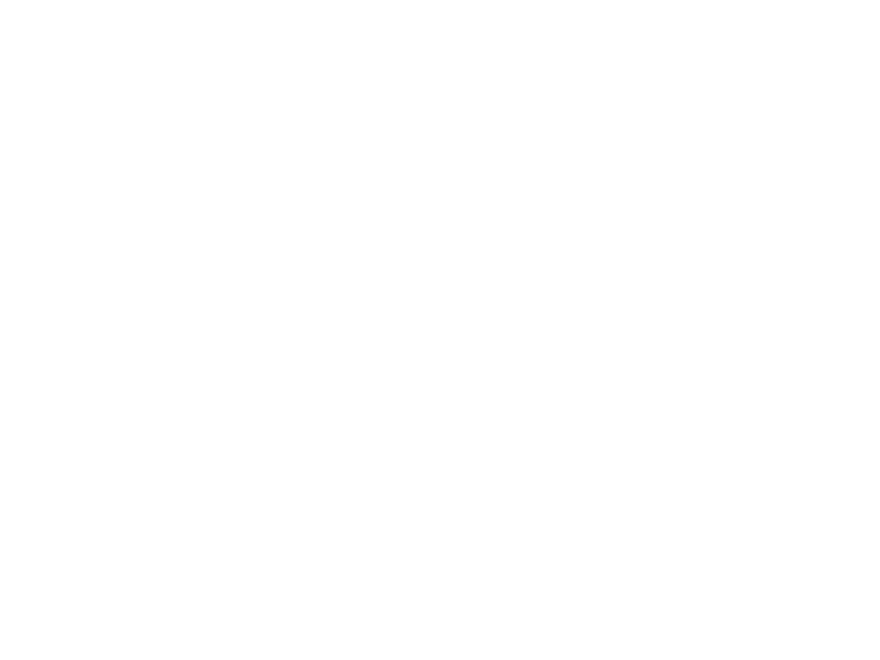

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0111.mp4

D:/HNSCC/HNSCC-01-0111\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


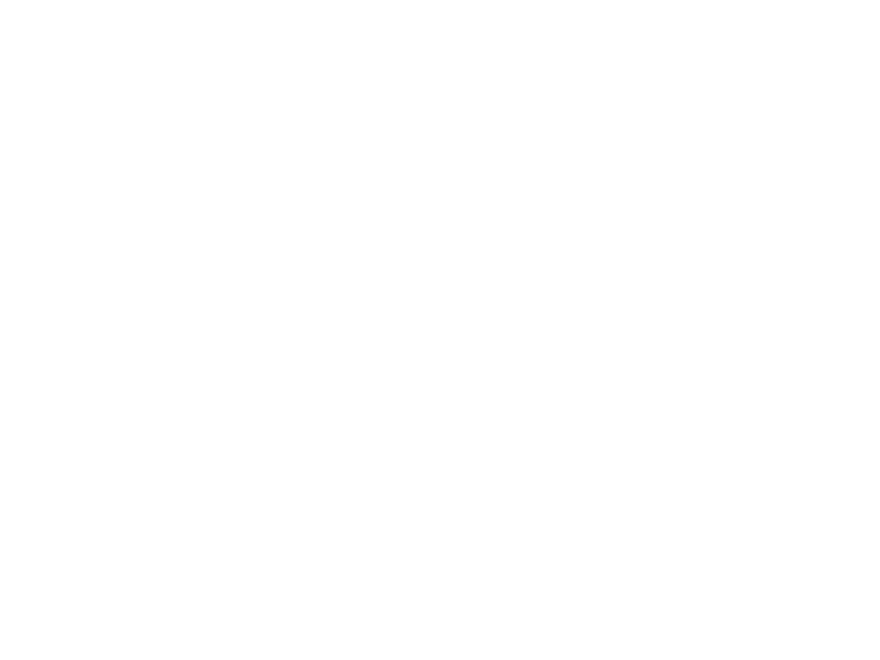

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0111.mp4

D:/HNSCC/HNSCC-01-0111\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


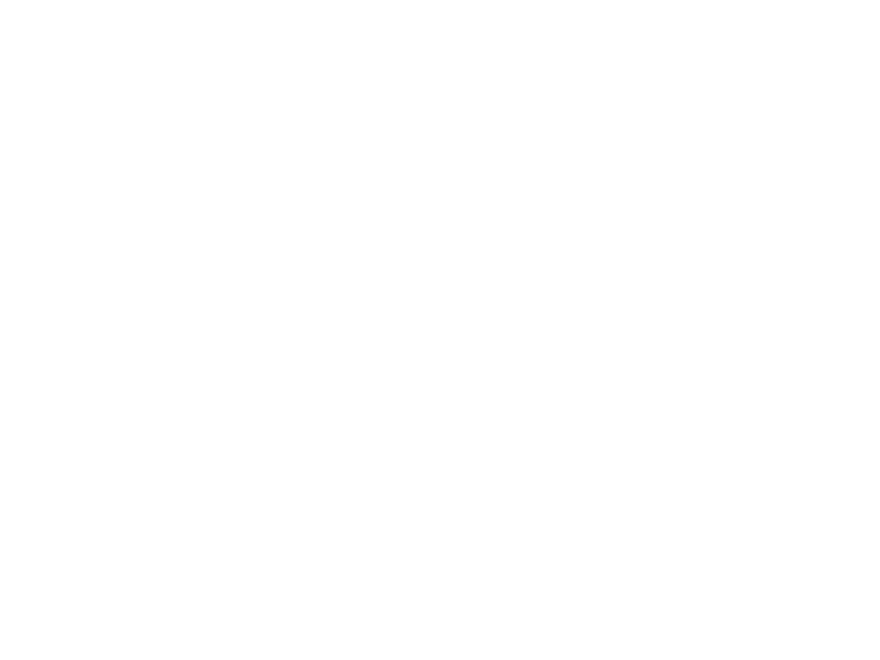

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0111.mp4

D:/HNSCC/HNSCC-01-0111\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0111\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0112\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


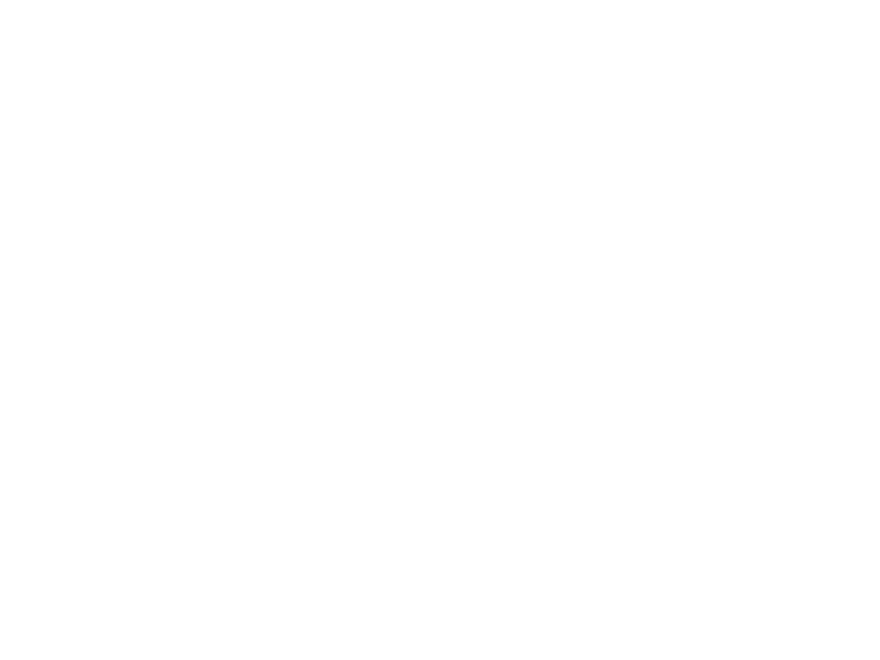

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0112.mp4

D:/HNSCC/HNSCC-01-0112\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


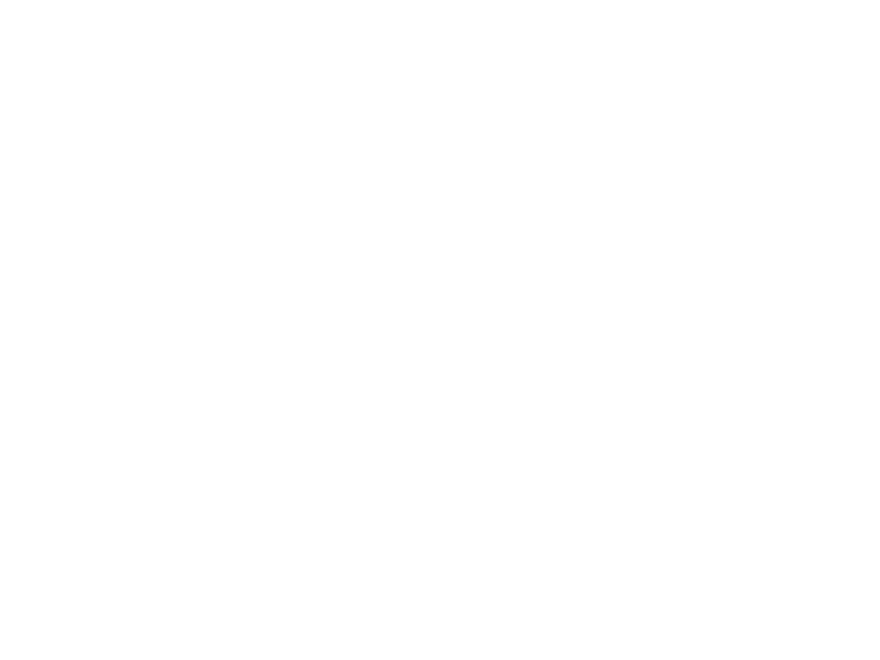

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0112.mp4

D:/HNSCC/HNSCC-01-0112\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


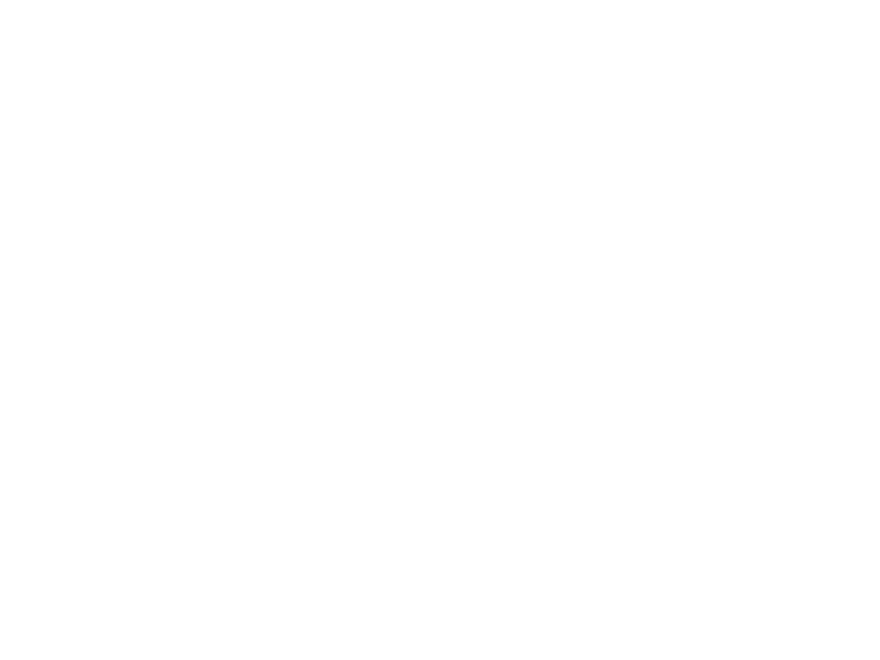

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0112.mp4

D:/HNSCC/HNSCC-01-0112\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0112\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0113\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


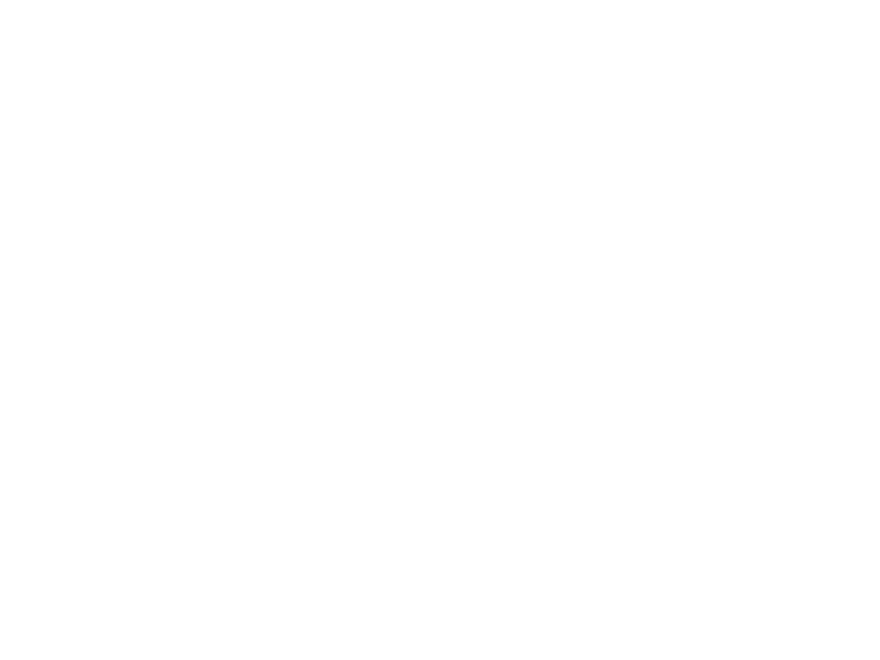

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0113.mp4

D:/HNSCC/HNSCC-01-0113\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


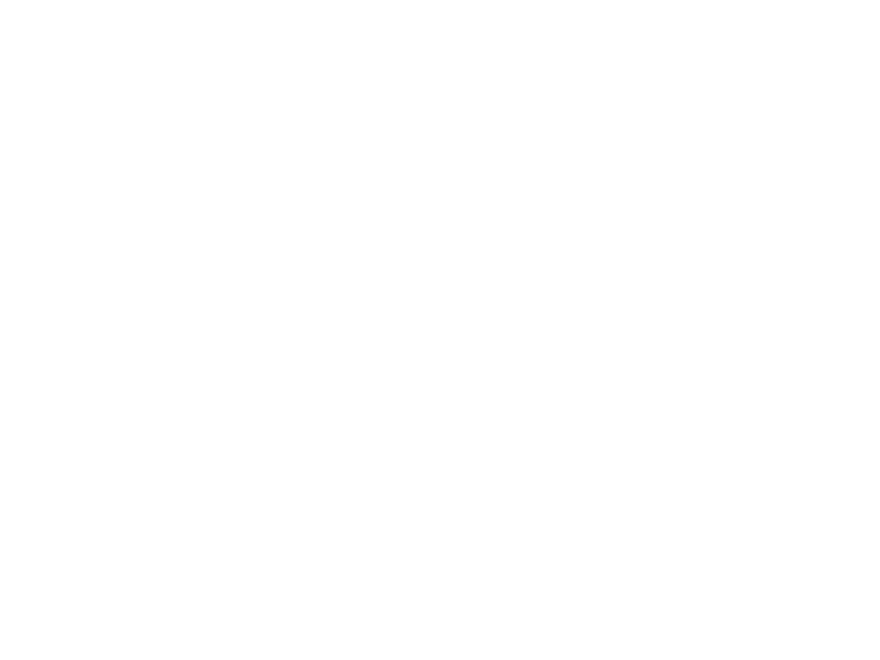

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0113.mp4

D:/HNSCC/HNSCC-01-0113\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


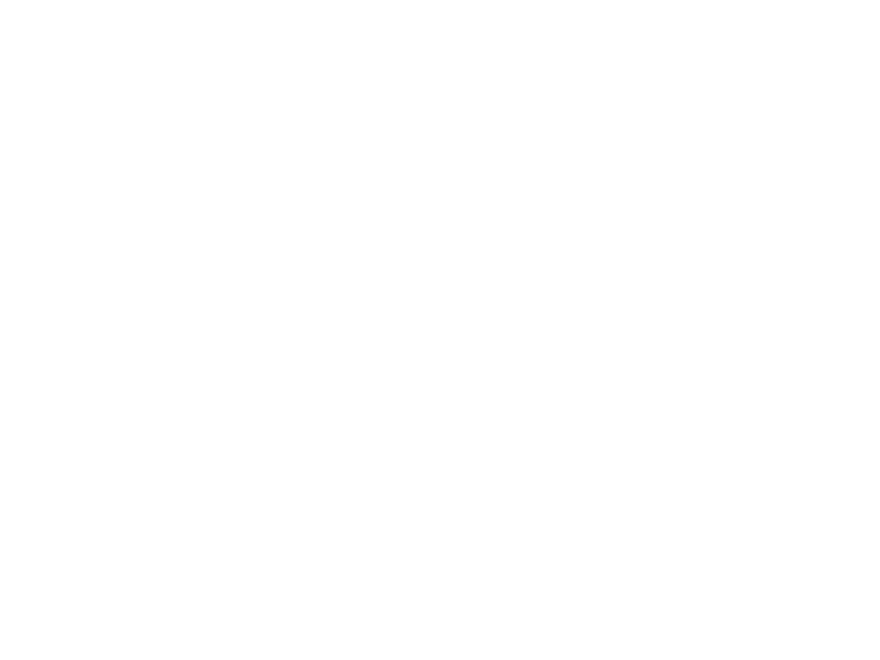

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0113.mp4

D:/HNSCC/HNSCC-01-0113\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


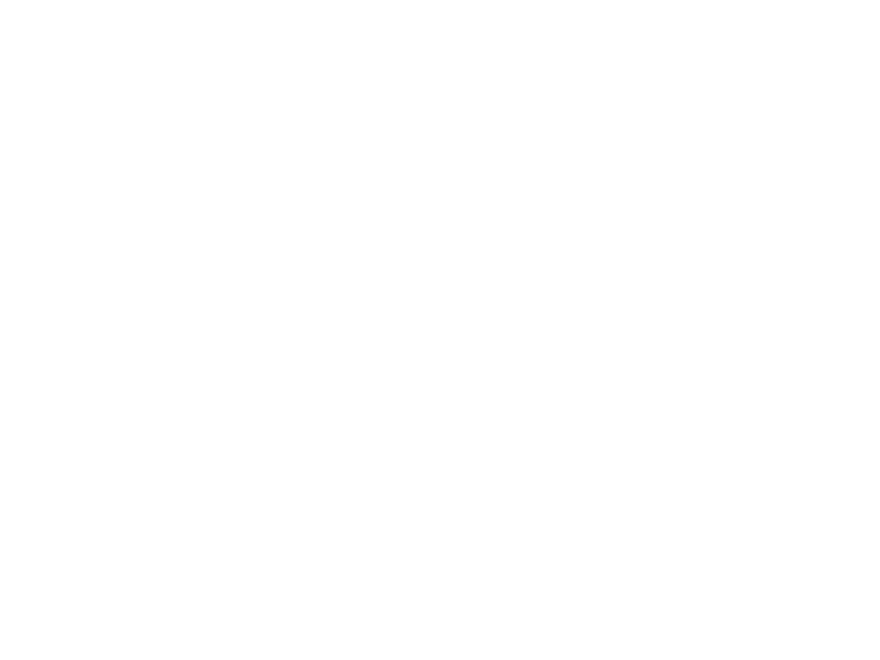

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0113.mp4

D:/HNSCC/HNSCC-01-0113\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


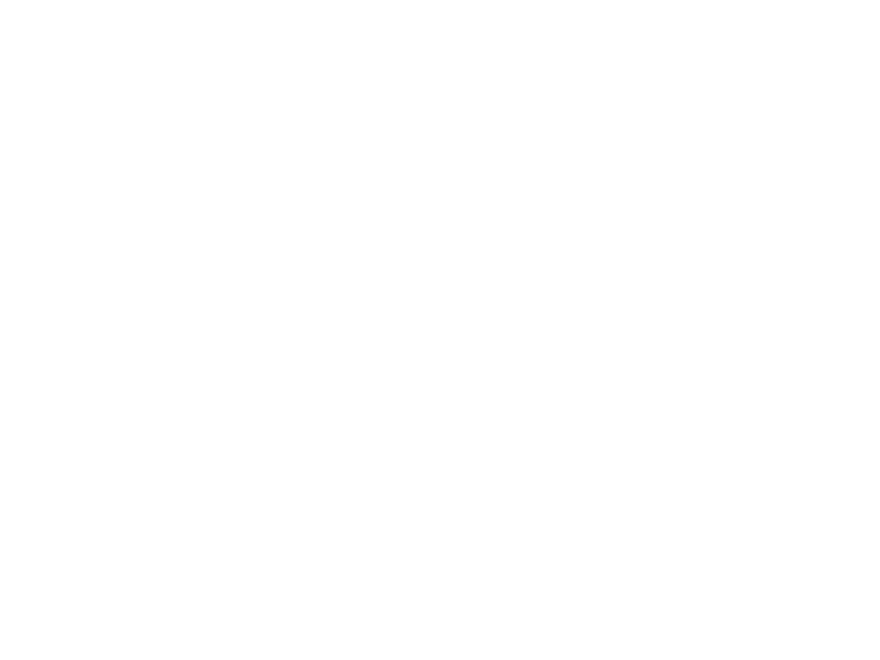

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0113.mp4

D:/HNSCC/HNSCC-01-0115\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


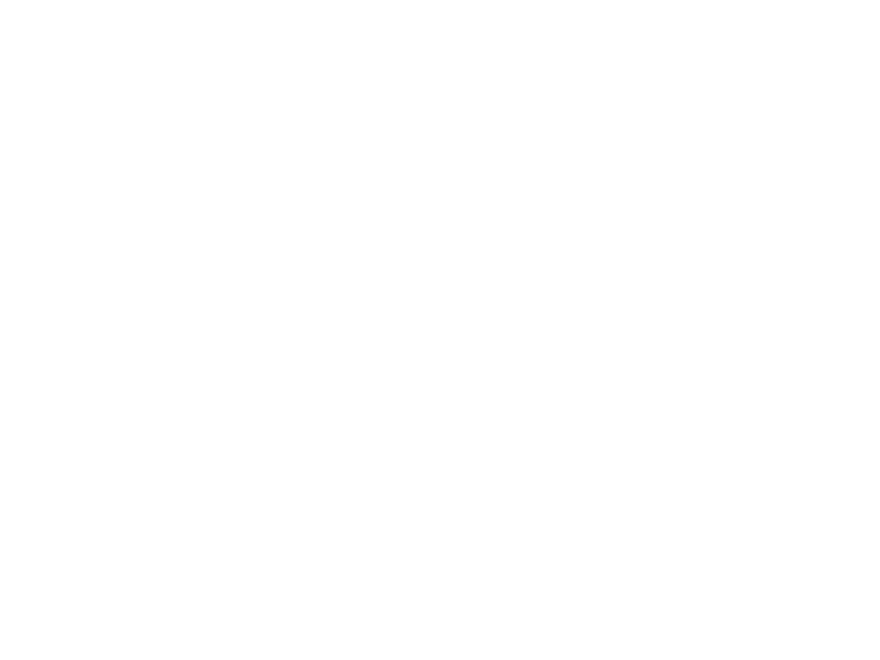

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0115.mp4

D:/HNSCC/HNSCC-01-0115\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


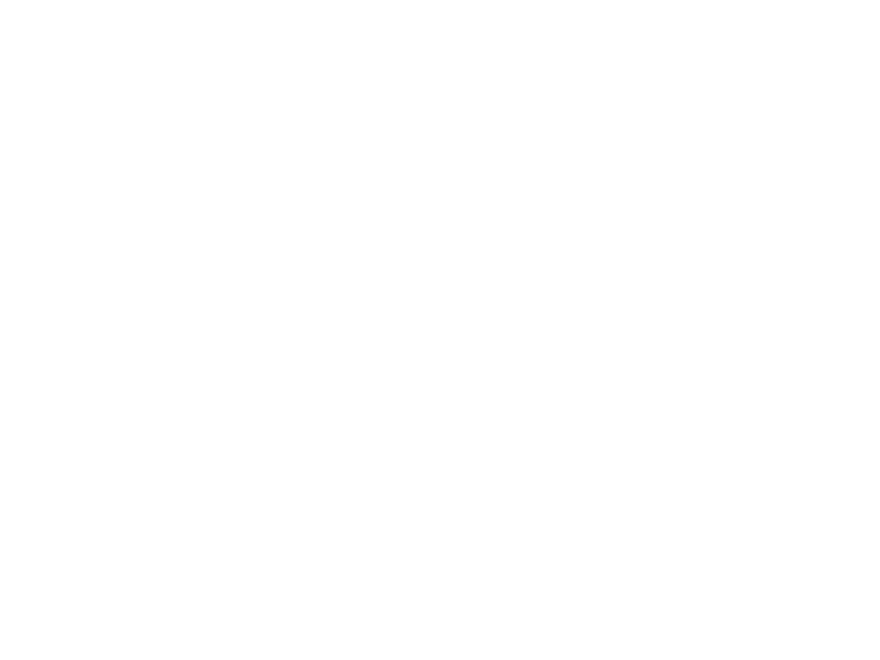

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0115.mp4

D:/HNSCC/HNSCC-01-0115\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


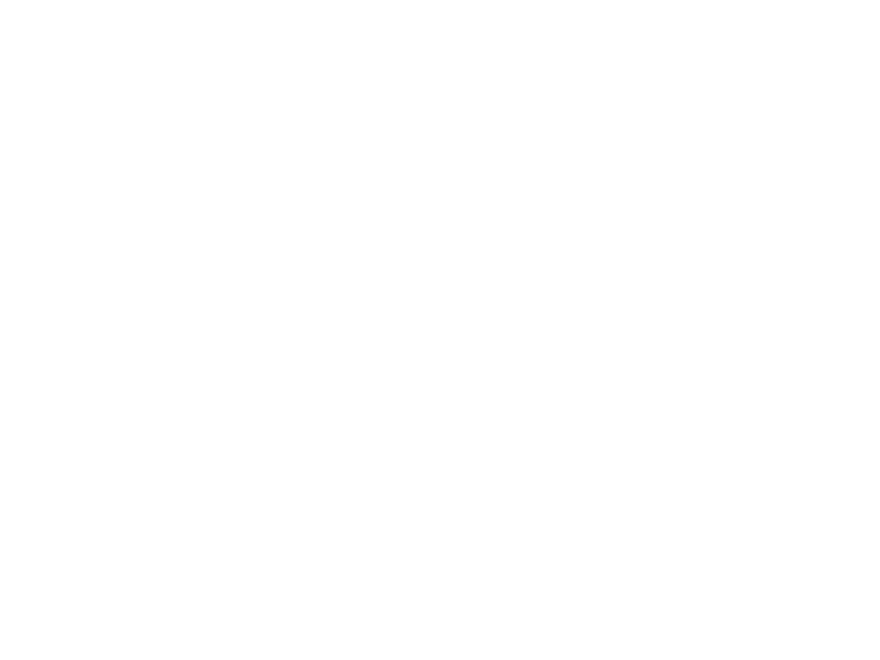

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0115.mp4

D:/HNSCC/HNSCC-01-0115\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0115\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0117\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


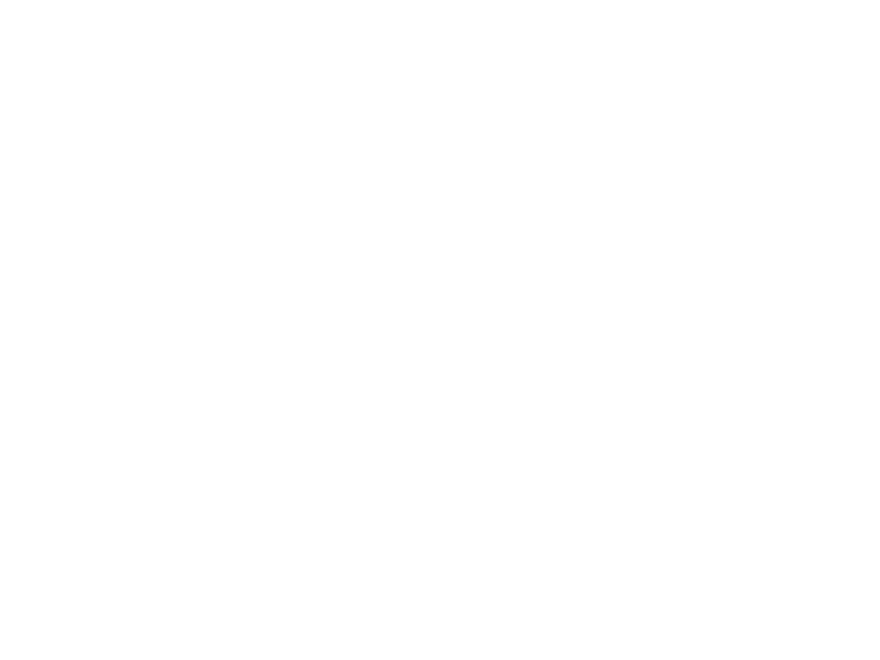

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0117.mp4

D:/HNSCC/HNSCC-01-0117\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


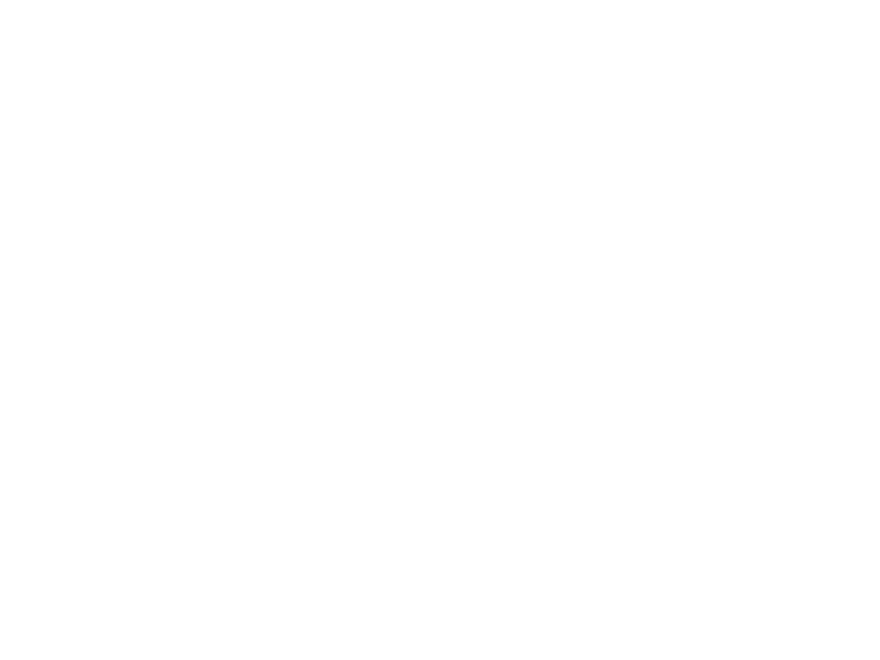

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0117.mp4

D:/HNSCC/HNSCC-01-0117\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


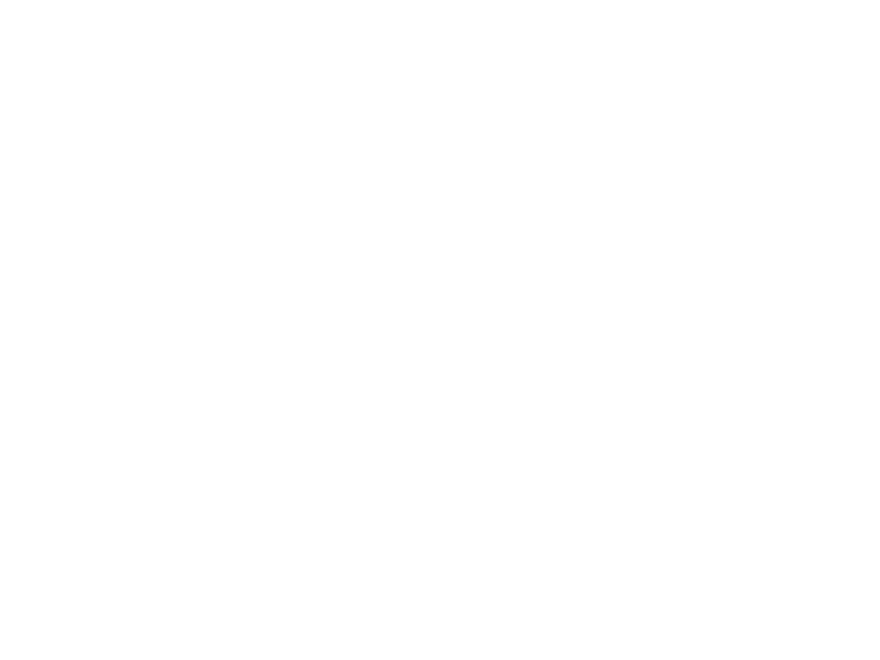

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0117.mp4

D:/HNSCC/HNSCC-01-0117\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0117\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0118\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


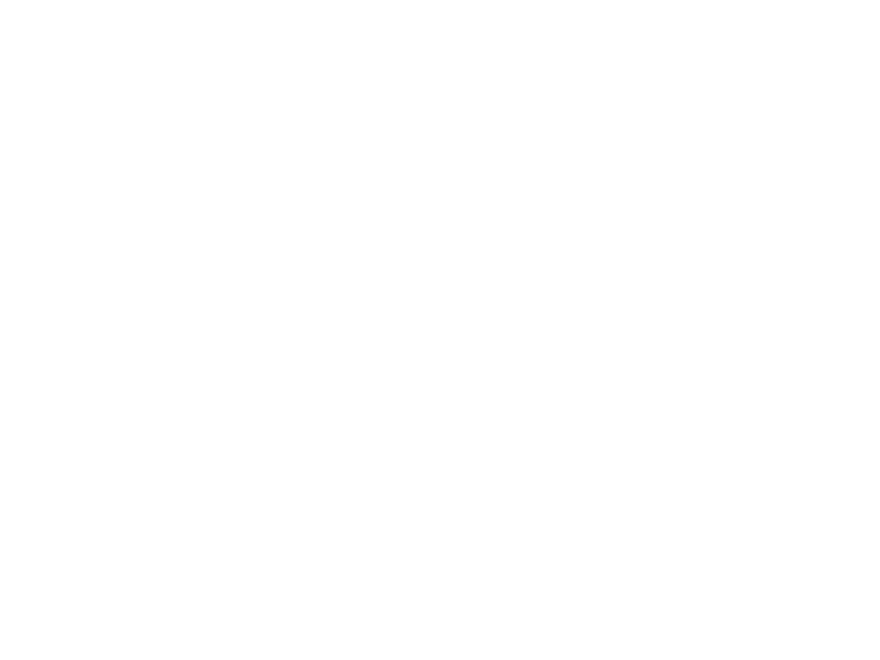

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0118.mp4

D:/HNSCC/HNSCC-01-0118\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


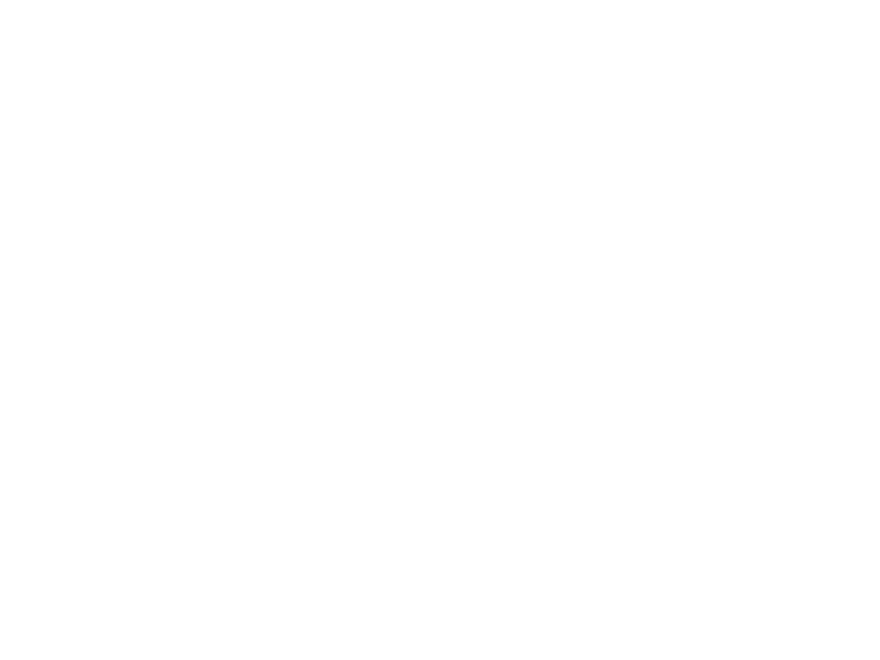

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0118.mp4

D:/HNSCC/HNSCC-01-0118\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


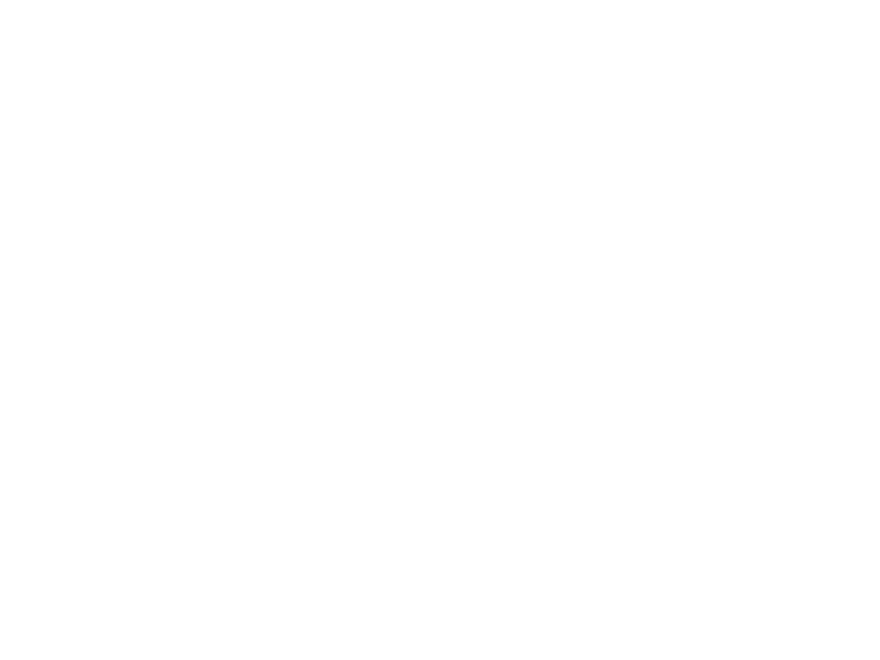

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0118.mp4

D:/HNSCC/HNSCC-01-0118\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0118\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0119\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


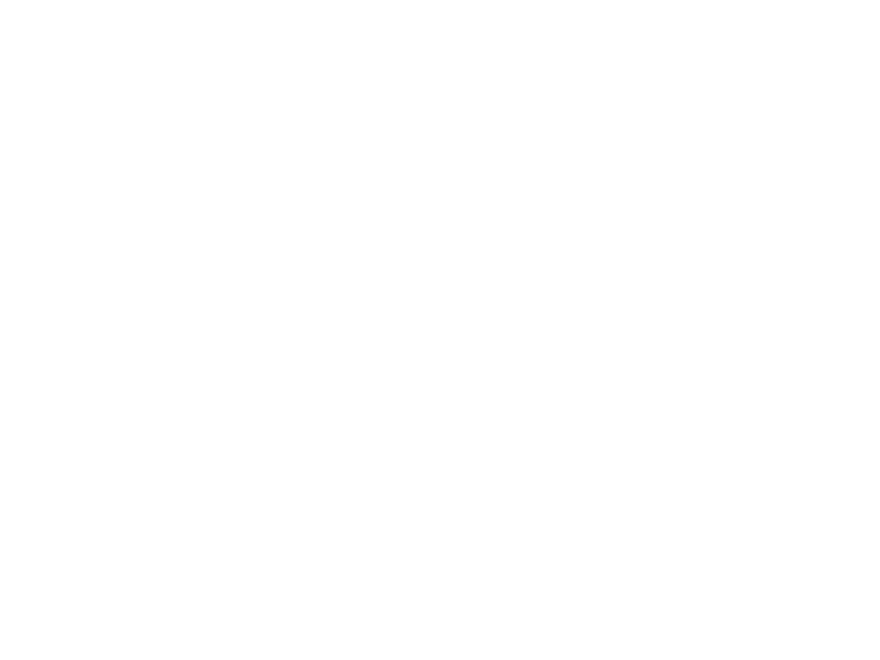

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0119.mp4

D:/HNSCC/HNSCC-01-0119\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


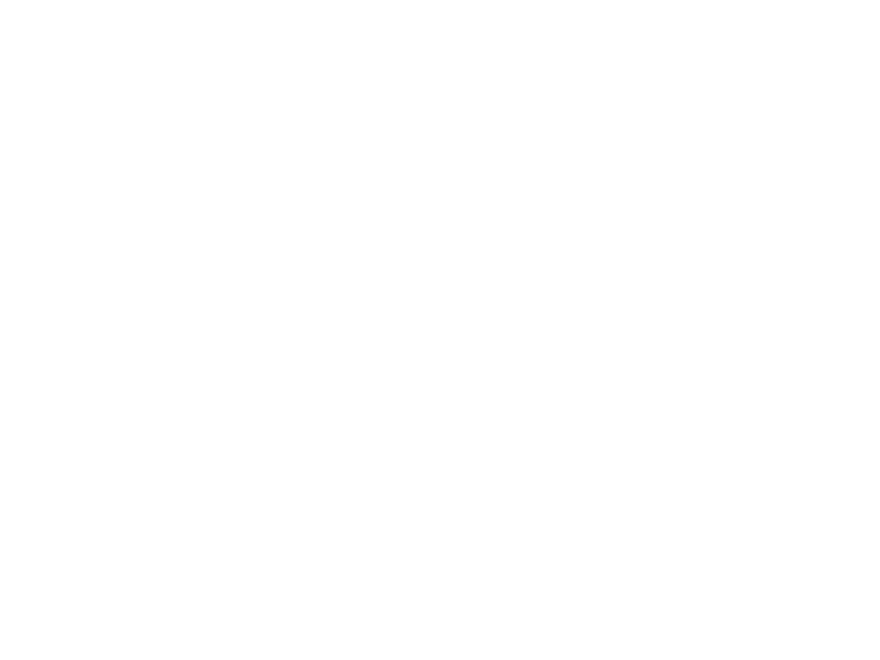

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0119.mp4

D:/HNSCC/HNSCC-01-0119\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


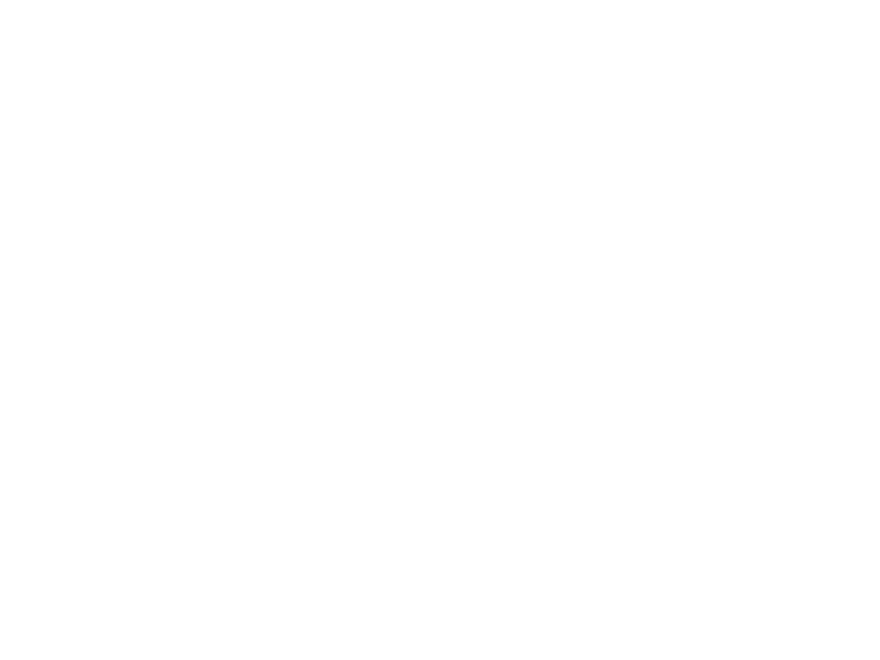

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0119.mp4

D:/HNSCC/HNSCC-01-0119\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


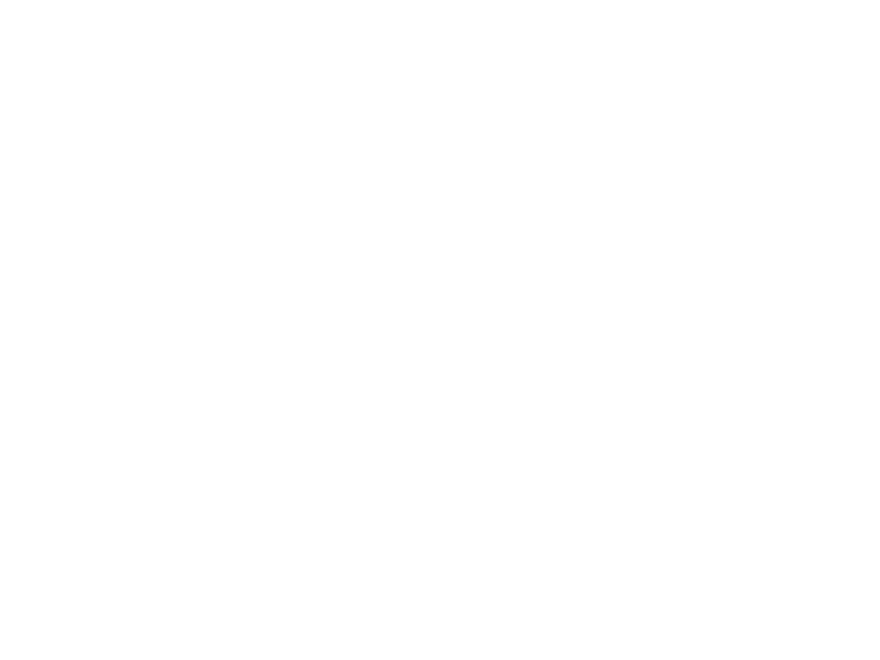

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0119.mp4

D:/HNSCC/HNSCC-01-0119\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


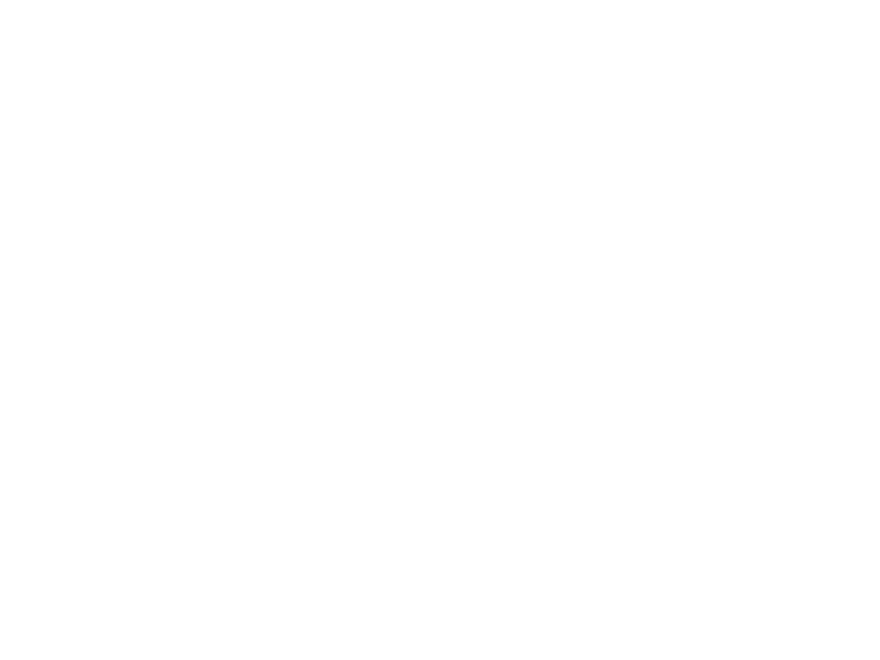

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0119.mp4

D:/HNSCC/HNSCC-01-0120\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


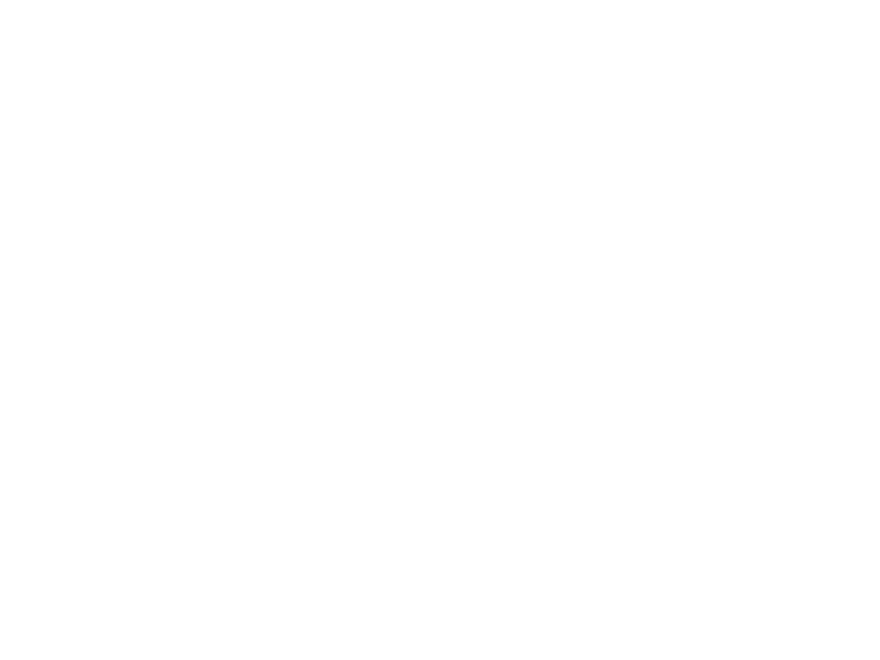

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0120.mp4

D:/HNSCC/HNSCC-01-0120\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


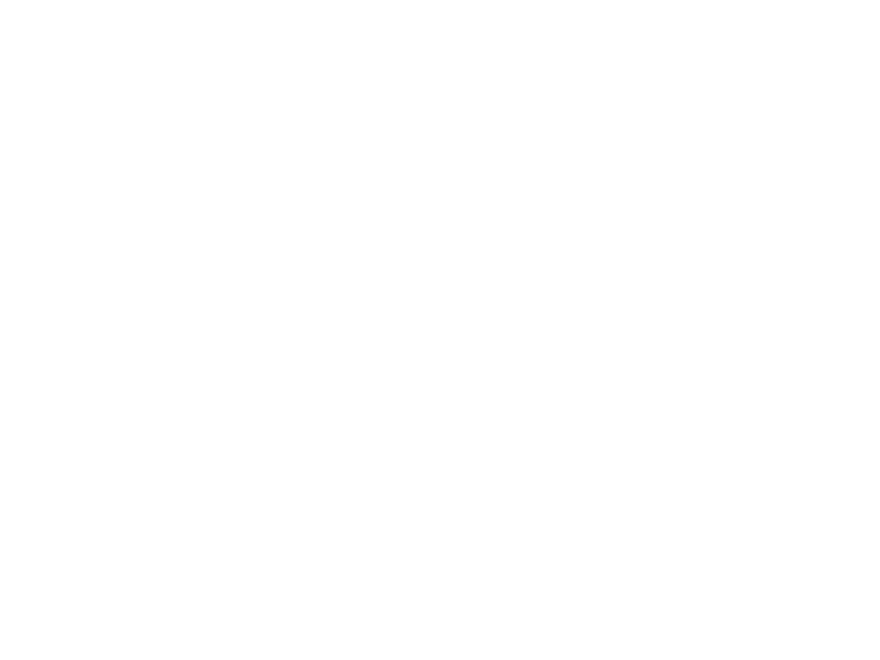

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0120.mp4

D:/HNSCC/HNSCC-01-0120\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


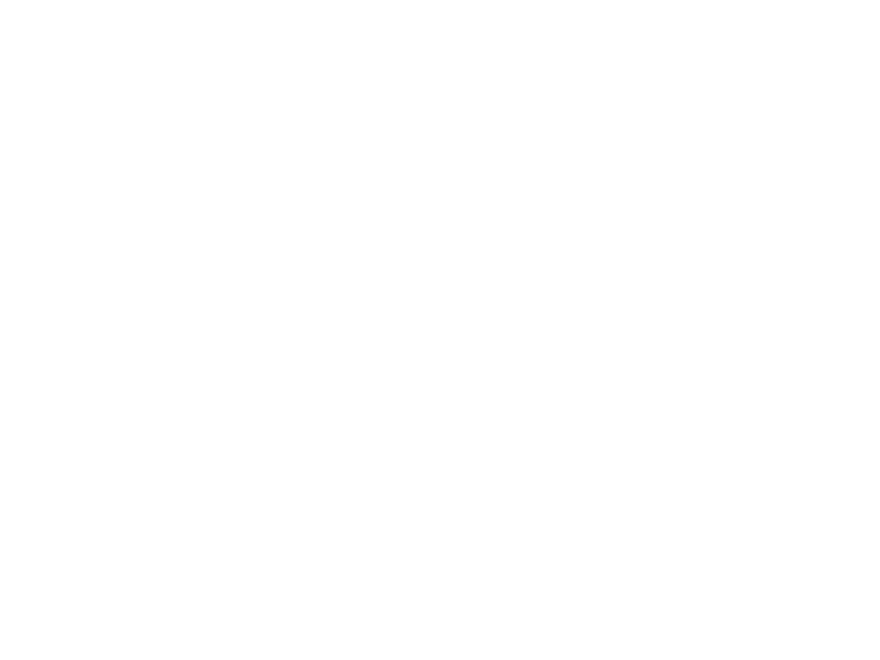

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0120.mp4

D:/HNSCC/HNSCC-01-0120\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0120\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0121\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


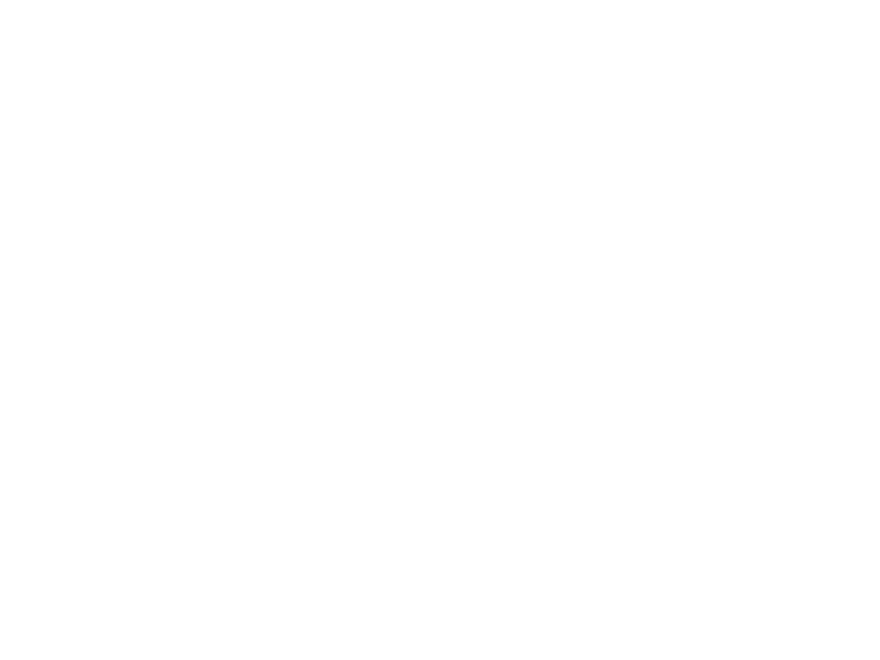

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0121.mp4

D:/HNSCC/HNSCC-01-0121\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


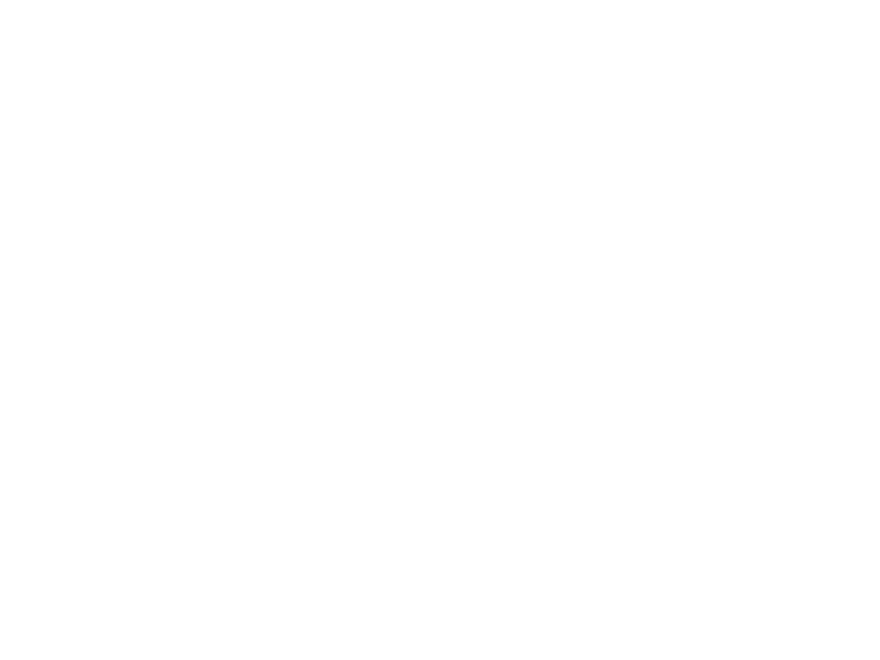

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0121.mp4

D:/HNSCC/HNSCC-01-0121\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


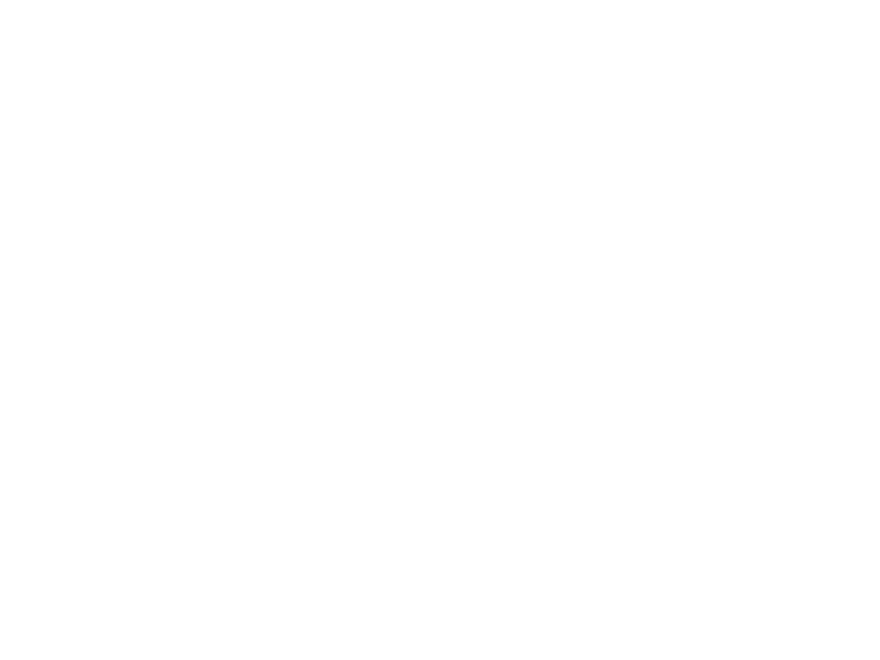

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0121.mp4

D:/HNSCC/HNSCC-01-0121\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


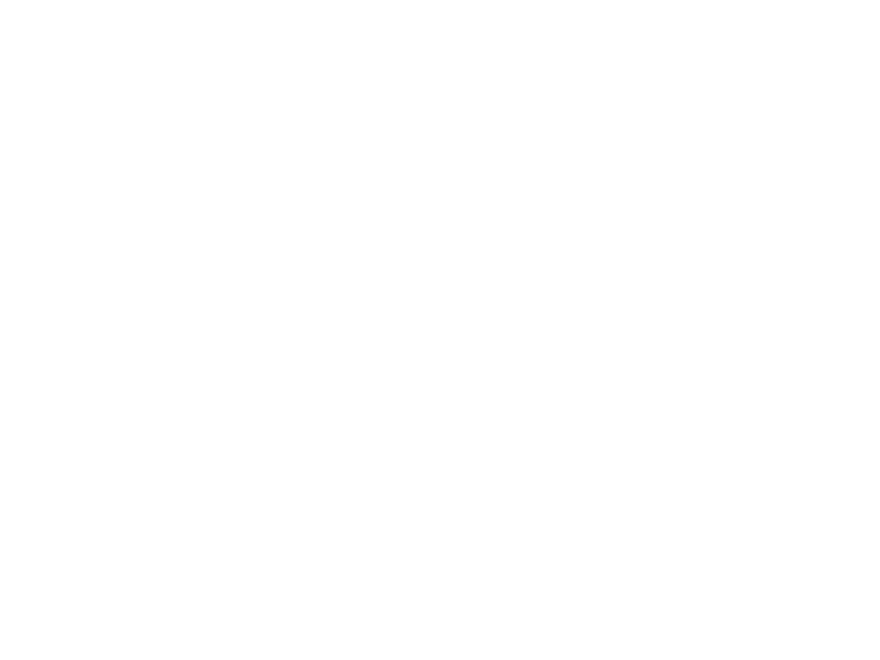

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0121.mp4

D:/HNSCC/HNSCC-01-0121\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


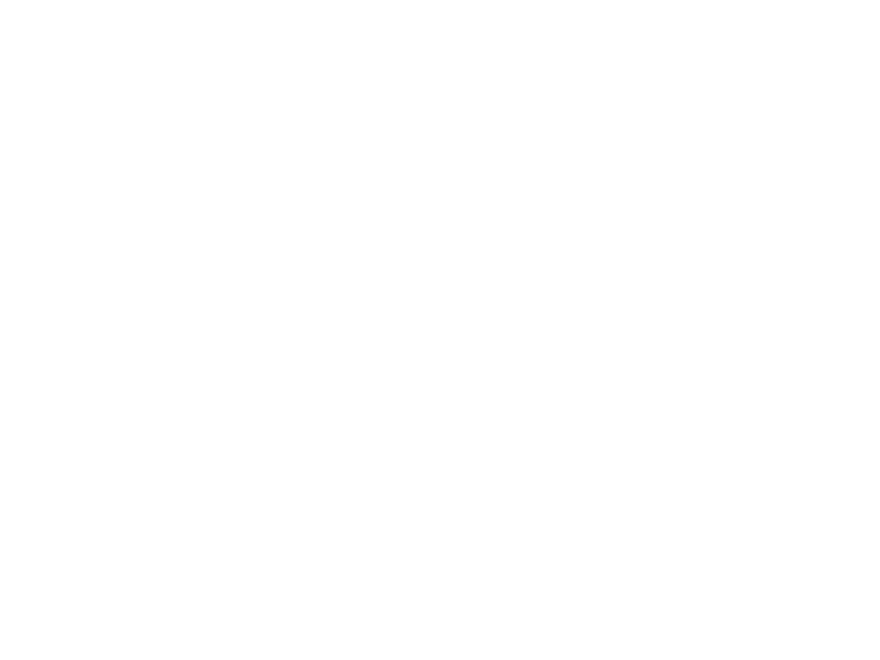

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0121.mp4

D:/HNSCC/HNSCC-01-0122\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


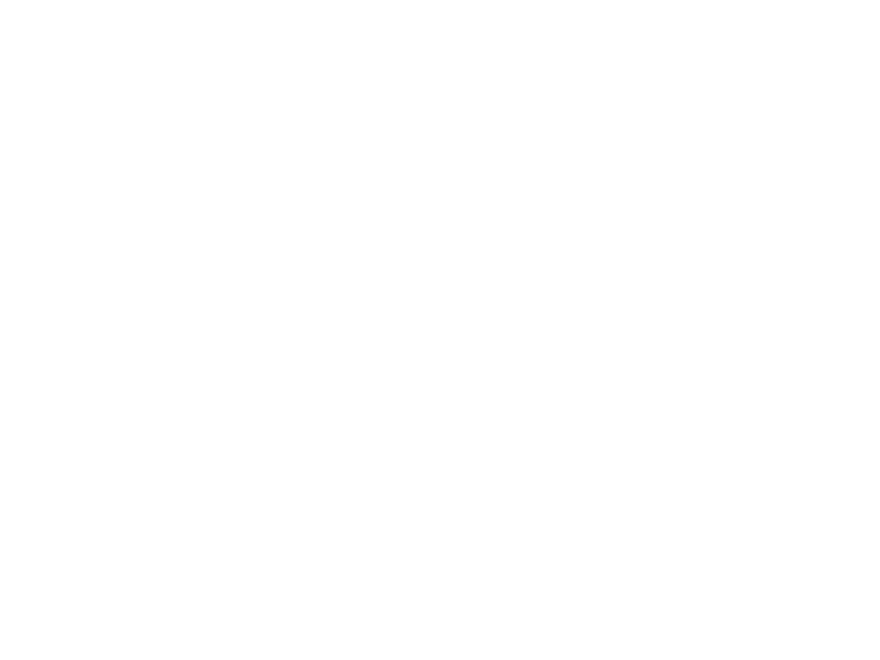

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0122.mp4

D:/HNSCC/HNSCC-01-0122\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


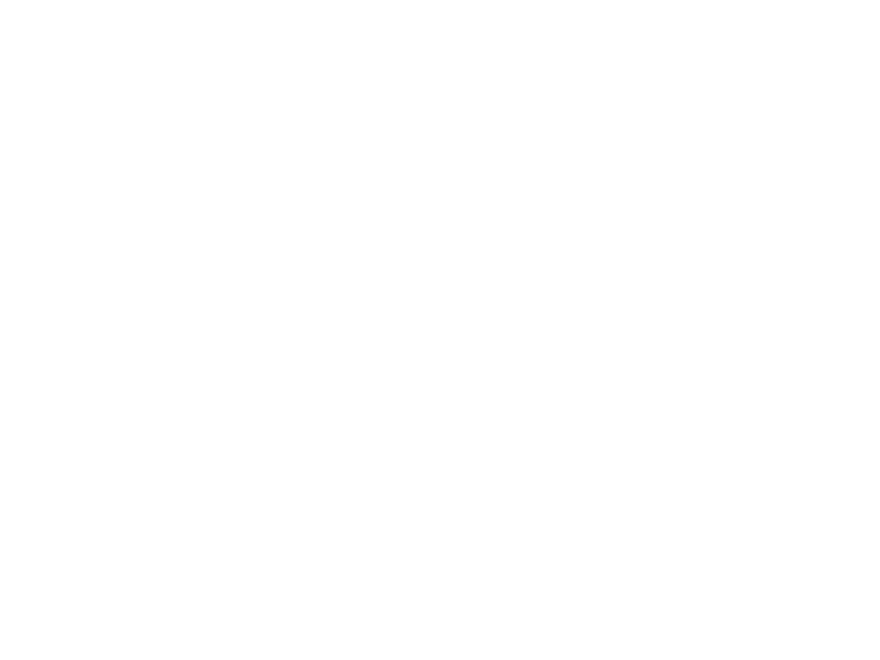

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0122.mp4

D:/HNSCC/HNSCC-01-0122\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


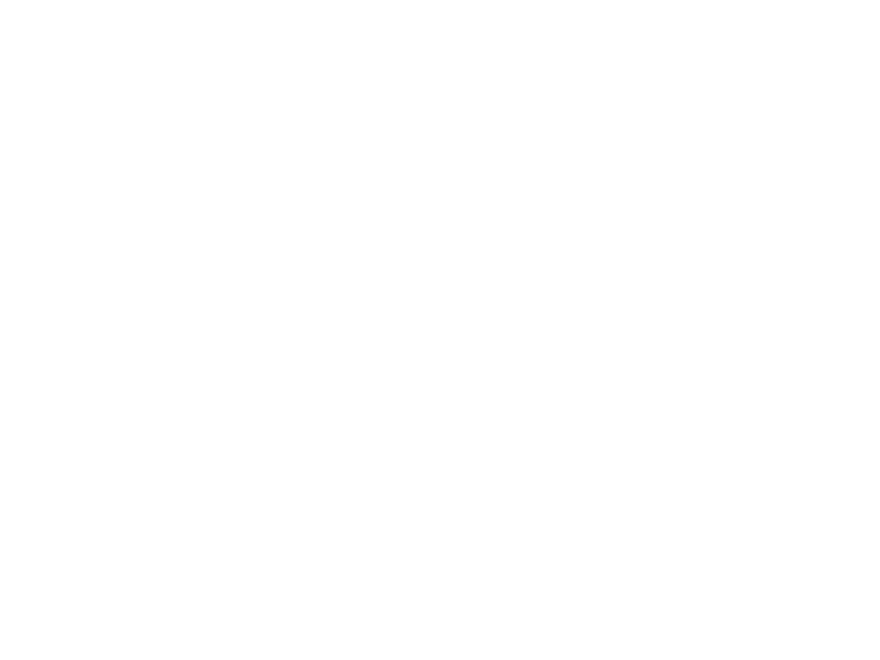

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0122.mp4

D:/HNSCC/HNSCC-01-0122\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


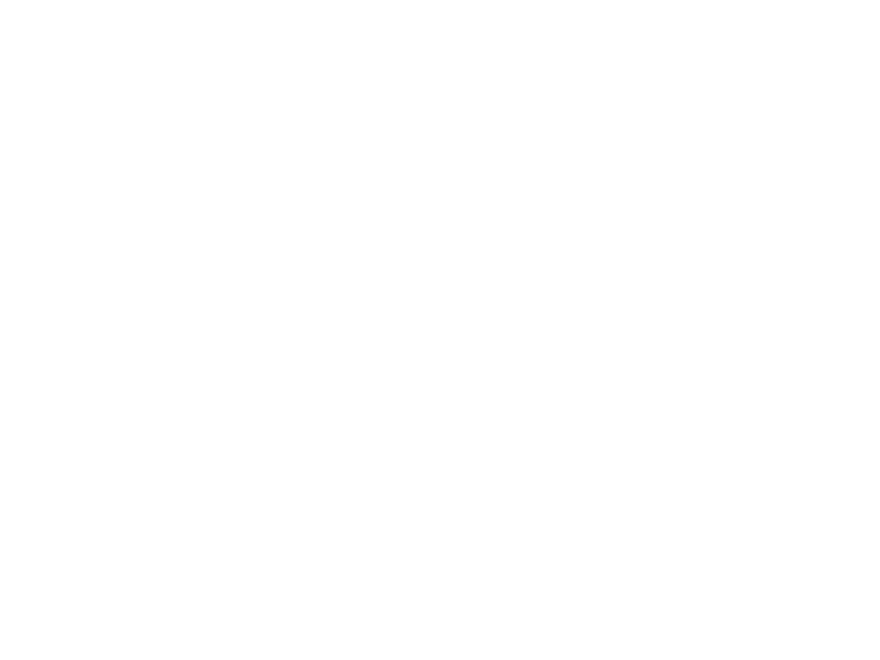

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0122.mp4

D:/HNSCC/HNSCC-01-0122\
Thickness 1: 2.430
Thickness 2: 3.000
Thickness 3: 2.430
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


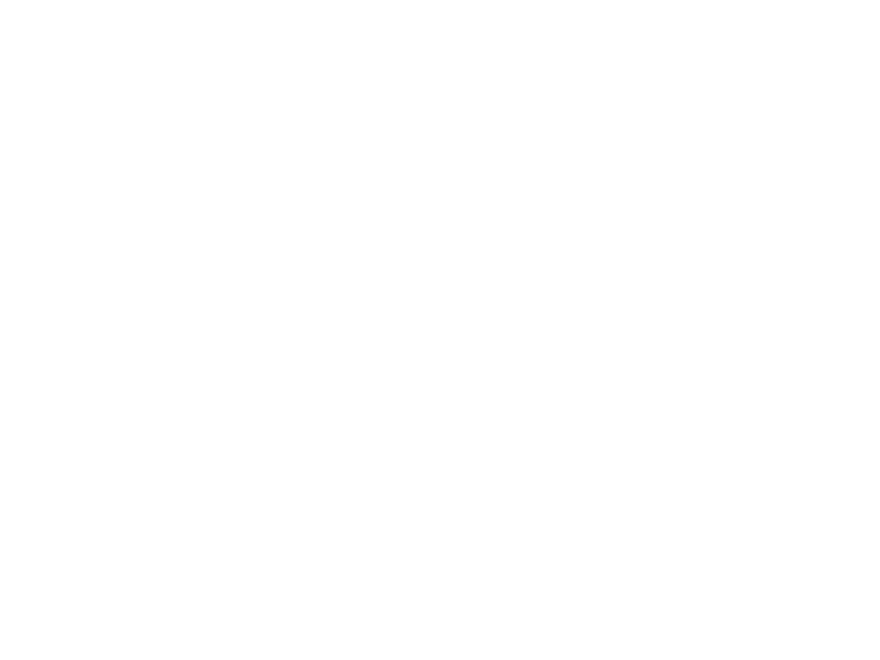

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0122.mp4

D:/HNSCC/HNSCC-01-0123\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


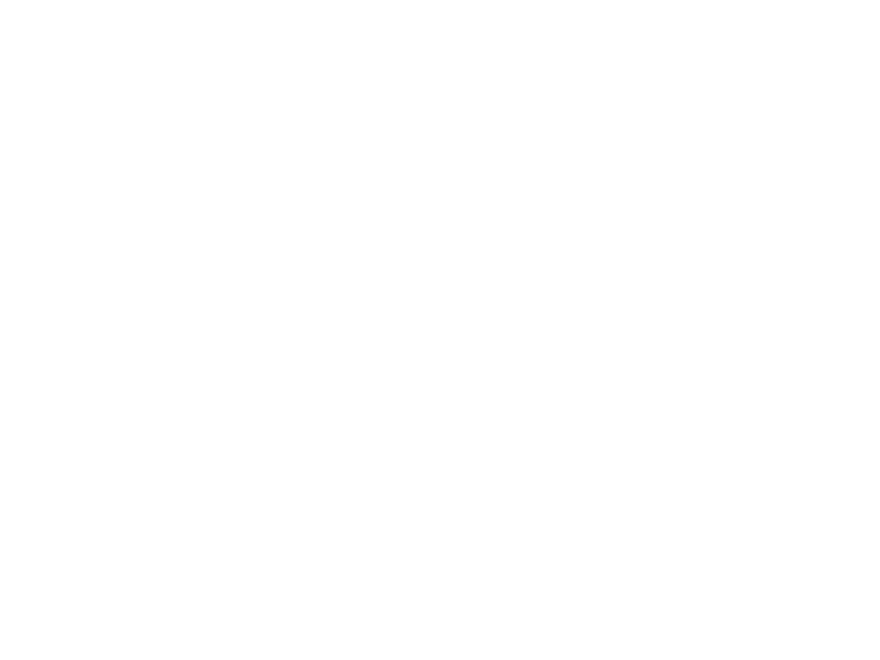

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0123.mp4

D:/HNSCC/HNSCC-01-0123\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


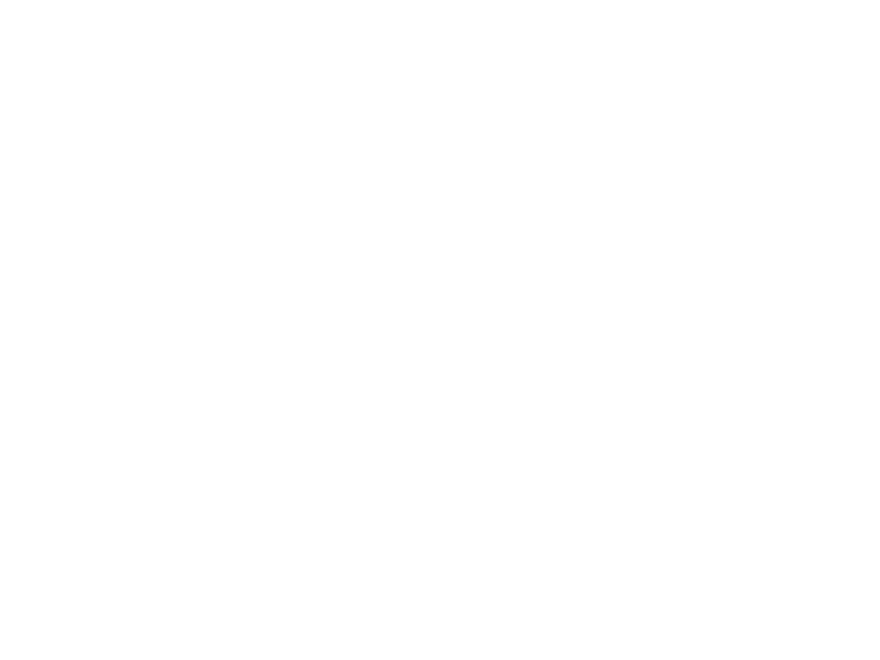

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0123.mp4

D:/HNSCC/HNSCC-01-0123\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


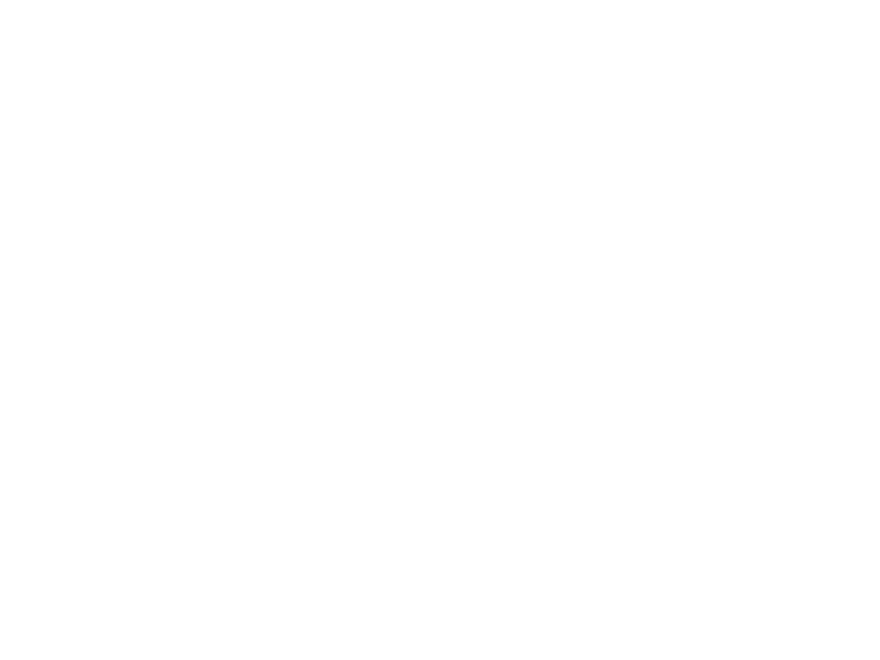

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0123.mp4

D:/HNSCC/HNSCC-01-0123\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


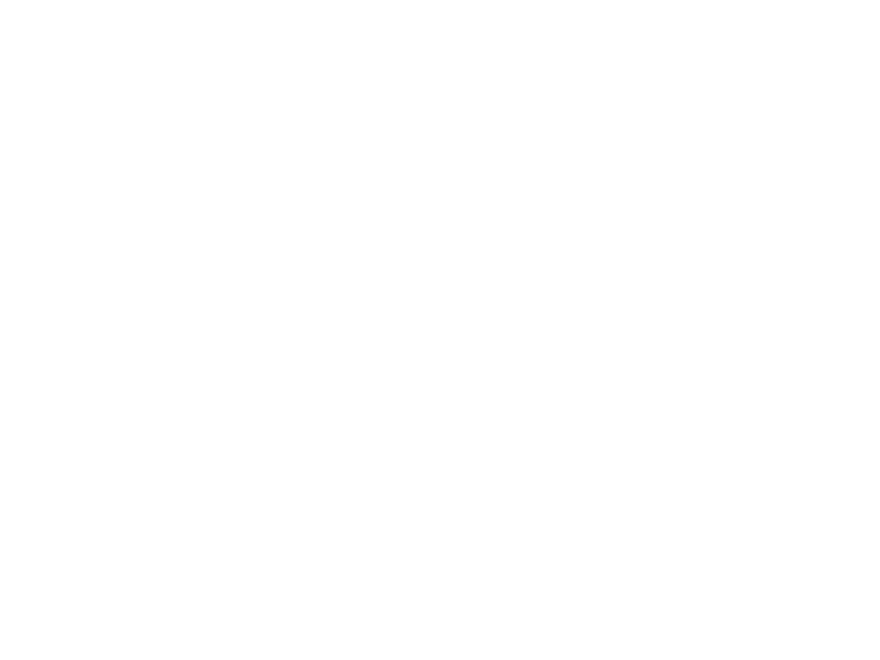

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0123.mp4

D:/HNSCC/HNSCC-01-0123\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


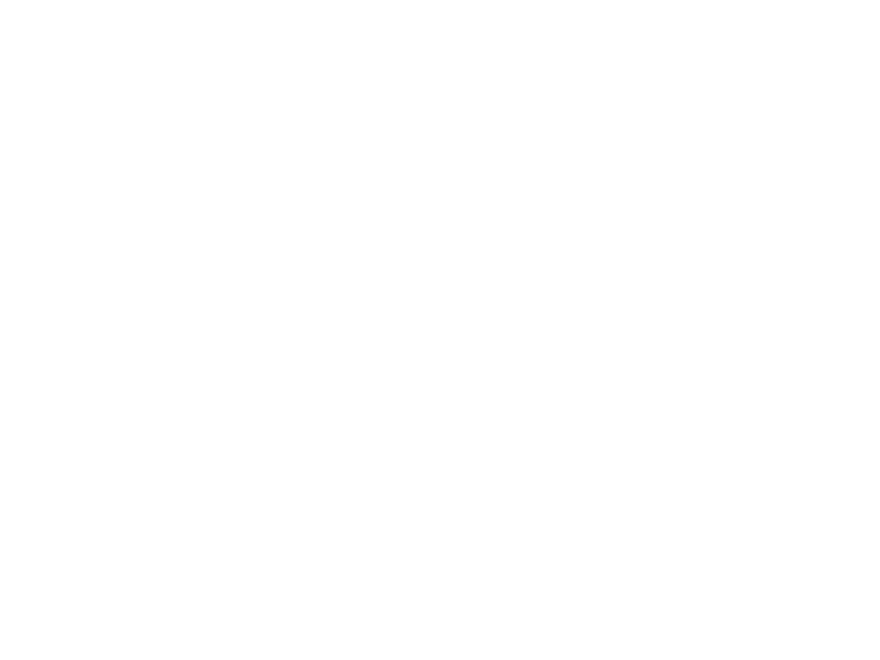

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0123.mp4

D:/HNSCC/HNSCC-01-0124\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0124\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0124\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0124\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0124\
Thickness 1: 3.000
Thickness 2: 3.000
Number of slices: 0
Required:45
1

D:/HNSCC/HNSCC-01-0125\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


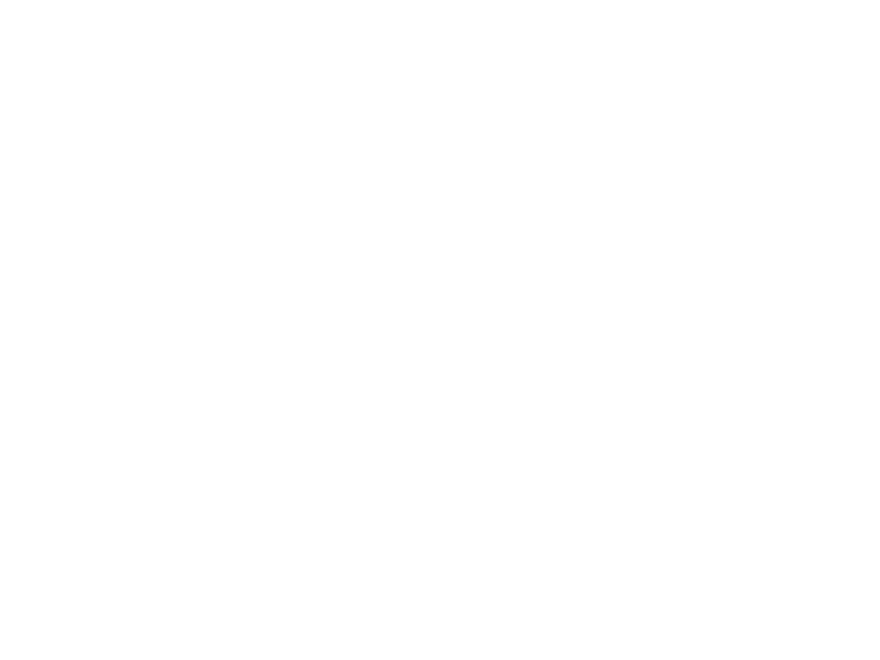

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0125.mp4

D:/HNSCC/HNSCC-01-0125\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


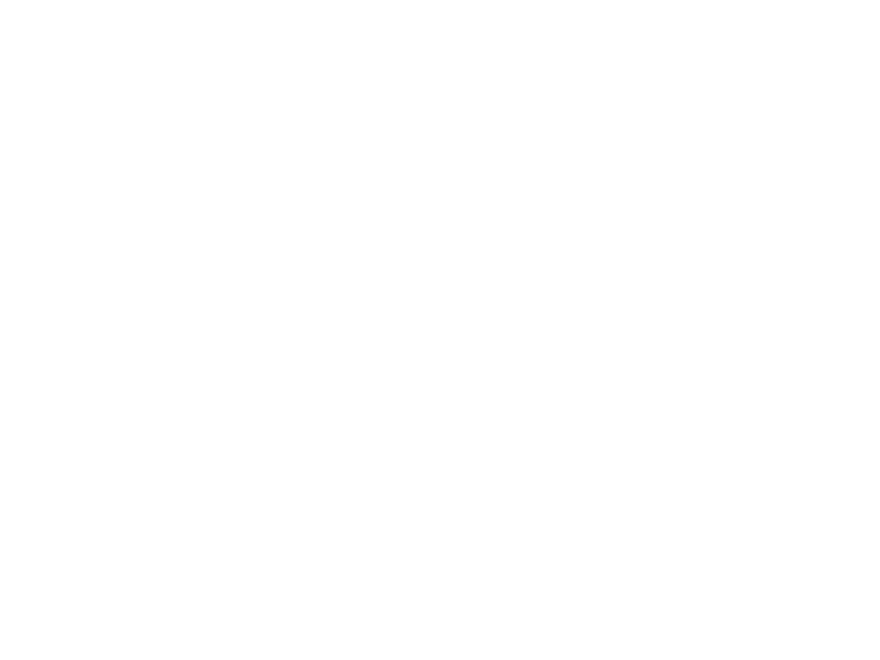

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0125.mp4

D:/HNSCC/HNSCC-01-0125\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


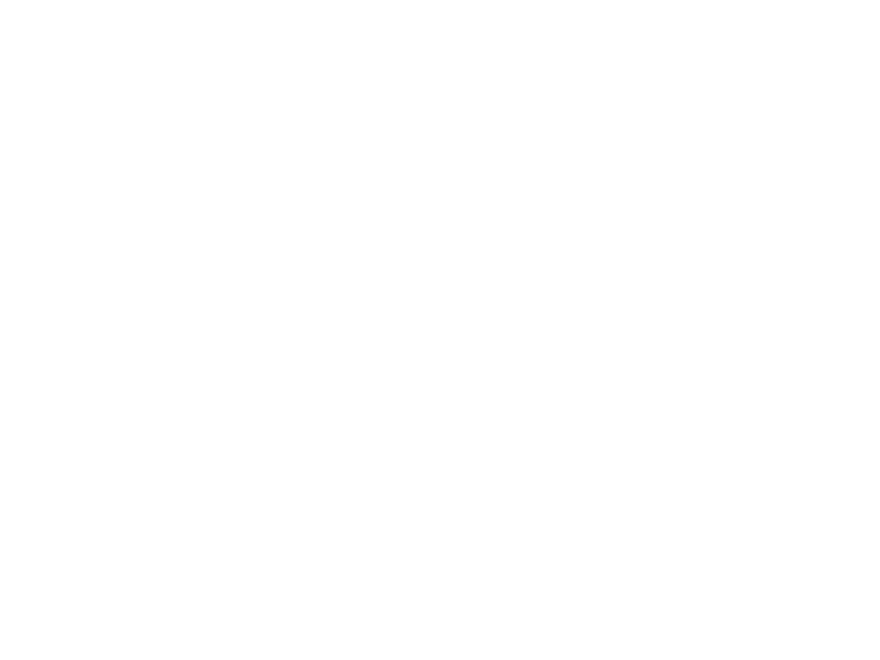

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0125.mp4

D:/HNSCC/HNSCC-01-0125\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


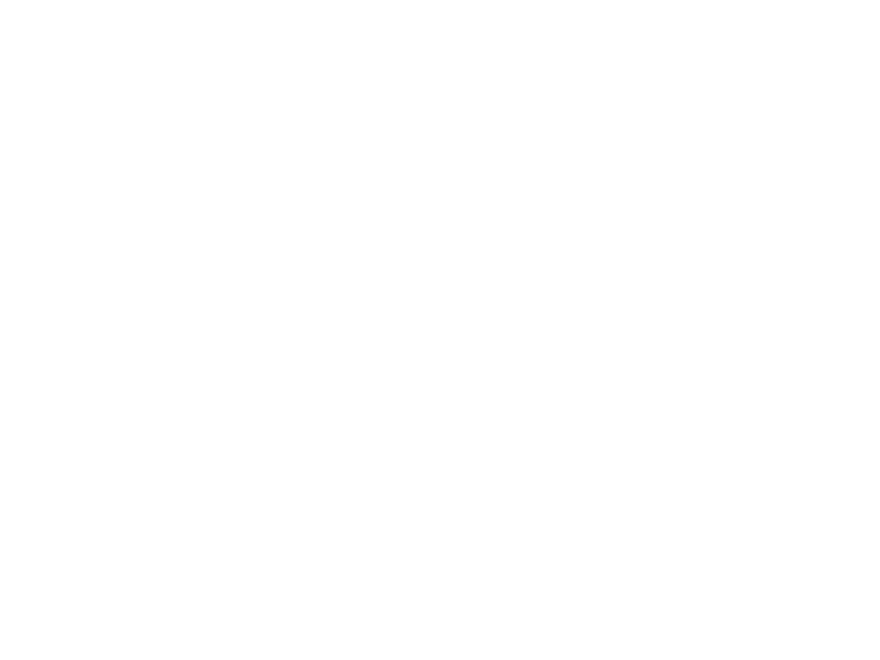

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0125.mp4

D:/HNSCC/HNSCC-01-0125\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


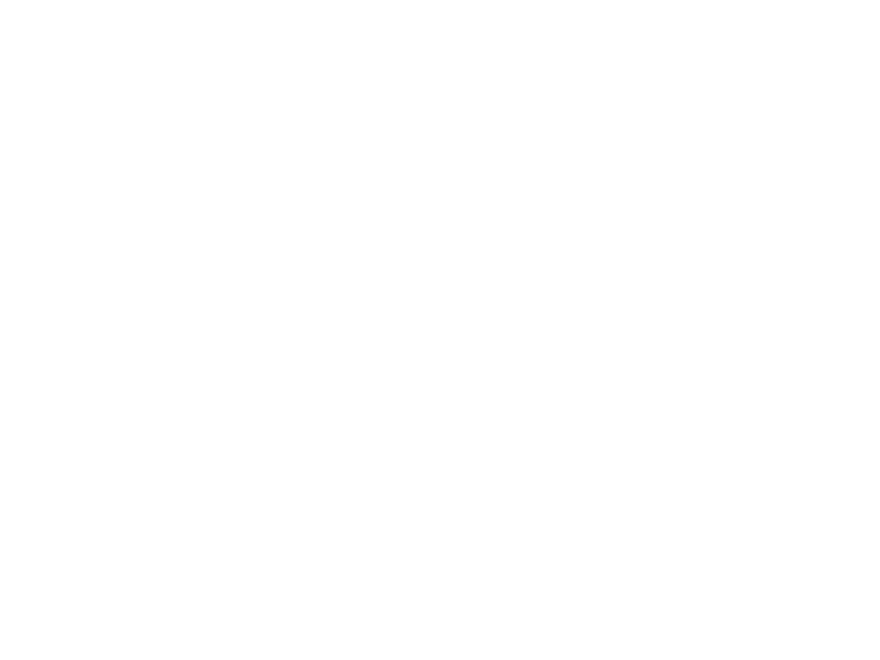

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0125.mp4

D:/HNSCC/HNSCC-01-0126\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


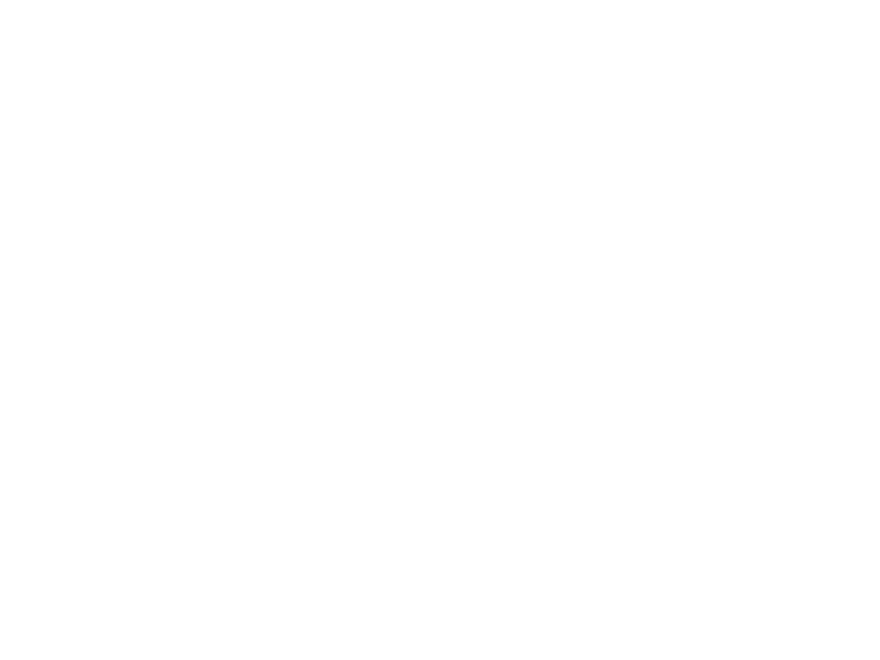

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0126.mp4

D:/HNSCC/HNSCC-01-0126\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


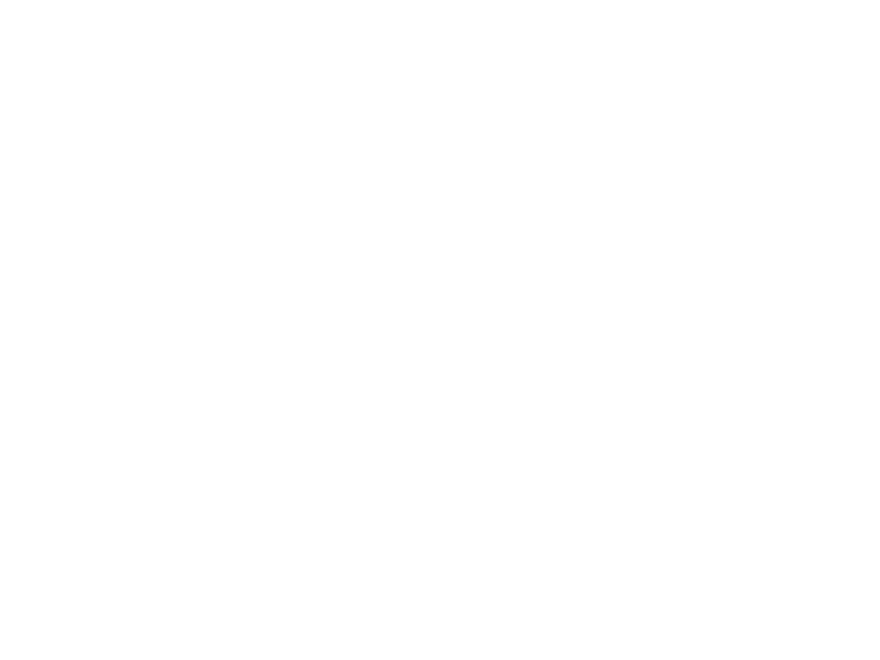

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0126.mp4

D:/HNSCC/HNSCC-01-0126\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


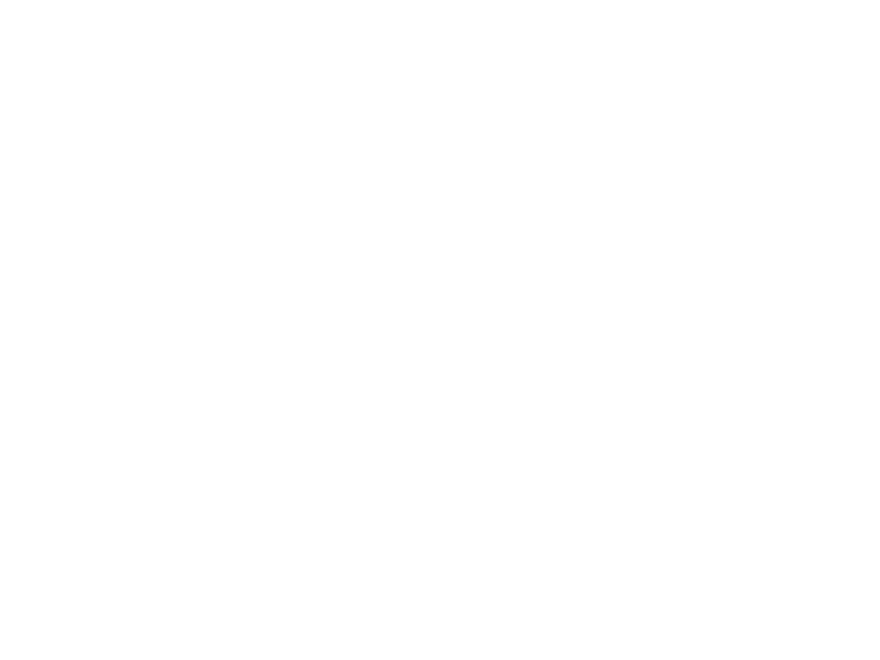

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0126.mp4

D:/HNSCC/HNSCC-01-0126\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0126\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0127\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


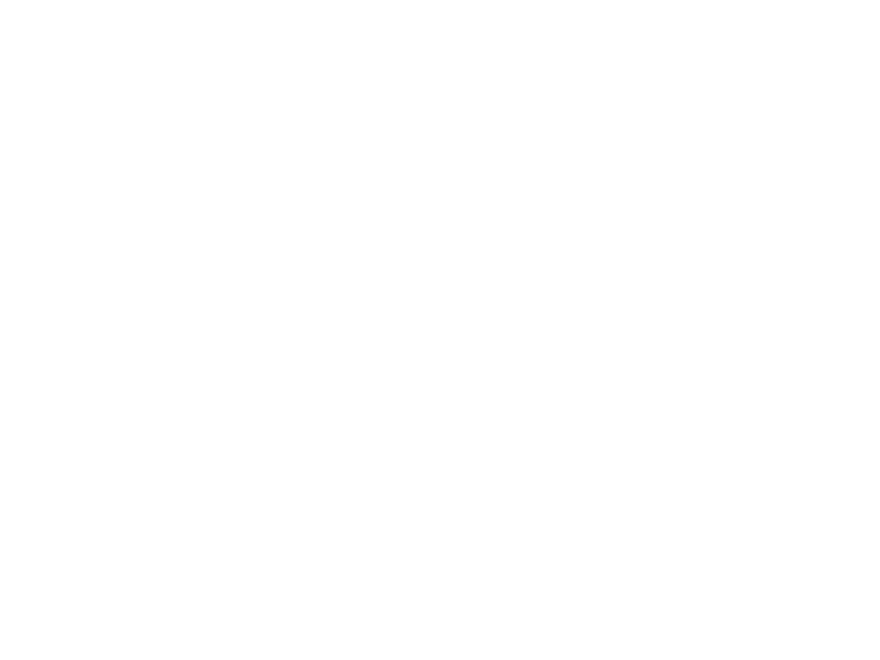

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0127.mp4

D:/HNSCC/HNSCC-01-0127\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


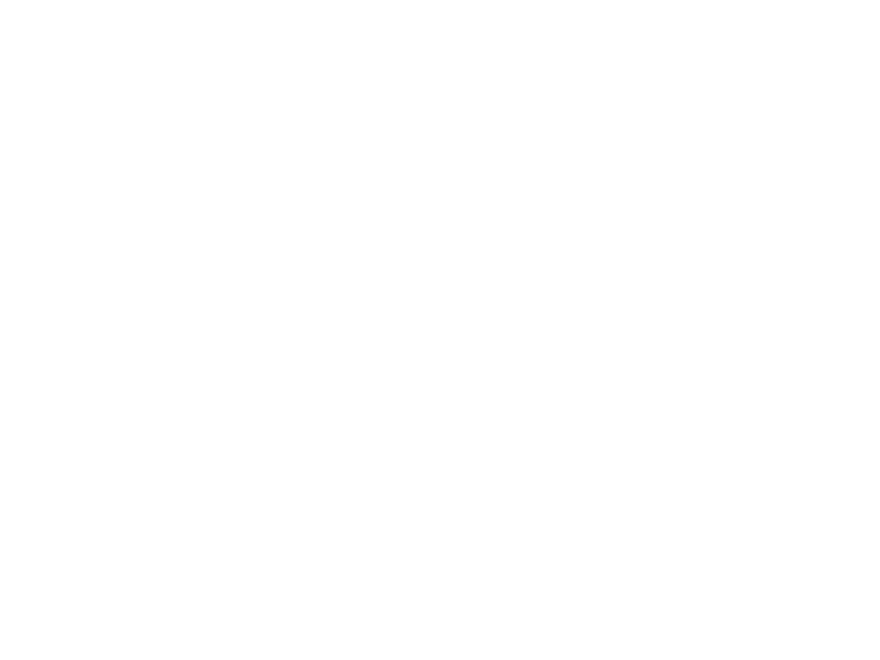

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0127.mp4

D:/HNSCC/HNSCC-01-0127\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


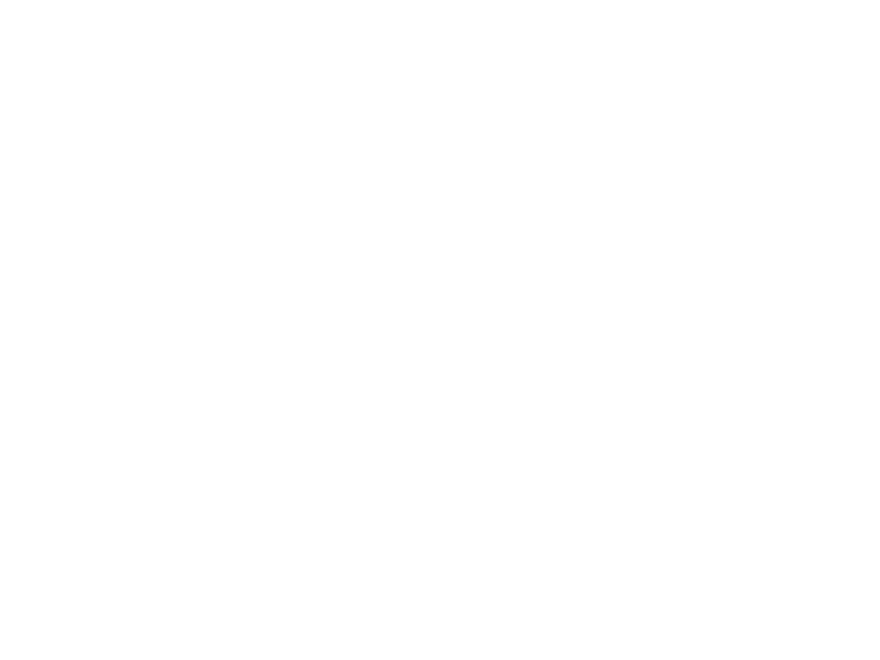

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0127.mp4

D:/HNSCC/HNSCC-01-0127\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0127\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0128\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


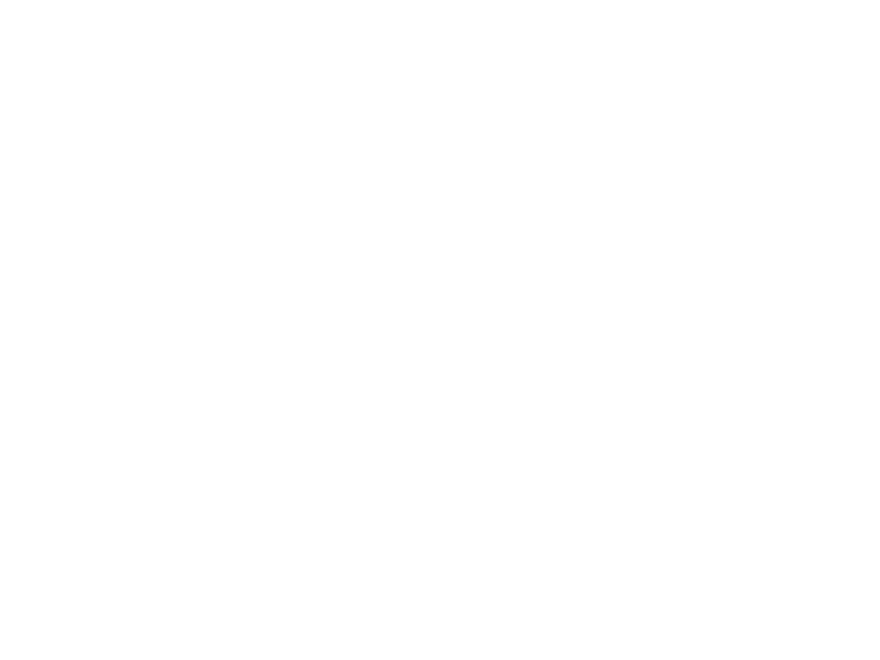

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0128.mp4

D:/HNSCC/HNSCC-01-0128\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


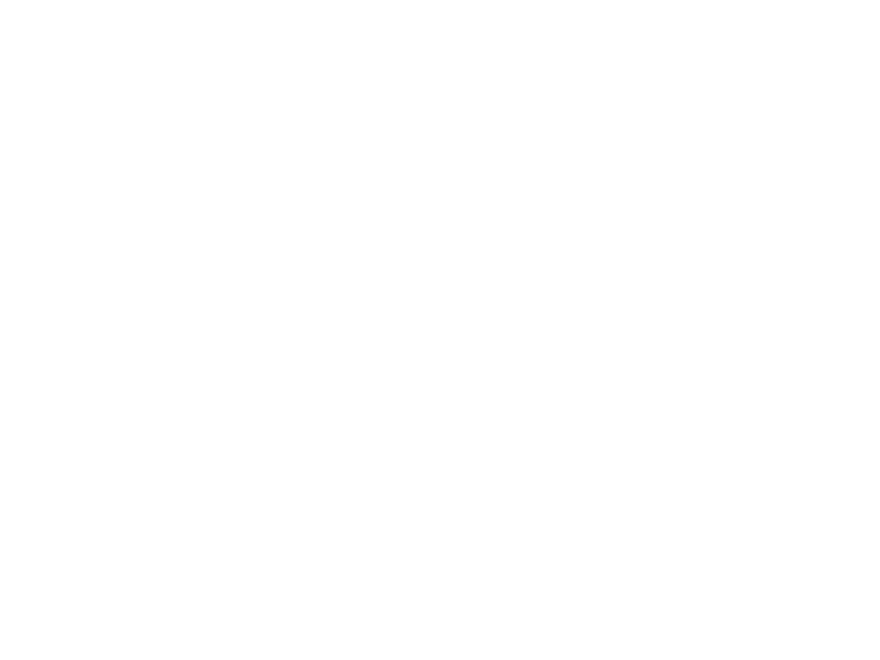

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0128.mp4

D:/HNSCC/HNSCC-01-0128\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


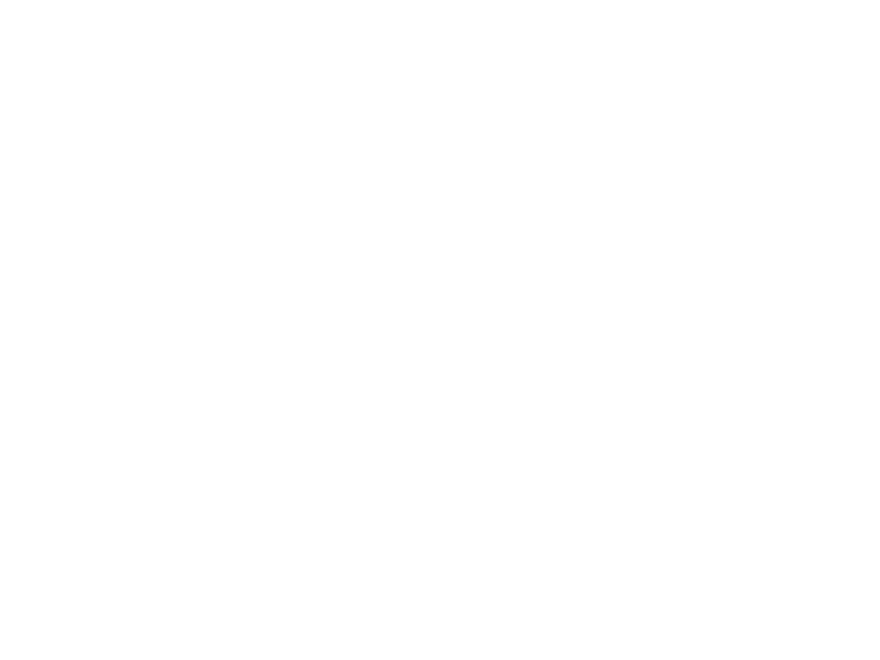

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0128.mp4

D:/HNSCC/HNSCC-01-0128\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


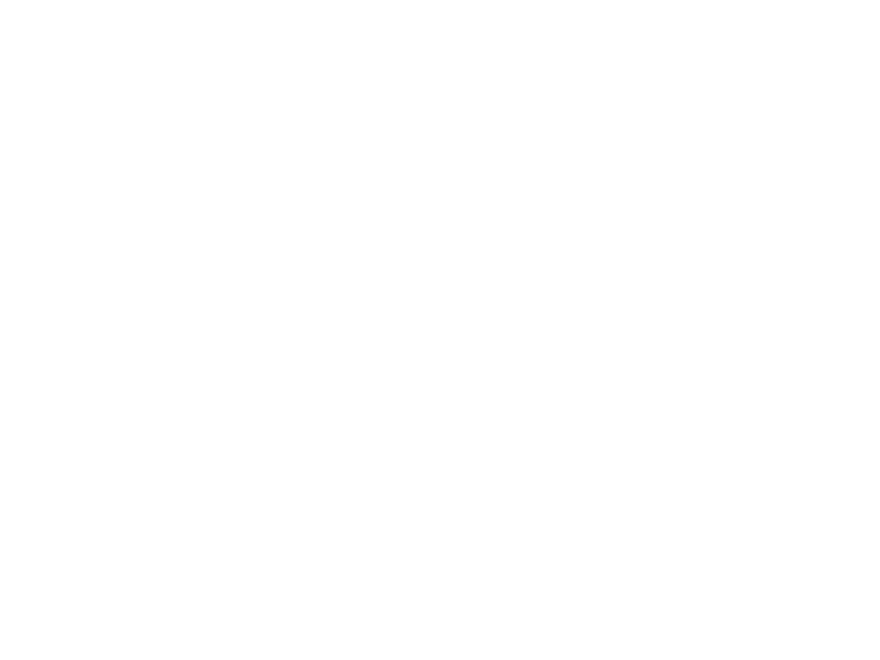

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0128.mp4

D:/HNSCC/HNSCC-01-0128\
Thickness 1: 2.560
Thickness 2: 3.000
Thickness 3: 2.560
check 3: 2.750
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


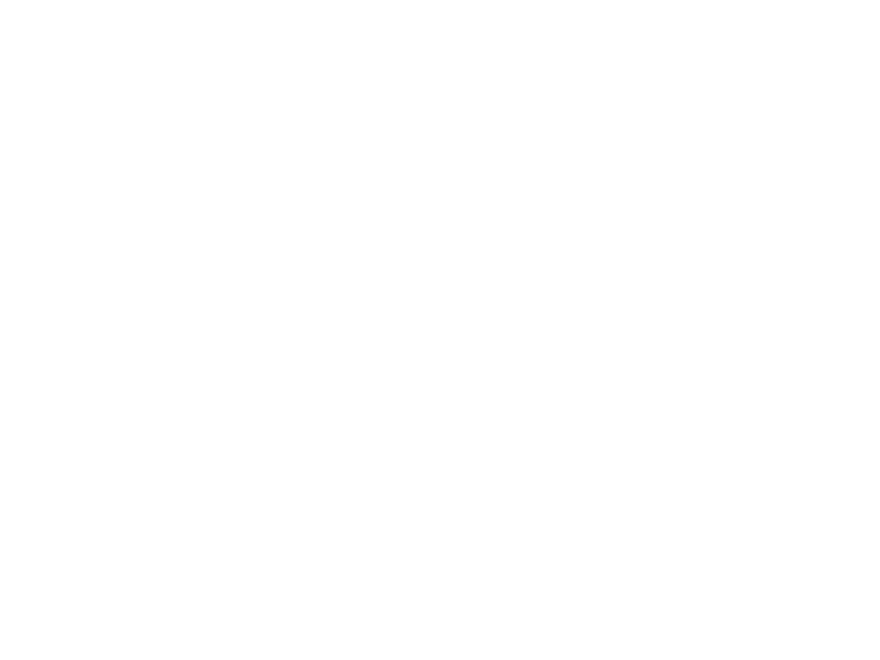

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0128.mp4

D:/HNSCC/HNSCC-01-0129\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


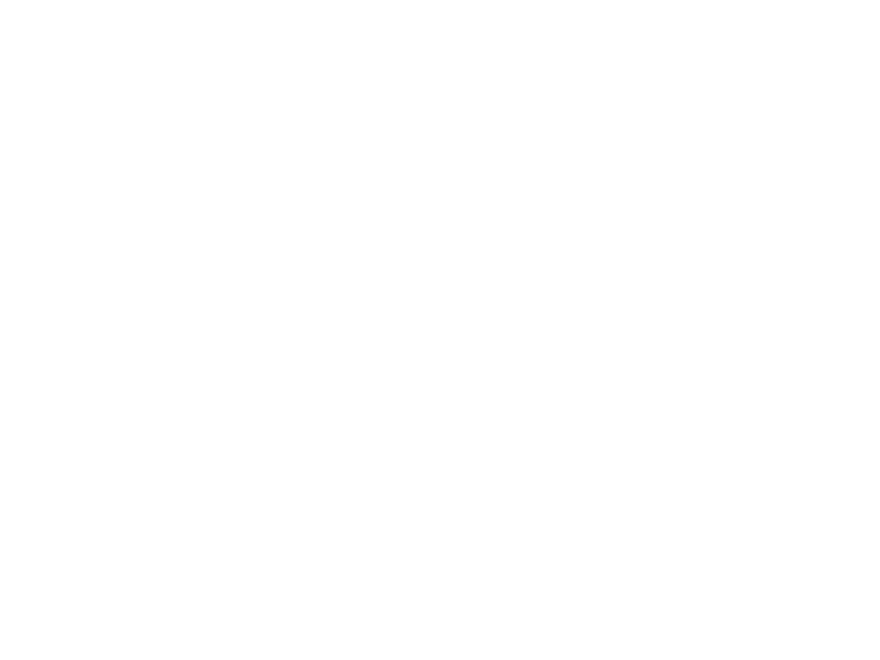

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0129.mp4

D:/HNSCC/HNSCC-01-0129\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


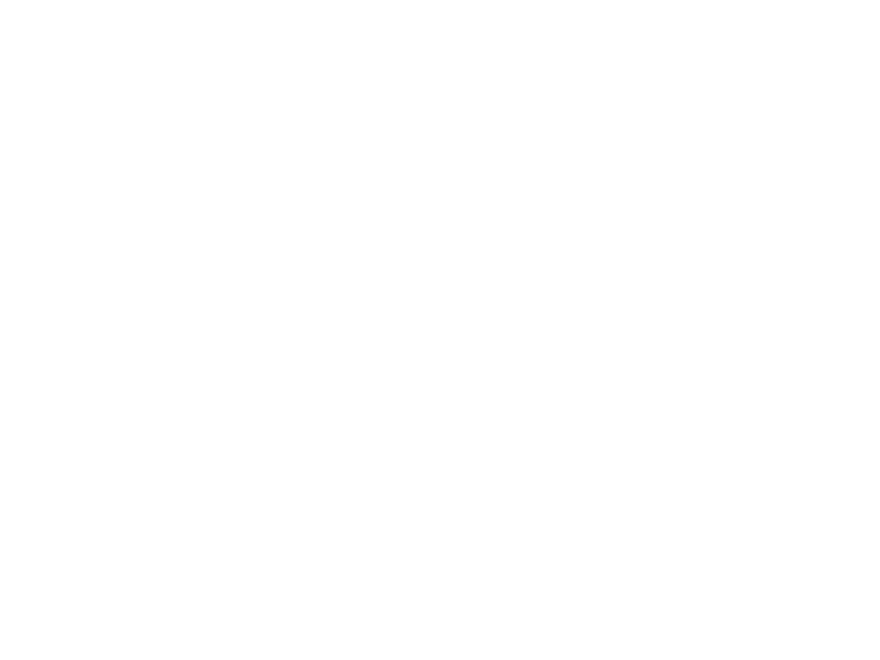

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0129.mp4

D:/HNSCC/HNSCC-01-0129\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


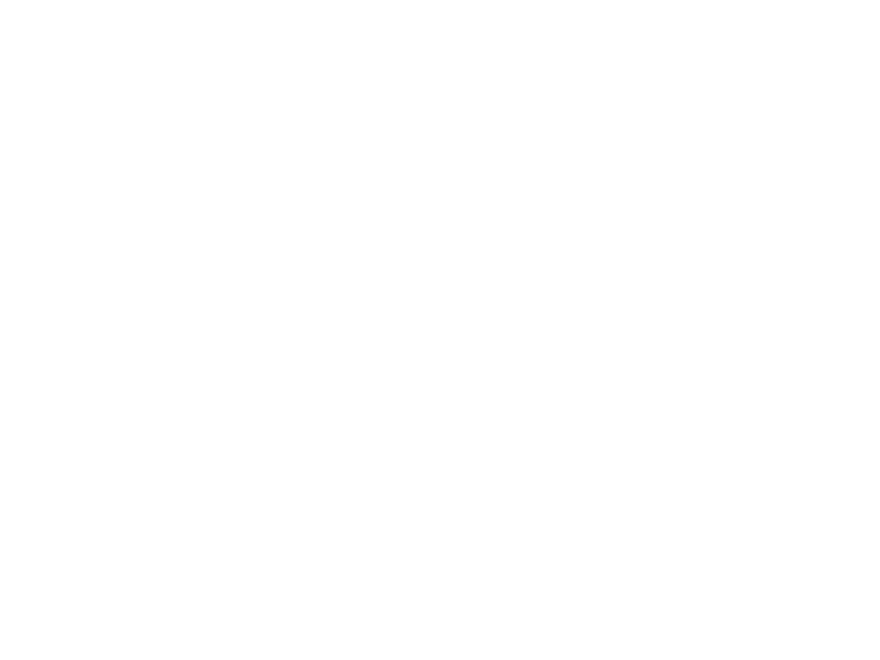

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0129.mp4

D:/HNSCC/HNSCC-01-0129\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


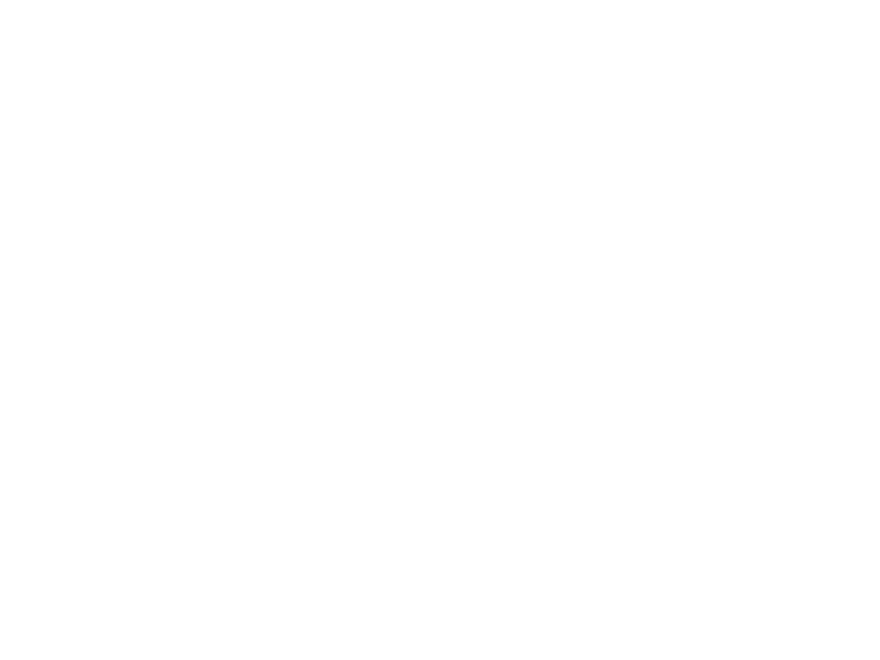

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0129.mp4

D:/HNSCC/HNSCC-01-0129\
Thickness 1: 2.500
Interpolated
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0130\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


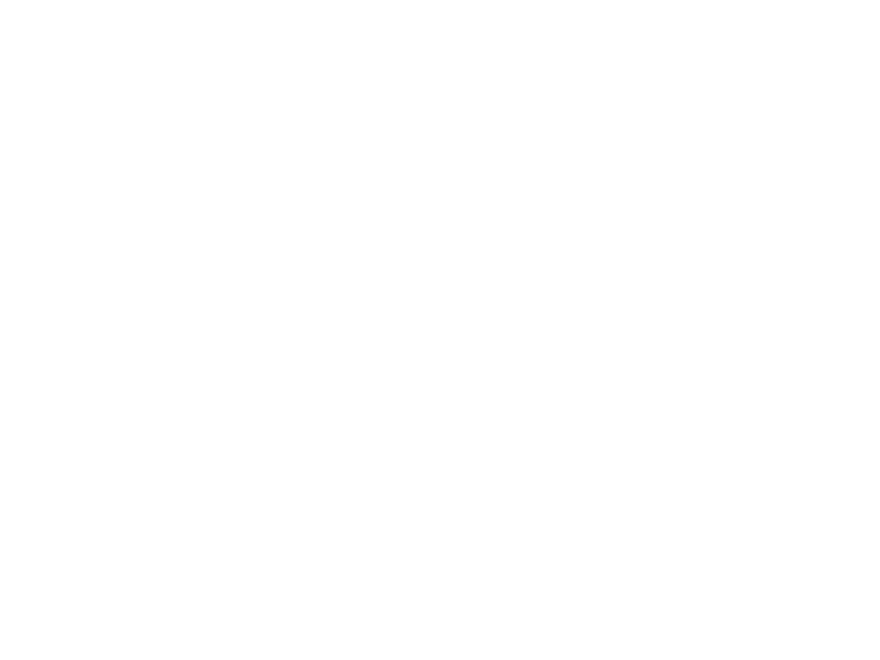

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0130.mp4

D:/HNSCC/HNSCC-01-0130\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


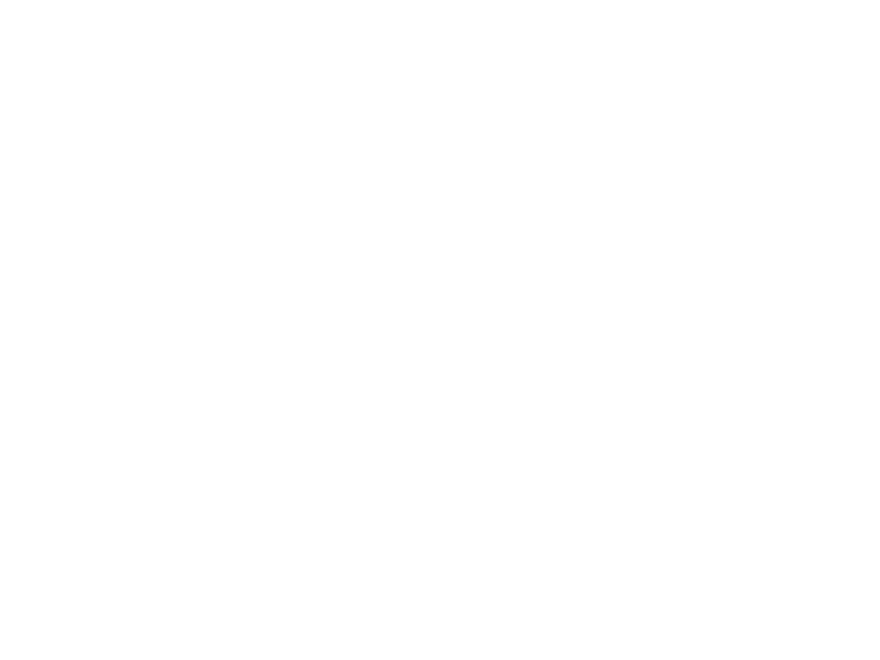

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0130.mp4

D:/HNSCC/HNSCC-01-0130\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


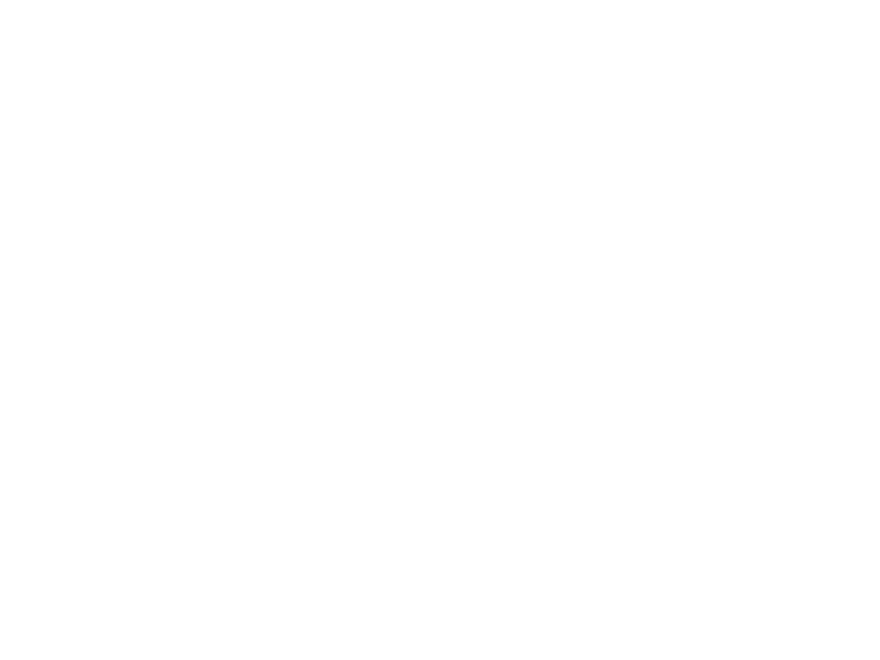

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0130.mp4

D:/HNSCC/HNSCC-01-0130\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


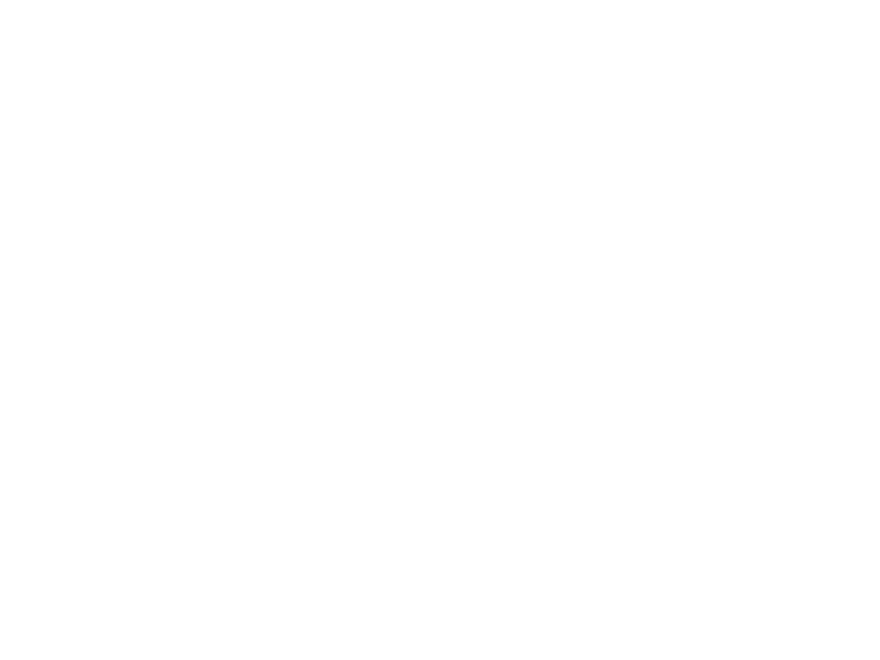

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0130.mp4

D:/HNSCC/HNSCC-01-0130\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


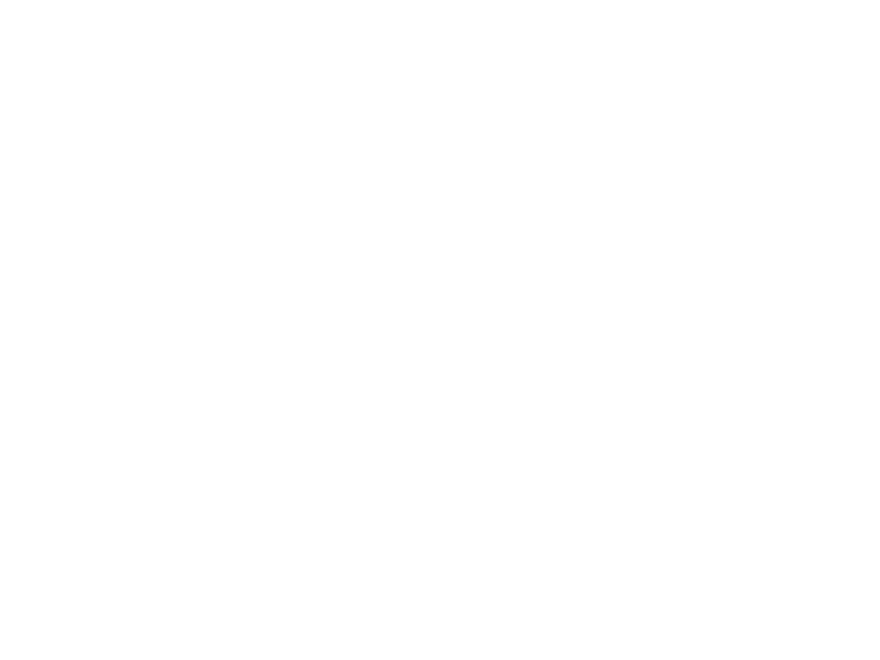

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0130.mp4

D:/HNSCC/HNSCC-01-0131\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


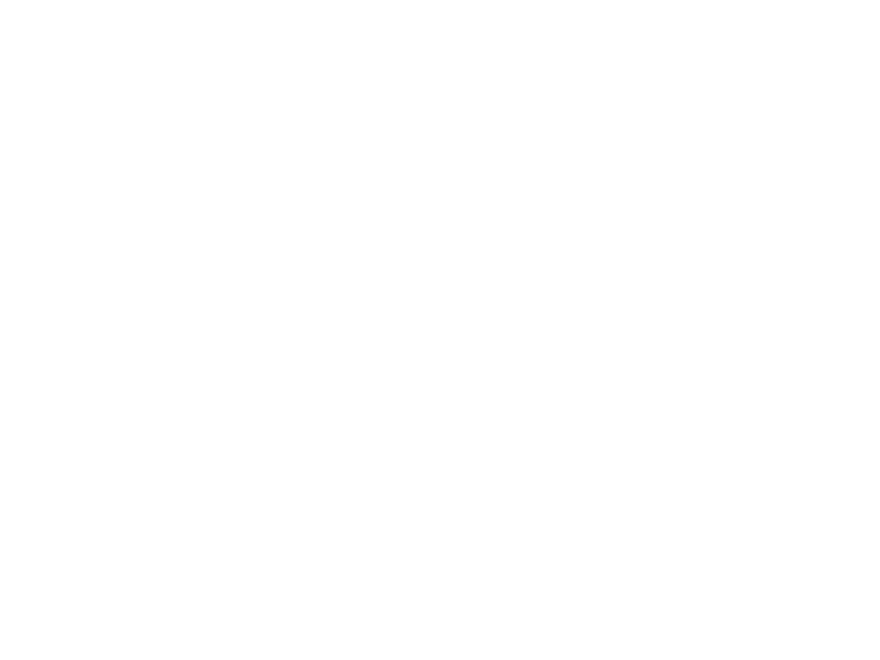

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0131.mp4

D:/HNSCC/HNSCC-01-0131\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


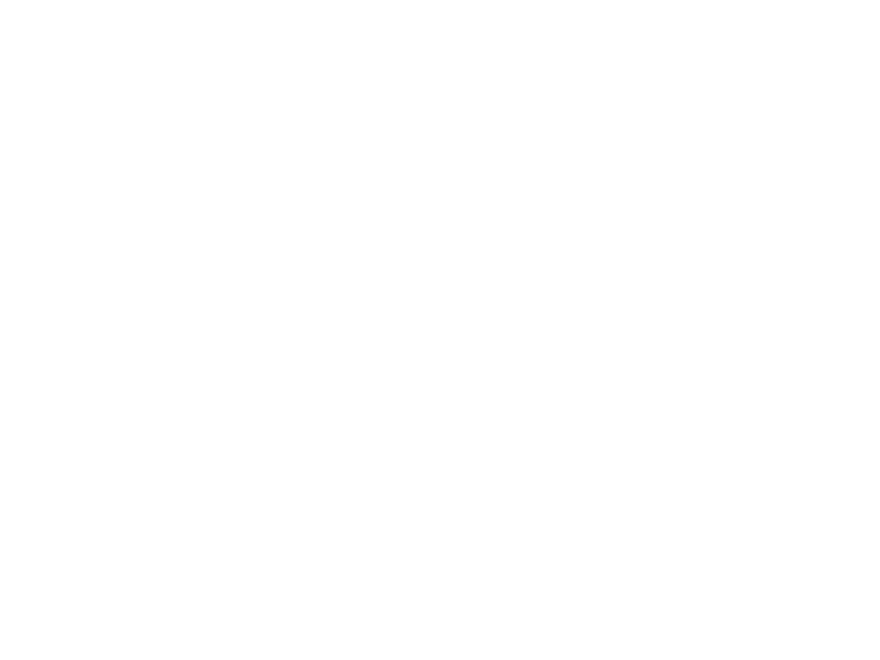

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0131.mp4

D:/HNSCC/HNSCC-01-0131\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


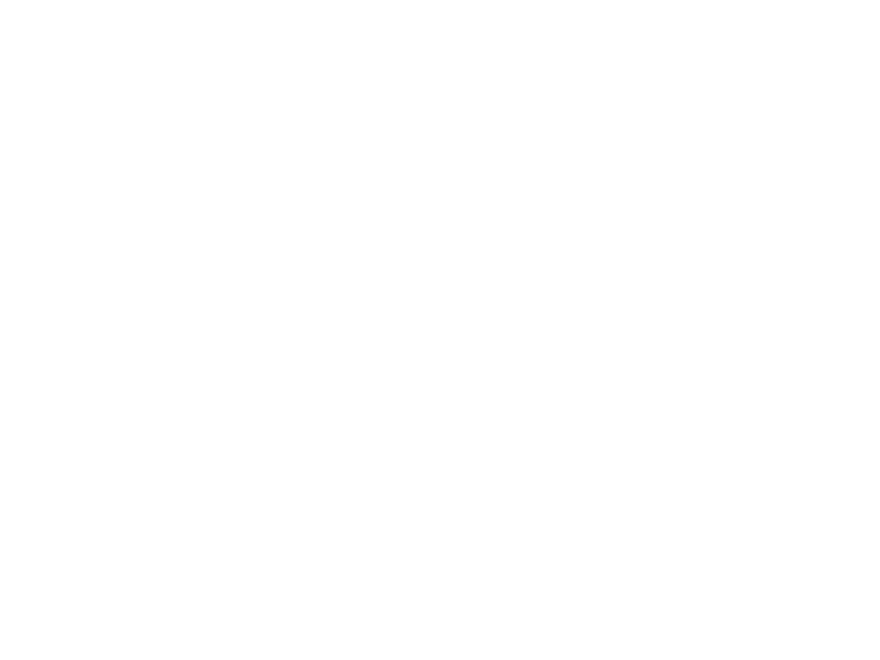

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0131.mp4

D:/HNSCC/HNSCC-01-0131\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0131\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0132\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


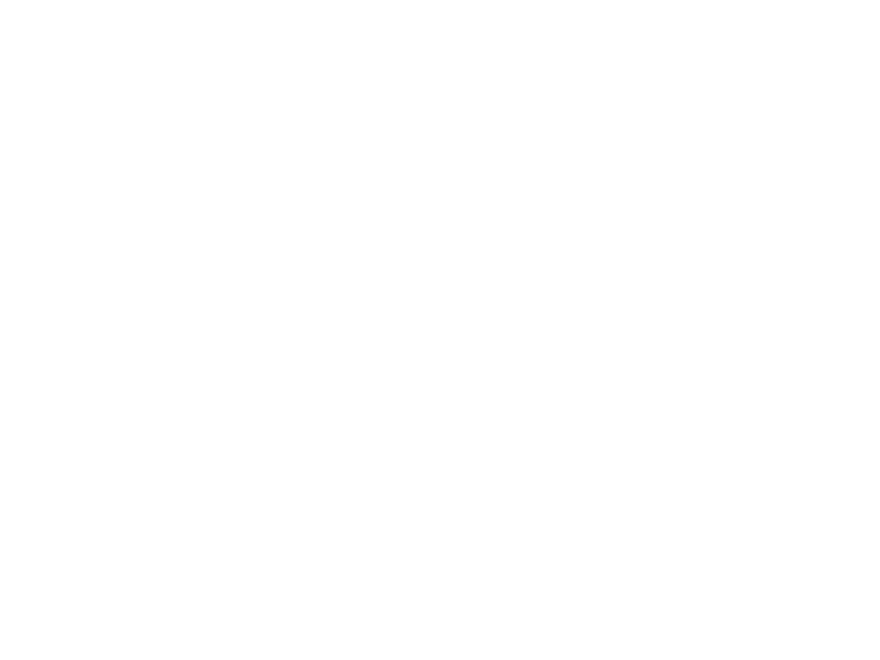

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0132.mp4

D:/HNSCC/HNSCC-01-0132\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


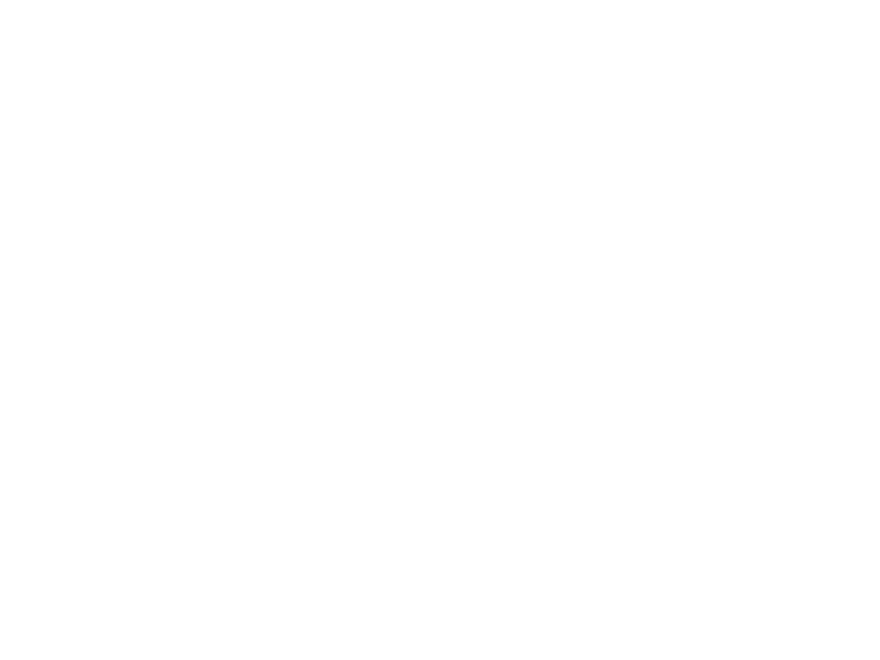

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0132.mp4

D:/HNSCC/HNSCC-01-0132\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


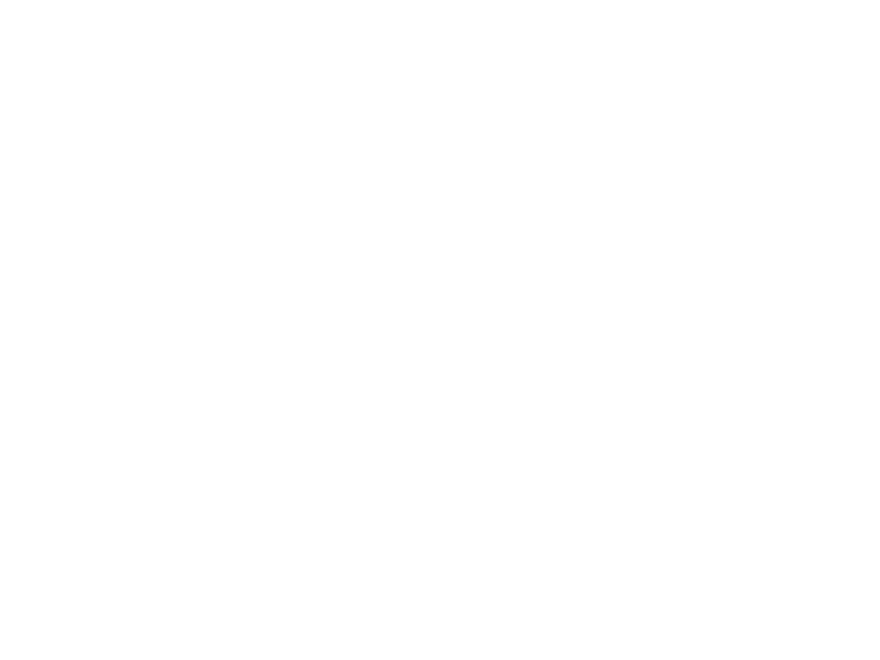

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0132.mp4

D:/HNSCC/HNSCC-01-0132\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0132\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0133\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


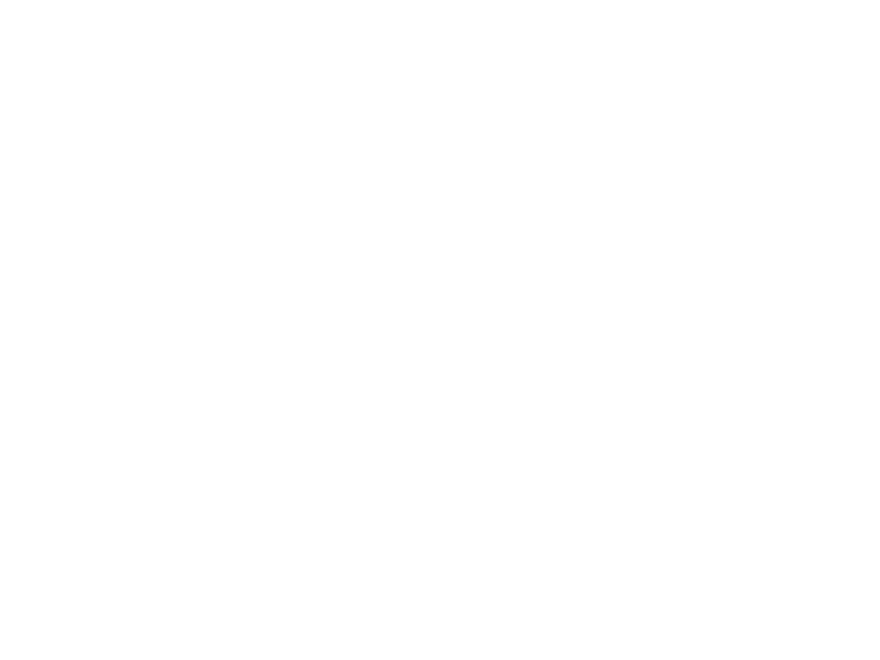

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0133.mp4

D:/HNSCC/HNSCC-01-0133\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


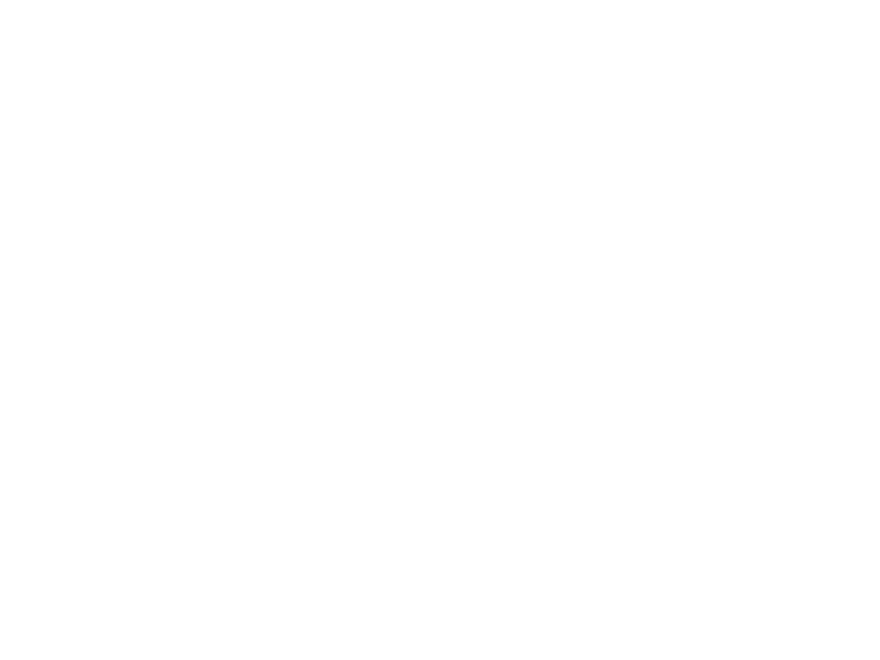

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0133.mp4

D:/HNSCC/HNSCC-01-0133\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


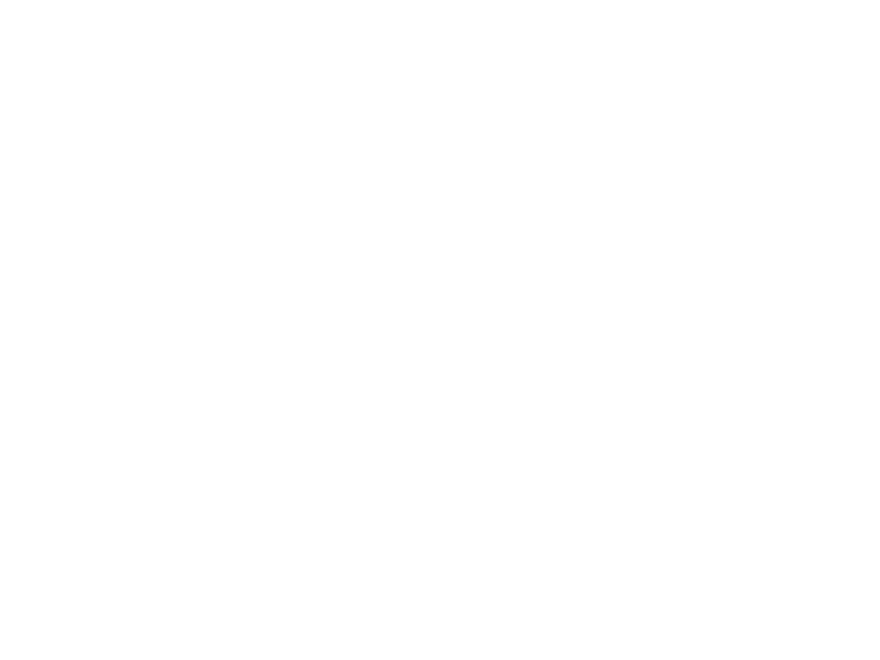

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0133.mp4

D:/HNSCC/HNSCC-01-0133\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0133\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0134\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


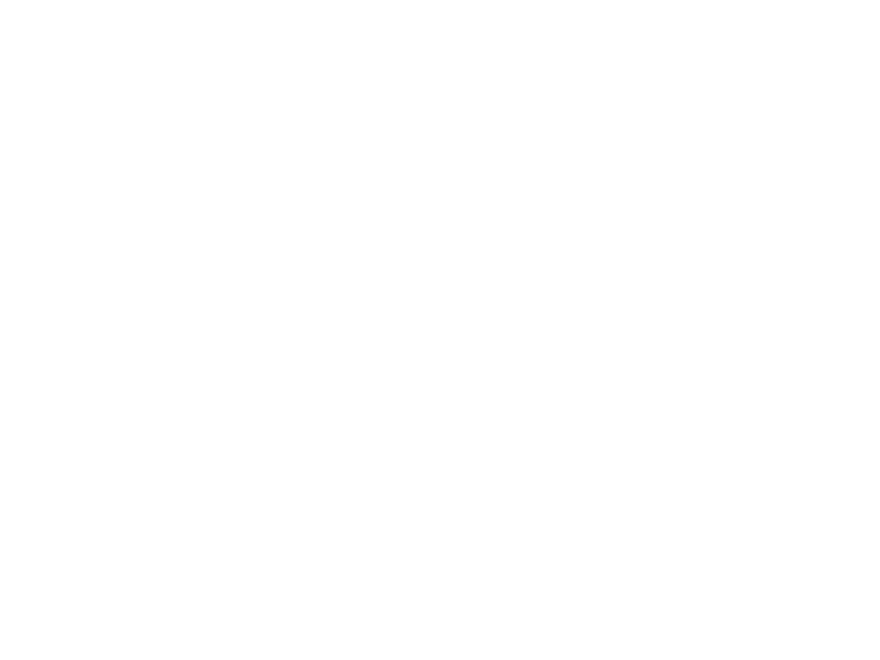

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0134.mp4

D:/HNSCC/HNSCC-01-0134\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


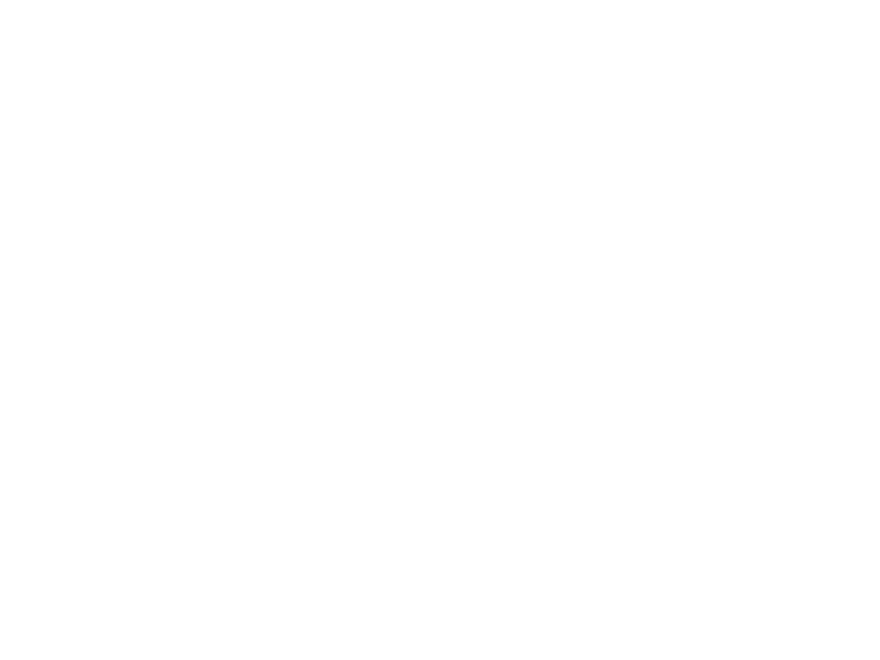

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0134.mp4

D:/HNSCC/HNSCC-01-0134\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


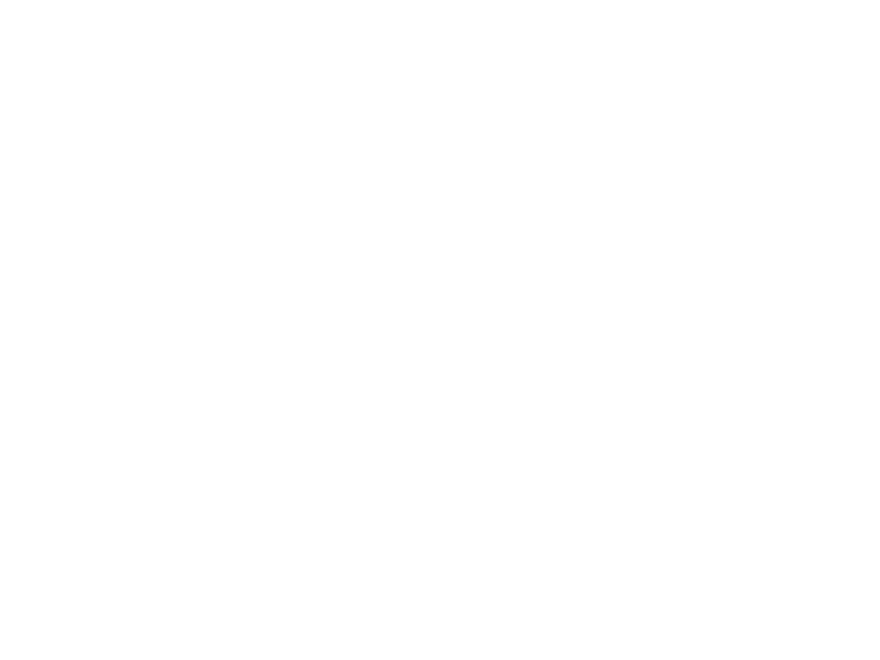

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0134.mp4

D:/HNSCC/HNSCC-01-0134\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0134\
Thickness 1: 2.500
Interpolated
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0135\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


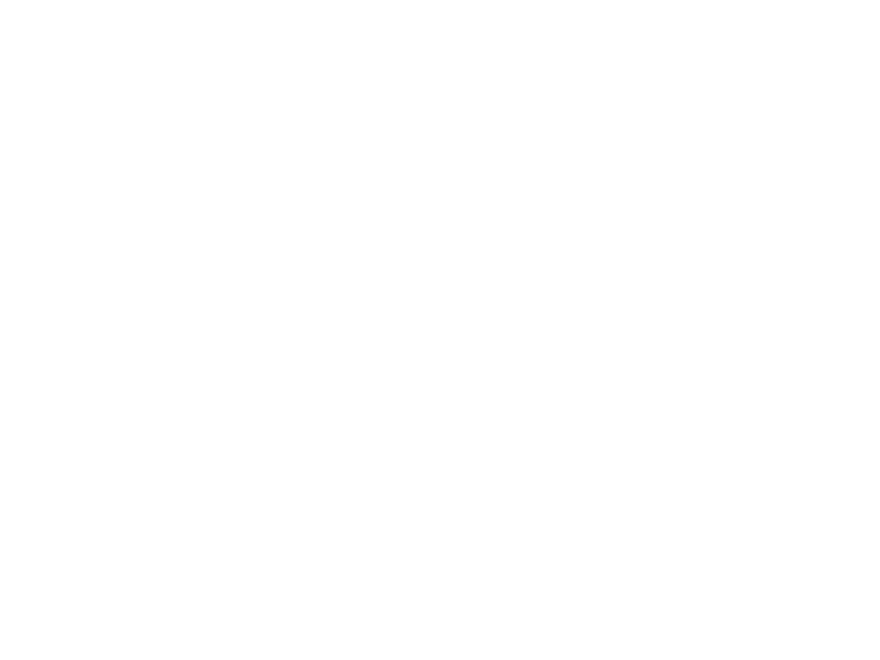

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0135.mp4

D:/HNSCC/HNSCC-01-0135\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


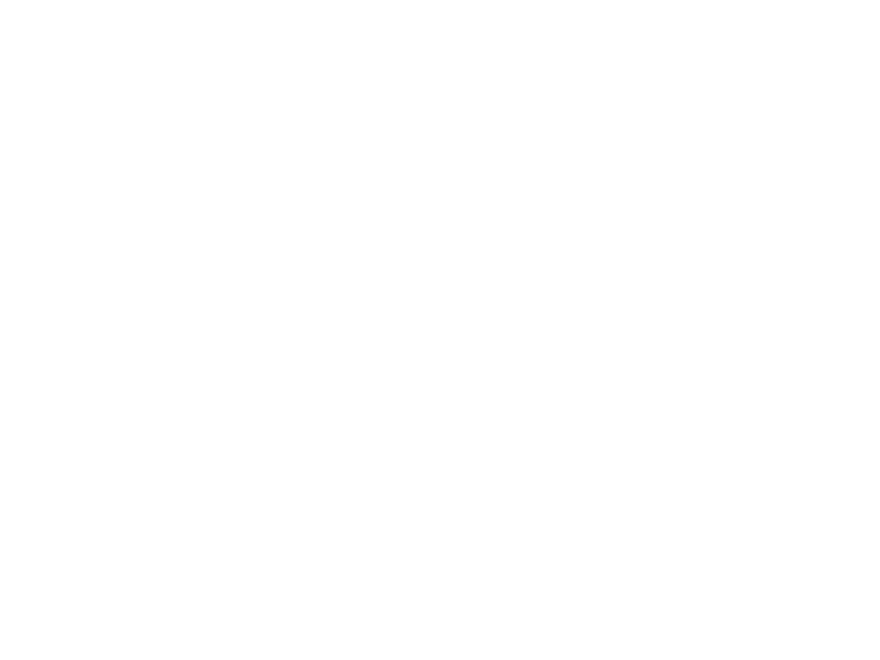

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0135.mp4

D:/HNSCC/HNSCC-01-0135\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


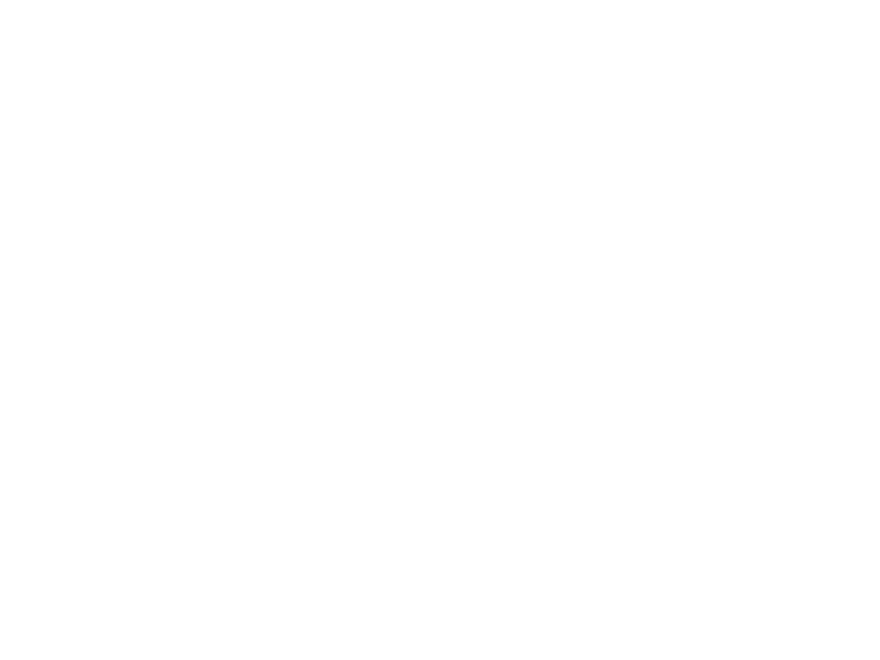

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0135.mp4

D:/HNSCC/HNSCC-01-0135\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0135\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0136\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


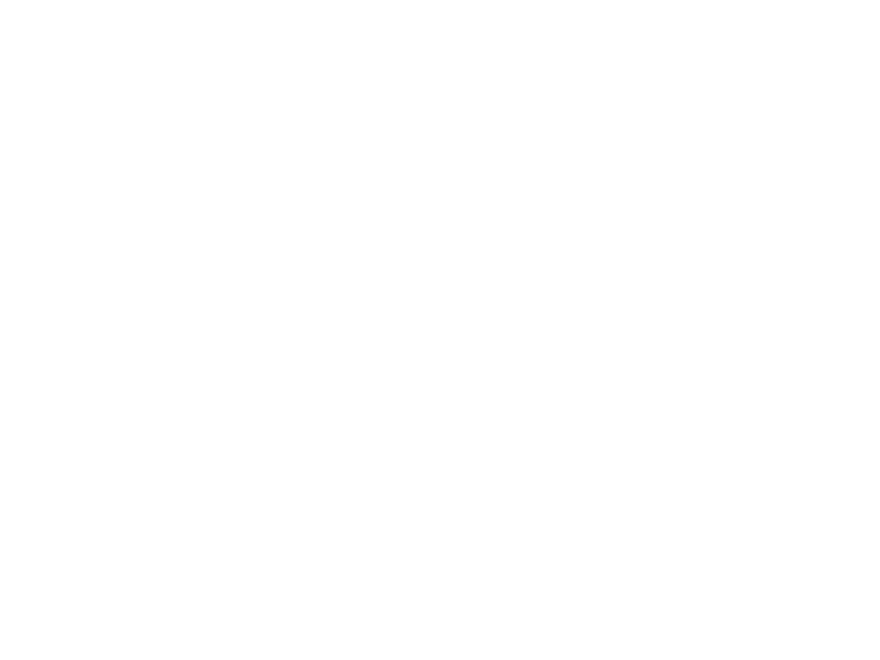

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0136.mp4

D:/HNSCC/HNSCC-01-0136\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


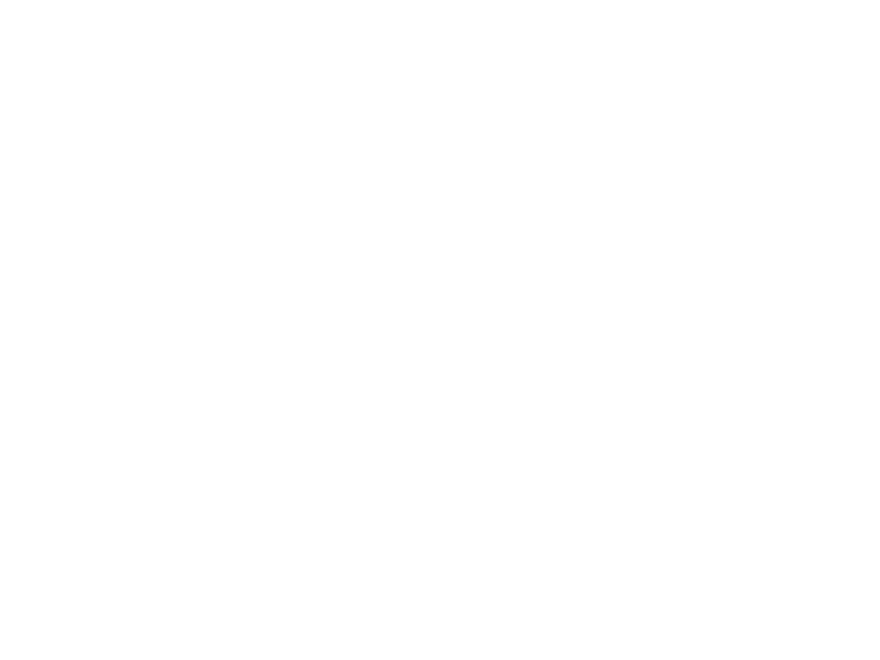

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0136.mp4

D:/HNSCC/HNSCC-01-0136\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


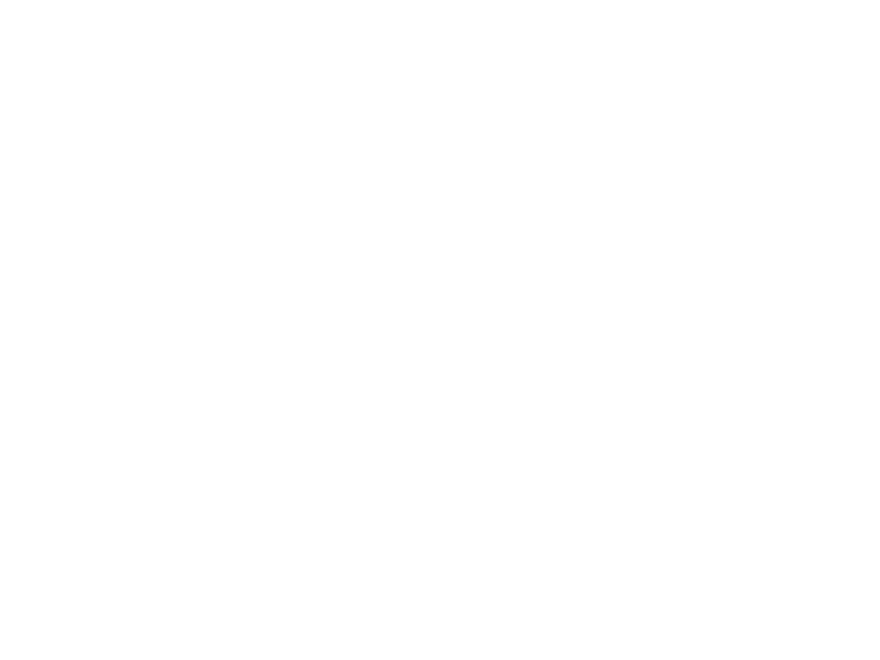

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0136.mp4

D:/HNSCC/HNSCC-01-0136\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0136\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0137\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


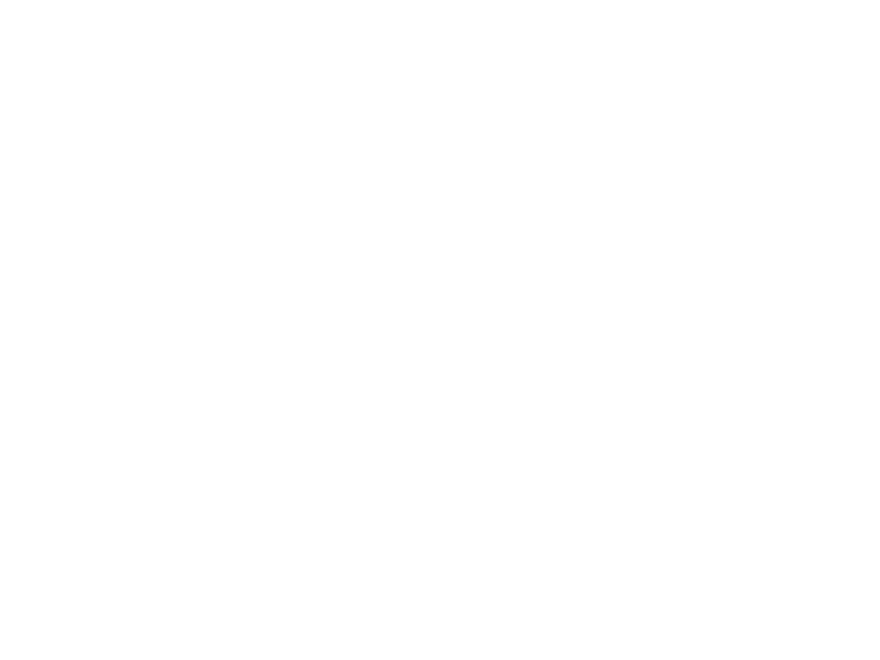

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0137.mp4

D:/HNSCC/HNSCC-01-0137\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


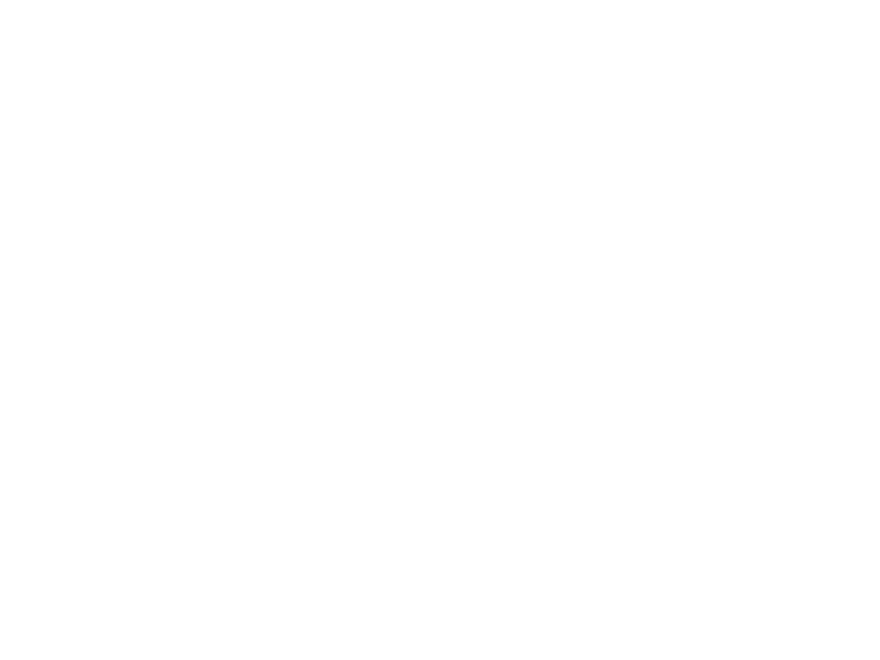

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0137.mp4

D:/HNSCC/HNSCC-01-0137\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


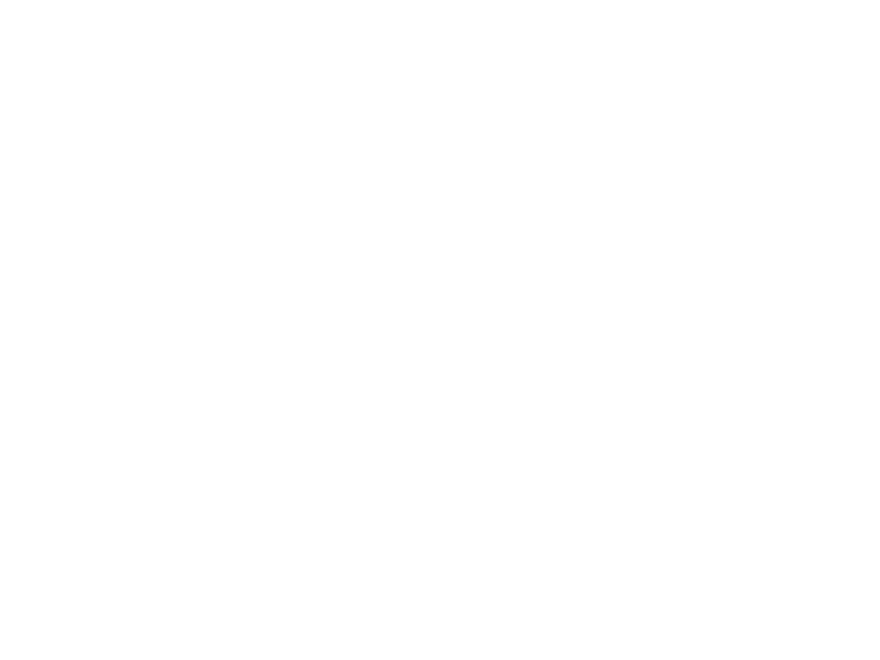

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0137.mp4

D:/HNSCC/HNSCC-01-0137\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0137\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0138\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


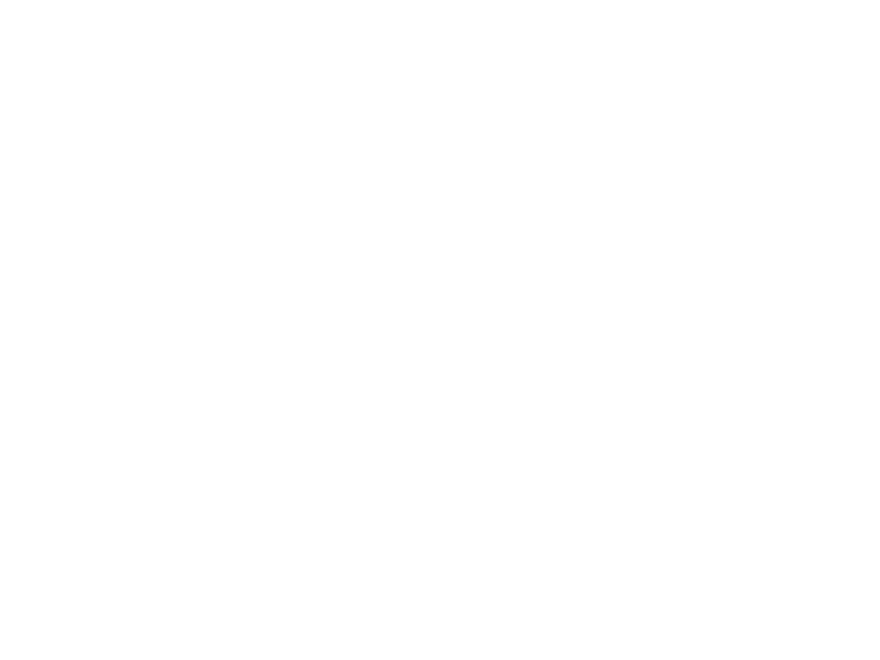

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0138.mp4

D:/HNSCC/HNSCC-01-0138\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


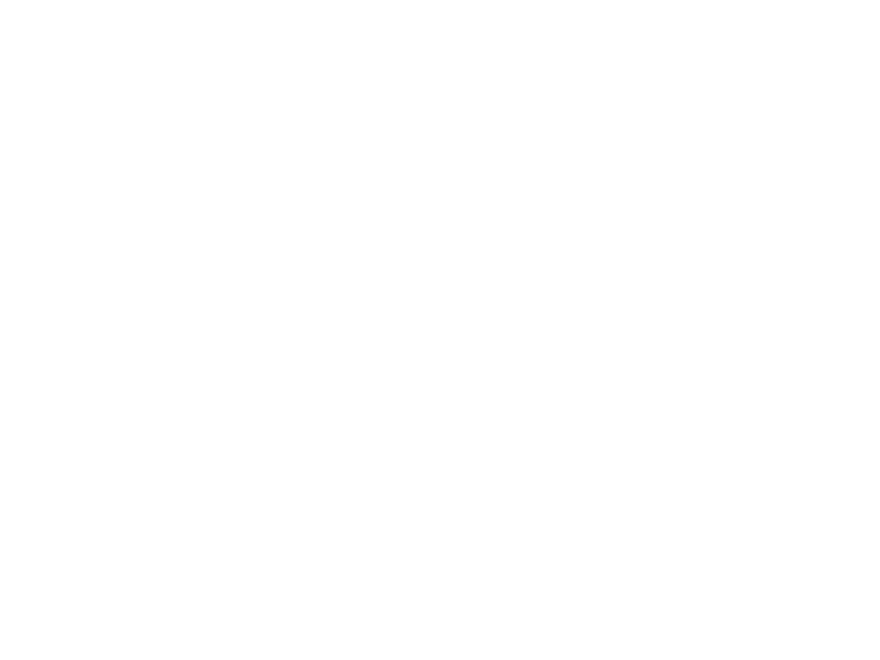

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0138.mp4

D:/HNSCC/HNSCC-01-0138\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


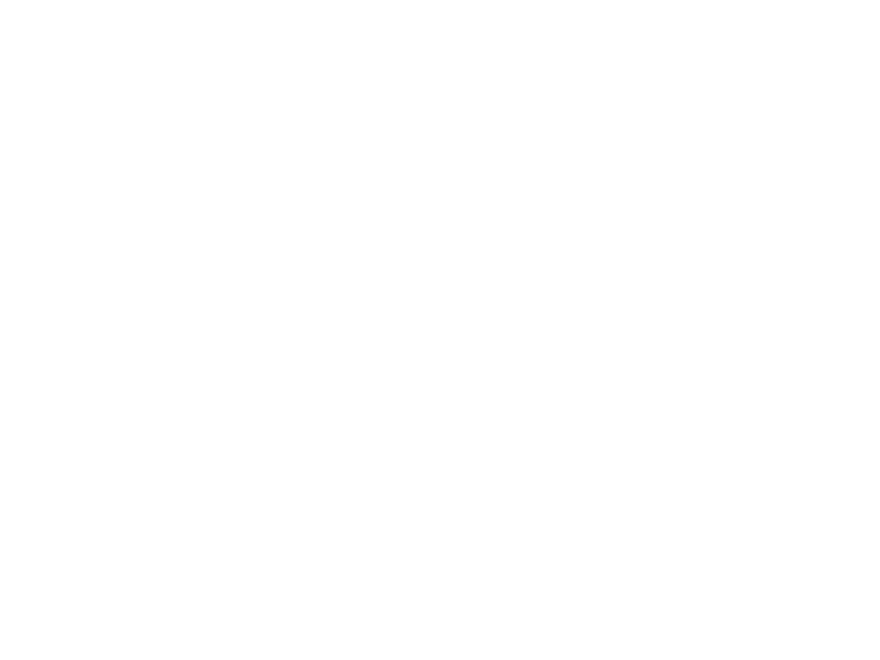

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0138.mp4

D:/HNSCC/HNSCC-01-0138\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0138\
Thickness 1: 2.440
Thickness 2: 3.000
Thickness 3: 2.440
check 3: 2.500
Thickness 3: 2.500
Interpolated
Thickness 2: 3.000
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0139\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


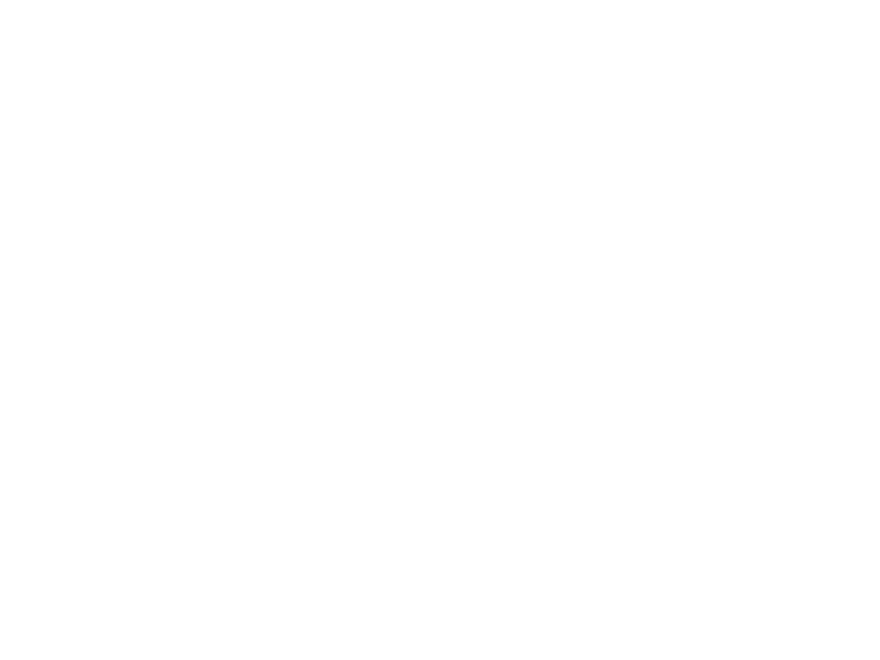

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0139.mp4

D:/HNSCC/HNSCC-01-0139\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


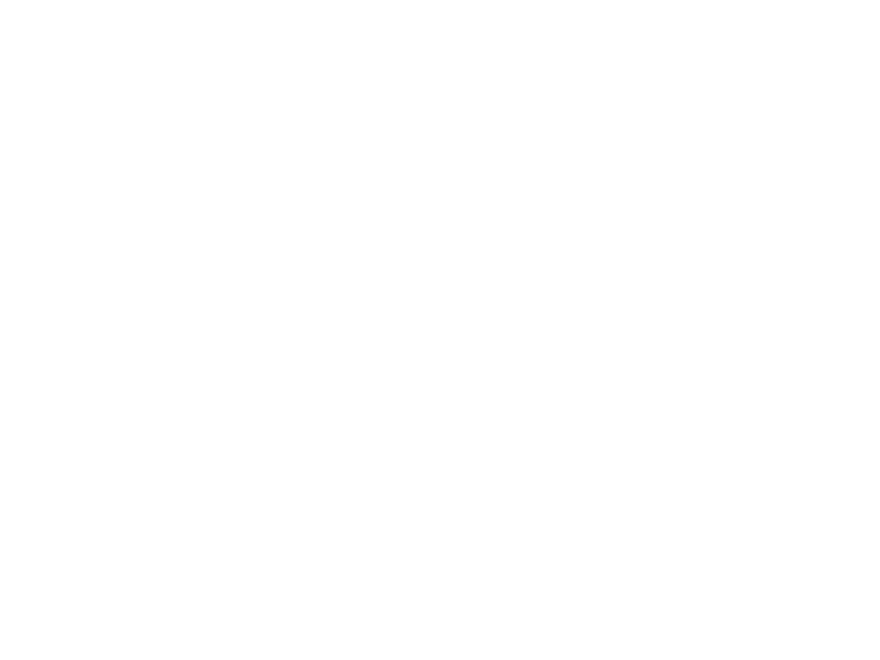

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0139.mp4

D:/HNSCC/HNSCC-01-0139\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:54
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


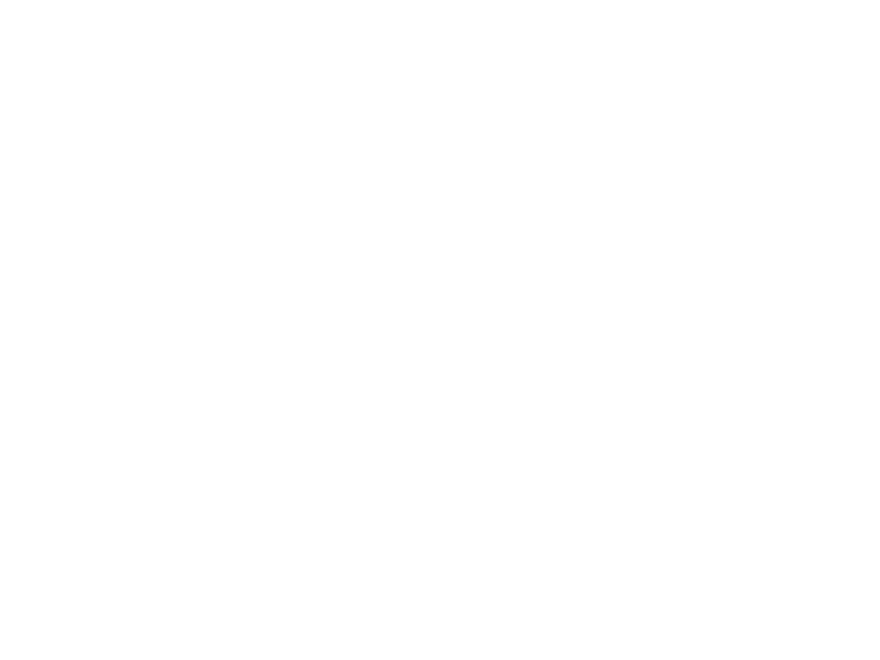

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0139.mp4

D:/HNSCC/HNSCC-01-0139\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0139\
Thickness 1: 2.500
Thickness 2: 2.500
Interpolated
Thickness 2: 2.500
Number of slices:54
Required:45
1

D:/HNSCC/HNSCC-01-0140\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45

C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


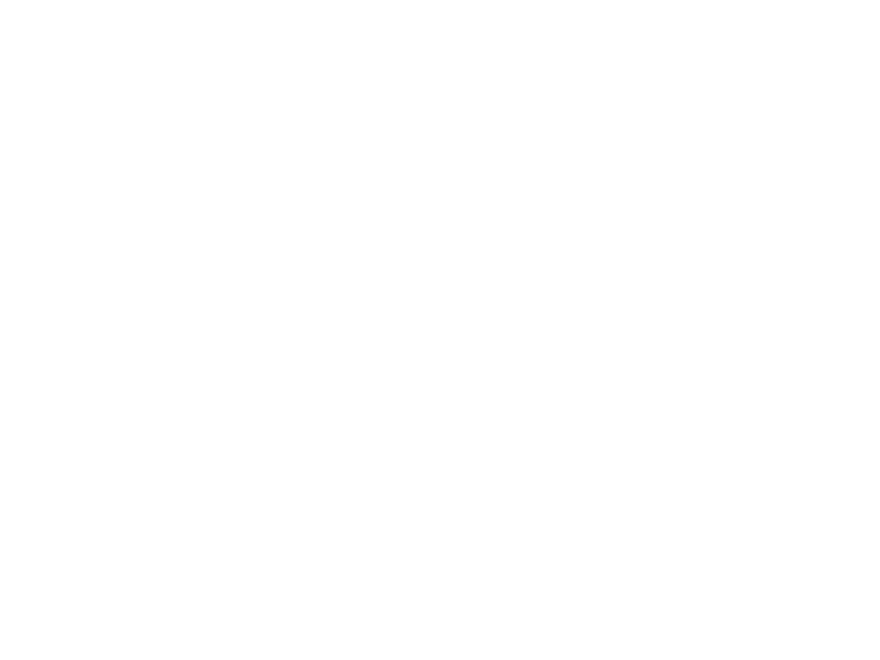

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0140.mp4

D:/HNSCC/HNSCC-01-0140\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


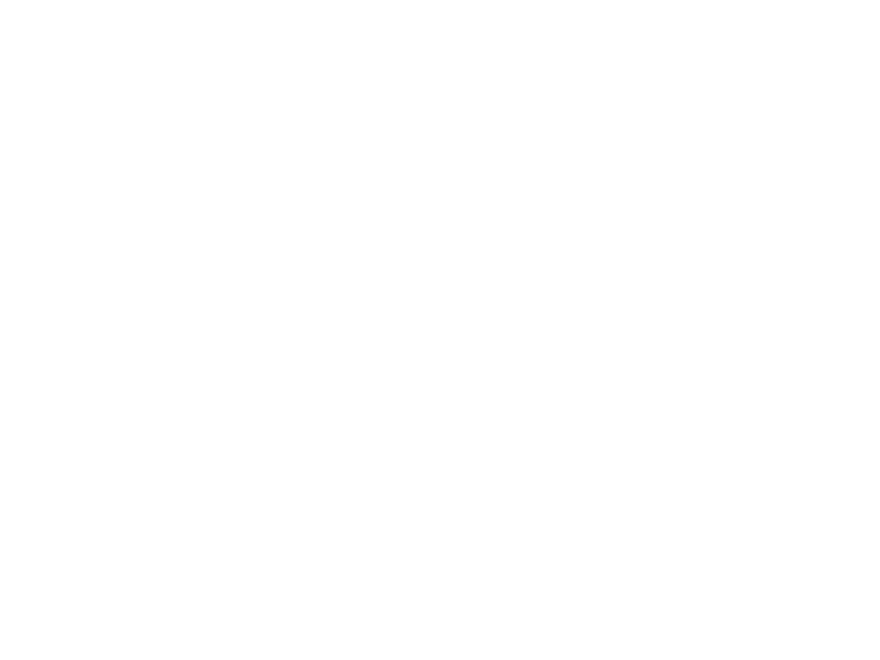

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0140.mp4

D:/HNSCC/HNSCC-01-0140\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


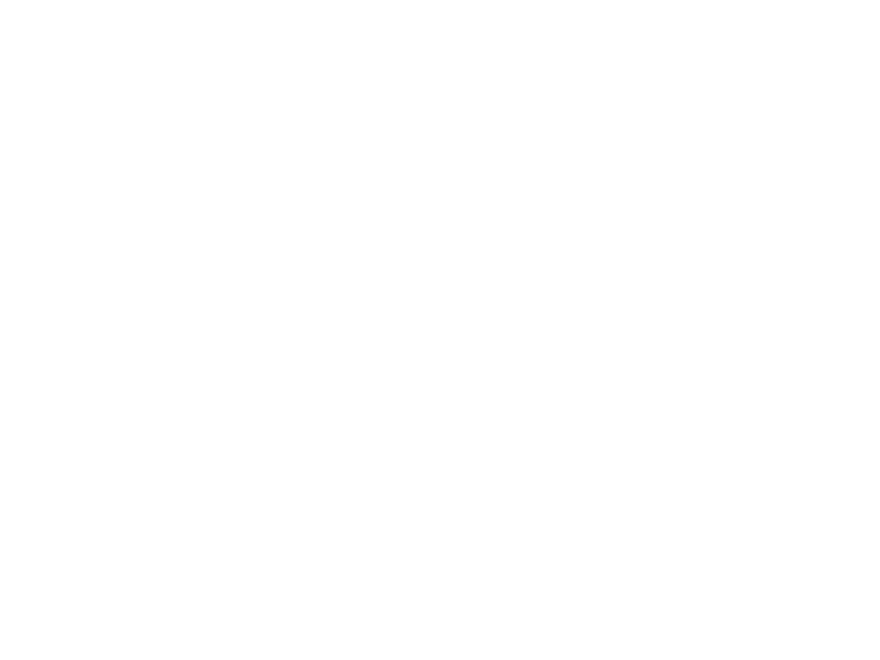

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0140.mp4

D:/HNSCC/HNSCC-01-0140\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0140\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
1

D:/HNSCC/HNSCC-01-0141\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


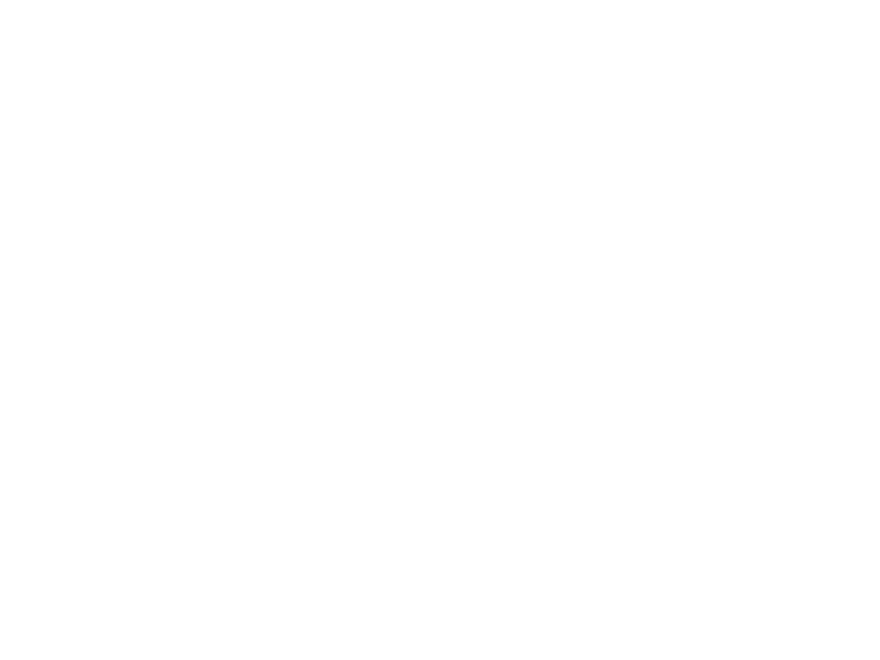

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0141.mp4

D:/HNSCC/HNSCC-01-0141\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


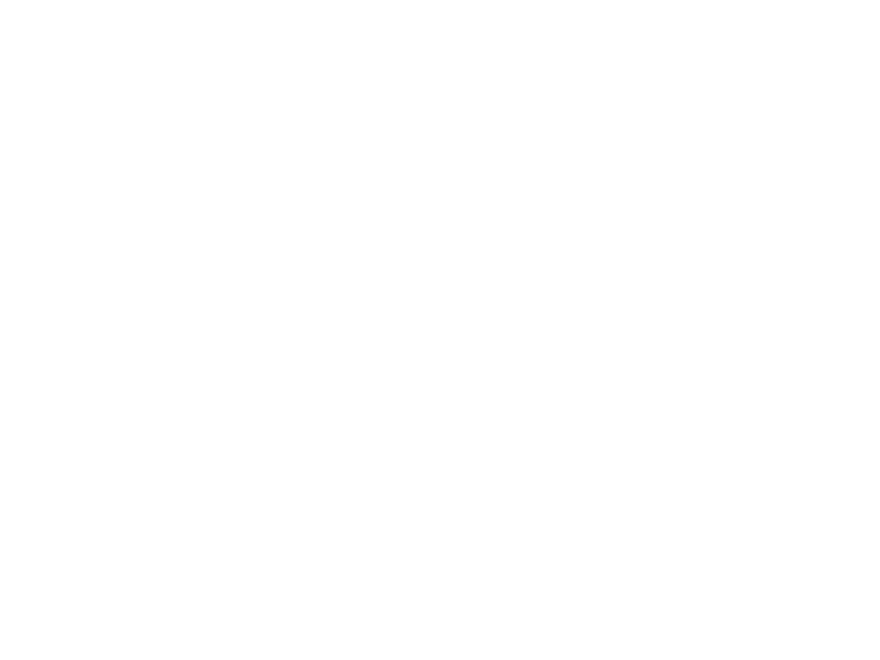

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Parotid/HNSCC-01-0141.mp4

D:/HNSCC/HNSCC-01-0141\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


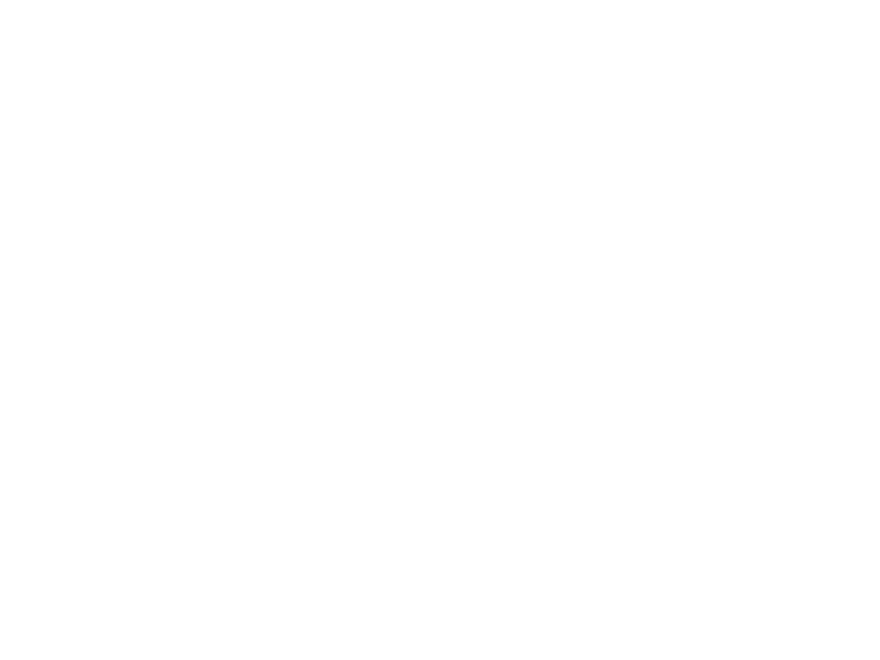

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Brainstem/HNSCC-01-0141.mp4

D:/HNSCC/HNSCC-01-0141\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


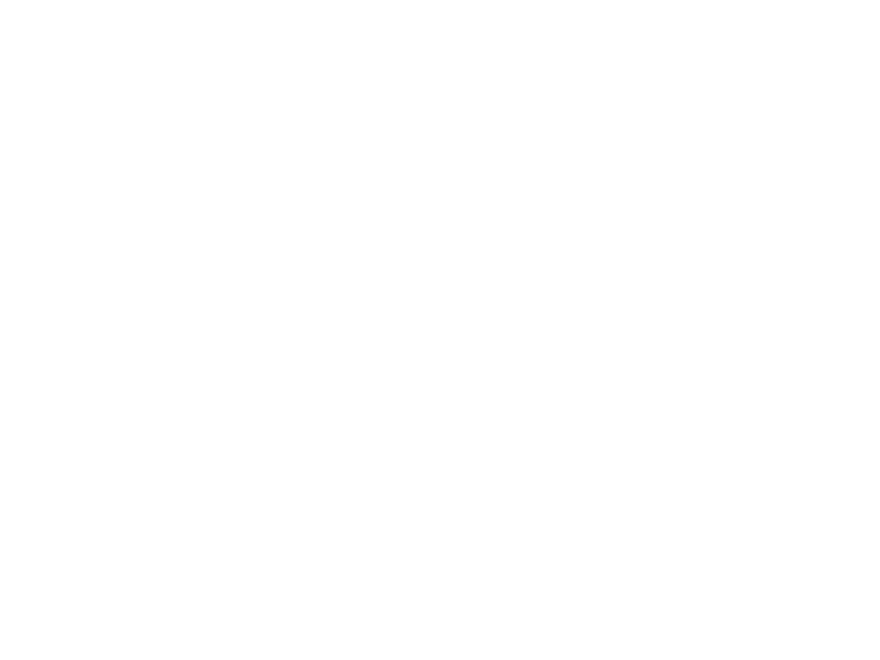

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Cochlea/HNSCC-01-0141.mp4

D:/HNSCC/HNSCC-01-0141\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):


45


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


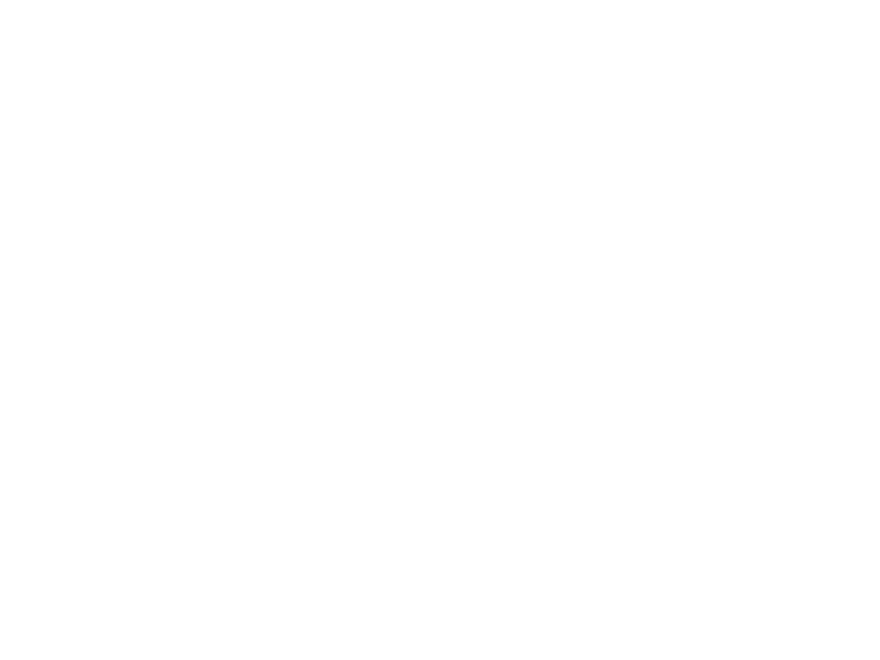

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Left_Cochlea/HNSCC-01-0141.mp4

D:/HNSCC/HNSCC-01-0142\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000
Number of slices:55
Required:45
54
45


C:\Users\Oliver\Documents\GitHub\Machine-Learning-For-Medical-Images\Image_Preprocessing.py:417: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if (tempLabel!="False"):
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:24: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


<IPython.core.display.Javascript object>


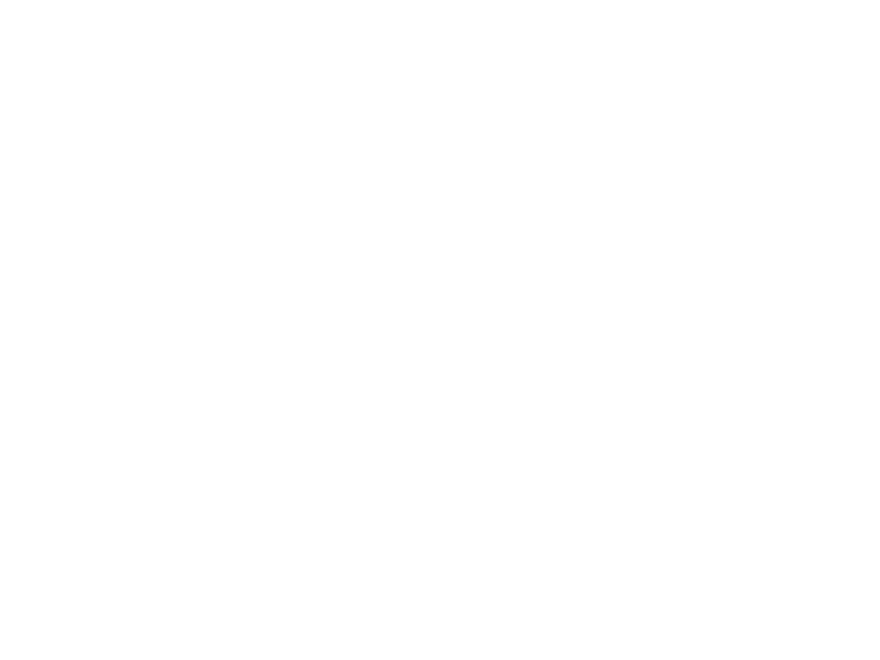

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

D:\Video Plots/Right_Parotid/HNSCC-01-0142.mp4

D:/HNSCC/HNSCC-01-0142\
Thickness 1: 2.500
Thickness 2: 3.000
Interpolated
Thickness 2: 3.000


KeyboardInterrupt: 

In [5]:
#===================================================================#
#                             VIDEO PLOT                            #
#===================================================================#
import matplotlib
#matplotlib.use("Agg")
import matplotlib.animation as animation
import tensorflow as tf

Organs = ["Right_Parotid","Left_Parotid","Brainstem","Right_Cochlea","Left_Cochlea"] 
no_Classes =5
key_Dict = "3Class2Channel3D"
Directory = "D:\Video Plots/"

for pathIndex in range(0,len(structureFiles)):
    for j in range(len(Organs)):
        patient_name = structureFiles[pathIndex][9:22]
        DicomPatient,thickness = Image_Preprocessing.get_Patient(pathIndex,Organs[j],structureFiles,True)
        if(thickness== 3):
            tempArray, tempLabel =Image_Preprocessing.get_contoured_organ(pathIndex,Organs[j],key_Dict,no_Classes,structureFiles)
            print(len(tempArray))
        else:
            print("Interpolated")
            tempArray, tempLabel =Image_Preprocessing.interpolateArray(pathIndex,Organs[j],key_Dict,no_Classes,structureFiles)
            print(len(tempArray))
            
        if(tempLabel != "False"):
            shape =list(tempArray.shape[0:3])
            shape.append(3)
            fullyImage =np.zeros(shape,'uint8')
            fullyImage[...,0] = tempArray[...,0]
            fullyImage[...,2] = tempArray[...,0]
            fullyImage[...,1] = tempArray[...,1]

            fig1 = plt.figure()
            plt.title(patient_name+"_"+Organs[j])
            ims = []
            for i in range(len(fullyImage)):
                im = plt.imshow(fullyImage[i], animated=True)
                ims.append([im])

            patient_name = structureFiles[pathIndex][9:22]
            ani = animation.ArtistAnimation(fig1, ims, interval=200, blit=True,
                                            repeat_delay=1000)
            print(Directory+Organs[j]+"/"+patient_name+".mp4")
            if(thickness== 3):
                ani.save(Directory+Organs[j]+"/"+patient_name+".mp4",dpi=480)
            else:
                ani.save(Directory+Organs[j]+"/"+patient_name+"_Interpolated.mp4",dpi=480)
            plt.close()

D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\1-78710\000000.dcm
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\28768\
Thickness 1: 2.500
Thickness 2: 3.000
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\1-78710\000000.dcm
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\28768\
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\1-78710\000000.dcm
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\28768\
Number of slices:
69


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:13: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  del sys.path[0]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


D:\Three Dim Imaging/Axial\HNSCC-01-0001_Middle_Before Interpolation.png


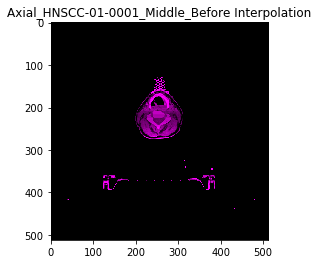

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


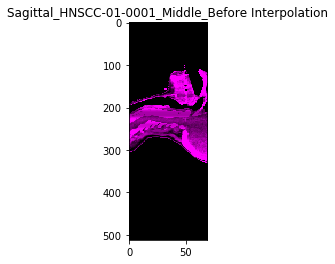

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


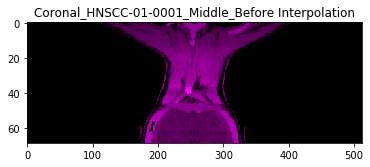

D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\1-78710\000000.dcm
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\28768\
Thickness 1: 2.500
Thickness 2: 3.000
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\1-78710\000000.dcm
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\28768\
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\1-78710\000000.dcm
D:/HNSCC/HNSCC-01-0001\12-05-1998-RT SIMULATION-43582\28768\
Number of slices:
69


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


D:\Three Dim Imaging/Axial\HNSCC-01-0001_Middle_After Interpolation_3mm.png


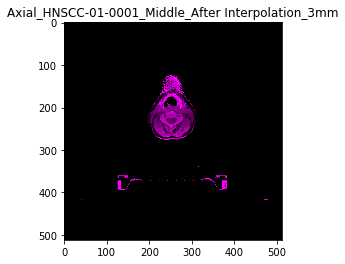

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


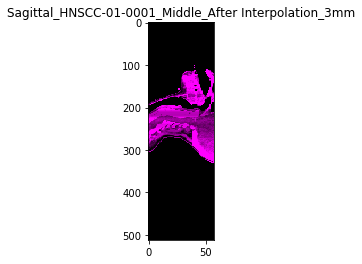

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


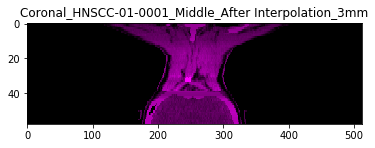

In [3]:
#===================================================================#
#                           3D DICOM PLOTS                          #
#===================================================================#
Organs = ["Right_Parotid","Left_Parotid","Brainstem","Right_Cochlea","Left_Cochlea"] 
no_Classes =2
j=0
key_Dict = "Parotids11Slice_Uncropped"
Directory = "D:\Three Dim Imaging/"

for pathIndex in range(0,len(structureFiles)):
    patient_name = structureFiles[pathIndex][9:22]
    DicomPatient,thickness = Image_Preprocessing.get_Patient(pathIndex,Organs[j],structureFiles)
    tempArray, tempLabel =Image_Preprocessing.get_contoured_organ(pathIndex,Organs[j],key_Dict,no_Classes,structureFiles)

    if(tempLabel != "False"):
        if(thickness ==3):
            Dicom_Plots.Overlay_DICOM_3D_Plots(DicomPatient.PixelSpacing,thickness,tempArray[...,0], tempArray[...,1],Directory,patient_name+"_Middle_3mm")
        else:
            Dicom_Plots.Overlay_DICOM_3D_Plots(DicomPatient.PixelSpacing,thickness, tempArray[...,0], tempArray[...,1],Directory,patient_name+"_Middle_Before Interpolation")
            tempArray, tempLabel =Image_Preprocessing.interpolateArray(pathIndex,Organs[j],key_Dict,no_Classes,structureFiles)
            Dicom_Plots.Overlay_DICOM_3D_Plots(DicomPatient.PixelSpacing,thickness, tempArray[...,0], tempArray[...,1],Directory,patient_name+"_Middle_After Interpolation_3mm")

In [ ]:
#===================================================================#
#                       OLD 3D DICOM PLOTS                          #
#===================================================================#
Organs = ["Right_Parotid","Left_Parotid","Brainstem","Right_Cochlea","Left_Cochlea"] 
no_Classes =2
j=0
key_Dict = "Parotids11Slice_Uncropped"
Directory = "D:\Three Dim Imaging/"

for pathIndex in range(0,len(structureFiles)):
    patient_name = structureFiles[pathIndex][9:22]
    DicomPatient,thickness = Image_Preprocessing.get_Patient(pathIndex,Organs[j],structureFiles)
    tempArray, tempLabel =Image_Preprocessing.get_contoured_organ(pathIndex,Organs[j],key_Dict,no_Classes,structureFiles)
    
    if(tempLabel != "False"):
        if(thickness ==3):
            index1,index2,index3 = Dicom_Plots.DICOM_3D_Plots(DicomPatient.PixelSpacing,thickness, tempArray[...,1],Directory,patient_name+"_3mm")
            _,_,_ =Dicom_Plots.DICOM_3D_Plots(DicomPatient.PixelSpacing,thickness, tempArray[...,0],Directory,patient_name+"_Before Interpolation_Image",index1,index2,index3)
        else:
            index1,index2,index3 = Dicom_Plots.DICOM_3D_Plots(DicomPatient.PixelSpacing,thickness, tempArray[...,1],Directory,patient_name+"_Before Interpolation_Contour")
            _,_,_ =Dicom_Plots.DICOM_3D_Plots(DicomPatient.PixelSpacing,thickness, tempArray[...,0],Directory,patient_name+"_Before Interpolation_Image",index1,index2,index3)
            tempArray, tempLabel =Image_Preprocessing.interpolateArray(pathIndex,Organs[j],key_Dict,no_Classes,structureFiles)
            index1,index2,index3 = Dicom_Plots.DICOM_3D_Plots(DicomPatient.PixelSpacing,thickness, tempArray[...,1],Directory,patient_name+"_After Interpolation_Contour")
            _,_,_ = Dicom_Plots.DICOM_3D_Plots(DicomPatient.PixelSpacing,thickness, tempArray[...,0],Directory,patient_name+"_After Interpolation_Image",index1,index2,index3)

(0, 3.9971215381012892)


C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\ipykernel_launcher.py:14: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  


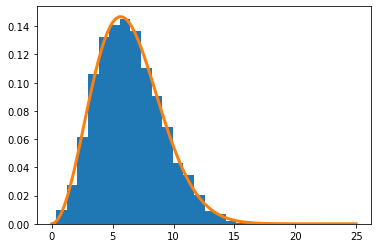

0.06471905812102342


'\nfor pathIndex in range(100,200):\n    Organ = "Right_Parotid"\n\n    imagesFolders,imageFolderIndex,DicomImageSet,Organ_Data = load_Saved_Data(pathIndex,Organ)\n\n    images_in_Folder = [imagesFolders[imageFolderIndex] + image for image in DicomImageSet]\n\n    slices = [pydicom.read_file(image) for image in images_in_Folder]\n    slices.sort(key = lambda x: float(x.ImagePositionPatient[2]))\n\n    print(slices[0].Modality)\n    print(pathIndex)'

In [6]:
#===================================================================#
#                       MAXWELL DISTRIBUTION                        #
#===================================================================#
import scipy.stats as stats
import matplotlib.pyplot as plt
import numpy as np
import random

maxwell = stats.maxwell
data = maxwell.rvs(loc=0, scale=4, size=10000)

params = maxwell.fit(data, floc=0)
print(params)
# (0, 4.9808603062591041)

plt.hist(data, bins=20, normed=True)
x = np.linspace(0, 25, 100)
plt.plot(x, maxwell.pdf(x, *params), lw=3)
plt.show()
randomNo = random.uniform(0,15)
print(maxwell.pdf(randomNo, *params))
"""
for pathIndex in range(100,200):
    Organ = "Right_Parotid"

    imagesFolders,imageFolderIndex,DicomImageSet,Organ_Data = load_Saved_Data(pathIndex,Organ)

    images_in_Folder = [imagesFolders[imageFolderIndex] + image for image in DicomImageSet]

    slices = [pydicom.read_file(image) for image in images_in_Folder]
    slices.sort(key = lambda x: float(x.ImagePositionPatient[2]))

    print(slices[0].Modality)
    print(pathIndex)"""

In [ ]:
#===================================================================#
#                       CHECK DATA HOMOGENEITY                      #
#===================================================================#
for pathIndex in range(0,len(structureFiles)):
    Dicom_Plots.check_Homogeneity(pathIndex,"Right_Cochlea", "D:\HNSCC\Datasets\Left Cochlea/")
    Dicom_Plots.check_Homogeneity(pathIndex,"Left_Cochlea", "D:\HNSCC\Datasets\Right Cochlea/")
    
for pathIndex in range(0,len(structureFiles)):
    Dicom_Plots.check_Homogeneity(pathIndex,"Right_Parotid", "D:\HNSCC\Datasets\Right Parotid/")
    Dicom_Plots.check_Homogeneity(pathIndex,"Left_Parotid", "D:\HNSCC\Datasets\Left Parotid/")
    Dicom_Plots.check_Homogeneity(pathIndex,"Brainstem", "D:\HNSCC\Datasets\Brainstem/")

In [ ]:
#===================================================================#
#                         CNN CLASSIFICATION                        #
#===================================================================#
#===================================================================#
#                             TRAINING                              #
#===================================================================#
#===================================================================#
#                              CHECKS                               #
#===================================================================#
###Check for cross contamination of slices
import numpy as np
XTest = np.load('Testing_Features_2D_Middle_Slice.npy',allow_pickle=True)
yTest = np.genfromtxt('Testing_Label_2D_Middle_Slice.csv', delimiter = ',')

for i in range(0,len(XTest)):
    if((XTest[i]==XTest[51]).all()):
        print("Duplicate")


for i in range(0,len(XTest)):
    for j in range (0,len(X)):
        if((XTest[i]==X[j]).all()):
            print("Duplicate")
#Should print exactly one output

In [3]:
#===================================================================#
#                            LOAD DATA                              #
#===================================================================#
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
%matplotlib inline

#Load Data
key_Dict = "3Class2Channel3D"
no_classes = 3
key_Dict_Model = key_Dict
TrainingFeaturesDict,TrainingLabelsDict = Data_Dictionary.get_Training_Dictionary()
TestingFeaturesDict,TestingLabelsDict = Data_Dictionary.get_Testing_Dictionary()
stringImageDirectory, ModelDict = Data_Dictionary.get_Model_Dictionary()

#Fitting the CNN to the images
if(key_Dict.find("3D")):
    TrainingFeatures = glob.glob(TrainingFeaturesDict[key_Dict]+"/Training/Features/*")
    X= np.load(TrainingFeaturesDict[key_Dict]+TrainingFeatures[0])
    y= np.load(TrainingLabelsDict[key_Dict]+"Patient Directories.npy")
    test_shape = np.load(TrainingFeaturesDict[key_Dict]+"Patient Directories.npy") 
else:
    X = np.load(TrainingFeaturesDict[key_Dict]) 
    y = np.genfromtxt(TrainingLabelsDict[key_Dict], delimiter = ',')
    #Normalise data
    X = tf.keras.utils.normalize(X, axis = 1) 
    

if(key_Dict_Model.find("3D")==-1):
    model = Models.build_2D_model(no_classes,X.shape[1:])
else:
    FilterNumbers = [16,16,512]  
    model = Models.build_3D_model(no_classes,test_shape.shape,FilterNumbers,False)

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv3d (Conv3D)              (None, 510, 510, 56, 32)  1760      
_________________________________________________________________
max_pooling3d (MaxPooling3D) (None, 255, 255, 28, 32)  0         
_________________________________________________________________
dropout (Dropout)            (None, 255, 255, 28, 32)  0         
_________________________________________________________________
conv3d_1 (Conv3D)            (None, 253, 253, 26, 64)  55360     
_________________________________________________________________
max_pooling3d_1 (MaxPooling3 (None, 126, 126, 13, 64)  0         
_________________________________________________________________
dropout_1 (Dropout)  

In [6]:
#===================================================================#
#                            FITTING CNN                            #
#===================================================================#
from tensorflow.keras.callbacks import ModelCheckpoint

Epoch_no =6

###   Callbacks:   ###
#Saves model after each epoch
if(key_Dict.find("Uncropped")!=-1):
    filepath = "D:/Models/Uncropped/Checkpoints/"+key_Dict_Model+"_Epoch_{epoch:02d}"
else:
    filepath = "D:/Models/Checkpoints/"+key_Dict_Model+"_Epoch_{epoch:02d}"

checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=False, save_weights_only=False, mode='min', period=1)
batch_print_callback = LambdaCallback( on_batch_begin=lambda batch,logs: print(batch))
callbacks_list = [checkpoint,batch_print_callback]

if(key_Dict_Model.find("3D")!=-1):
    index = int(round(len(X)*0.1,0))-1
    
    #Training
    X_train = X[index:]
    y_train = y[index:]
    training_generator = Image_Data_Generatorv2.Data_Generator_3D(X_train, y_train, stepSize)
    training_steps_per_epoch = int(round(len(X_train))/stepSize)
    
    #Validation
    X_Val =X[:index]
    y_Val =y[:index]
    stepSize = 2
    validation_generator = Image_Data_Generatorv2.Data_Generator_3D(X_Val, y_Val, stepSize)
    validation_steps_per_epoch = int(round(len(X_Val))/stepSize)
    
    #Fit model
    history = model.fit_generator(generator=training_generator, validation_data=validation_generator,
                                  steps_per_epoch =training_steps_per_epoch,validation_steps=validation_steps_per_epoch,
                                 epochs = Epoch_no, verbose = 2, callbacks = callbacks_list, max_queue_size =1)
else:
    #Fit model
    history = model.fit(X,y,batch_size = 16, epochs = Epoch_no, validation_split=0.1,callbacks=callbacks_list)


367
183
40
20
Instructions for updating:
Use tf.cast instead.
D:\Patient Preprocessing\Training/Features/HNSCC-01-0163_Right_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0148_Brainstem
Memory usage: 637.69%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0136_Brainstem
D:\Patient Preprocessing\Training/Features/HNSCC-01-0133_Brainstem
Memory usage: 637.76%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0148_Brainstem
D:\Patient Preprocessing\Training/Features/HNSCC-01-0027_Left_Parotid
Memory usage: 2283.17%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0120_Right_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0132_Left_Parotid
Memory usage: 2194.04%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0121_Brainstem
D:\Patient Preprocessing\Training/Features/HNSCC-01-0072_Brainstem
Memory usage: 3348.81%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Fe

D:\Patient Preprocessing\Training/Features/HNSCC-01-0141_Right_Parotid
Memory usage: 3235.50%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0132_Left_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0076_Brainstem
Memory usage: 3246.26%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0131_Right_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0038_Right_Parotid
Memory usage: 3304.54%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0019_Right_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0002_Left_Parotid
Memory usage: 3254.11%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0154_Left_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0096_Brainstem
Memory usage: 3310.01%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0162_Left_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0096_Brainstem
Memory usage: 3

D:\Patient Preprocessing\Training/Features/HNSCC-01-0003_Left_Parotid
Memory usage: 3239.42%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0027_Right_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0038_Left_Parotid
Memory usage: 3101.39%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0068_Right_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0035_Brainstem
Memory usage: 3245.74%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0165_Left_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0122_Left_Parotid
Memory usage: 3291.28%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0045_Left_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0118_Left_Parotid
Memory usage: 3262.46%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0097_Brainstem
D:\Patient Preprocessing\Training/Features/HNSCC-01-0040_Brainstem
Memory usage: 323

D:\Patient Preprocessing\Training/Features/HNSCC-01-0067_Brainstem
Memory usage: 3257.07%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0160_Right_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0099_Right_Parotid
Memory usage: 3279.80%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0140_Left_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0167_Left_Parotid
Memory usage: 3246.66%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0064_Right_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0158_Left_Parotid
Memory usage: 3254.91%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0109_Left_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0148_Right_Parotid
Memory usage: 3258.77%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0074_Left_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0132_Right_Parotid
Memory u

D:\Patient Preprocessing\Training/Features/HNSCC-01-0071_Left_Parotid
Memory usage: 3195.10%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0056_Left_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0152_Brainstem
Memory usage: 3245.31%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0089_Brainstem
D:\Patient Preprocessing\Training/Features/HNSCC-01-0063_Brainstem
Memory usage: 3234.68%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0053_Brainstem
D:\Patient Preprocessing\Training/Features/HNSCC-01-0139_Right_Parotid
Memory usage: 3232.75%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0002_Brainstem
D:\Patient Preprocessing\Training/Features/HNSCC-01-0073_Brainstem
Memory usage: 3294.30%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Training/Features/HNSCC-01-0067_Right_Parotid
D:\Patient Preprocessing\Training/Features/HNSCC-01-0118_Right_Parotid
Memory usage: 3307.42%
(2

In [ ]:
#===================================================================#
#                          SAVE MODEL VALUES                        #
#===================================================================#
#Save model
model.save(ModelDict[key_Dict_Model]+"_Epoch%2i.model"%Epoch_no)

# Plot training & validation accuracy values
plt.plot(history.history['acc'],'x')
plt.plot(history.history['val_acc'],'x')
plt.title(key_Dict+'-Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Training', 'Validation'], loc='lower right')
plt.savefig(ModelDict[key_Dict_Model]+"_Epoch%2i_Accuracy.png"%Epoch_no)
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'],'x')
plt.plot(history.history['val_loss'],'x')
plt.title(key_Dict+'-Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Training', 'Validation'], loc='upper right')
plt.savefig(ModelDict[key_Dict_Model]+"_Epoch%2i_Loss.png"%Epoch_no)
plt.show()

In [3]:
#===================================================================#
#                              TESTING                              #
#===================================================================#
#===================================================================#
#                             LOAD MODEL                            #
#===================================================================#
import tensorflow as tf

TestingFeaturesDict,TestingLabelsDict = Data_Dictionary.get_Testing_Dictionary()
stringImageDirectory, ModelDict = Data_Dictionary.get_Model_Dictionary()

Epoch_no =1
key_Dict_Model ="3Class2Channel3D_Uncropped"
new_model = tf.keras.models.load_model(ModelDict[key_Dict_Model]+"_Epoch%2i.model"%Epoch_no)
#===================================================================#
#                             LOAD DATA                             #
#===================================================================#
import numpy as np

key_Dict = "3Class2Channel3D_Uncropped"
#Fitting the CNN to the images
if(key_Dict.find("3D")!=-1):
    X_test= np.load(TestingFeaturesDict[key_Dict]+"Patient Directories.npy")
    y_test= np.load(TestingLabelsDict[key_Dict]+"Patient Directories.npy")
else:
    XTest = np.load(TestingFeaturesDict[key_Dict],allow_pickle=True)
    yTest = np.genfromtxt(TestingLabelsDict[key_Dict], delimiter = ',')

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.


In [4]:
#===================================================================#
#                      OBTAIN LOSS & ACCURACY                       #
#===================================================================#
if(key_Dict.find("3D")!=-1):
    stepSize = 2
    testing_steps_per_epoch = int(round(len(X_test))/stepSize)
    testing_steps_per_epoch = int(round(len(X_test))/stepSize)
    testing_generator = Image_Data_Generatorv2.Data_Generator_3D(X_test, y_test, stepSize)
    test_loss, test_acc =new_model.evaluate_generator(testing_generator,steps =testing_steps_per_epoch,max_queue_size=1,verbose=1)
else:
    test_loss, test_acc = new_model.evaluate(XTest,yTest)

print("Model evaluation on test data:")
print("Validation Loss: %2.2f"%test_loss)
print("Validation Accuracy: %2.2f"%test_acc)

D:\Patient Preprocessing\Testing/Features/HNSCC-01-0204_Left_Parotid
D:\Patient Preprocessing\Testing/Features/HNSCC-01-0183_Brainstem
Memory usage: 2337.44%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Testing/Features/HNSCC-01-0184_Brainstem
D:\Patient Preprocessing\Testing/Features/HNSCC-01-0201_Brainstem
Memory usage: 2942.31%
(2, 512, 512, 58, 2)
D:\Patient Preprocessing\Testing/Features/HNSCC-01-0173_Left_Parotid
D:\Patient Preprocessing\Testing/Features/HNSCC-01-0182_Left_Parotid
Memory usage: 3393.33%
(2, 512, 512, 58, 2)
 1/62 [..............................] - ETA: 43:20 - loss: 0.0000e+00 - acc: 1.0000D:\Patient Preprocessing\Testing/Features/HNSCC-01-0201_Brainstem
D:\Patient Preprocessing\Testing/Features/HNSCC-01-0208_Right_Parotid
Memory usage: 1175.43%
(2, 512, 512, 58, 2)
 2/62 [..............................] - ETA: 38:44 - loss: 4.0295 - acc: 0.7500    D:\Patient Preprocessing\Testing/Features/HNSCC-01-0191_Left_Parotid
D:\Patient Preprocessing\Testing/Features/HNSC

D:\Patient Preprocessing\Testing/Features/HNSCC-01-0215_Left_Parotid
Memory usage: 1369.23%
(2, 512, 512, 58, 2)
31/62 [==============>...............] - ETA: 18:29 - loss: 3.6396 - acc: 0.7742D:\Patient Preprocessing\Testing/Features/HNSCC-01-0192_Right_Parotid
D:\Patient Preprocessing\Testing/Features/HNSCC-01-0174_Left_Parotid
Memory usage: 1136.48%
(2, 512, 512, 58, 2)
32/62 [==============>...............] - ETA: 17:51 - loss: 3.5258 - acc: 0.7812D:\Patient Preprocessing\Testing/Features/HNSCC-01-0184_Brainstem
D:\Patient Preprocessing\Testing/Features/HNSCC-01-0175_Left_Parotid
Memory usage: 1304.64%
(2, 512, 512, 58, 2)
33/62 [==============>...............] - ETA: 17:13 - loss: 3.6632 - acc: 0.7727D:\Patient Preprocessing\Testing/Features/HNSCC-01-0197_Left_Parotid
D:\Patient Preprocessing\Testing/Features/HNSCC-01-0173_Right_Parotid
Memory usage: 1145.93%
(2, 512, 512, 58, 2)
34/62 [===============>..............] - ETA: 16:35 - loss: 3.7925 - acc: 0.7647D:\Patient Preprocessi

Model evaluation on test data:
Validation Loss: 5.07
Validation Accuracy: 0.69


In [4]:
#===================================================================#
#                            PREDICTIONS                            #
#===================================================================#
prediction = []

Organs = ["TrueRightParotids","FalseRightParotids","TrueLeftParotids","FalseLeftParotids","TrueBrainstem","FalseBrainstem",
          "TrueRightParotids","FalseRightParotids","TrueLeftParotids","FalseLeftParotids","TrueBrainstem","FalseBrainstem",
          "TrueRightParotids","FalseRightParotids","TrueLeftParotids","FalseLeftParotids","TrueBrainstem","FalseBrainstem",] 
neuralNetArray = []
countDict = {}
for organ in Organs:
        countDict[organ] = 0


TrueRightParotids = 0
FalseRightParotids = 0
TrueLeftParotids = 0
FalseLeftParotids= 0
TrueBrainstem = 0
FalseBrainstem = 0


NoOfRightParotids = 0 
NoOfRightParotidsPredicted = 0 
NoOfLeftParotids = 0 
NoOfLeftParotidsPredicted = 0 
NoOfBrainstems = 0 
NoOfBrainstemsPredicted = 0 

PredictedRightTrueBrainstem =0
PredictedRightTrueLeft=0
PredictedLeftTrueBrainstem =0
PredictedLeftTrueRight=0
PredictedBrainstemTrueRight =0
PredictedBrainstemTrueLeft=0

y_true = []
y_pred = []

for i in range(0,len(XTest)):
    if(key_Dict.find("3D")!=-1):

        generator = Image_Data_Generator_OJ.Predict_Data_Generator(X_test,i)
        new_model.predict_generator(generator,steps, verbose=0)
    
    else:
        test_image = np.expand_dims(XTest[i], axis = 0)
        result = new_model.predict(test_image)
    yTest = y_test
    if (yTest[i][0] ==1):
        print('Right Parotid')
        NoOfRightParotids+=1
    if(yTest[i][1] ==1):
        print('Left Parotid')
        NoOfLeftParotids+=1
    if(yTest[i][2] ==1):
        print('Brainstem')
        NoOfBrainstems+=1   
    
    print(yTest[i])
    resultindex = np.argmax(result) 
    testIndex = np.argmax(yTest[i]) 
    y_pred.append(resultindex)
    y_true.append(testIndex)                                
    if (resultindex == 0):
        print('Predicted == Right Parotid')
        NoOfRightParotidsPredicted +=1
               
        if (resultindex == testIndex):
            TrueRightParotids+=1
        else:
            if(yTest[i][1] ==1):
                PredictedRightTrueLeft+=1
            else:
                PredictedRightTrueBrainstem +=1
            FalseRightParotids+=1
    elif (resultindex == 1):
        print('Predicted == Left Parotid')
        NoOfLeftParotidsPredicted +=1
        
        if (resultindex == testIndex):
            TrueLeftParotids+=1
        else:
            if (yTest[i][0] ==1):
                PredictedLeftTrueRight+=1
            else:
                PredictedLeftTrueBrainstem +=1
            
            FalseLeftParotids+=1
    elif (resultindex == 2):
        print('Predicted == Bainstem')
        NoOfBrainstemsPredicted +=1
        
        if (resultindex == testIndex):
            TrueBrainstem+=1
        else:
            if (yTest[i][0] ==1):
                PredictedBrainstemTrueRight+=1
            else:
                PredictedBrainstemTrueLeft+=1
            FalseBrainstem+=1
    print(result) 
    print("\n")

print("\n\n")    
print("No. of true right parotids: %3i, no. of true left parotids: %3i and no. of true brainstems: %3i"%(TrueRightParotids,TrueLeftParotids,TrueBrainstem))
print("No. of false right parotids: %3i, no. of false left parotids: %3i and no. of false brainstems:%3i"%(FalseRightParotids,FalseLeftParotids,FalseBrainstem))
print("\n\n")  

print("Predicted Right Actual: Brainstem: %3i, Left: %3i"%(PredictedRightTrueBrainstem,PredictedRightTrueLeft))
print("Predicted Left Actual: Brainstem: %3i, Right: %3i"%(PredictedLeftTrueBrainstem,PredictedLeftTrueRight))
print("Predicted Brainstem Actual: Right: %3i, Left: %3i"%(PredictedBrainstemTrueRight,PredictedBrainstemTrueLeft))
print("\n\n")  

print("No. of right parotids: %3i and no. predicted: %3i"%(NoOfRightParotids,NoOfRightParotidsPredicted))
print("No. of left parotids: %3i and no. predicted: %3i"%(NoOfLeftParotids,NoOfLeftParotidsPredicted))
print("No. of brainstems: %3i and no. predicted: %3i"%(NoOfBrainstems,NoOfBrainstemsPredicted))


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Left Parotid
[0. 1. 0.]
Predicted == Left Parotid
[[0. 1. 0.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Left Parotid
[0. 1. 0.]
Predicted == Left Parotid
[[0. 1. 0.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Left Parotid
[0. 1. 0.]
Predicted == Left Parotid
[[0. 1. 0.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Pa

Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Left Parotid
[0. 1. 0.]
Predicted == Left Parotid
[[0. 1. 0.]]


Left Parotid
[0. 1. 0.]
Predicted == Left Parotid
[[0. 1. 0.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]


Left Parotid
[0. 1. 0.]
Predicted == Left Parotid
[[0. 1. 0.]]


Left Parotid
[0. 1. 0.]
Predicted == Left Parotid
[[0. 1. 0.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Brainstem
[0. 0. 1.]
Predicted == Bainstem
[[0. 0. 1.]]


Right Parotid
[1. 0. 0.]
Predicted == Right Parotid
[[1. 0. 0.]]



In [2]:
from sklearn.metrics import classification_report
y_true = [0, 1, 2, 2, 0]
y_pred = [0, 0, 2, 1, 0]
target_names = ['Right Parotids', 'Left Parotids', 'Brainstem']
print(classification_report(y_true, y_pred, target_names=target_names))

                precision    recall  f1-score   support

Right Parotids       0.67      1.00      0.80         2
 Left Parotids       0.00      0.00      0.00         1
     Brainstem       1.00      0.50      0.67         2

      accuracy                           0.60         5
     macro avg       0.56      0.50      0.49         5
  weighted avg       0.67      0.60      0.59         5



In [ ]:
############################# CNN SEMANTIC SEGMENTATION #########################

In [ ]:
############################# TRAINING #########################

In [2]:
################################# LOAD DATA #################################
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
%matplotlib inline

TrainingFeaturesDict,TrainingLabelsDict = Data_Dictionary.get_Training_Dictionary()
TestingFeaturesDict,TestingLabelsDict = Data_Dictionary.get_Testing_Dictionary()
stringImageDirectory, ModelDict = Data_Dictionary.get_Model_Dictionary()


key_Dict = "Parotids11Slice_Uncropped"
#Fitting the CNN to the images
NeuralNetwork = np.load(TrainingFeaturesDict[key_Dict],allow_pickle=True) 

#Normalise data
y = [network[..., 1] for network in NeuralNetwork]
X = [network[..., 0] for network in NeuralNetwork]



width = 512
height = 512

y = np.divide(y,255)

check = np.genfromtxt(TrainingLabelsDict[key_Dict], delimiter = ',')
for i in range(len(check)):
    if (check.argmax()==1):
         y[i] = np.multiply(y[i],2)
    if (check.argmax()==2):
         y[i] = np.multiply(y[i],3)
        

y = np.array(y).reshape(-1,width,height,1)
X = np.array(X).reshape(-1,width,height,1)
X = tf.keras.utils.normalize(X, axis = 1) 

C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages

In [4]:
################################# TRAINING CNN #################################
from tensorflow.keras.callbacks import ModelCheckpoint
key_Model_Dict = "Parotids11SliceSegmentation_Uncropped"

model = build_segmentation_model(X.shape[1:])
#Saves model after each epoch
if(key_Dict.find("Uncropped")!=-1):
    filepath = "D:/Models/Uncropped/Checkpoints/"+key_Model_Dict+"_Epoch_{epoch:02d}"
else:
    filepath = "D:/Models/Checkpoints/"+key_Model_Dict+"_Epoch_{epoch:02d}"

checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=False, save_weights_only=False, mode='min', period=1)
callbacks_list = [checkpoint]

#Simple learning Treatment:
Epoch_no =1
history = model.fit(X,y,batch_size = 8, epochs = Epoch_no, validation_split=0.1,callbacks=callbacks_list)

Train on 2326 samples, validate on 259 samples
Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.
2320/2326 [============================>.] - ETA: 1:59 - loss: 0.5004 - acc: 0.9950
Epoch 00001: saving model to D:/Models/Uncropped/Checkpoints/Parotids11SliceSegmentation_Uncropped_Epoch_01
2326/2326 [==============================] - 47171s 20s/sample - loss: 0.4997 - acc: 0.9950 - val_loss: 0.3284 - val_acc: 0.9974


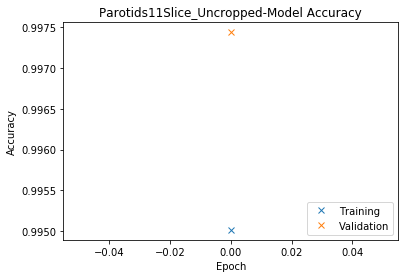

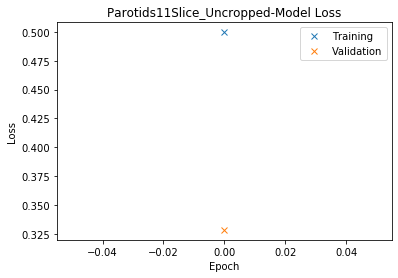

In [5]:
key_Model_Dict = "Parotids11SliceSegmentation_Uncropped"

Epoch_no = 1
#Save model
model.save(ModelDict[key_Model_Dict]+"_Epoch%2i.model"%Epoch_no)

# Plot training & validation accuracy values
plt.plot(history.history['acc'],'x')
plt.plot(history.history['val_acc'],'x')
plt.title(key_Dict+'-Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Training', 'Validation'], loc='lower right')
plt.savefig(ModelDict[key_Model_Dict]+"_Epoch%2i_Accuracy.png"%Epoch_no)
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'],'x')
plt.plot(history.history['val_loss'],'x')
plt.title(key_Dict+'-Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Training', 'Validation'], loc='upper right')
plt.savefig(ModelDict[key_Model_Dict]+"_Epoch%2i_Loss.png"%Epoch_no)
plt.show()

In [ ]:
############################# PREDICTING #########################

In [2]:
################################# LOAD MODEL #################################
#from keras.preprocessing import image
import tensorflow as tf
key_Model_Dict ="Parotids11SliceSegmentation_Uncropped"
Epoch_no = 1
new_model = tf.keras.models.load_model(ModelDict[key_Model_Dict]+"_Epoch%2i.model"%Epoch_no)

TrainingFeaturesDict,TrainingLabelsDict = Data_Dictionary.get_Training_Dictionary()
TestingFeaturesDict,TestingLabelsDict = Data_Dictionary.get_Testing_Dictionary()
stringImageDirectory, ModelDict = Data_Dictionary.get_Model_Dictionary()

################################# LOAD DATA #################################
import matplotlib.pyplot as plt
import numpy as np

key_Dict = "Parotids11Slice_Uncropped"

#Fitting the CNN to the images
NeuralNetworkTest = np.load(TestingFeaturesDict[key_Dict],allow_pickle=True) 

#Normalise data
yTest = [network[..., 1] for network in NeuralNetworkTest]
XTest = [network[..., 0] for network in NeuralNetworkTest]

width = 512
height = 512

yTest = np.divide(yTest,255)
check = np.genfromtxt(TestingLabelsDict[key_Dict], delimiter = ',')

for i in range(len(check)):
    if(check.argmax()==0):
        yTest[i] = np.multiply(yTest[i],1)
        
    if (check.argmax()==1):
        yTest[i] = np.multiply(yTest[i],2)
    if (check.argmax()==2):
        yTest[i] = np.multiply(yTest[i],3)

yTest = np.array(yTest).reshape(-1,width,height,1)
XTest = np.array(XTest).reshape(-1,width,height,1)
XTest = tf.keras.utils.normalize(XTest, axis = 1) 

C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.


[1. 0.]


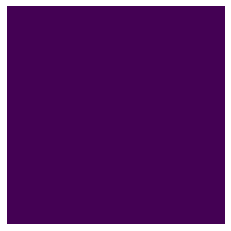

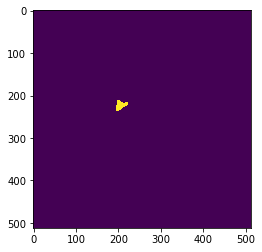

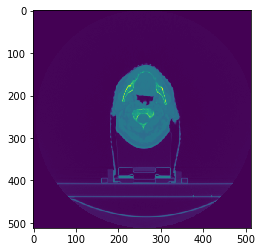

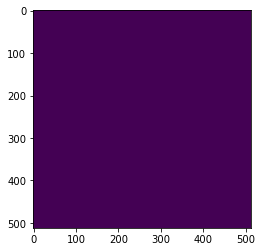

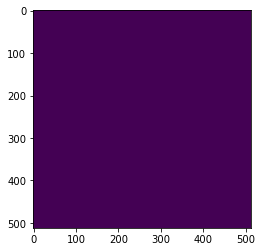

In [5]:
index =0
test_image = np.expand_dims(XTest[index], axis = 0)
result = new_model.predict(test_image)
print(check[index])
plt.imshow(result[0][..., 0])
plt.axis('off') 
#plt.savefig(ModelDict[key_Model_Dict]+"_Epoch%2i_Output.png"%Epoch_no)
plt.show()
plt.imshow(NeuralNetworkTest[index][...,1])
plt.show()
plt.imshow(NeuralNetworkTest[index][...,0])
plt.show()
plt.imshow(result[0][..., 1])
plt.show()
plt.imshow(result[0][..., 2])
plt.show()

In [ ]:
#########~~~~~~~~~~~~~~~~~~~???????CODE FOR LATER???????~~~~~~~~~~~~~~~~~~~#########

In [3]:
################################# IN DEPTH BUILDING CNN #################################

import tensorflow as tf

#keep_rate = 0.8
#keep_prob = tf.placeholder(tf.float32)

def conv2d(X, W):
    return tf.nn.conv2d(X, W, strides=[1,1,1,1], padding='VALID') #uses only pixels gained

def maxpool2d(X):
    #                        size of window         movement of window
    return tf.nn.max_pool(X, ksize=[1,2,2,1], strides=[1,2,2,1], padding='VALID')


class convolutional_neural_network():
    def build(X):
        flattern_shape = 126*126*64 #matrix dimensions x filter 
        n_classes = 3


        #Creates a dictionary to initialise weights and biases
        #use random numbers to create matrix of particluar dimensions
        weights = {'W_conv1':tf.Variable(tf.random_normal([3,3,1,32])), #convolution window [3,3], input 1, filters 32
                   'W_conv2':tf.Variable(tf.random_normal([3,3,32,64])),
                   'W_dense':tf.Variable(tf.random_normal([flattern_shape,128])),
                   'output':tf.Variable(tf.random_normal([128, n_classes]))}

        biases = {'b_conv1':tf.Variable(tf.random_normal([32])),
                   'b_conv2':tf.Variable(tf.random_normal([64])),
                   'b_dense':tf.Variable(tf.random_normal([128])),
                   'output':tf.Variable(tf.random_normal([n_classes]))}

        #Initialise layers
        #activate using a relu function
        convolutionMatrix1 = tf.nn.relu(conv2d(X, weights['W_conv1']) + biases['b_conv1']) 
        maxpoolMatrix1 = maxpool2d(convolutionMatrix1)

        convolutionMatrix2 = tf.nn.relu(conv2d(maxpoolMatrix1, weights['W_conv2']) + biases['b_conv2'])
        maxpoolMatrix2 = maxpool2d(convolutionMatrix2)

        denseMatrix = tf.reshape(maxpoolMatrix2,[-1, flattern_shape])
        denseMatrix = tf.nn.relu(tf.matmul(denseMatrix, weights['W_dense']) +biases['b_dense'])
        #denseMatrix = tf.nn.dropout(denseMatrix, keep_rate)

        #Multiply matrices
        output = tf.nn.softmax(tf.matmul(denseMatrix, weights['output'])+biases['output'])


        return output

def train_neural_network(X_features, y_labels):
    X = tf.placeholder('float', [None, 784])
    y = tf.placeholder('float')
    
    X_features = tf.keras.utils.normalize(X_features, axis = 1)
    
    prediction = convolutional_neural_network.build(X_features)
    loss = tf.reduce_mean( tf.nn.softmax_cross_entropy_with_logits(logits=prediction, labels=y) )
    optimizer = tf.train.AdamOptimizer().minimize(cost)
    
    network_epochs = 10
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        
        for epoch in range(0, network_epochs):
            iterations = 0
            epoch_loss = 0
            num_patient = 1000
            batch_size = 10
            batch_shape = (batch_size,256,256,3)
            
            while iterations * batch_size < num_patient:
                currentIndex = iterations * batch_size
                stepIndex = currentIndex + batch_size
                
                
                X_batch = np.zeros(batch_shape, dtype=np.uint8)
                y_batch = np.zeros(batch_size, dtype=np.uint8)
                sizeImage = 512
                
                #for larger datasets later
                #trainingdata = image_Preprocessing(currentIndex, stepIndex, sizeImage)
                
                for j, image_temp in enumerate(X_features):
                    X_batch[j] = image_temp
                    
                for j,label_temp in enumerate(y_labels):
                    y_batch[j] = label_temp
                iterations += 1
                
                try:
                    _, c = sess.run([optimizer, loss], feed_dict={X: X_batch, y: y_batch})
                    epoch_loss += c
                except Exception as e:
                    print("Unsuccessful Run")
                    print(str(e))

            print('Epoch', epoch, 'completed out of',hm_epochs,'loss:',epoch_loss)

        match = tf.equal(tf.argmax(prediction, 1), tf.argmax(y, 1))

        accuracy = tf.reduce_mean(tf.cast(match, 'float'))
        print('Accuracy:',accuracy.eval({x:X, y:y}))

C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages\tensorflow\python\framework\dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\Oliver\Anaconda3\envs\PythonCPU\lib\site-packages